# Translational mapping

In this notebook we explicitely model the link between the regulatory and structural embeddings of the U2OS cells and evaluate their generalizability.

---


## 0. Enviromental setup

We first load the required packages and define a number of helper functions.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
from torch import nn
from torch.optim import Adam
import sys
from tqdm.notebook import tqdm
from yellowbrick.cluster.elbow import kelbow_visualizer
from yellowbrick.cluster import KElbowVisualizer
from torch.utils.data import DataLoader
import matplotlib as mpl

sys.path.append("../../..")

from src.utils.notebooks.translation.analysis import *
from src.data.datasets import IndexedTensorDataset
from src.utils.basic.io import get_genesets_from_gmt_file


seed = 1234

device = "cuda:0"

%load_ext nb_black

<IPython.core.display.Javascript object>

In [2]:
def get_struct_nn_mean_translation_dict(img_embs, node_embs):
    nn_pred_dict = {}
    struct_nn = NearestNeighbors(n_neighbors=2)
    struct_samples = np.array(list(img_embs.index))
    struct_nn.fit(np.array(img_embs))

    reg_nn = NearestNeighbors(n_neighbors=len(node_embs))
    reg_samples = np.array(list(node_embs.index))
    reg_nn.fit(np.array(node_embs))

    for target in struct_samples:
        struct_pred_input = np.array(img_embs.loc[target]).reshape(1, -1)
        struct_1nn = struct_samples[
            struct_nn.kneighbors(struct_pred_input, return_distance=False)[0]
        ]
        reg_pred_input = np.array(node_embs.loc[struct_1nn[1]]).reshape(1, -1)
        reg_nns = reg_samples[
            reg_nn.kneighbors(reg_pred_input, return_distance=False)[0]
        ]
        nn_pred_dict[target] = reg_nns
    return nn_pred_dict

<IPython.core.display.Javascript object>

In [3]:
def get_topk_acc_from_nn_dict(nn_dict, ks=[1, 3, 5, 10, 20, 50]):
    idc = []
    topk_dict = {}
    for target, nns in nn_dict.items():
        idc.append(target)
        for k in ks:
            if "top-{}".format(k) not in topk_dict:
                topk_dict["top-{}".format(k)] = []
            topk_dict["top-{}".format(k)].append(int(target in list(nns)[:k]))
    topk_result = pd.DataFrame(topk_dict, index=idc)
    return topk_result

<IPython.core.display.Javascript object>

In [4]:
def get_knn_hit_data(nn_dict):
    idc = []
    hits = []
    for k, v in nn_dict.items():
        idc.append(k)
        hits.append(np.where(v == k)[0])
    hit_results = pd.DataFrame(np.array(hits), columns=["knn_hit"], index=idc)
    return hit_results

<IPython.core.display.Javascript object>

In [5]:
def get_struct_nn_centroid_translation_dict(img_embs, node_embs):
    nn_pred_dict = {}
    struct_nn = NearestNeighbors(n_neighbors=2)
    struct_samples = list(img_embs.index)
    struct_samples = np.array([cl_label.split("_")[0] for cl_label in struct_samples])

    reg_nn = NearestNeighbors(n_neighbors=len(node_embs))
    reg_samples = np.array(list(node_embs.index))
    reg_nn.fit(np.array(node_embs))

    for target in np.unique(struct_samples):
        struct_nn.fit(np.array(img_embs.loc[struct_samples != target]))
        struct_pred_input = np.array(img_embs.loc[struct_samples == target])
        struct_1nn = struct_samples[
            struct_nn.kneighbors(struct_pred_input, return_distance=False)[:, 1]
        ]
        reg_pred_input = np.array(node_embs.loc[struct_1nn]).mean(axis=0).reshape(1, -1)
        reg_nns = reg_samples[reg_nn.kneighbors(reg_pred_input, return_distance=False)][
            0
        ]
        nn_pred_dict[target] = reg_nns
    return nn_pred_dict

<IPython.core.display.Javascript object>

---

## 1. Read in data

Next, we read in the different data sets that we will use for the modelling and evaluation of the translational mappings. The first data set includes the regulatory embeddings of the 244 genes that are part of the inferred interactome.

In [7]:
node_embs = pd.read_csv(
    "../../../data/ppi/embedding/node_embeddings_cv_1024_2gexrecon_1graphrecon_mask_loss_newnodeset.csv",
    index_col=0,
)
node_embs = pd.DataFrame(
    StandardScaler().fit_transform(node_embs),
    columns=node_embs.columns,
    index=node_embs.index,
)
node_embs.head()

,0,1,2,3,4,5,6,7,8,9,...,1014,1015,1016,1017,1018,1019,1020,1021,1022,1023
PTN,-1.086331,0.673063,-0.751834,-0.460111,-0.458035,-0.001970,-0.592742,0.098719,1.210169,-0.135587,...,0.229365,-1.263509,-1.349143,-0.772527,0.988419,-2.941839,-1.191999,1.647311,-1.190624,1.178950
KLK6,-0.565238,0.142026,0.417042,-0.889608,-0.786147,-1.611668,1.806670,0.342479,-2.439335,1.027865,...,0.574910,-2.841868,0.746334,0.127392,-1.367955,-0.840691,1.064656,0.010020,-0.253872,0.911684
AURKB,0.190753,-0.645296,1.181987,-1.297113,1.793097,-0.060705,0.610802,-2.691199,0.351442,-1.372676,...,0.827356,2.469055,-1.390616,0.708130,0.386535,0.278728,0.393679,-1.683939,0.000158,-2.453655
TRAF2,0.876149,-2.007434,-1.546834,0.710036,1.092956,2.628129,-2.212853,-0.517398,1.392085,-1.834318,...,-0.589415,-0.090250,-0.373101,2.686677,-1.603536,1.196651,-0.303368,-0.685042,-2.564863,0.595422
TNNC1,0.632208,0.082463,-2.351677,-0.267251,0.469116,-0.216899,0.154846,-0.462149,-1.461248,0.490579,...,0.533826,0.172639,0.108682,0.409508,0.630538,-0.042931,0.226905,0.632712,-0.209424,0.319998


<IPython.core.display.Javascript object>

After having loaded the regulatory embeddings, we will now load the structural embeddings defined by the embeddings of the images held-out during the different folds of the cross-validation. In particular we load a version, where in addition to the structural embeddings the corresponding gene labels are given indicating the respective experimental condition the encoded cell images come from as well as a cluster label. The latter was obtained by clustering the structural embeddings for each held-out fold individually using 4-means clustering on euclidean distances to capture the frequently observed multimodal distribution of the cell states in the different overexpression settings.

In [8]:
img_embs = pd.read_hdf(
    "../../../data/experiments/image_embeddings/specificity_target_emb_cv_strat/final_1024/all_test_latents_k3.h5"
)

<IPython.core.display.Javascript object>

Finally, we also load a number of pathway database information that we will use later for validation.

In [10]:
kegg_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/genesets/c2.cp.kegg.v7.5.1.symbols.gmt"
)
pid_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/genesets/c2.cp.pid.v7.5.1.symbols.gmt"
)
wiki_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/genesets/c2.cp.wikipathways.v7.5.1.symbols.gmt"
)
bc_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/genesets/c2.cp.biocarta.v7.5.1.symbols.gmt"
)
h_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/genesets/h.all.v7.4.symbols.gmt"
)

<IPython.core.display.Javascript object>

We aim to establish the translational mapping on three different levels defining the level of pooling in the structural space. First, we describe the structural embedding for given overexpression condition the mean of the embeddings for all cells from the corresponding condition. Second, each overexpression condition is described in the structural space by the means of the four different clusters identified using 4-means. This aims to better capture the multimodal cell state distribution induced by the overexpression settings. Finally, we compare the previous two approaches to the setting where we do not pool cells but describe each overexpression by the overall distribution of all structural embeddings of cells from the corresponding condition. All three approaches have certain advantages and disadvantages. To this end, assume a condition that gives rise to highly variable cell state population that spans the large parts of structural space as e.g. seen for the BRAF overexpression condition. An inferred map would thus map from large parts of the structural space to the corresponding regulatory embedding of BRAF. Such a mapping would be unspecific, prone to noise and subject to high variance which is unlikely to capture the causal links between the two spaces. To obtain more specific embeddings which is less affected by the noise in the single-cell embeddings, we propose to pool those and represent the structural phenotype of cells in the different conditions by the mean of the structural embeddings of the corresponding cells or the means of the four identified clusters. Note that this however, will drastically reduce the sample size that is available to infer the translational map. The effects of those different characteristics will described in the corresponding sections.

In [11]:
img_node_embs_dict = {}
shared_targets = set(node_embs.index).intersection(np.unique(img_embs.labels))
for i in range(4):
    filtered_img_embs = img_embs.loc[img_embs.fold == "fold_{}".format(i)]
    filtered_img_embs = filtered_img_embs.loc[
        filtered_img_embs.labels.isin(shared_targets)
    ]
    filtered_node_embs = node_embs.loc[filtered_img_embs.labels]
    labels = np.array(filtered_img_embs.labels)
    filtered_img_embs = filtered_img_embs._get_numeric_data()
    img_node_embs_dict["fold{}".format(i)] = (
        filtered_img_embs,
        filtered_node_embs,
        labels,
    )

<IPython.core.display.Javascript object>

In [12]:
cl_img_node_embs_dict = {}
shared_targets = set(node_embs.index).intersection(np.unique(img_embs.labels))
for i in range(4):
    filtered_img_embs = img_embs.loc[img_embs.fold == "fold_{}".format(i)]
    mean_img_embs = filtered_img_embs.groupby("cluster").median()
    labels = []
    for idx in list(mean_img_embs.index):
        labels.append(idx.split("_")[0])
    mean_img_embs["labels"] = np.array(labels)
    filtered_img_embs = mean_img_embs.loc[mean_img_embs.labels.isin(shared_targets)]
    filtered_node_embs = node_embs.loc[filtered_img_embs.labels]
    labels = filtered_img_embs.iloc[:, -1]
    filtered_img_embs = filtered_img_embs.iloc[:, :-1]
    cl_img_node_embs_dict["fold{}".format(i)] = (
        filtered_img_embs,
        filtered_node_embs,
        np.array(labels),
    )

<IPython.core.display.Javascript object>

In [13]:
mean_img_node_embs_dict = {}
shared_targets = set(node_embs.index).intersection(np.unique(img_embs.labels))
for i in range(4):
    filtered_img_embs = img_embs.loc[img_embs.fold == "fold_{}".format(i)]
    mean_img_embs = filtered_img_embs.groupby("labels").mean()
    mean_img_embs["labels"] = np.array(mean_img_embs.index)
    filtered_img_embs = mean_img_embs.loc[mean_img_embs.labels.isin(shared_targets)]
    filtered_node_embs = node_embs.loc[filtered_img_embs.labels]
    filtered_img_embs = filtered_img_embs.iloc[:, :-1]
    mean_img_node_embs_dict["fold{}".format(i)] = filtered_img_embs, filtered_node_embs

<IPython.core.display.Javascript object>

---

---

## 2. Translational analyses


We will now built translational maps in order to show that we can add additional value by translating to the regulatory space. To this end, we will compare the performance of different model and prediction approaches:

1. As a baseline we will consider the inference purely based on the structural space. To this end, we compute the nearest neighbor for each target in the structural space and evaluate its local neighborhood in the regulatory space.
2. A simple linear and non-linear model will be fit using the corresponding structural and regulatory embeddings.

We use both the population means as well as the cluster centroid data to establish the mapping. In the later case the prediction is given by the mean embedding of the translated regulatory embeddings.

All models are assessed using the top-k accuracy metric in a leave-one-condition out scheme.

---

### 2.1. Structural NN mean translation

As discussed earlier we will start by identifying the nearest neighbor for each of the 39 target genes covered in both the regulatory and structural space. We then look at the neighborhood of the corresponding gene in the regulatory space and assess the top-k accuracy of the prediction.

In [14]:
img_embs_fold0, node_embs_fold0 = mean_img_node_embs_dict["fold0"]

<IPython.core.display.Javascript object>

In [15]:
struct_nn_mean_pred_dict = get_struct_nn_mean_translation_dict(
    img_embs_fold0, node_embs
)

<IPython.core.display.Javascript object>

In [60]:
struct_nn_mean_pred_dict["MAP3K2"][:50]

array(['BRAF', 'RAF1', 'PAK2', 'HRAS', 'KRT18', 'LGALS1', 'LDOC1', 'SFN',
       'HSPA1B', 'CDK14', 'RHOA', 'FKBP4', 'MAGEA1', 'CDC42', 'PRKCE',
       'PIK3R2', 'BCR', 'AKT1S1', 'TSC2', 'S100A2', 'HSP90AB1', 'MAPK7',
       'HSPB1', 'MAP3K5', 'MAGED1', 'DSP', 'KRT8', 'TNNT1', 'NEFL',
       'MAP3K2', 'MYL2', 'MAP3K9', 'THRA', 'PDGFRB', 'MAPK8', 'AXL',
       'CDC42EP1', 'NCOR2', 'NDN', 'PRAME', 'VIM', 'KPNA2', 'ELK1',
       'MYH9', 'CEBPA', 'RELB', 'UCHL5', 'MDC1', 'EXO1', 'CRMP1'],
      dtype='<U8')

<IPython.core.display.Javascript object>

In [17]:
struct_nn_mean_topk = get_topk_acc_from_nn_dict(struct_nn_mean_pred_dict)
struct_nn_mean_topk.describe()

,top-1,top-3,top-5,top-10,top-20,top-50
count,39.0,39.000000,39.000000,39.000000,39.000000,39.000000
mean,0.0,0.051282,0.076923,0.128205,0.256410,0.589744
std,0.0,0.223456,0.269953,0.338688,0.442359,0.498310
min,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.0,0.000000,0.000000,0.000000,0.000000,1.000000
75%,0.0,0.000000,0.000000,0.000000,0.500000,1.000000
max,0.0,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

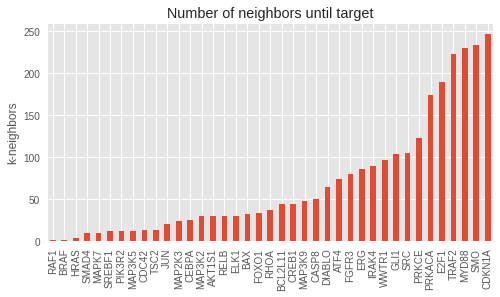

<IPython.core.display.Javascript object>

In [18]:
mpl.style.use("ggplot")
struct_nn_mean_khits = get_knn_hit_data(struct_nn_mean_pred_dict)
ax = struct_nn_mean_khits.knn_hit.sort_values().plot(kind="bar", figsize=[8, 4])
ax.set_ylabel("k-neighbors")
ax.set_title("Number of neighbors until target")
plt.show()

---

### 2.2. Linear mean translation

As a second setup, we will train a linear model in a leave-one-target out setting for 1000 epochs.

In [19]:
nn = NearestNeighbors(n_neighbors=len(node_embs)).fit(np.array(node_embs))
nn_clf = CustomKNNClassifier(
    clf=nn, samples=np.array(list(node_embs.index)), ks=[1, 3, 5, 10, 20, 50]
)

<IPython.core.display.Javascript object>

---

In [20]:
data_dicts = get_logo_data_dicts(
    data=img_embs_fold0,
    labels=node_embs_fold0,
    val_size=0,
    group_labels=np.array(list(node_embs_fold0.index)),
    batch_size=32,
    balanced=False,
    scale_x=False,
    scale_y=False,
)

<IPython.core.display.Javascript object>

  0%|          | 0/39 [00:00<?, ?it/s]

AKT1S1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.2297079657253466
train top-k accuracies: {1: 0.657895, 3: 0.763158, 5: 0.789474, 10: 0.868421, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.657895, 3: 0.763158, 5: 0.789474, 10: 0.868421, 20: 0.921053, 50: 0.973684}
test loss: 0.2602742612361908
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


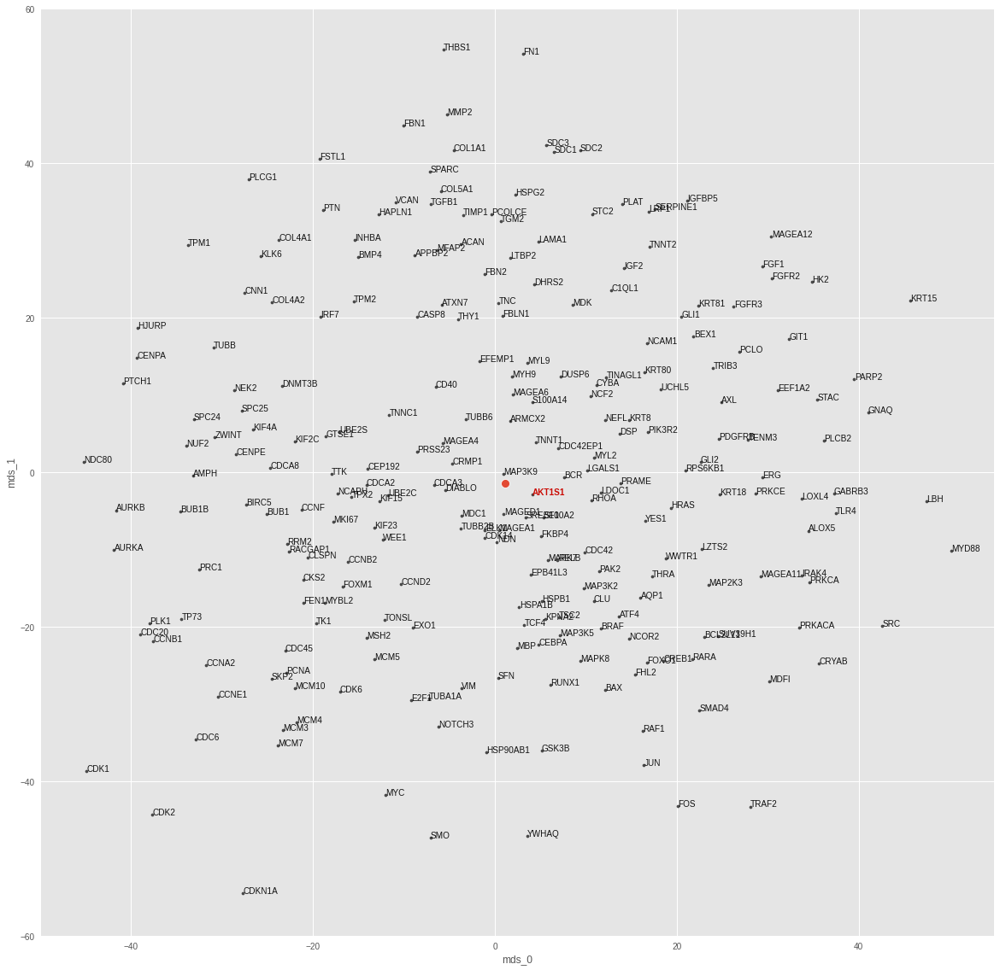

ATF4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.2235892964036841
train top-k accuracies: {1: 0.684211, 3: 0.763158, 5: 0.842105, 10: 0.868421, 20: 0.921053, 50: 0.947368}
train mean top-k accuracies: {1: 0.684211, 3: 0.763158, 5: 0.842105, 10: 0.868421, 20: 0.921053, 50: 0.947368}
test loss: 0.6785714030265808
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


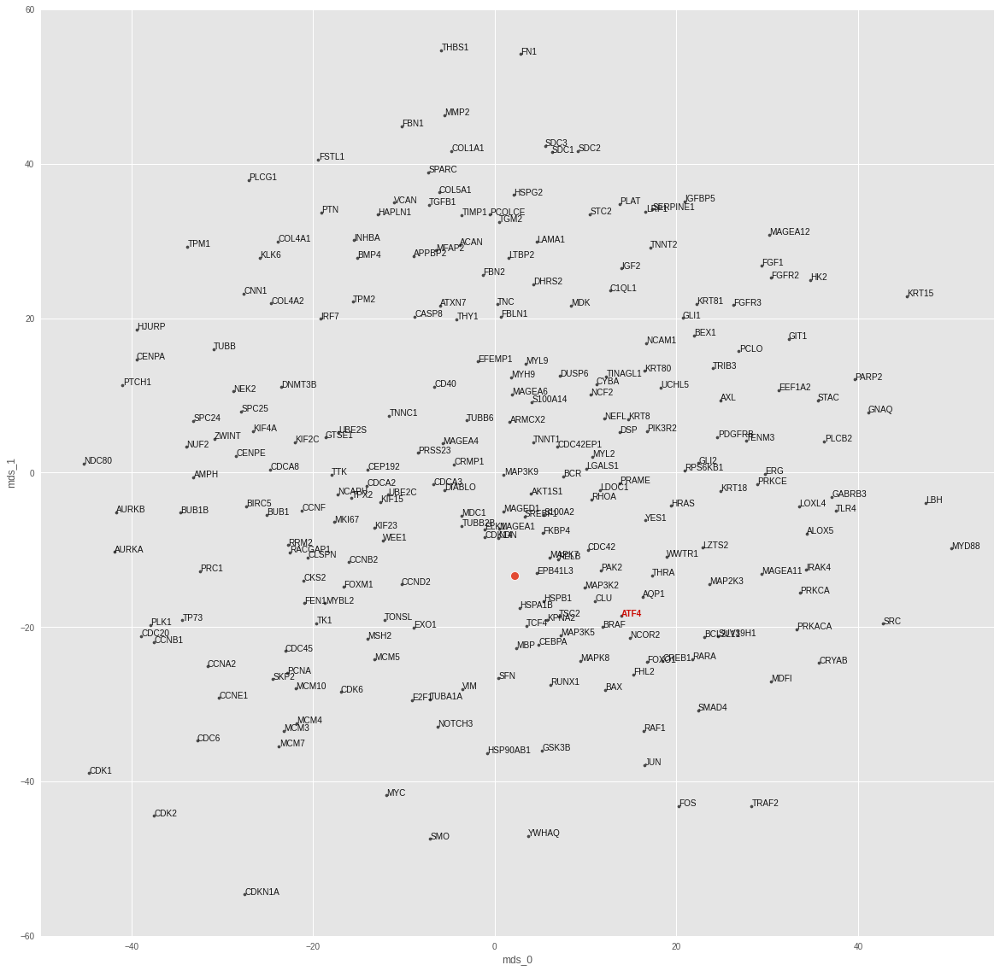

BAX
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.2271394110039661
train top-k accuracies: {1: 0.657895, 3: 0.763158, 5: 0.789474, 10: 0.868421, 20: 0.921053, 50: 0.947368}
train mean top-k accuracies: {1: 0.657895, 3: 0.763158, 5: 0.789474, 10: 0.868421, 20: 0.921053, 50: 0.947368}
test loss: 0.7070235013961792
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


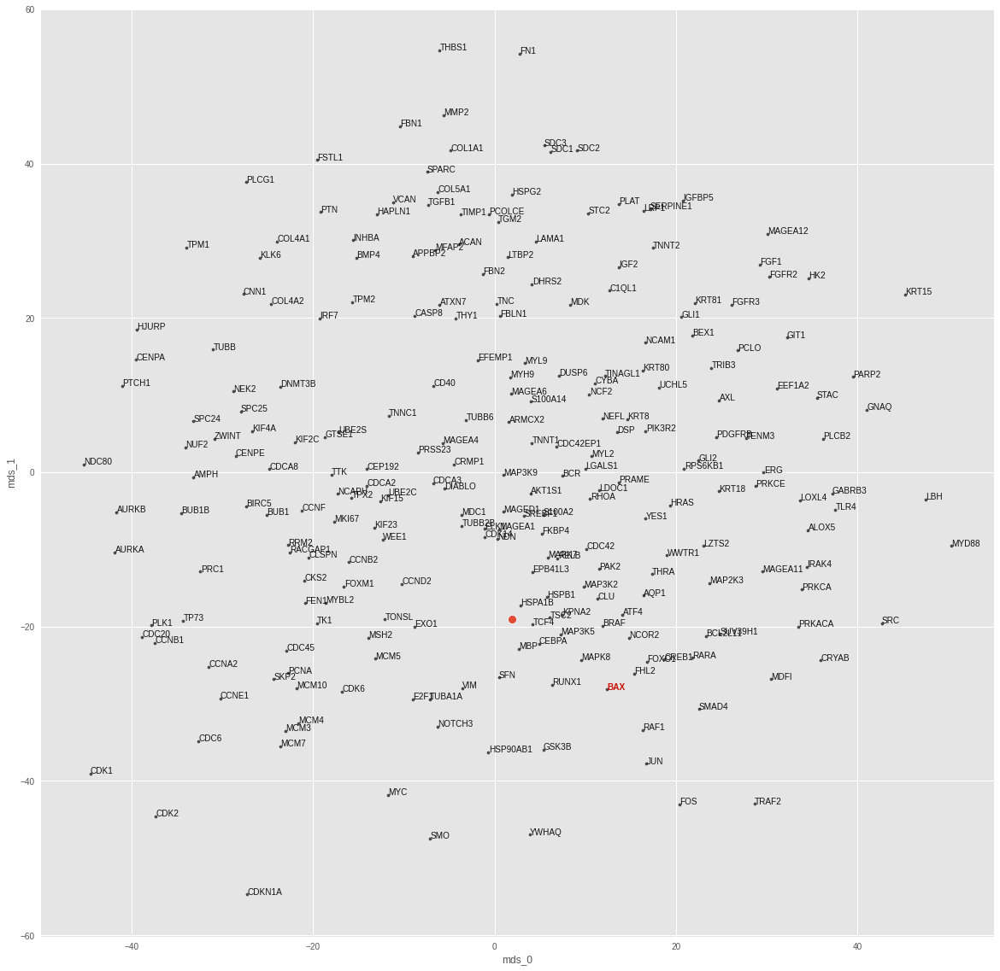

BCL2L11
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.22307436638756803
train top-k accuracies: {1: 0.631579, 3: 0.763158, 5: 0.789474, 10: 0.842105, 20: 0.894737, 50: 0.973684}
train mean top-k accuracies: {1: 0.631579, 3: 0.763158, 5: 0.789474, 10: 0.842105, 20: 0.894737, 50: 0.973684}
test loss: 1.266423225402832
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


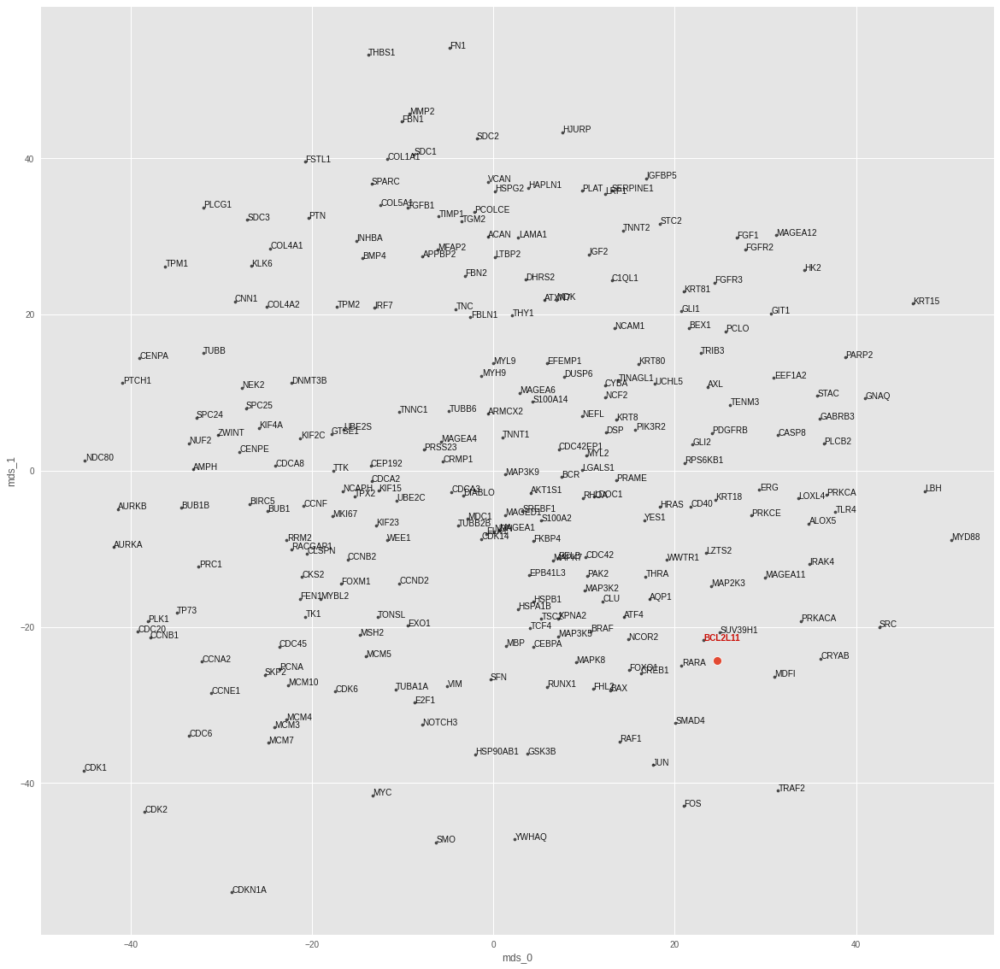

BRAF
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.22747412637660377
train top-k accuracies: {1: 0.684211, 3: 0.763158, 5: 0.815789, 10: 0.842105, 20: 0.894737, 50: 0.973684}
train mean top-k accuracies: {1: 0.684211, 3: 0.763158, 5: 0.815789, 10: 0.842105, 20: 0.894737, 50: 0.973684}
test loss: 0.4081854224205017
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


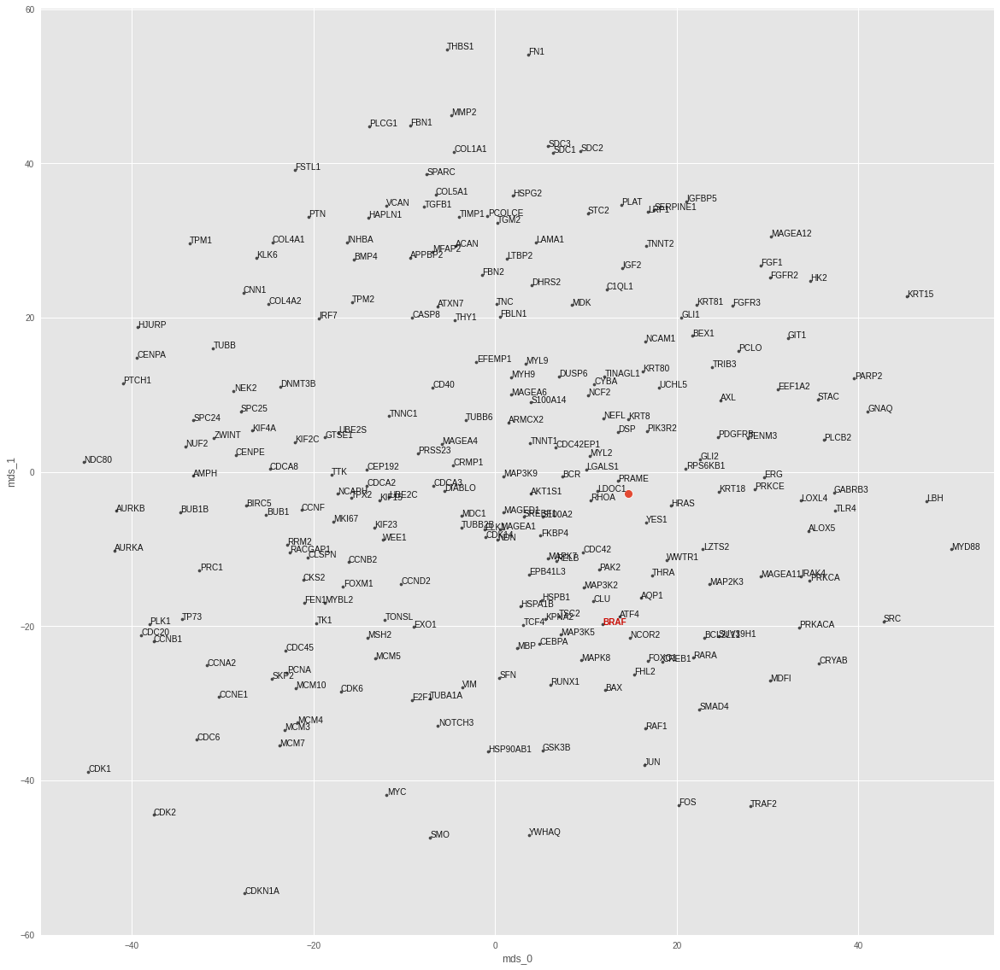

CASP8
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.21279224596525492
train top-k accuracies: {1: 0.710526, 3: 0.789474, 5: 0.789474, 10: 0.894737, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.710526, 3: 0.789474, 5: 0.789474, 10: 0.894737, 20: 0.921053, 50: 0.973684}
test loss: 3.2069478034973145
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


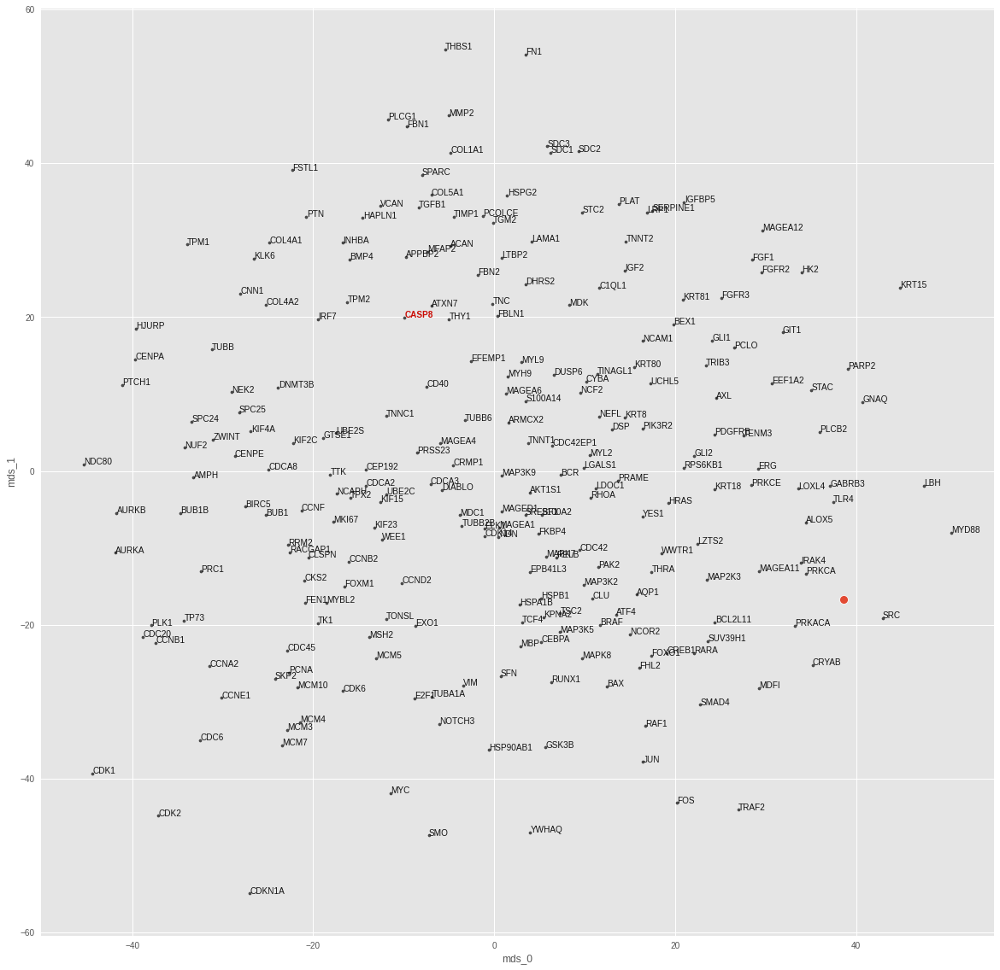

CDC42
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.23063035387741893
train top-k accuracies: {1: 0.631579, 3: 0.789474, 5: 0.842105, 10: 0.868421, 20: 0.921053, 50: 0.947368}
train mean top-k accuracies: {1: 0.631579, 3: 0.789474, 5: 0.842105, 10: 0.868421, 20: 0.921053, 50: 0.947368}
test loss: 0.49279463291168213
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


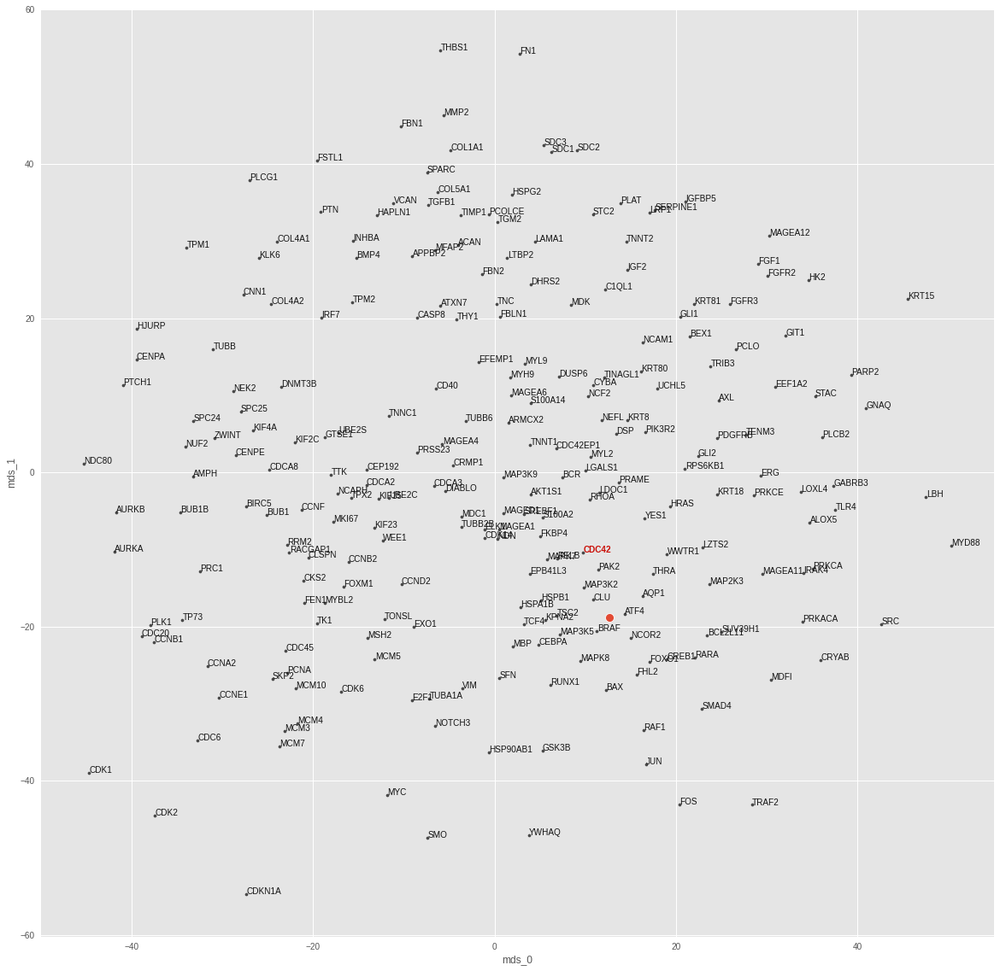

CDKN1A
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.22502239911179794
train top-k accuracies: {1: 0.631579, 3: 0.789474, 5: 0.842105, 10: 0.894737, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.631579, 3: 0.789474, 5: 0.842105, 10: 0.894737, 20: 0.921053, 50: 0.973684}
test loss: 4.649001121520996
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


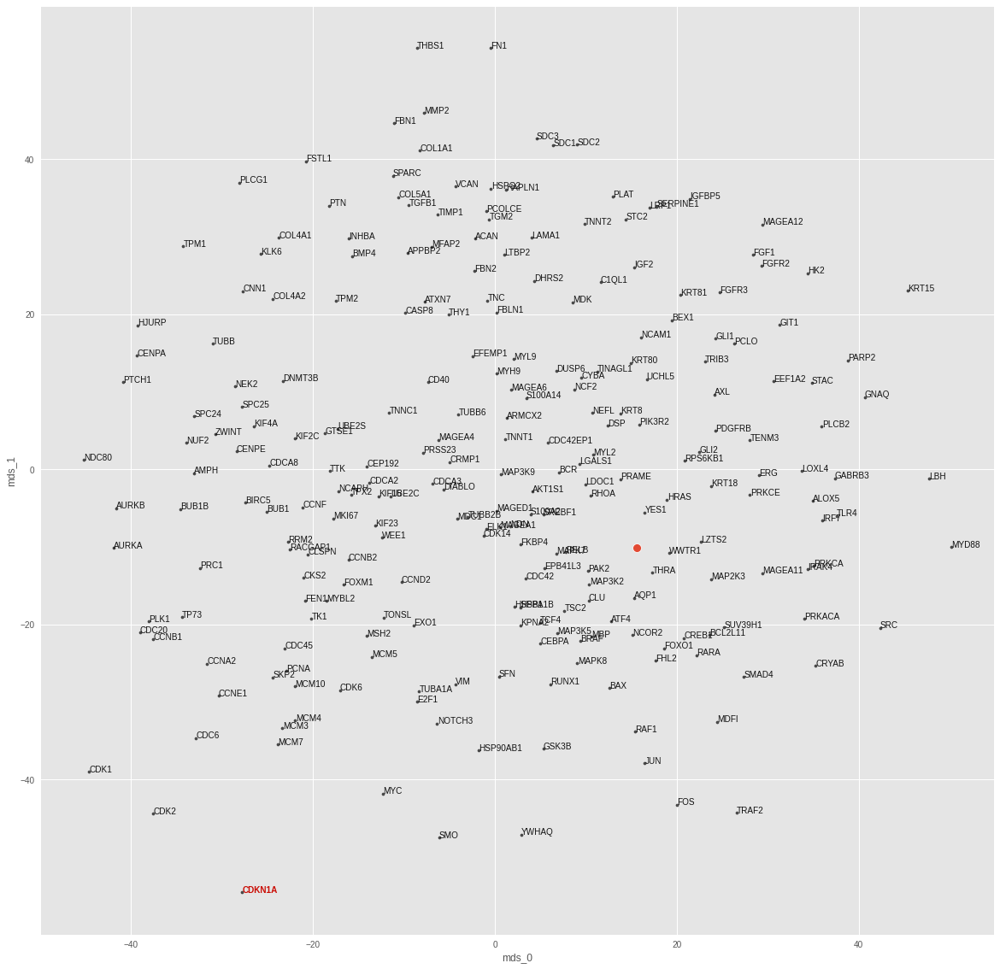

CEBPA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.2287323757221824
train top-k accuracies: {1: 0.684211, 3: 0.815789, 5: 0.842105, 10: 0.868421, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.684211, 3: 0.815789, 5: 0.842105, 10: 0.868421, 20: 0.921053, 50: 0.973684}
test loss: 1.290958285331726
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


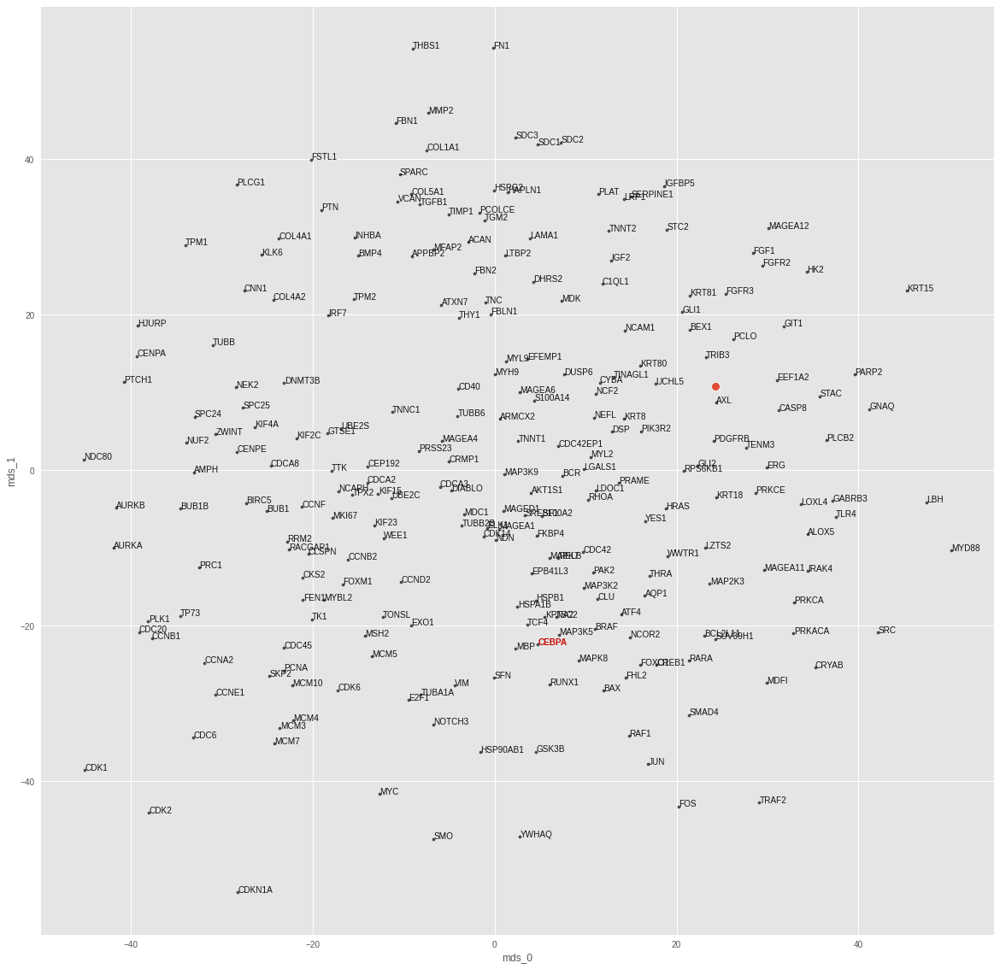

CREB1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.22252549936896876
train top-k accuracies: {1: 0.710526, 3: 0.815789, 5: 0.842105, 10: 0.842105, 20: 0.921053, 50: 0.947368}
train mean top-k accuracies: {1: 0.710526, 3: 0.815789, 5: 0.842105, 10: 0.842105, 20: 0.921053, 50: 0.947368}
test loss: 1.069209098815918
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


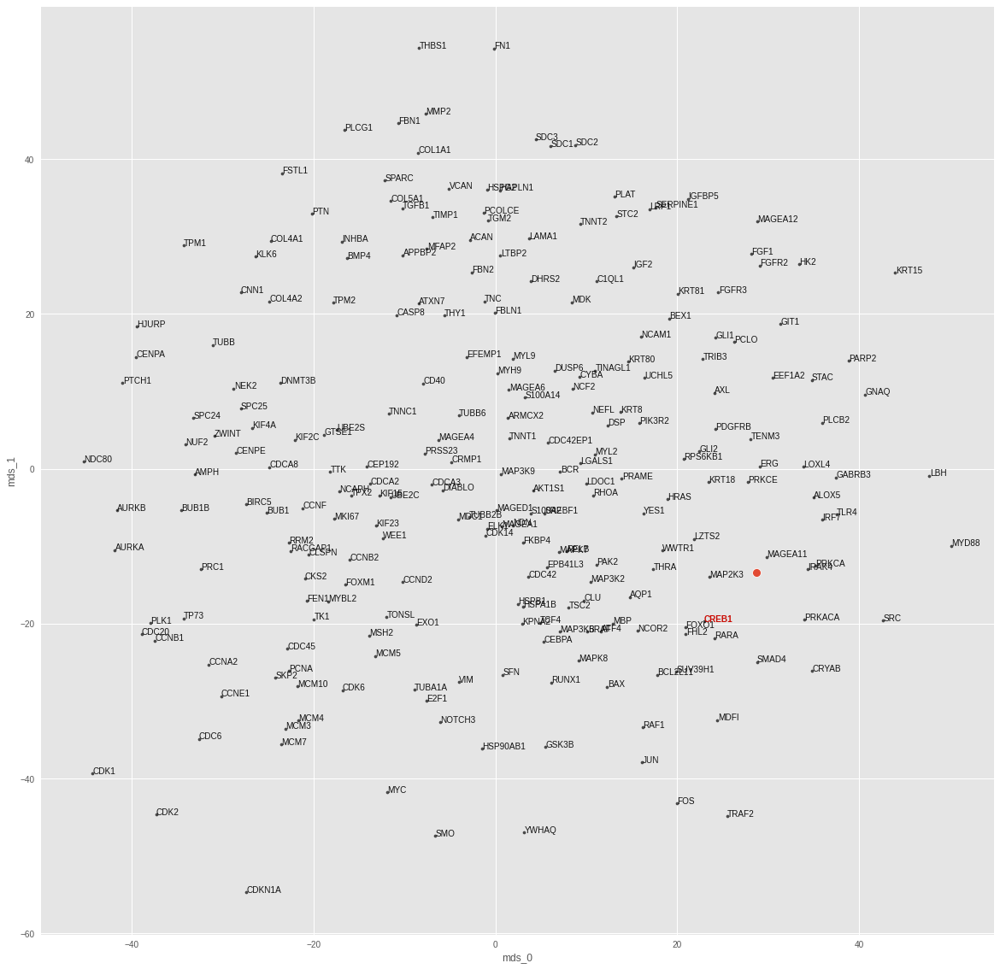

DIABLO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.2274162941857388
train top-k accuracies: {1: 0.657895, 3: 0.815789, 5: 0.842105, 10: 0.842105, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.657895, 3: 0.815789, 5: 0.842105, 10: 0.842105, 20: 0.921053, 50: 0.973684}
test loss: 0.7044690847396851
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


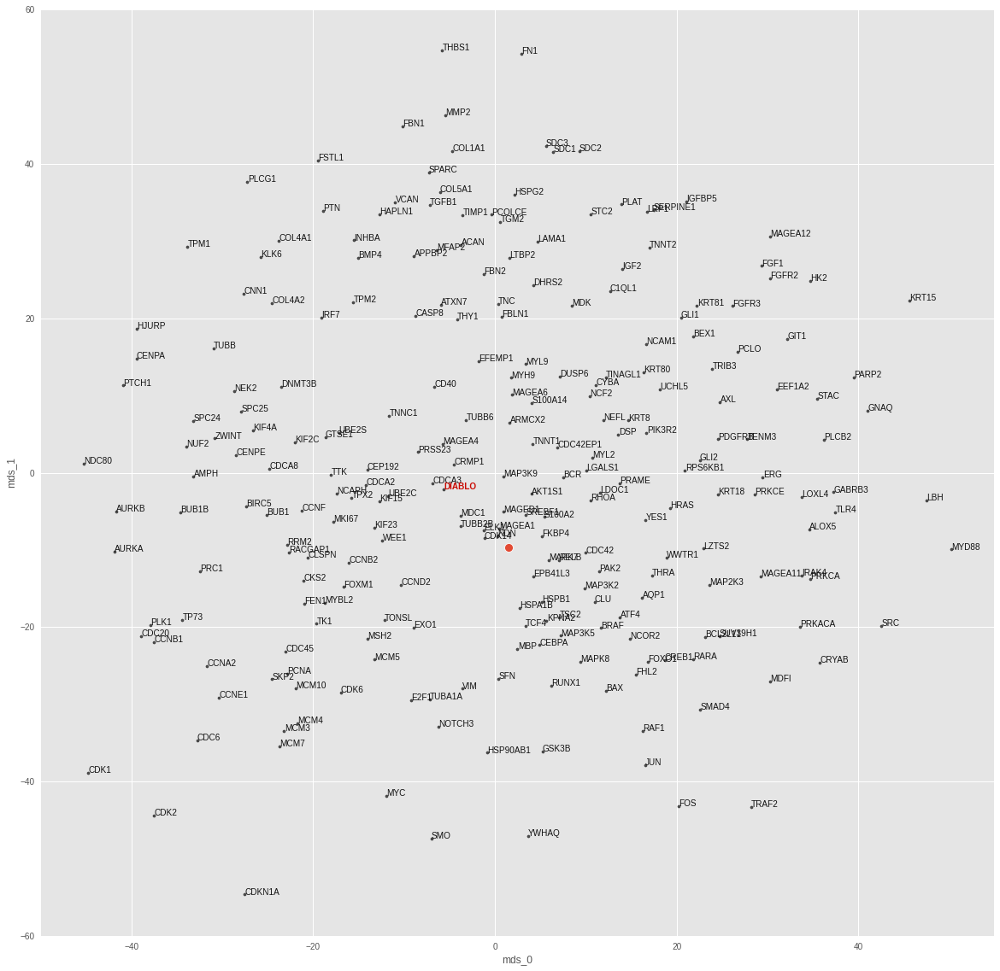

E2F1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.2169193943080149
train top-k accuracies: {1: 0.631579, 3: 0.815789, 5: 0.842105, 10: 0.894737, 20: 0.921053, 50: 0.947368}
train mean top-k accuracies: {1: 0.631579, 3: 0.815789, 5: 0.842105, 10: 0.894737, 20: 0.921053, 50: 0.947368}
test loss: 2.4782676696777344
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


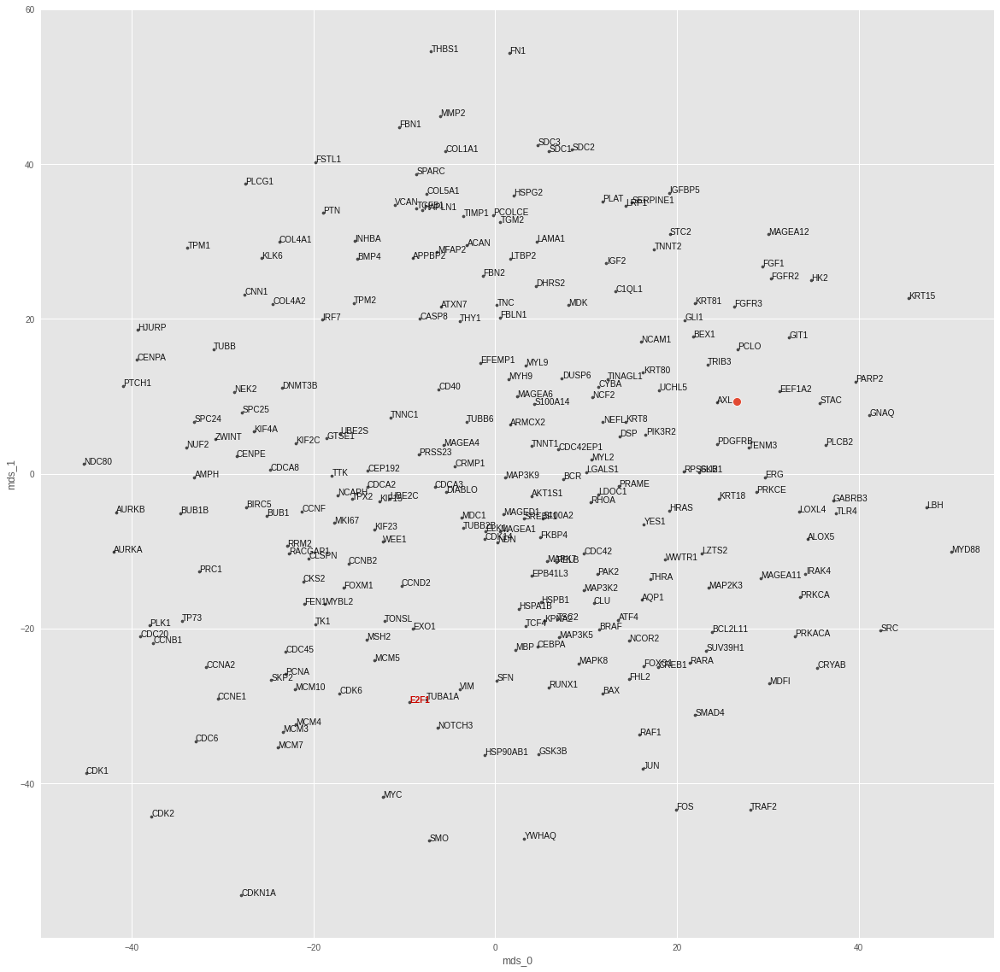

ELK1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.22816279059962222
train top-k accuracies: {1: 0.657895, 3: 0.763158, 5: 0.815789, 10: 0.868421, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.657895, 3: 0.763158, 5: 0.815789, 10: 0.868421, 20: 0.921053, 50: 0.973684}
test loss: 0.4907872974872589
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


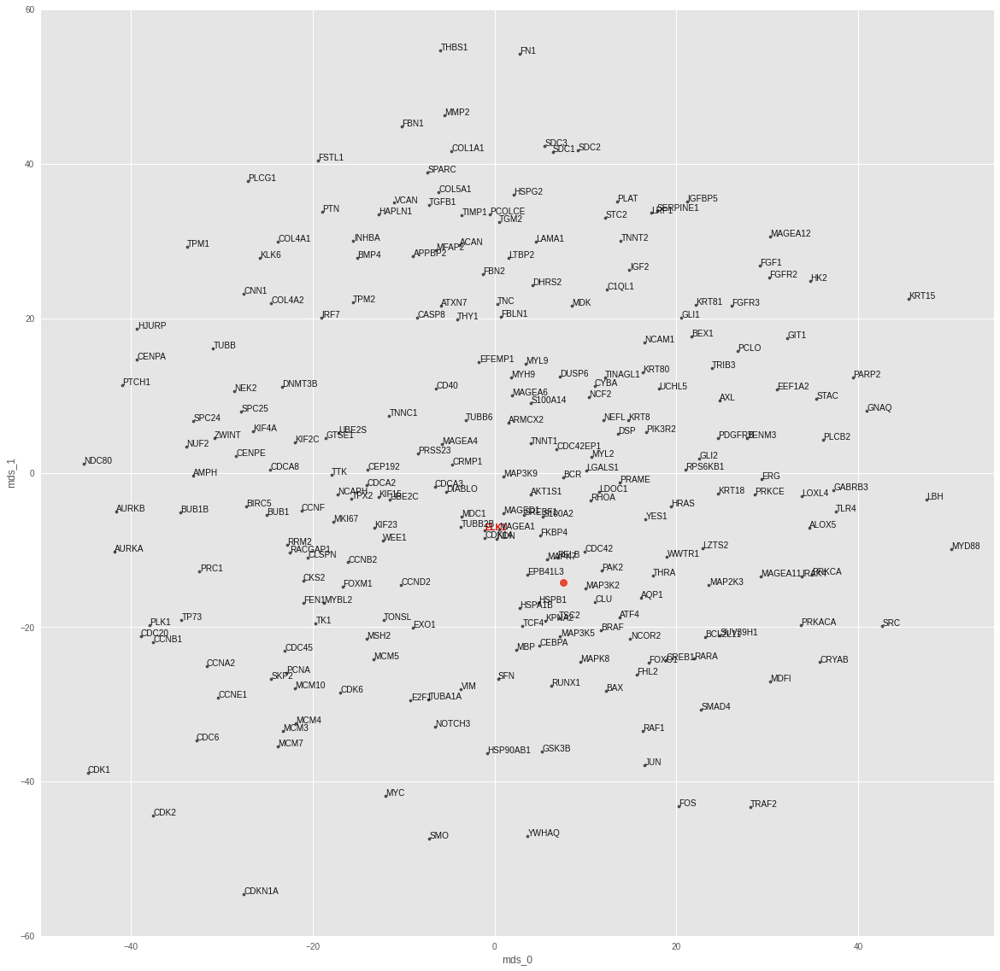

ERG
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.22234773635864258
train top-k accuracies: {1: 0.684211, 3: 0.763158, 5: 0.789474, 10: 0.868421, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.684211, 3: 0.763158, 5: 0.789474, 10: 0.868421, 20: 0.921053, 50: 0.973684}
test loss: 2.0603554248809814
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


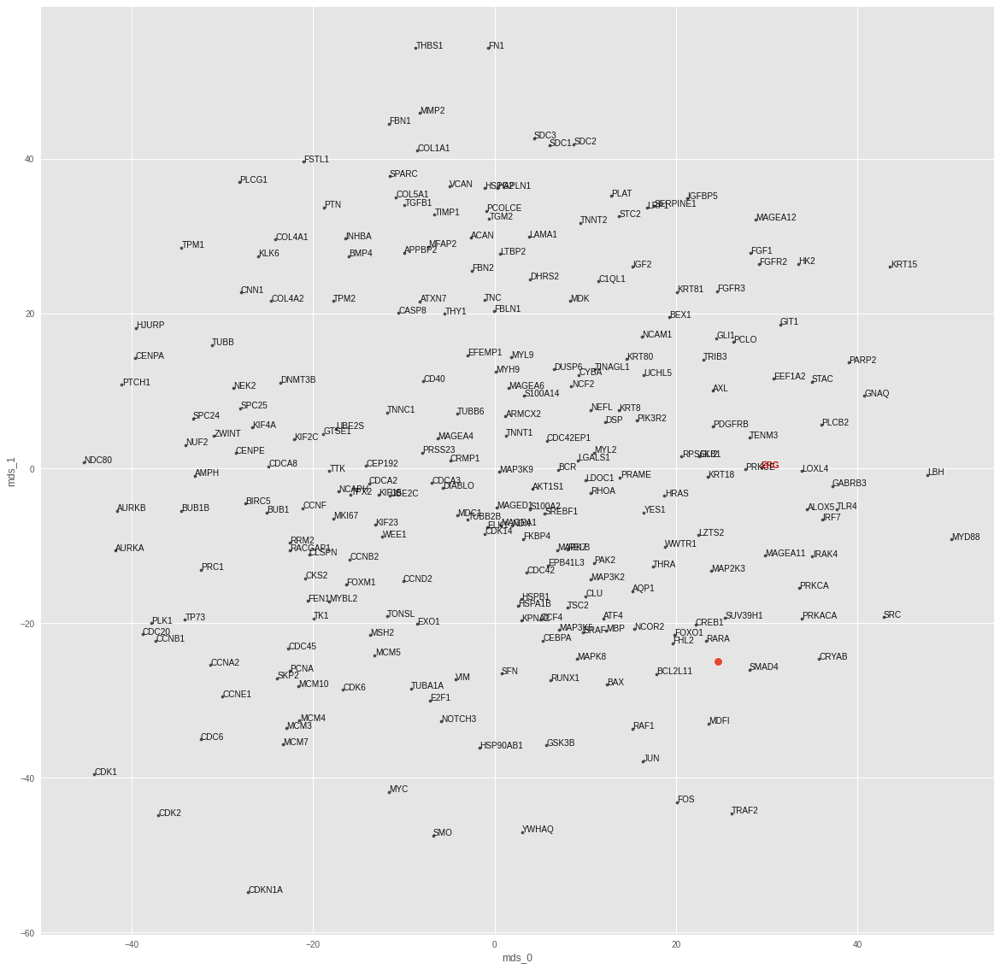

FGFR3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.22114648317035876
train top-k accuracies: {1: 0.657895, 3: 0.763158, 5: 0.789474, 10: 0.868421, 20: 0.921053, 50: 0.947368}
train mean top-k accuracies: {1: 0.657895, 3: 0.763158, 5: 0.789474, 10: 0.868421, 20: 0.921053, 50: 0.947368}
test loss: 1.2254676818847656
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


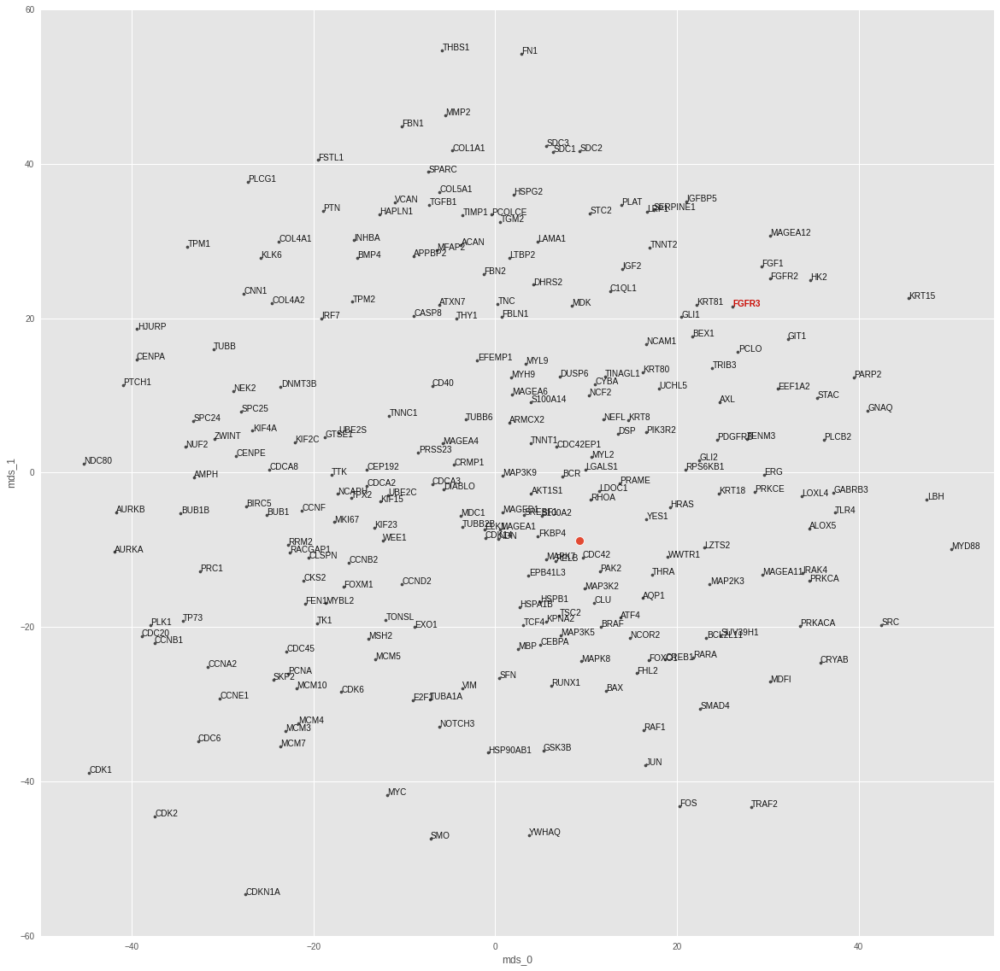

FOXO1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.21474937702480115
train top-k accuracies: {1: 0.684211, 3: 0.842105, 5: 0.868421, 10: 0.894737, 20: 0.921053, 50: 0.947368}
train mean top-k accuracies: {1: 0.684211, 3: 0.842105, 5: 0.868421, 10: 0.894737, 20: 0.921053, 50: 0.947368}
test loss: 1.2570991516113281
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


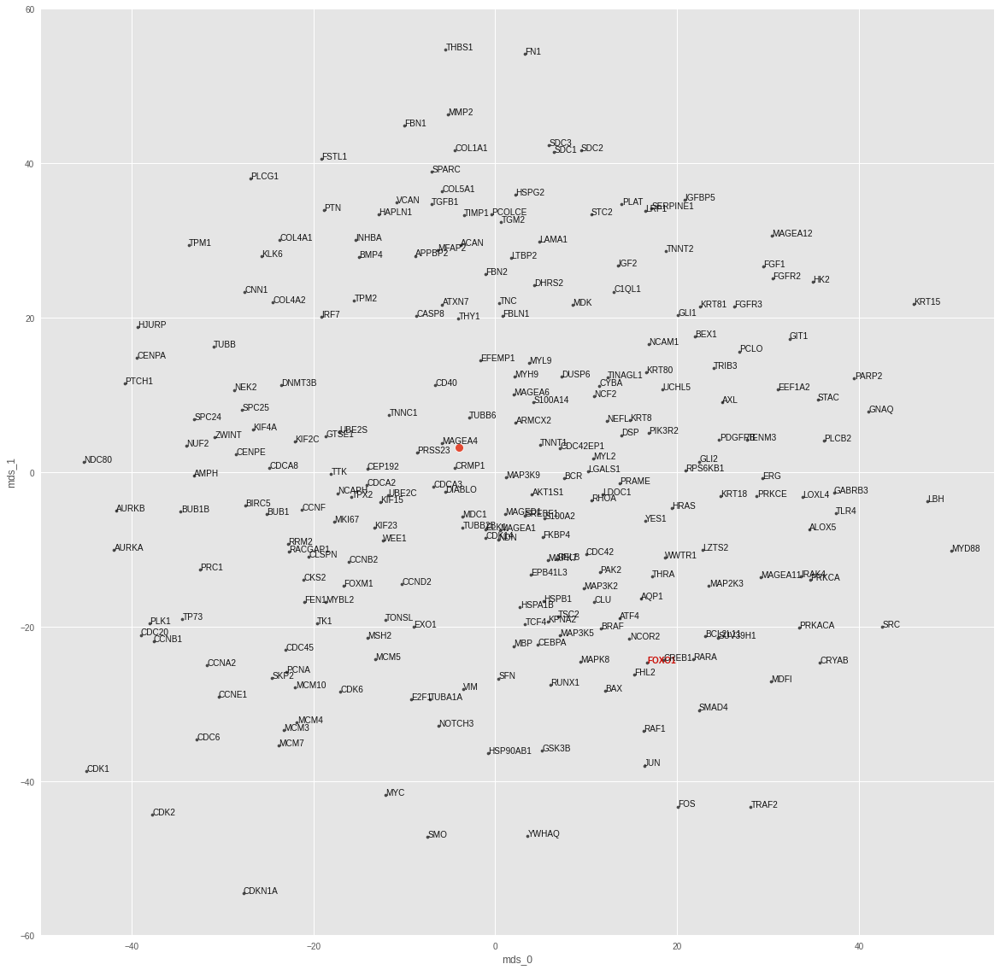

GLI1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.2197096857585405
train top-k accuracies: {1: 0.710526, 3: 0.789474, 5: 0.815789, 10: 0.868421, 20: 0.921053, 50: 0.947368}
train mean top-k accuracies: {1: 0.710526, 3: 0.789474, 5: 0.815789, 10: 0.868421, 20: 0.921053, 50: 0.947368}
test loss: 1.2007675170898438
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


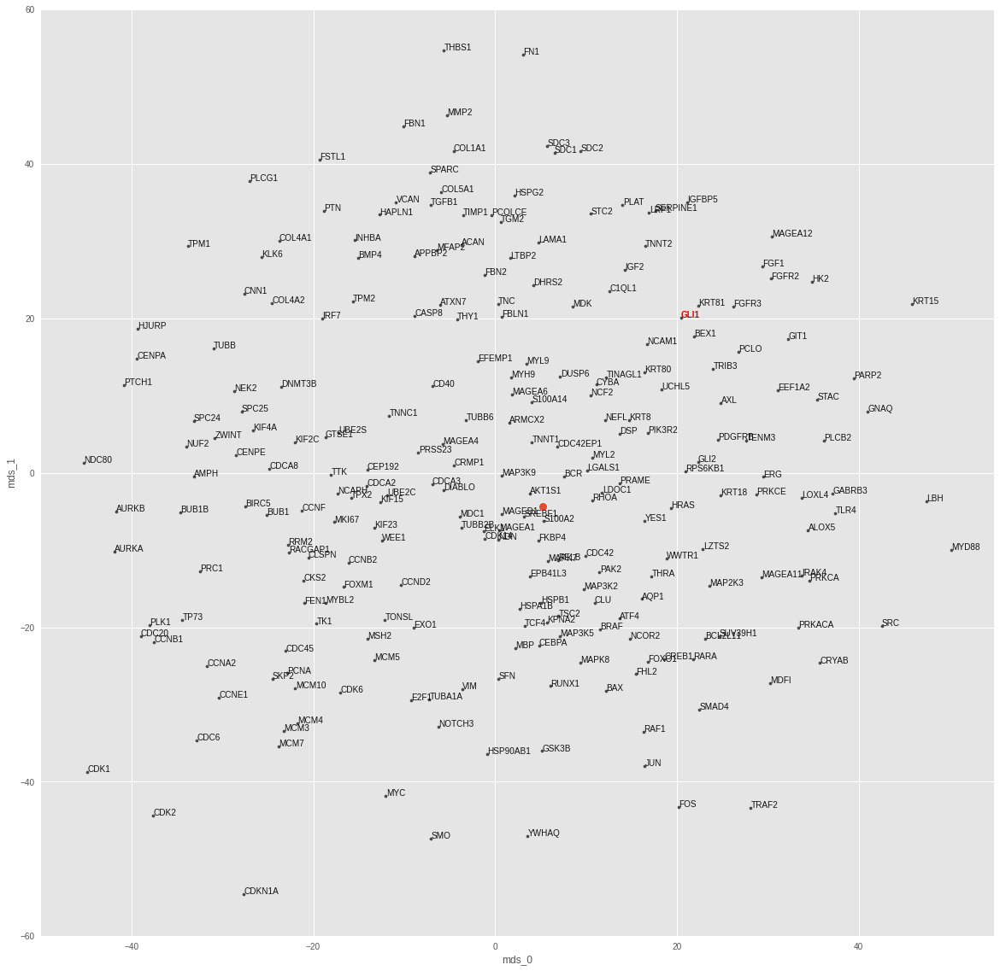

HRAS
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.22423128077858373
train top-k accuracies: {1: 0.657895, 3: 0.789474, 5: 0.815789, 10: 0.921053, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.657895, 3: 0.789474, 5: 0.815789, 10: 0.921053, 20: 0.921053, 50: 0.973684}
test loss: 2.686246395111084
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


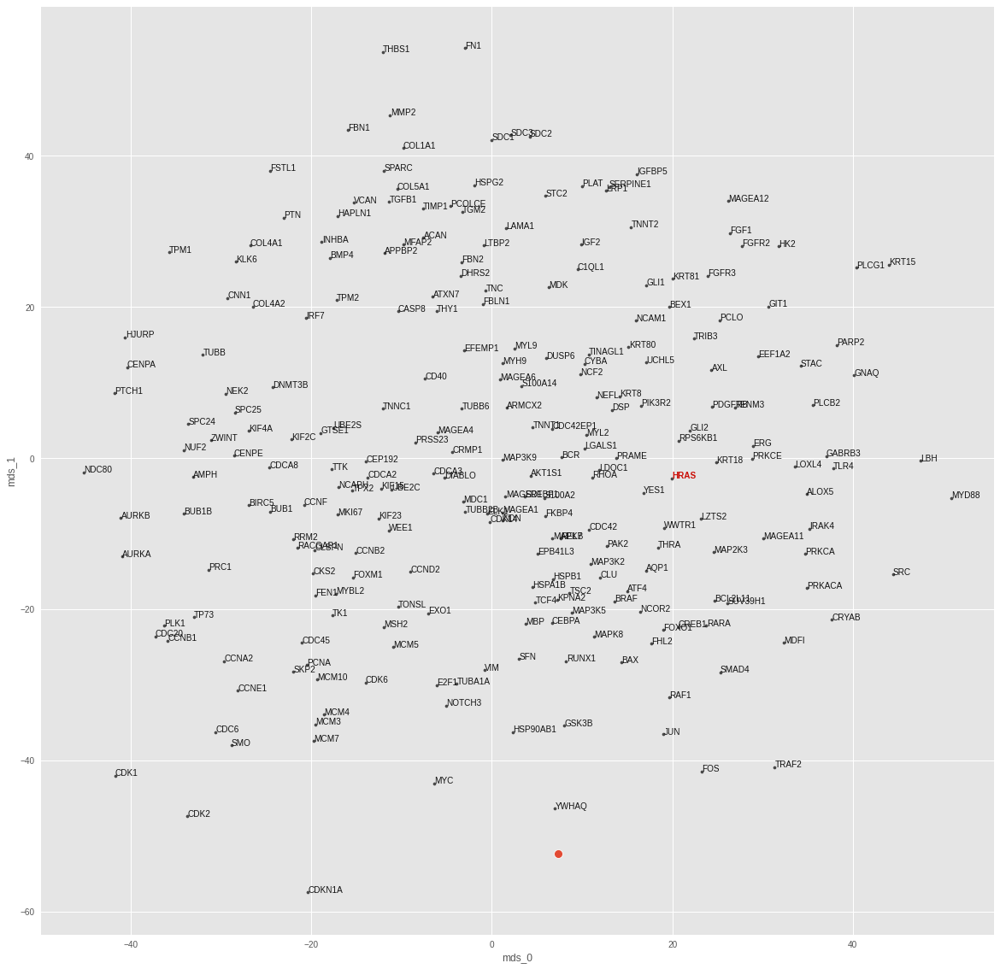

IRAK4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.21972065066036425
train top-k accuracies: {1: 0.657895, 3: 0.763158, 5: 0.842105, 10: 0.894737, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.657895, 3: 0.763158, 5: 0.842105, 10: 0.894737, 20: 0.921053, 50: 0.973684}
test loss: 1.1662647724151611
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


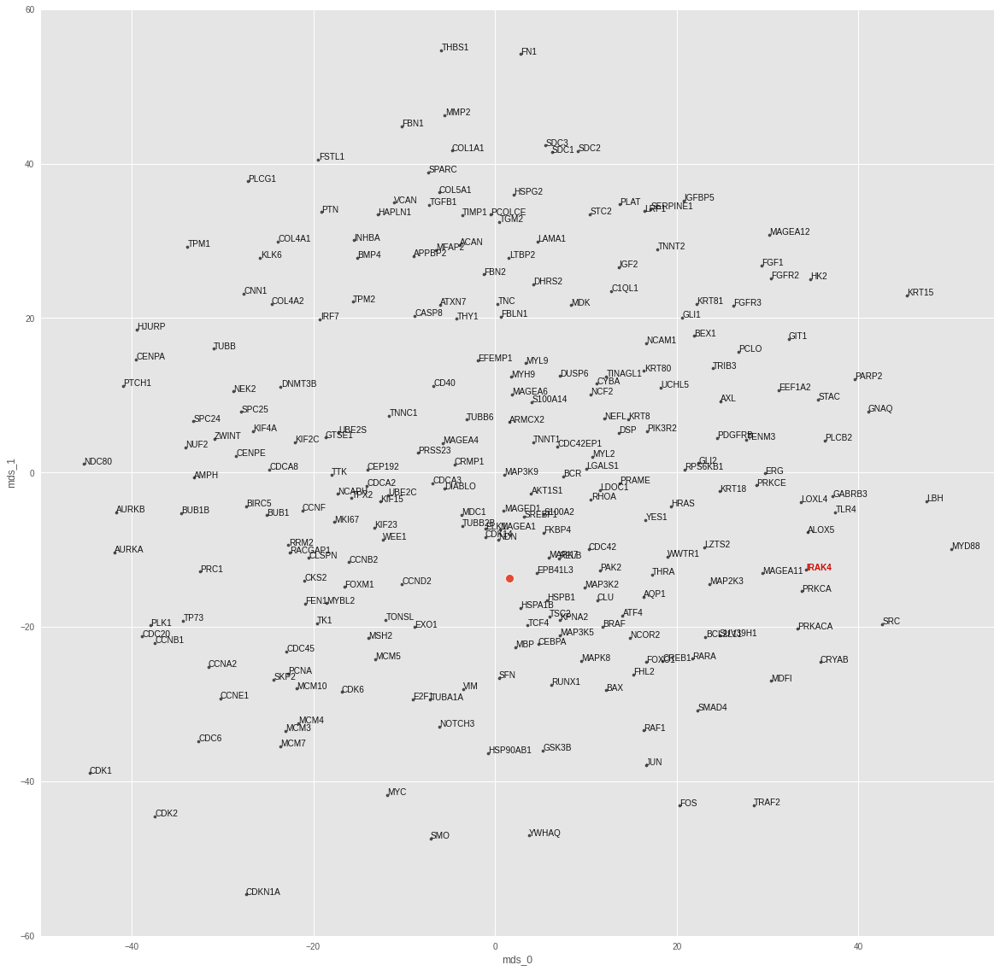

JUN
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.22665803840285853
train top-k accuracies: {1: 0.657895, 3: 0.736842, 5: 0.789474, 10: 0.868421, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.657895, 3: 0.736842, 5: 0.789474, 10: 0.868421, 20: 0.921053, 50: 0.973684}
test loss: 1.8500598669052124
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


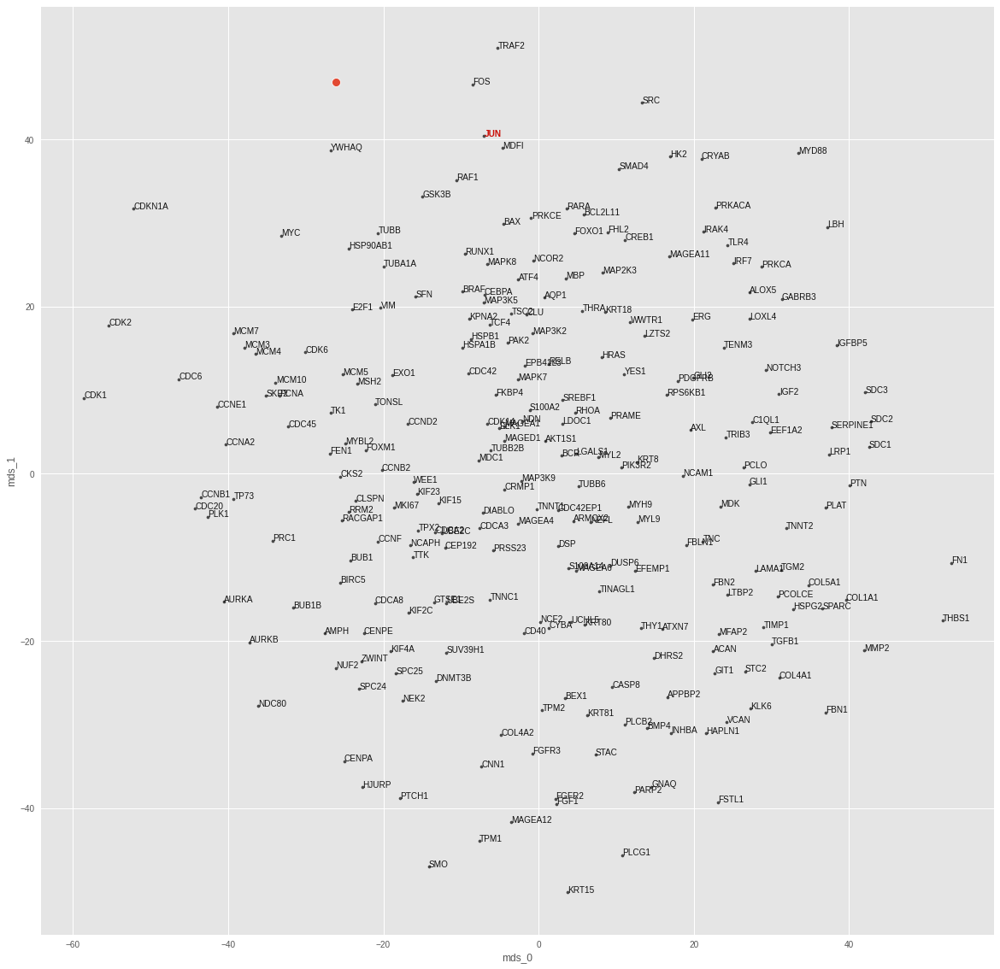

MAP2K3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.2262292394512578
train top-k accuracies: {1: 0.631579, 3: 0.789474, 5: 0.815789, 10: 0.894737, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.631579, 3: 0.789474, 5: 0.815789, 10: 0.894737, 20: 0.921053, 50: 0.973684}
test loss: 0.9888690710067749
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


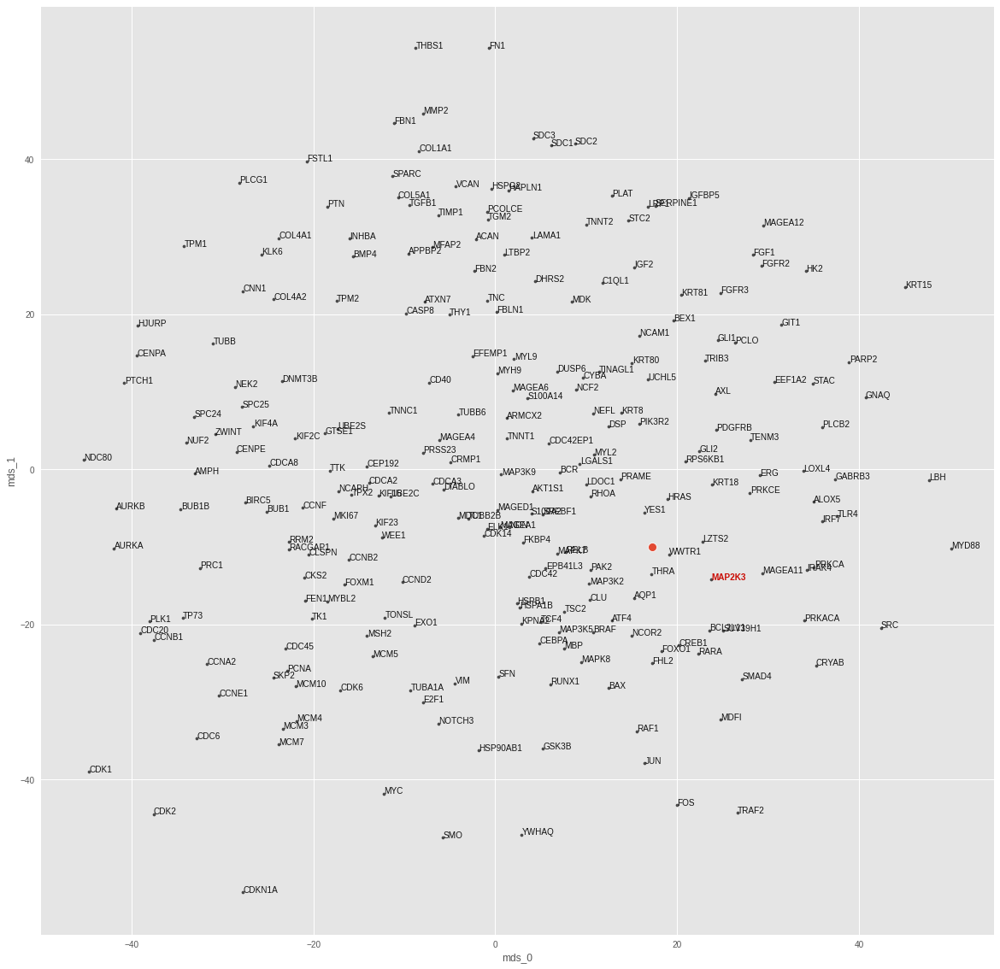

MAP3K2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.22953042701670998
train top-k accuracies: {1: 0.657895, 3: 0.789474, 5: 0.789474, 10: 0.842105, 20: 0.894737, 50: 0.973684}
train mean top-k accuracies: {1: 0.657895, 3: 0.789474, 5: 0.789474, 10: 0.842105, 20: 0.894737, 50: 0.973684}
test loss: 0.4596402645111084
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


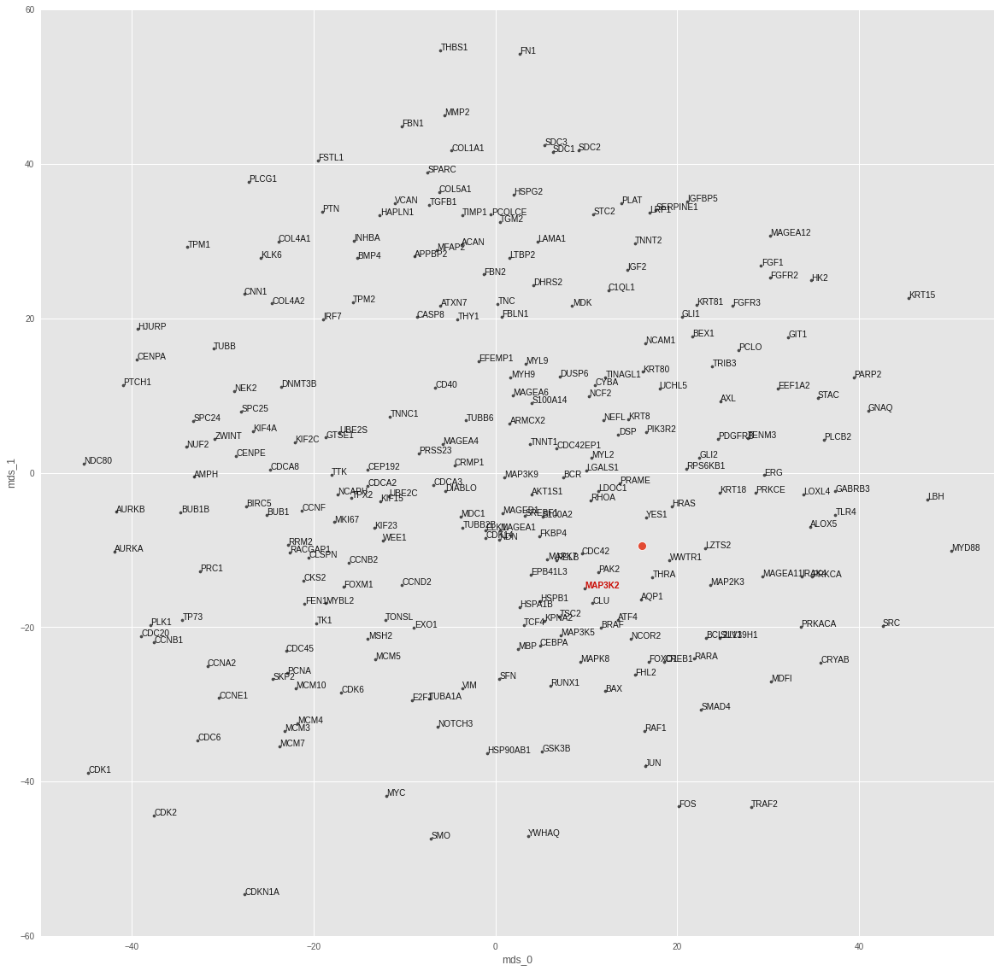

MAP3K5
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.2258915148283306
train top-k accuracies: {1: 0.657895, 3: 0.736842, 5: 0.789474, 10: 0.868421, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.657895, 3: 0.736842, 5: 0.789474, 10: 0.868421, 20: 0.921053, 50: 0.973684}
test loss: 0.45259010791778564
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


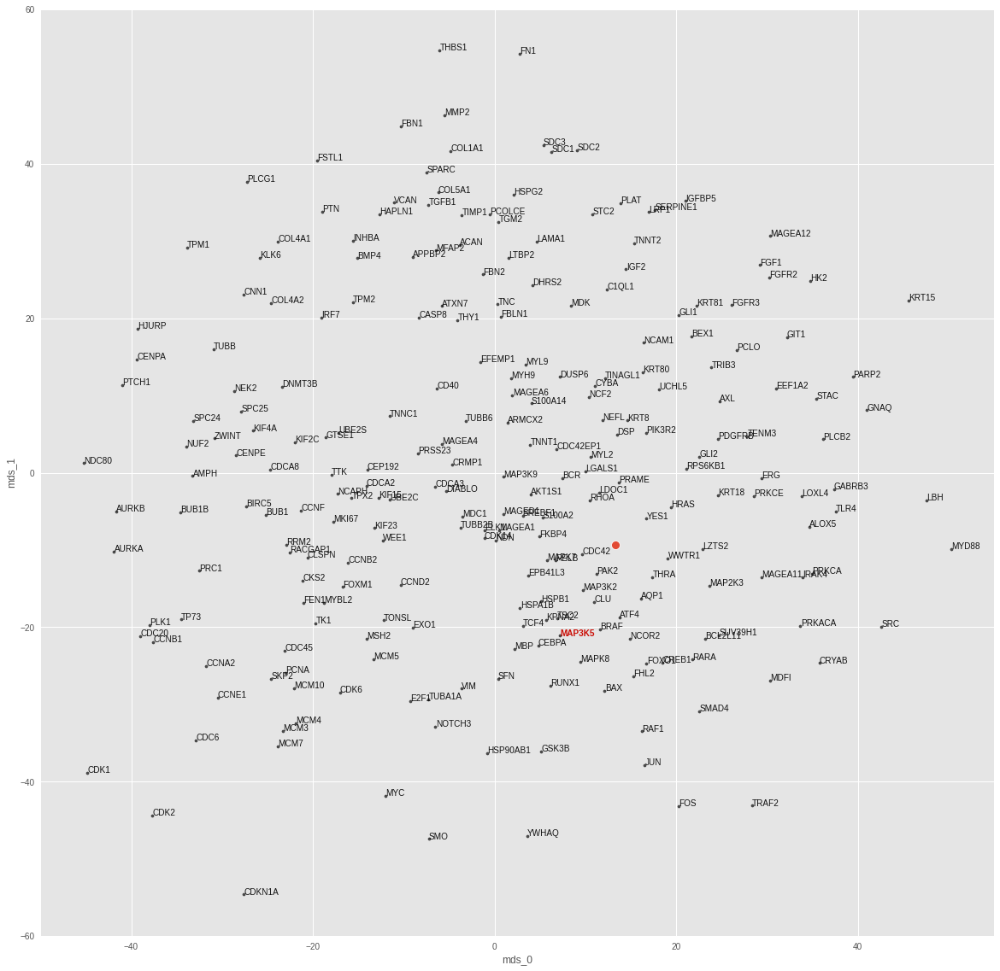

MAP3K9
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.2266047251851935
train top-k accuracies: {1: 0.657895, 3: 0.789474, 5: 0.815789, 10: 0.842105, 20: 0.921053, 50: 0.947368}
train mean top-k accuracies: {1: 0.657895, 3: 0.789474, 5: 0.815789, 10: 0.842105, 20: 0.921053, 50: 0.947368}
test loss: 1.2224446535110474
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


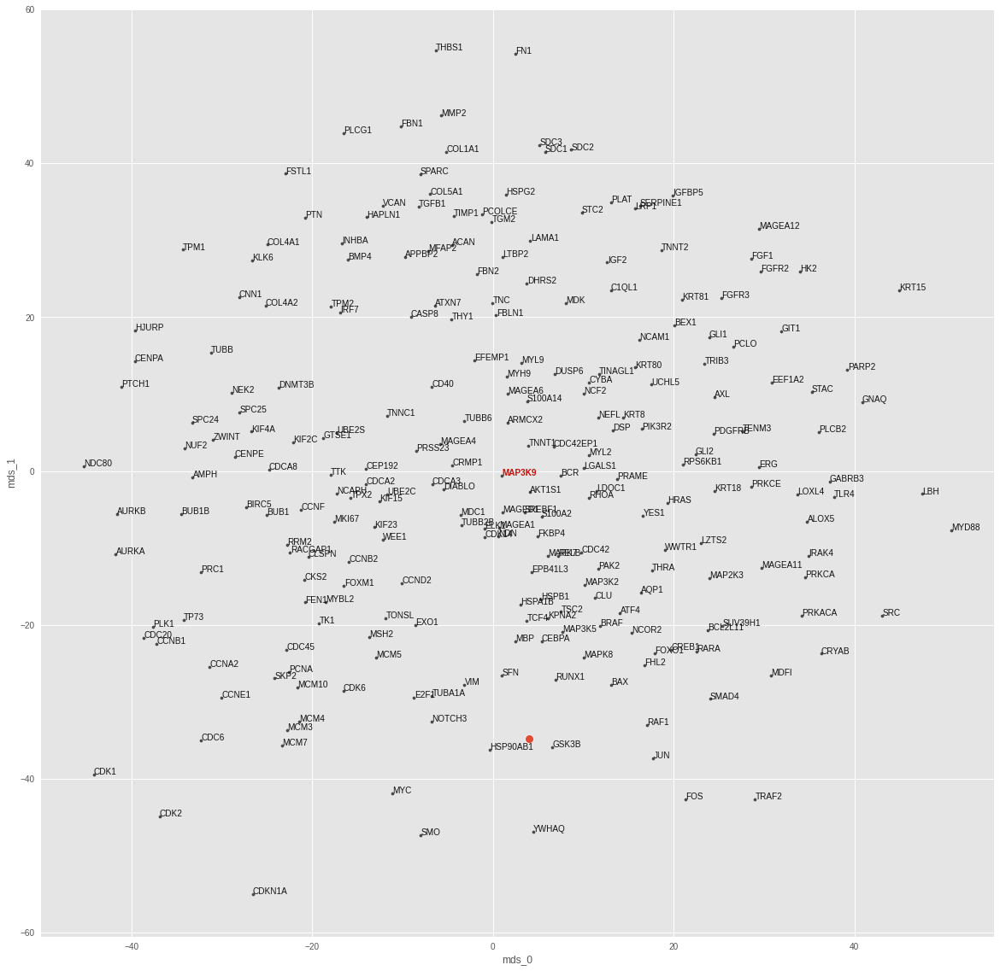

MAPK7
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.23218662487833122
train top-k accuracies: {1: 0.631579, 3: 0.763158, 5: 0.789474, 10: 0.894737, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.631579, 3: 0.763158, 5: 0.789474, 10: 0.894737, 20: 0.921053, 50: 0.973684}
test loss: 0.5378317832946777
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


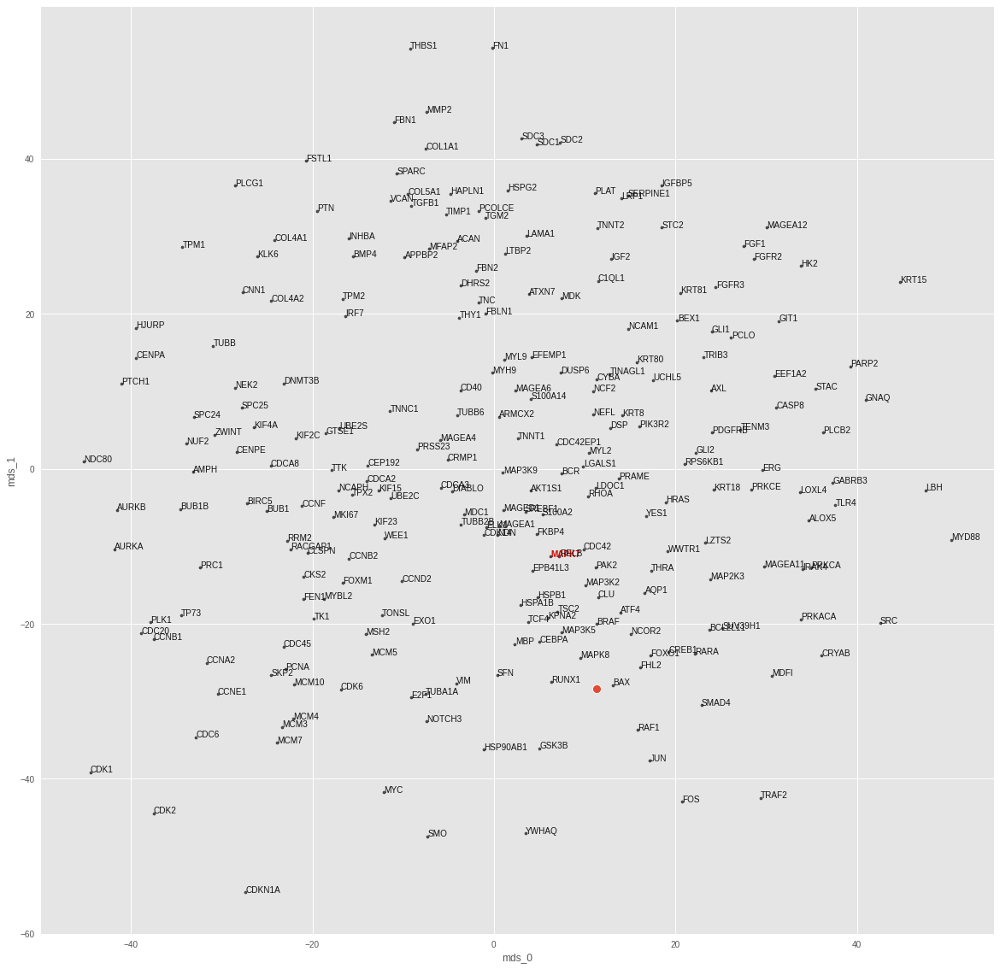

MYD88
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20365053258444132
train top-k accuracies: {1: 0.684211, 3: 0.815789, 5: 0.842105, 10: 0.947368, 20: 0.947368, 50: 0.973684}
train mean top-k accuracies: {1: 0.684211, 3: 0.815789, 5: 0.842105, 10: 0.947368, 20: 0.947368, 50: 0.973684}
test loss: 2.088955879211426
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


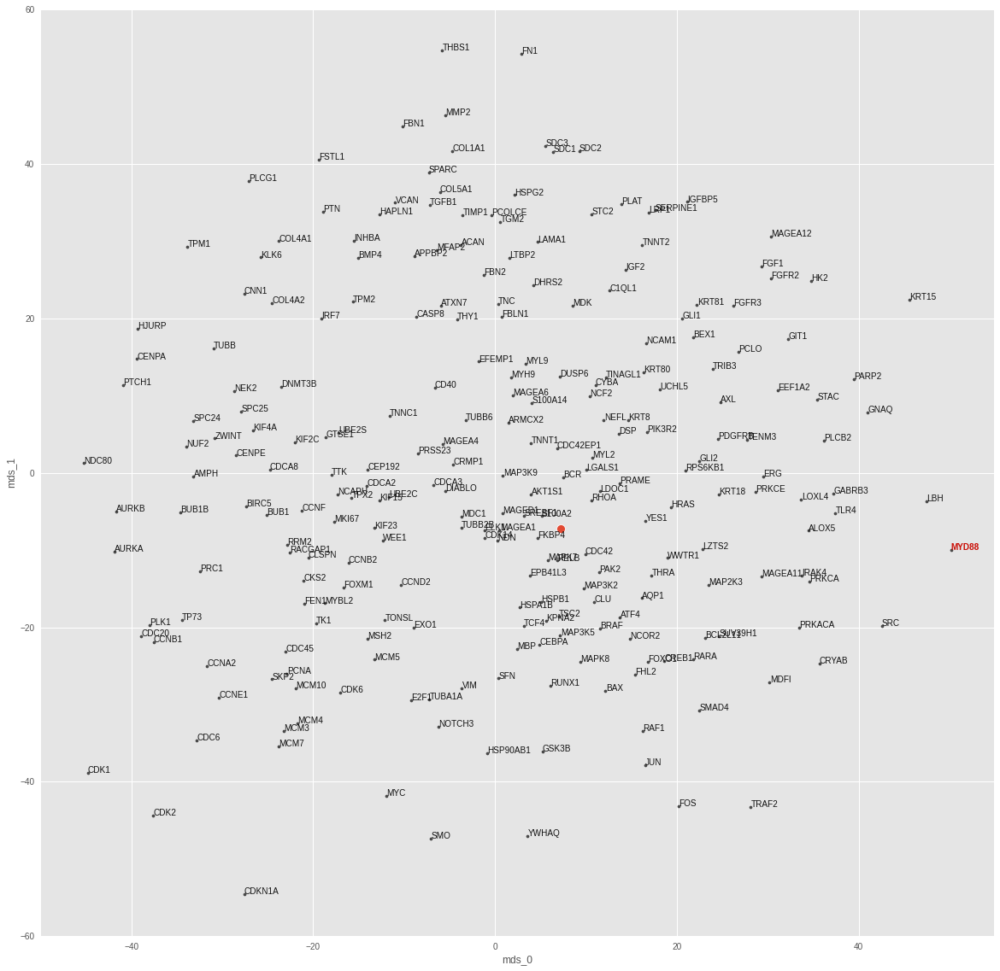

PIK3R2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.22791351848527006
train top-k accuracies: {1: 0.657895, 3: 0.763158, 5: 0.815789, 10: 0.868421, 20: 0.921053, 50: 0.947368}
train mean top-k accuracies: {1: 0.657895, 3: 0.763158, 5: 0.815789, 10: 0.868421, 20: 0.921053, 50: 0.947368}
test loss: 0.43104875087738037
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


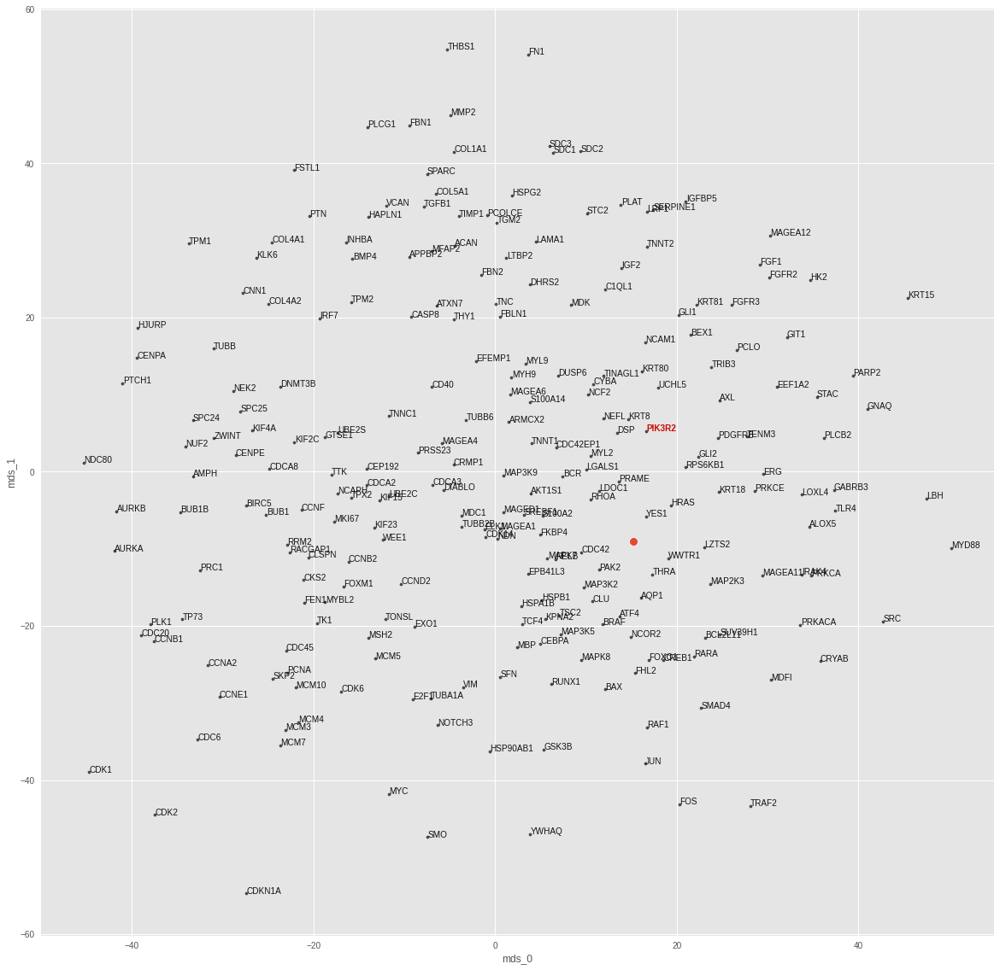

PRKACA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.2121198185180363
train top-k accuracies: {1: 0.710526, 3: 0.789474, 5: 0.815789, 10: 0.894737, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.710526, 3: 0.789474, 5: 0.815789, 10: 0.894737, 20: 0.921053, 50: 0.973684}
test loss: 2.8808820247650146
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


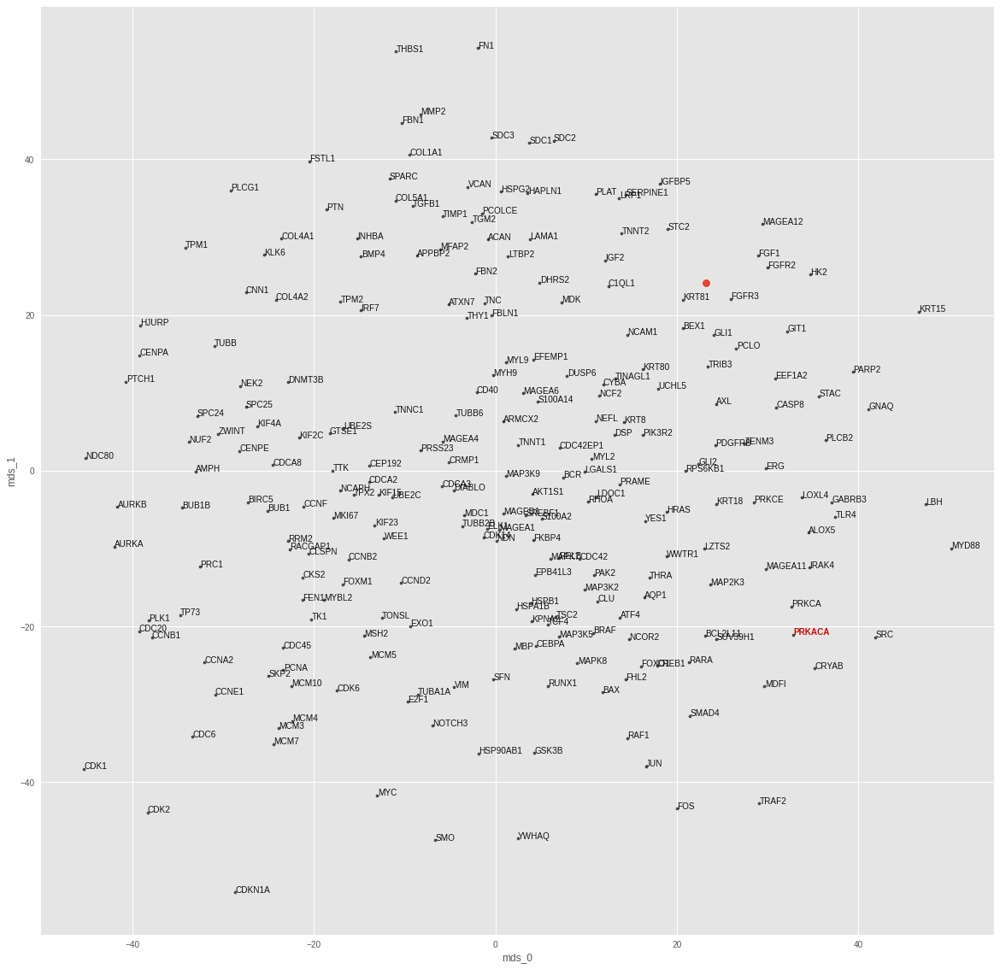

PRKCE
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.21639123872706764
train top-k accuracies: {1: 0.657895, 3: 0.763158, 5: 0.842105, 10: 0.921053, 20: 0.947368, 50: 0.973684}
train mean top-k accuracies: {1: 0.657895, 3: 0.763158, 5: 0.842105, 10: 0.921053, 20: 0.947368, 50: 0.973684}
test loss: 0.8852537274360657
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


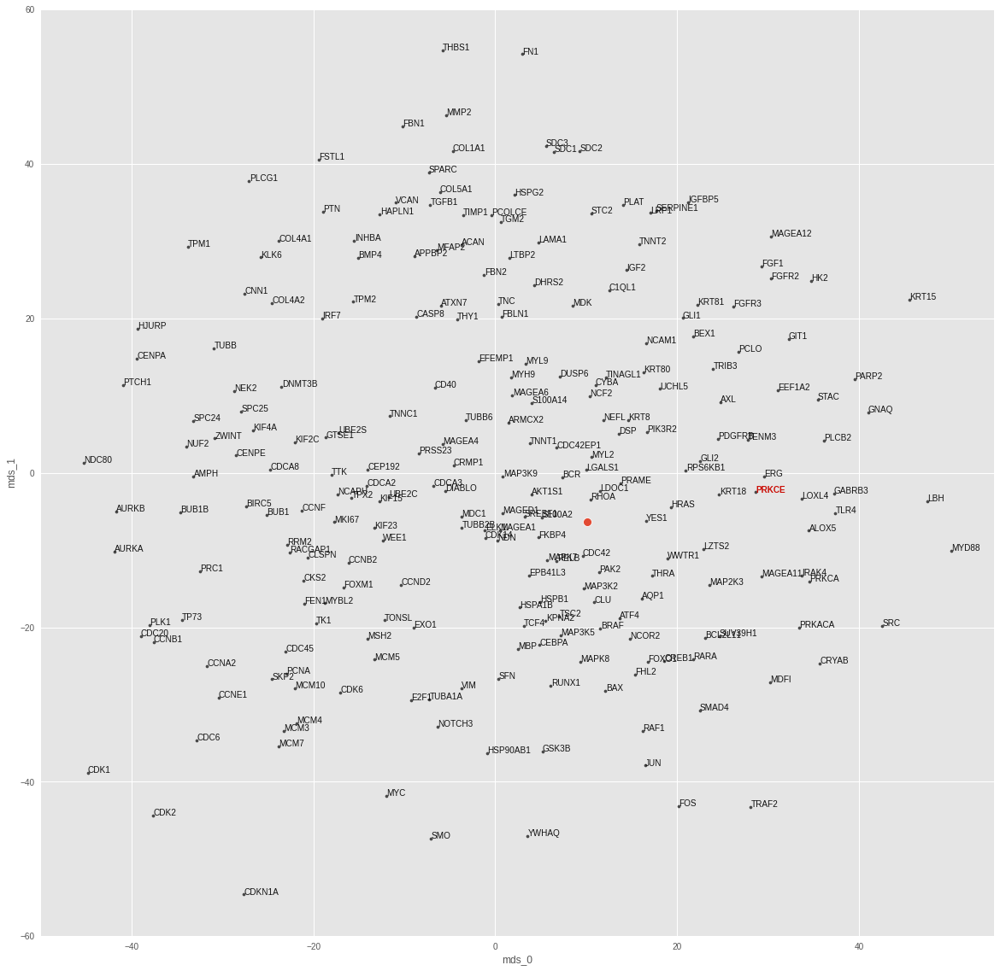

RAF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.22753545171336123
train top-k accuracies: {1: 0.684211, 3: 0.763158, 5: 0.789474, 10: 0.894737, 20: 0.947368, 50: 0.973684}
train mean top-k accuracies: {1: 0.684211, 3: 0.763158, 5: 0.789474, 10: 0.894737, 20: 0.947368, 50: 0.973684}
test loss: 1.0726624727249146
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


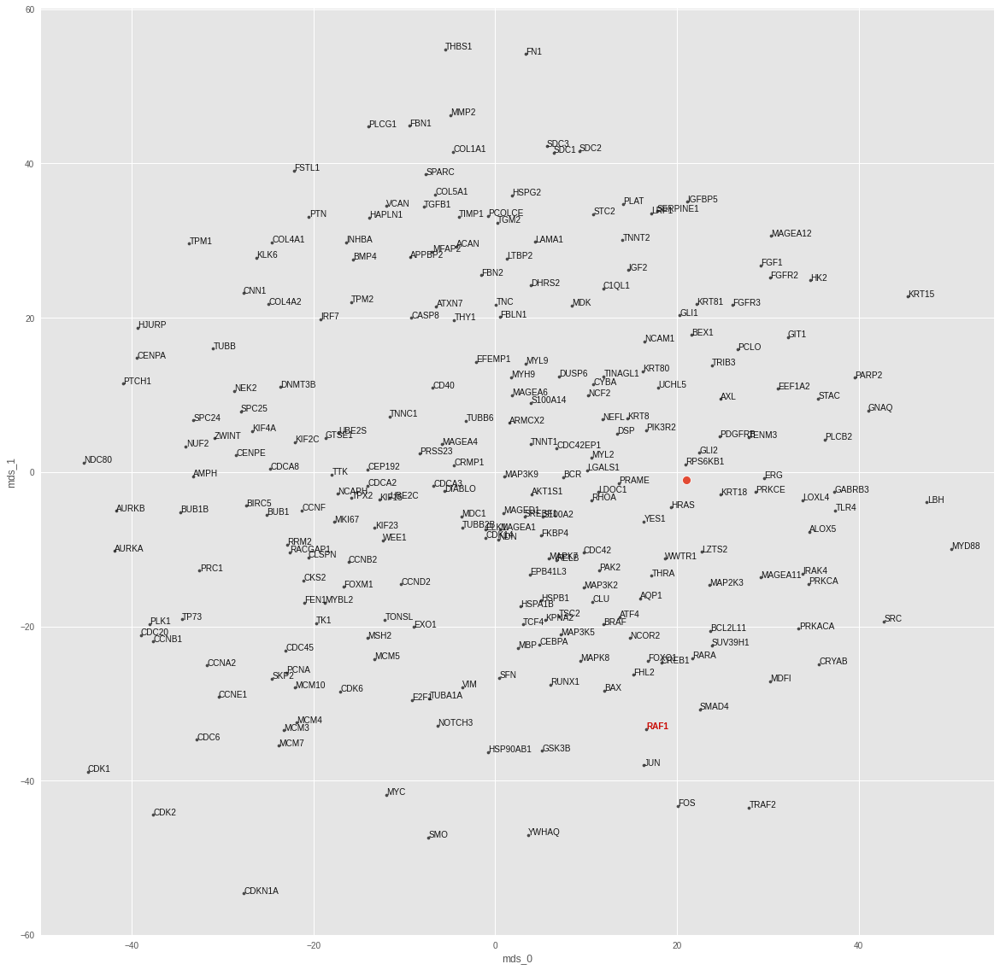

RELB
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.2253878022495069
train top-k accuracies: {1: 0.631579, 3: 0.736842, 5: 0.815789, 10: 0.894737, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.631579, 3: 0.736842, 5: 0.815789, 10: 0.894737, 20: 0.921053, 50: 0.973684}
test loss: 0.8107699751853943
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


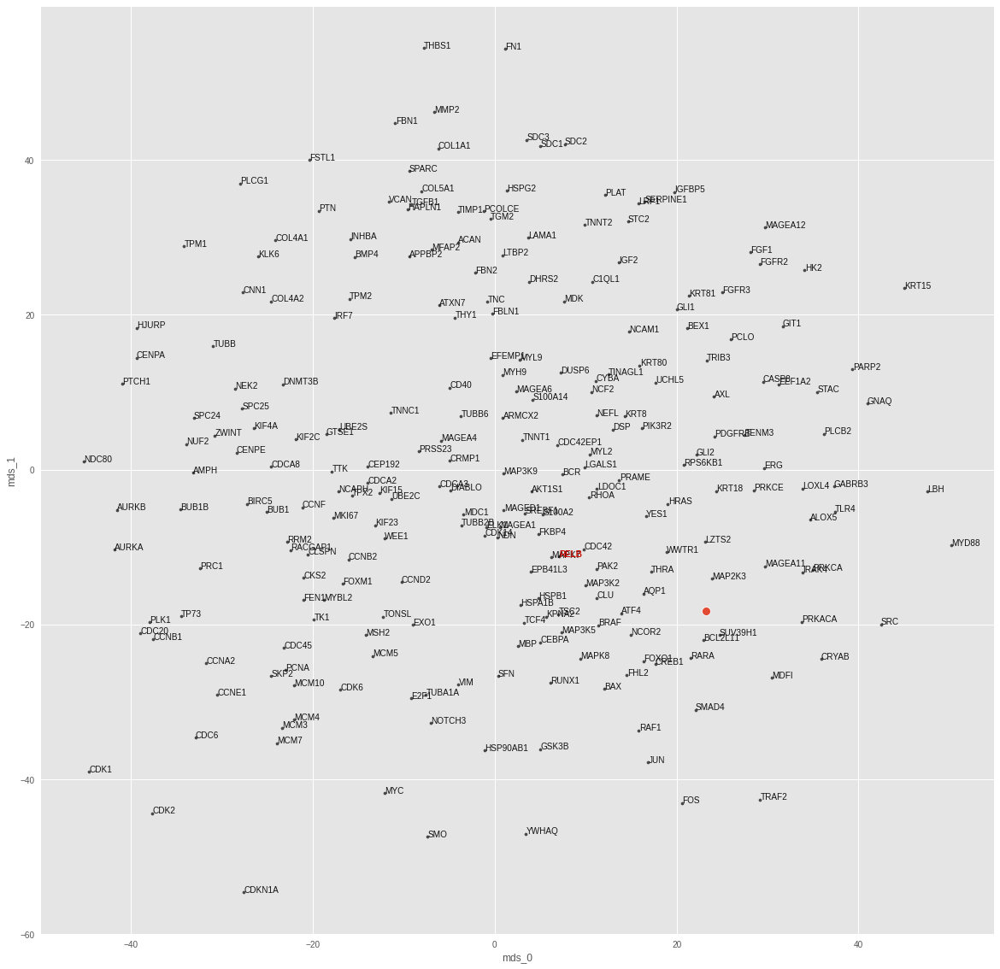

RHOA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.22348017912161977
train top-k accuracies: {1: 0.684211, 3: 0.815789, 5: 0.842105, 10: 0.868421, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.684211, 3: 0.815789, 5: 0.842105, 10: 0.868421, 20: 0.921053, 50: 0.973684}
test loss: 0.5586069822311401
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


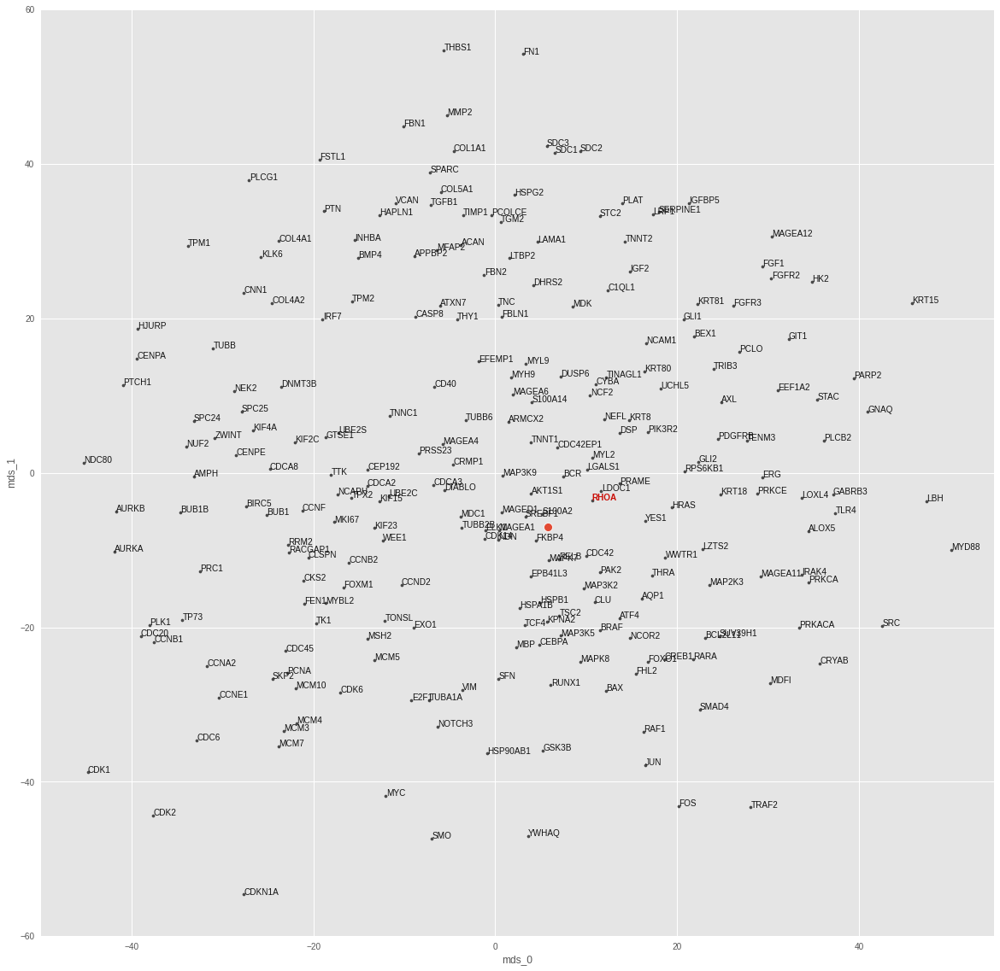

SMAD4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.22400967149358048
train top-k accuracies: {1: 0.631579, 3: 0.789474, 5: 0.842105, 10: 0.868421, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.631579, 3: 0.789474, 5: 0.842105, 10: 0.868421, 20: 0.921053, 50: 0.973684}
test loss: 0.8279035091400146
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


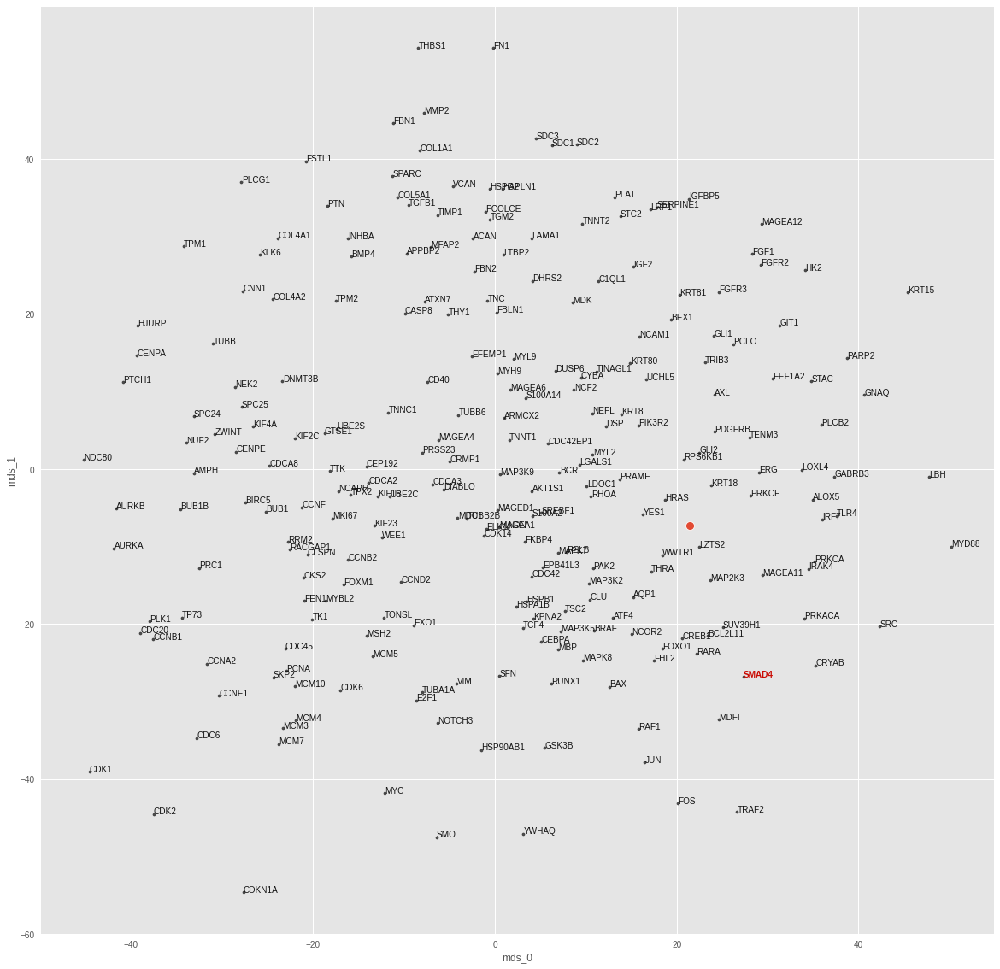

SMO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20065987737555252
train top-k accuracies: {1: 0.657895, 3: 0.815789, 5: 0.868421, 10: 0.868421, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.657895, 3: 0.815789, 5: 0.868421, 10: 0.868421, 20: 0.921053, 50: 0.973684}
test loss: 2.444624900817871
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


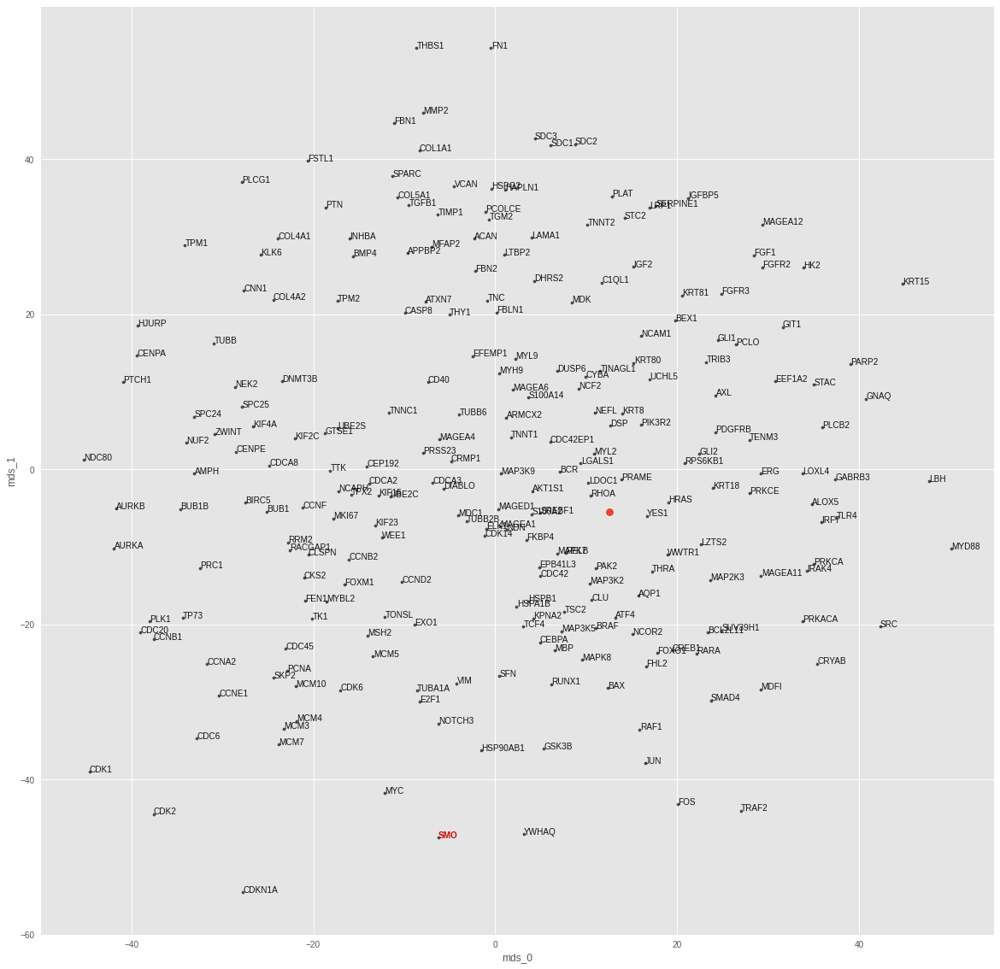

SRC
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20844740459793493
train top-k accuracies: {1: 0.710526, 3: 0.815789, 5: 0.842105, 10: 0.894737, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.710526, 3: 0.815789, 5: 0.842105, 10: 0.894737, 20: 0.921053, 50: 0.973684}
test loss: 1.68988037109375
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


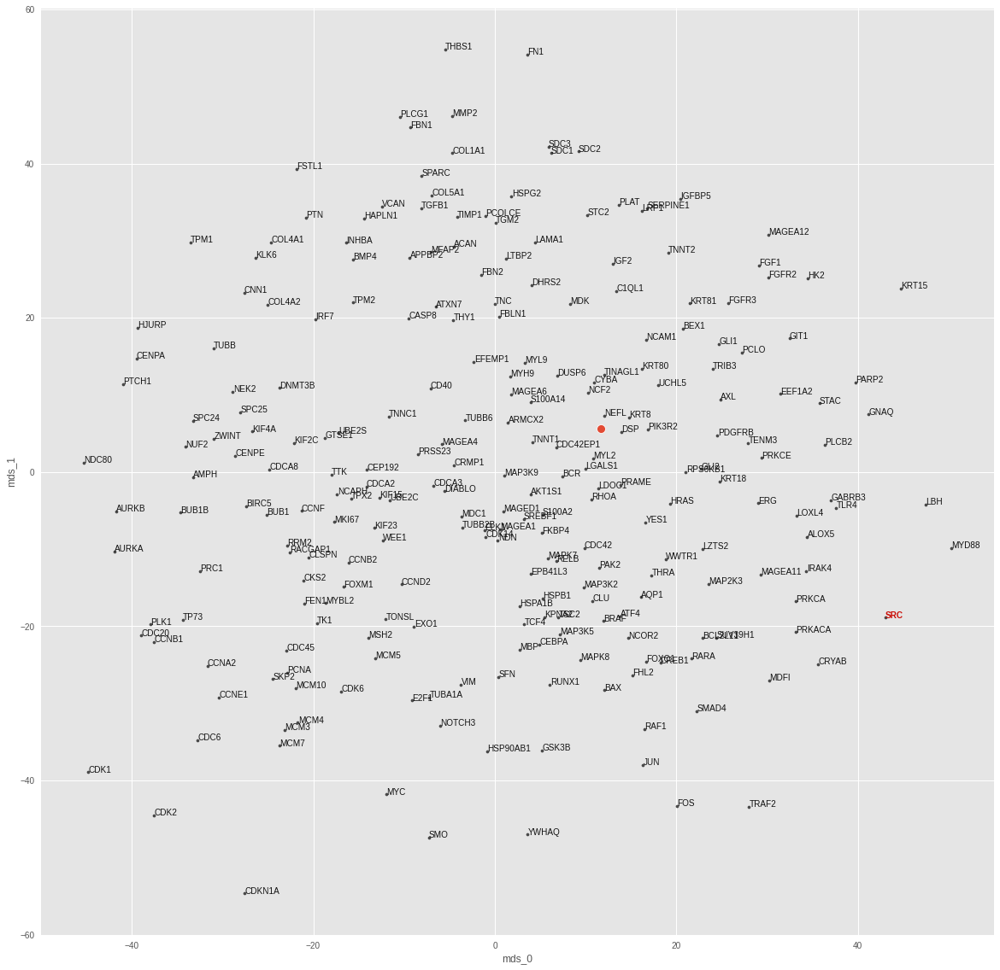

SREBF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.22719126077074753
train top-k accuracies: {1: 0.605263, 3: 0.763158, 5: 0.815789, 10: 0.921053, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.605263, 3: 0.763158, 5: 0.815789, 10: 0.921053, 20: 0.921053, 50: 0.973684}
test loss: 0.469383180141449
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


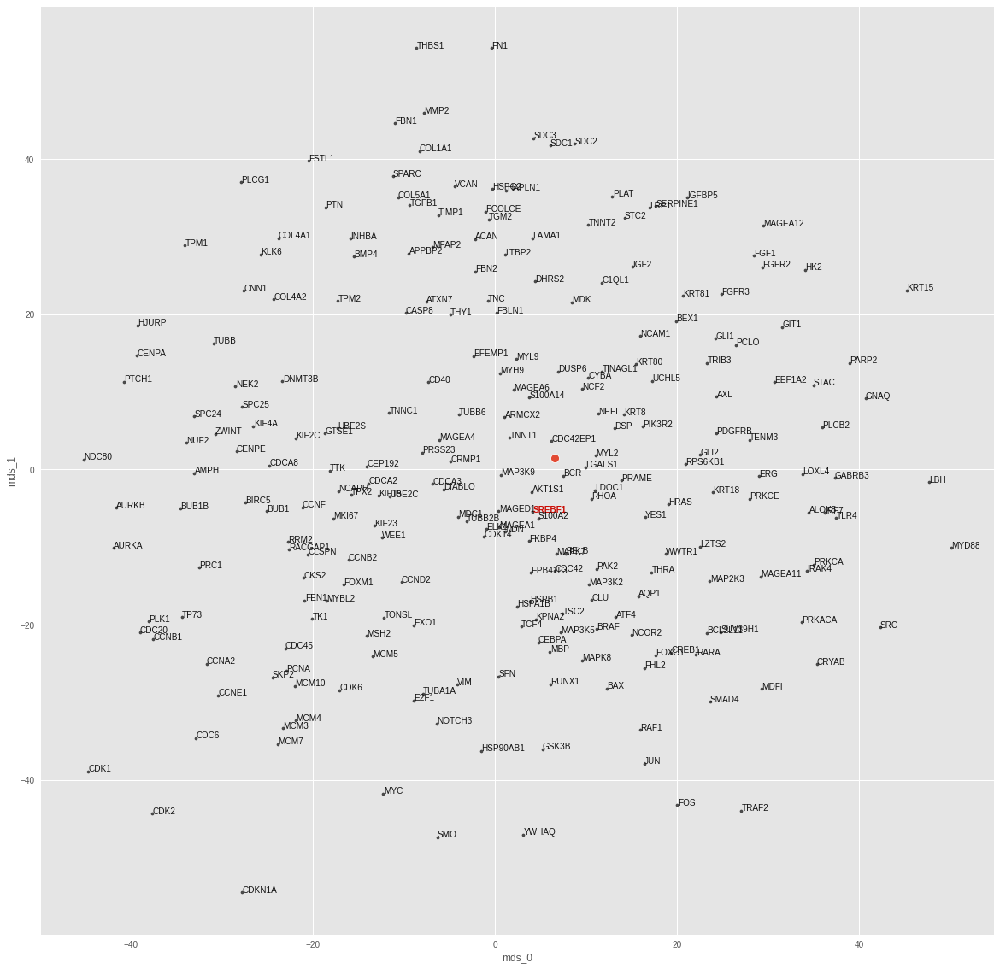

TRAF2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.19118472933769226
train top-k accuracies: {1: 0.684211, 3: 0.815789, 5: 0.842105, 10: 0.921053, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.684211, 3: 0.815789, 5: 0.842105, 10: 0.921053, 20: 0.947368, 50: 1.0}
test loss: 2.588865280151367
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


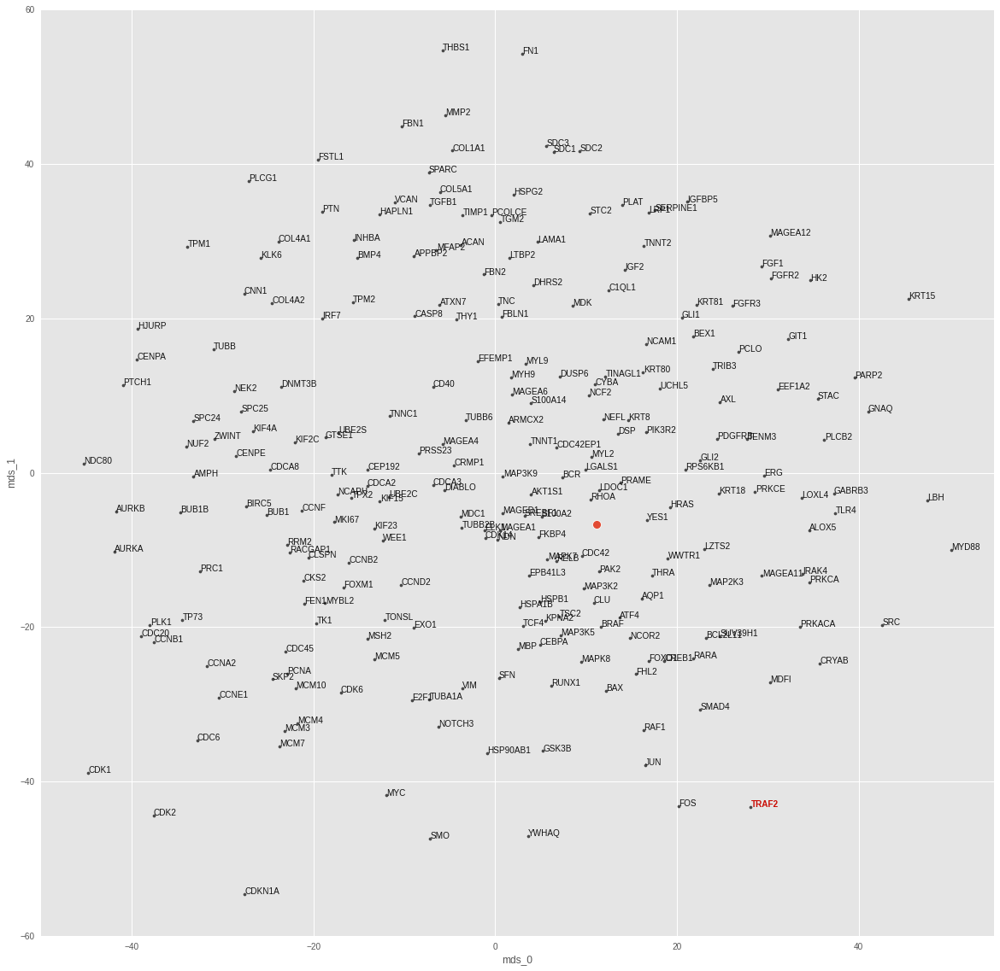

TSC2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.21935320527930008
train top-k accuracies: {1: 0.657895, 3: 0.763158, 5: 0.815789, 10: 0.868421, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.657895, 3: 0.763158, 5: 0.815789, 10: 0.868421, 20: 0.921053, 50: 0.973684}
test loss: 1.3448773622512817
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


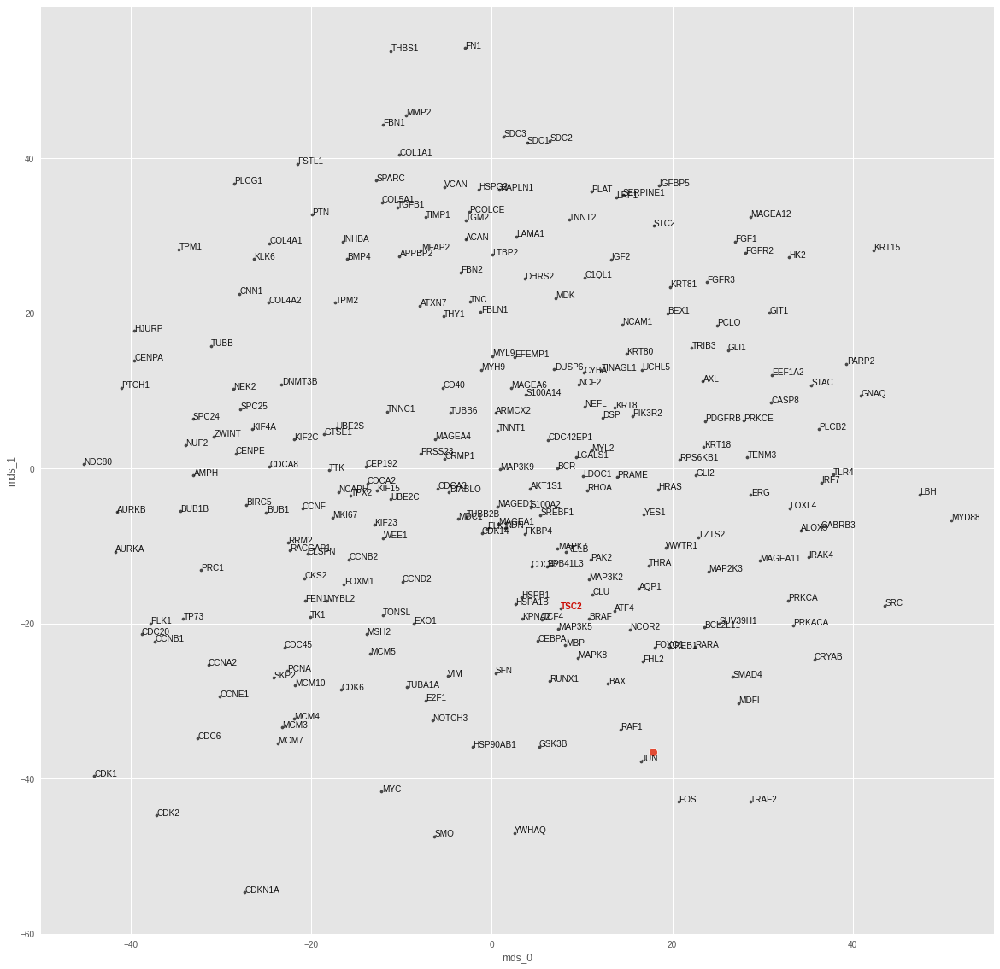

WWTR1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.21899683851944773
train top-k accuracies: {1: 0.657895, 3: 0.789474, 5: 0.868421, 10: 0.921053, 20: 0.921053, 50: 0.973684}
train mean top-k accuracies: {1: 0.657895, 3: 0.789474, 5: 0.868421, 10: 0.921053, 20: 0.921053, 50: 0.973684}
test loss: 2.653019905090332
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


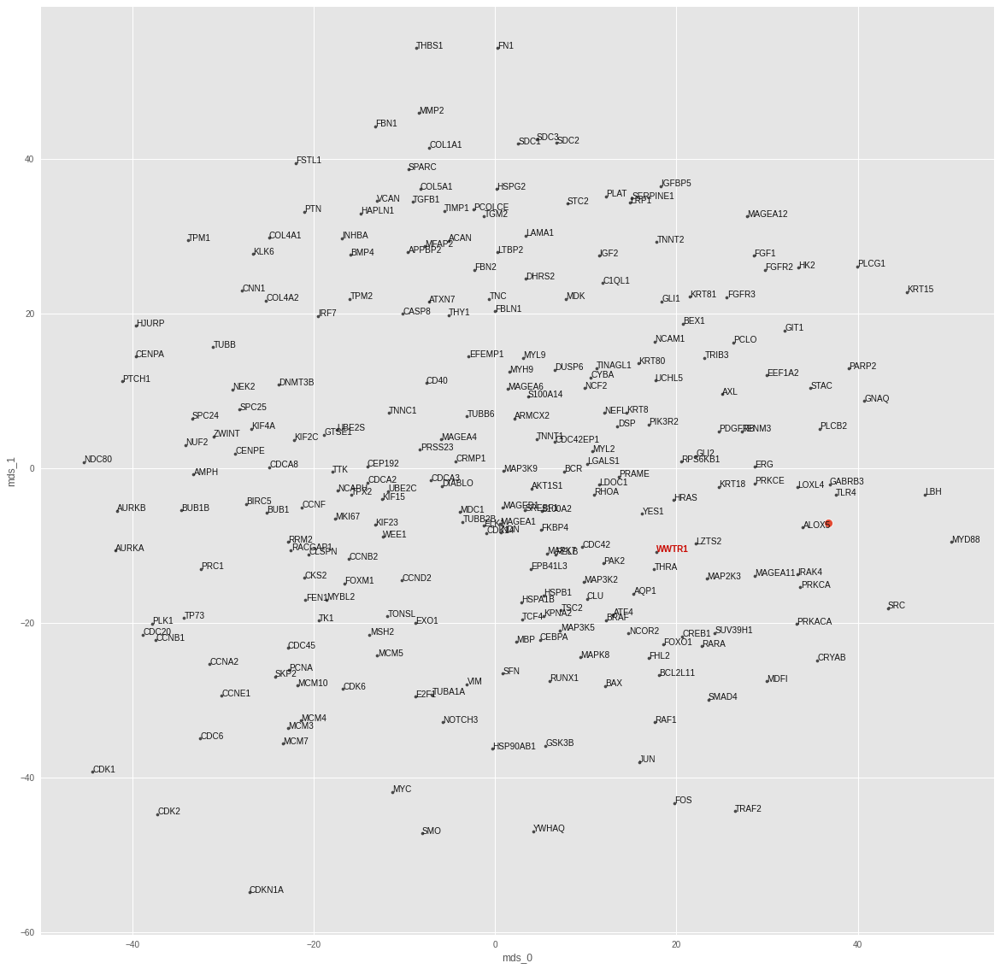

<IPython.core.display.Javascript object>

In [21]:
target_topk_accs = {}
mean_lin_nns = {}
for i in tqdm(range(len(data_dicts))):
    data_dict = data_dicts[i]
    model = torch.nn.Sequential(
        torch.nn.Linear(1024, 1024),
    )
    optimizer = Adam(model.parameters(), lr=1e-3)
    criterion = torch.nn.MSELoss()
    target = sorted(list(shared_targets))[i]
    print(target)
    fitted_model, topk_acc, _, mean_knns = train_model_topk_acc(
        model=model,
        data_dict=data_dict,
        optimizer=optimizer,
        criterion=criterion,
        n_epochs=1000,
        early_stopping=1000,
        nn_clf=nn_clf,
        log_epochs=False,
        use_val_data=False,
    )
    target_topk_accs[target] = topk_acc
    mean_lin_nns[target] = mean_knns[0]
    fig, ax, _ = plot_translation(
        fitted_model.to("cpu"),
        data_dict["test"].dataset,
        node_embs,
        figsize=[20, 20],
        crop=False,
        highlight_target=target,
        pred_size=100,
        reg_size=10,
    )
    ax.get_legend().remove()
    plt.show()
    plt.close()

In [22]:
mean_lin_topk_df = pd.DataFrame(target_topk_accs).transpose()
mean_lin_topk_df.loc[mean_lin_topk_df.loc[:, 50] > 0].sort_values(
    [1, 3, 5, 10, 20, 50], ascending=False
)

,1,3,5,10,20,50
AKT1S1,0.0,1.0,1.0,1.0,1.0,1.0
MAP3K2,0.0,1.0,1.0,1.0,1.0,1.0
SREBF1,0.0,1.0,1.0,1.0,1.0,1.0
BRAF,0.0,0.0,0.0,1.0,1.0,1.0
CDC42,0.0,0.0,0.0,1.0,1.0,1.0
ELK1,0.0,0.0,0.0,0.0,1.0,1.0
MAP3K5,0.0,0.0,0.0,0.0,1.0,1.0
MAPK7,0.0,0.0,0.0,0.0,1.0,1.0
PIK3R2,0.0,0.0,0.0,0.0,1.0,1.0
RELB,0.0,0.0,0.0,0.0,1.0,1.0


<IPython.core.display.Javascript object>

In [23]:
mean_lin_topk_df.describe()

,1,3,5,10,20,50
count,39.0,39.000000,39.000000,39.000000,39.000000,39.000000
mean,0.0,0.076923,0.076923,0.128205,0.256410,0.564103
std,0.0,0.269953,0.269953,0.338688,0.442359,0.502356
min,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.0,0.000000,0.000000,0.000000,0.000000,1.000000
75%,0.0,0.000000,0.000000,0.000000,0.500000,1.000000
max,0.0,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

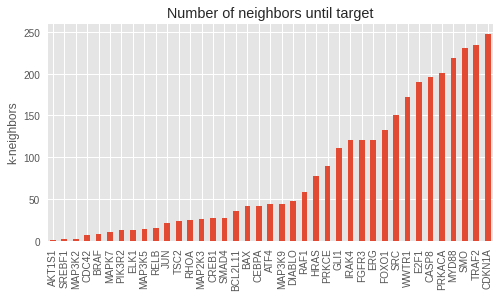

<IPython.core.display.Javascript object>

In [24]:
mpl.style.use("ggplot")
mean_lin_khits = get_knn_hit_data(mean_lin_nns)
ax = mean_lin_khits.knn_hit.sort_values().plot(kind="bar", figsize=[8, 4])
ax.set_ylabel("k-neighbors")
ax.set_title("Number of neighbors until target")
plt.show()

In [27]:
mean_5nn_dict = get_mean_knn_dict(img_embs_fold0, k=10)
mean_5nn_dict["SREBF1"]

['FOXO1',
 'SMO',
 'RHOA',
 'MYD88',
 'DIABLO',
 'AKT1S1',
 'GLI1',
 'PRKCE',
 'TRAF2',
 'WWTR1']

<IPython.core.display.Javascript object>

In [28]:
mean_lin_nns["SREBF1"]

array(['PRAME', 'AKT1S1', 'SREBF1', 'ELK1', 'MAGEA1', 'RPS6KB1', 'NDN',
       'PRSS23', 'RHOA', 'BCR', 'MAPK7', 'CDK14', 'TUBB2B', 'CDCA2',
       'TSC2', 'MYL2', 'TENM3', 'PDGFRB', 'LGALS1', 'MAP3K2', 'IRF7',
       'FOXO1', 'MAGEA6', 'TNNC1', 'THRA', 'GLI1', 'UBE2C', 'MDC1',
       'WWTR1', 'CEP192', 'MAP3K9', 'HRAS', 'MBP', 'KIF23', 'MDK', 'TPX2',
       'RELB', 'NCAPH', 'CEBPA', 'TLR4', 'MAGEA4', 'S100A14', 'DHRS2',
       'DUSP6', 'GLI2', 'NCOR2', 'CCND2', 'YES1', 'IRAK4', 'FBLN1',
       'UBE2S', 'AXL', 'HSPA1B', 'CCNF', 'KIF15', 'PIK3R2', 'CCNB2',
       'GTSE1', 'CRMP1', 'DIABLO', 'RARA', 'FHL2', 'KRT8', 'S100A2',
       'EPB41L3', 'MAP2K3', 'MAGED1', 'CDC42EP1', 'MAP3K5', 'KIF2C',
       'ARMCX2', 'SMAD4', 'PAK2', 'FOXM1', 'IGF2', 'MYL9', 'WEE1', 'ACAN',
       'CDCA3', 'MKI67', 'MAPK8', 'CLU', 'RRM2', 'MYH9', 'MAGEA11',
       'FKBP4', 'DSP', 'NEFL', 'TNC', 'MYBL2', 'CKS2', 'LDOC1', 'APPBP2',
       'BRAF', 'CREB1', 'TUBB6', 'TTK', 'PTCH1', 'BCL2L11', 'EXO1',
       'EFEMP1'

<IPython.core.display.Javascript object>

---

### 2.3. Nonlinear mean prediction

We do apply the same scheme using a simple 3-layer nonlinear network.

  0%|          | 0/39 [00:00<?, ?it/s]

AKT1S1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.17228455057269648
train top-k accuracies: {1: 0.710526, 3: 0.842105, 5: 0.894737, 10: 0.921053, 20: 0.973684, 50: 1.0}
train mean top-k accuracies: {1: 0.710526, 3: 0.842105, 5: 0.894737, 10: 0.921053, 20: 0.973684, 50: 1.0}
test loss: 0.24587829411029816
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


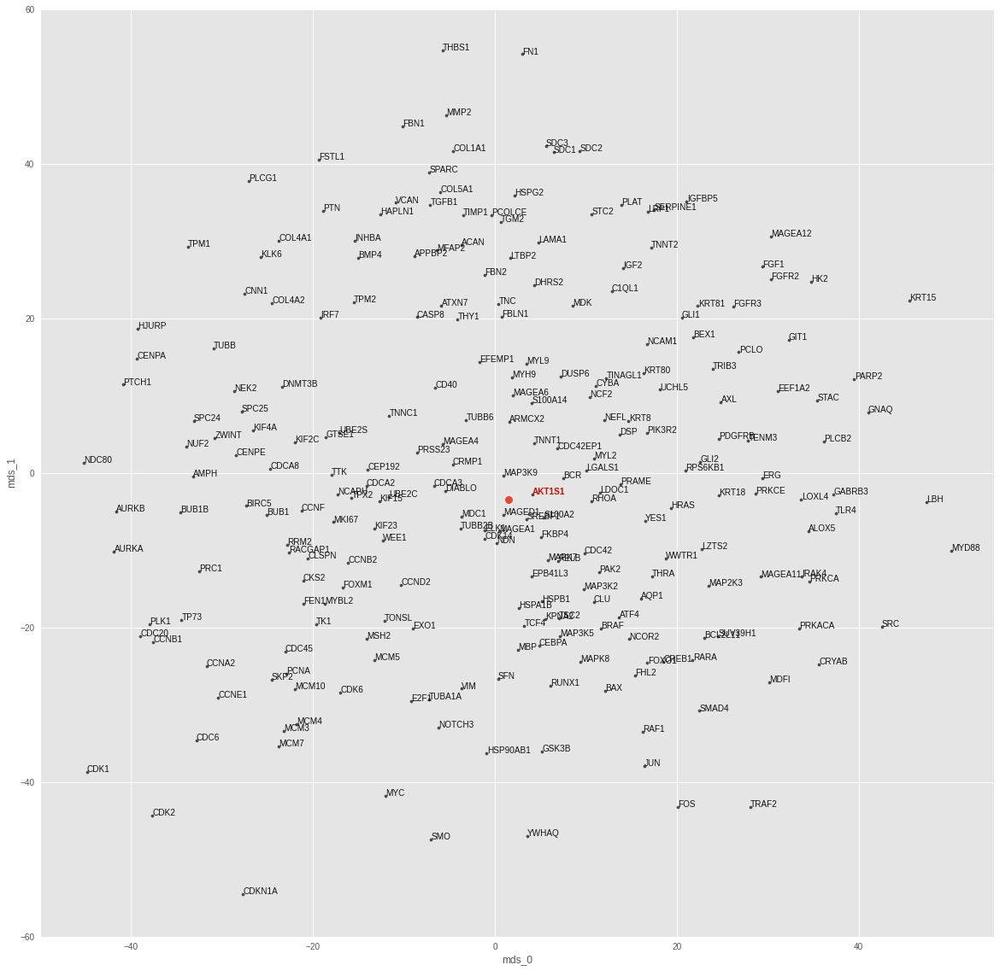

ATF4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.16973423800970378
train top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.921053, 10: 0.921053, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.921053, 10: 0.921053, 20: 0.947368, 50: 1.0}
test loss: 0.7154626846313477
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


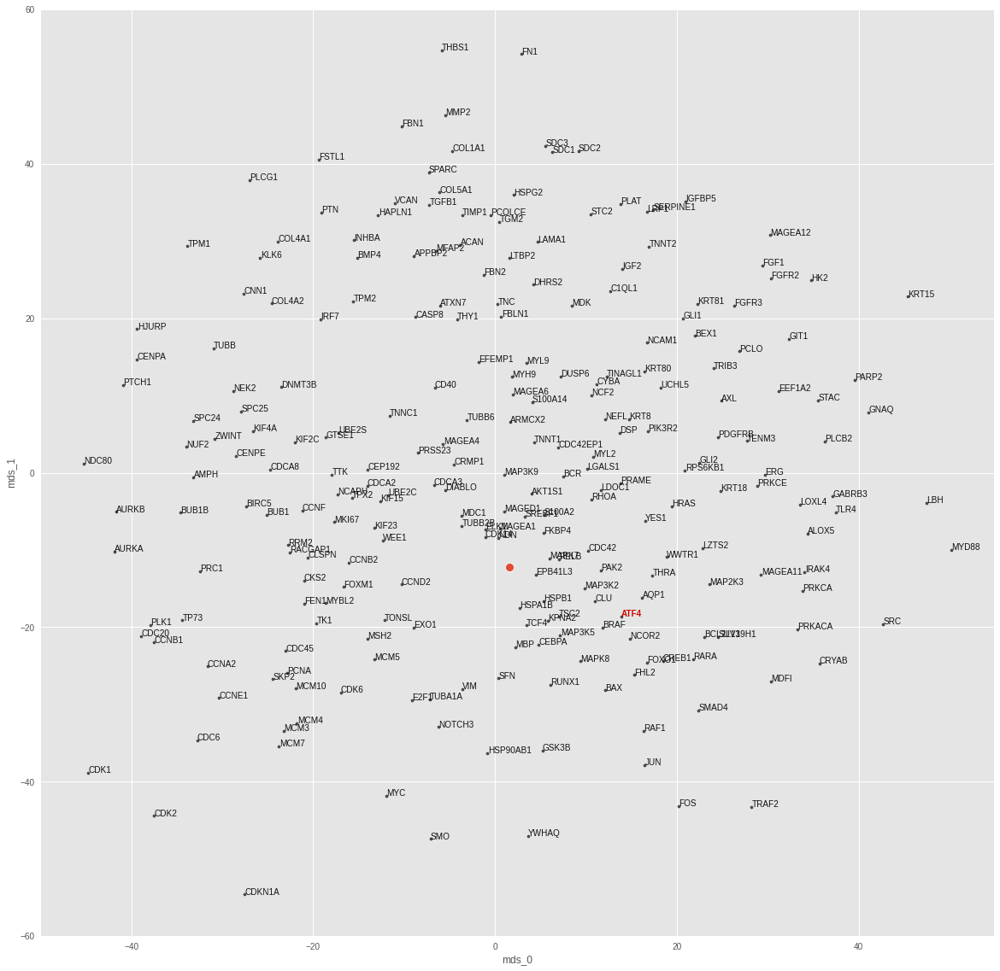

BAX
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.16763553180192647
train top-k accuracies: {1: 0.763158, 3: 0.868421, 5: 0.921053, 10: 0.947368, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.868421, 5: 0.921053, 10: 0.947368, 20: 0.947368, 50: 1.0}
test loss: 0.7674918174743652
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


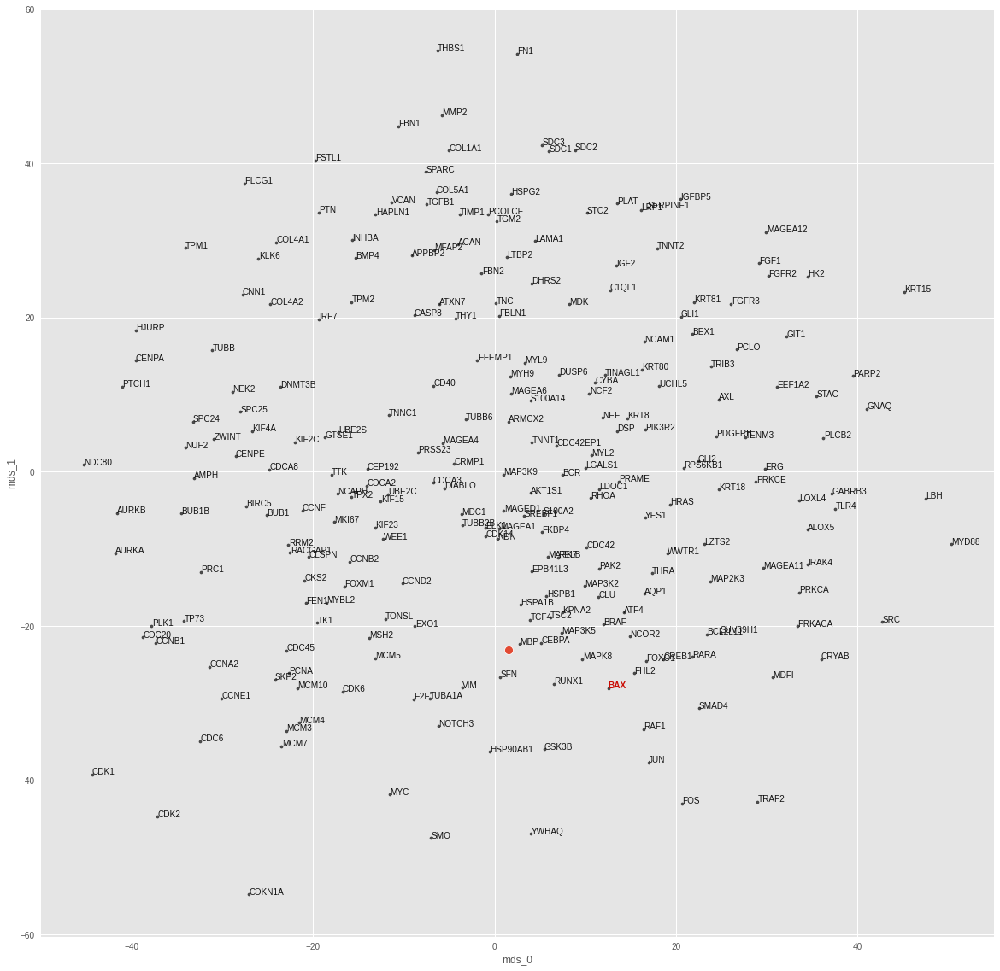

BCL2L11
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.1614325113202396
train top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.947368, 50: 1.0}
test loss: 1.2916195392608643
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


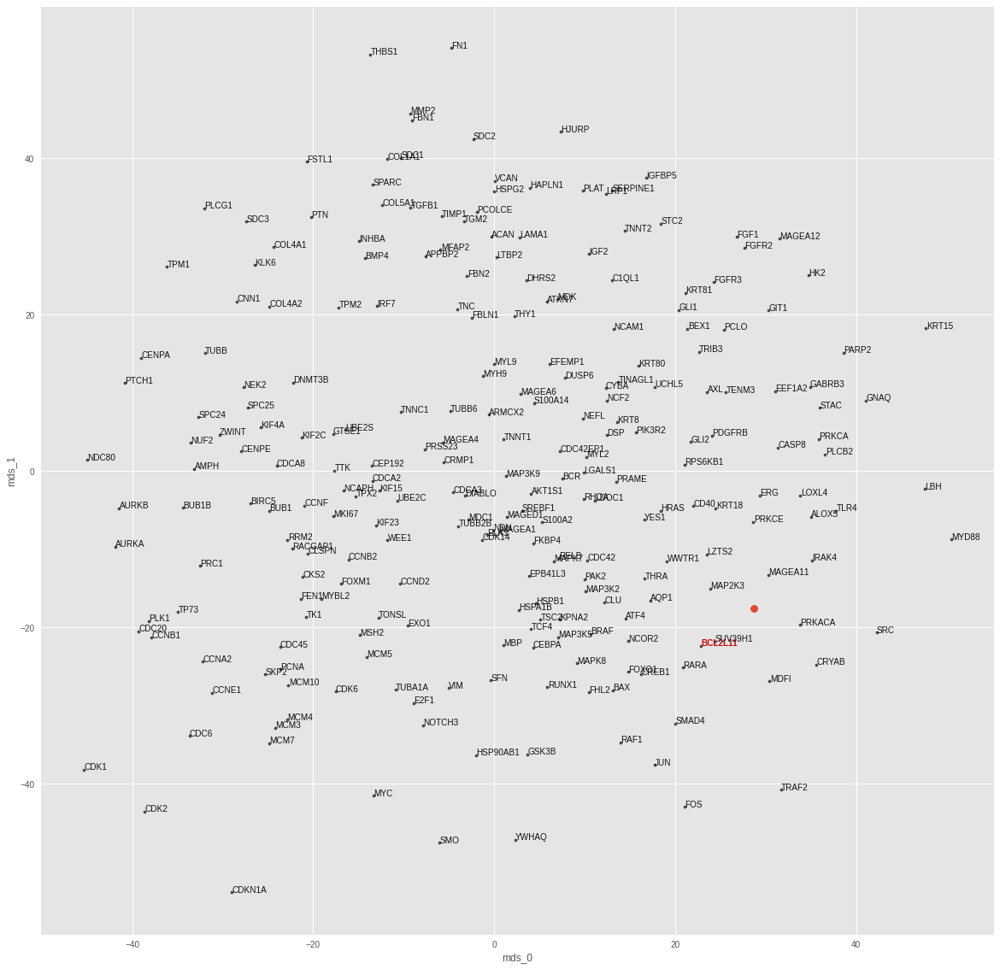

BRAF
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.1721872789295096
train top-k accuracies: {1: 0.736842, 3: 0.842105, 5: 0.921053, 10: 0.921053, 20: 0.921053, 50: 1.0}
train mean top-k accuracies: {1: 0.736842, 3: 0.842105, 5: 0.921053, 10: 0.921053, 20: 0.921053, 50: 1.0}
test loss: 0.22478660941123962
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


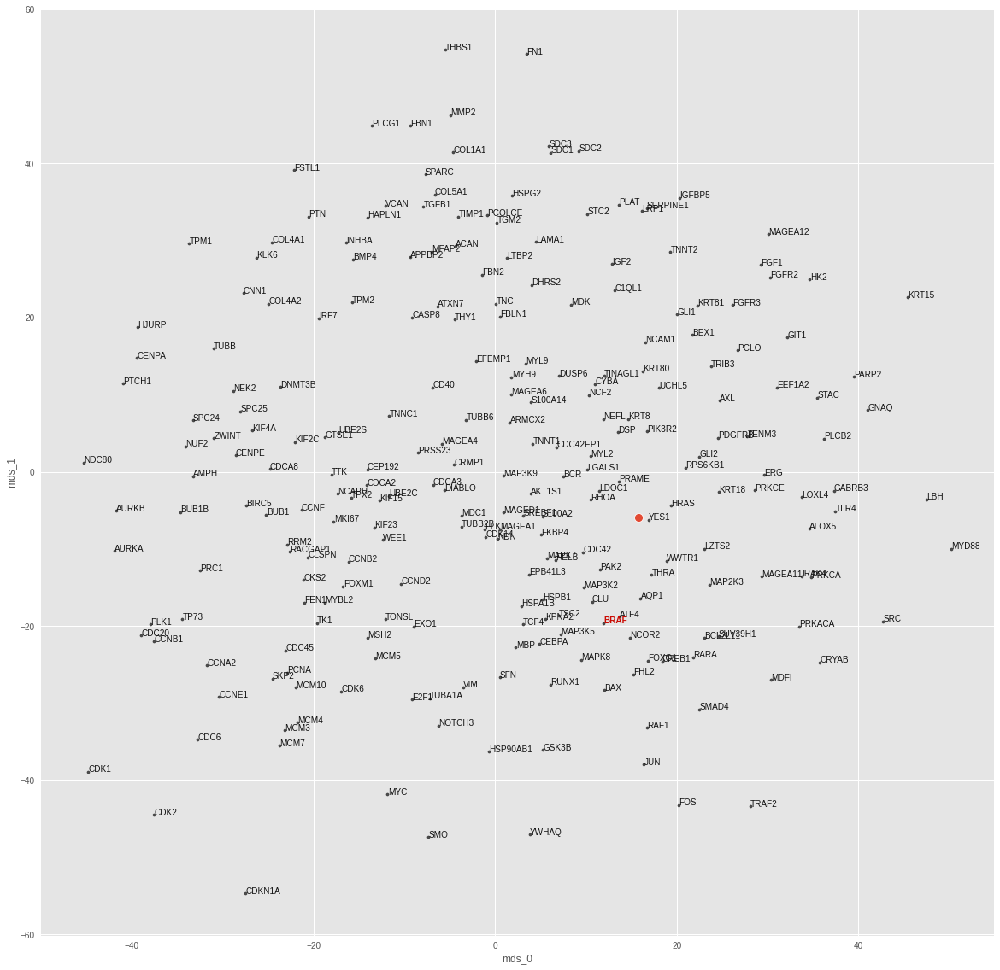

CASP8
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.15650740461914162
train top-k accuracies: {1: 0.736842, 3: 0.868421, 5: 0.921053, 10: 0.921053, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.736842, 3: 0.868421, 5: 0.921053, 10: 0.921053, 20: 0.947368, 50: 1.0}
test loss: 2.7927043437957764
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


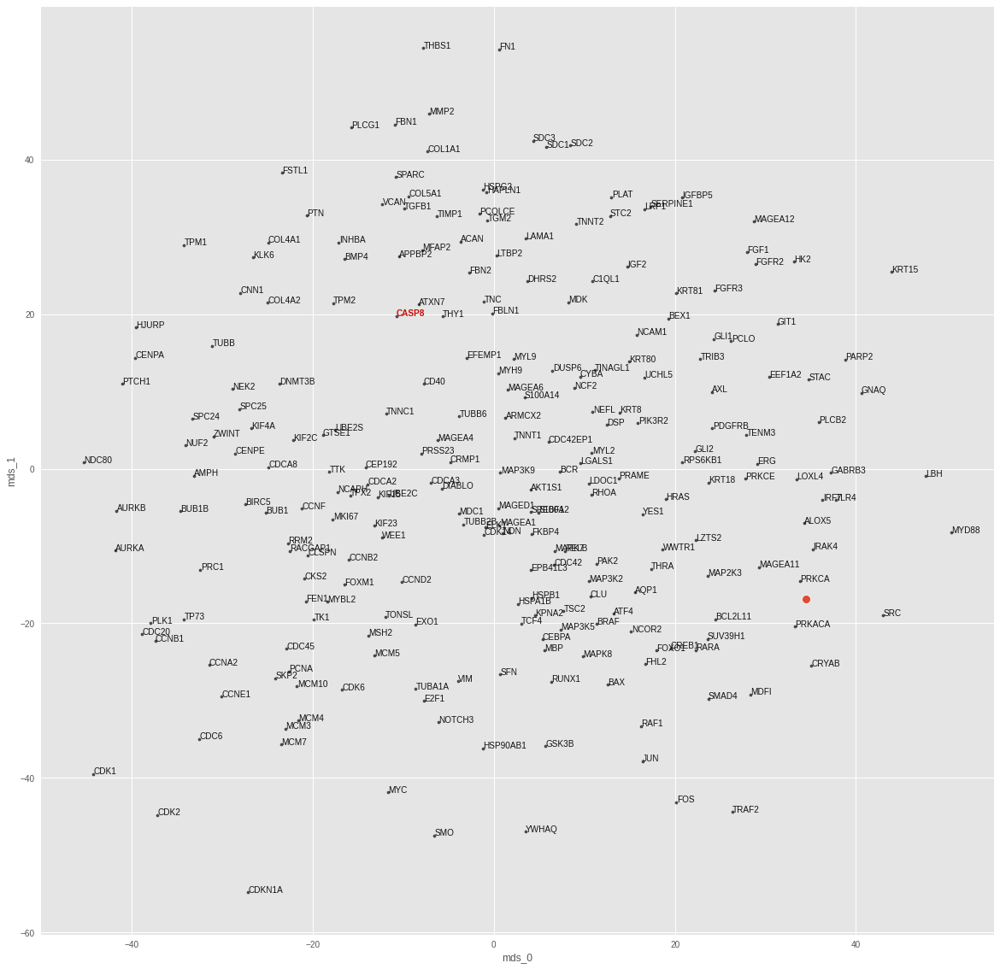

CDC42
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.16567366727088628
train top-k accuracies: {1: 0.763158, 3: 0.868421, 5: 0.894737, 10: 0.921053, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.868421, 5: 0.894737, 10: 0.921053, 20: 0.947368, 50: 1.0}
test loss: 0.4440300166606903
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


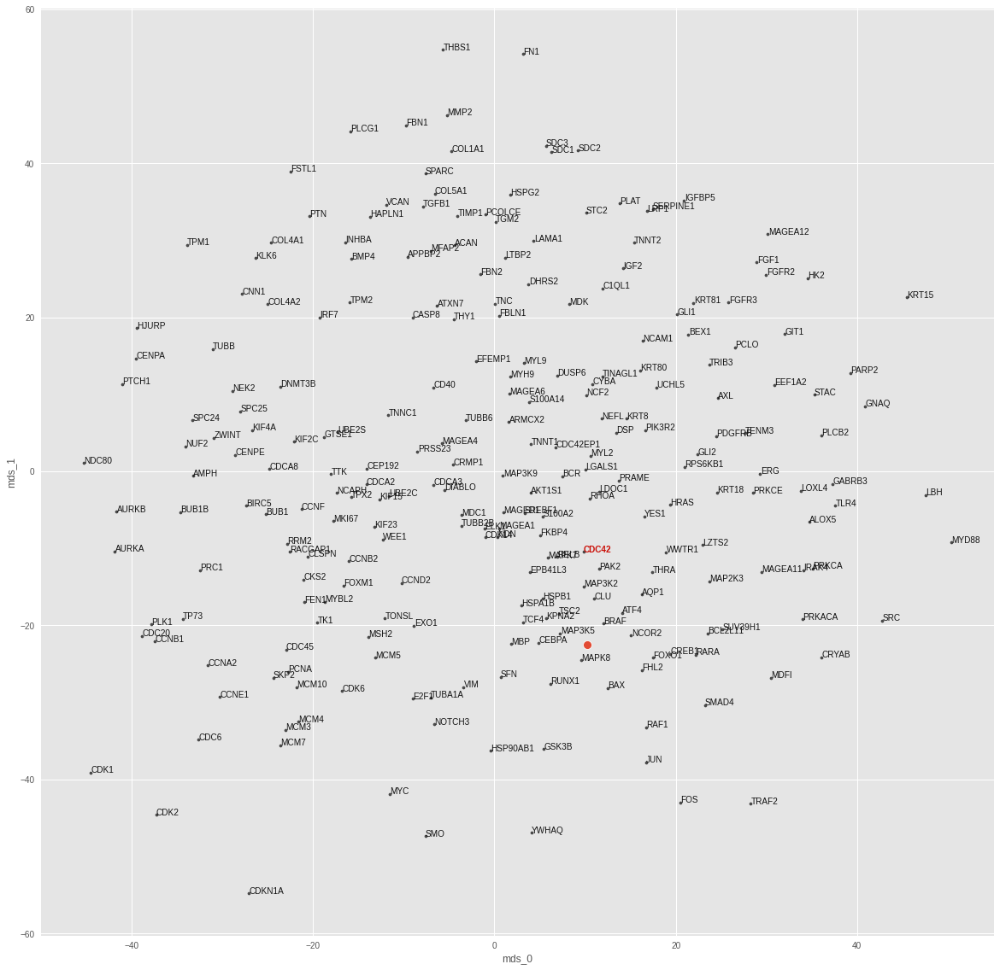

CDKN1A
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.16409937645259656
train top-k accuracies: {1: 0.789474, 3: 0.894737, 5: 0.947368, 10: 0.947368, 20: 0.973684, 50: 1.0}
train mean top-k accuracies: {1: 0.789474, 3: 0.894737, 5: 0.947368, 10: 0.947368, 20: 0.973684, 50: 1.0}
test loss: 3.876511573791504
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


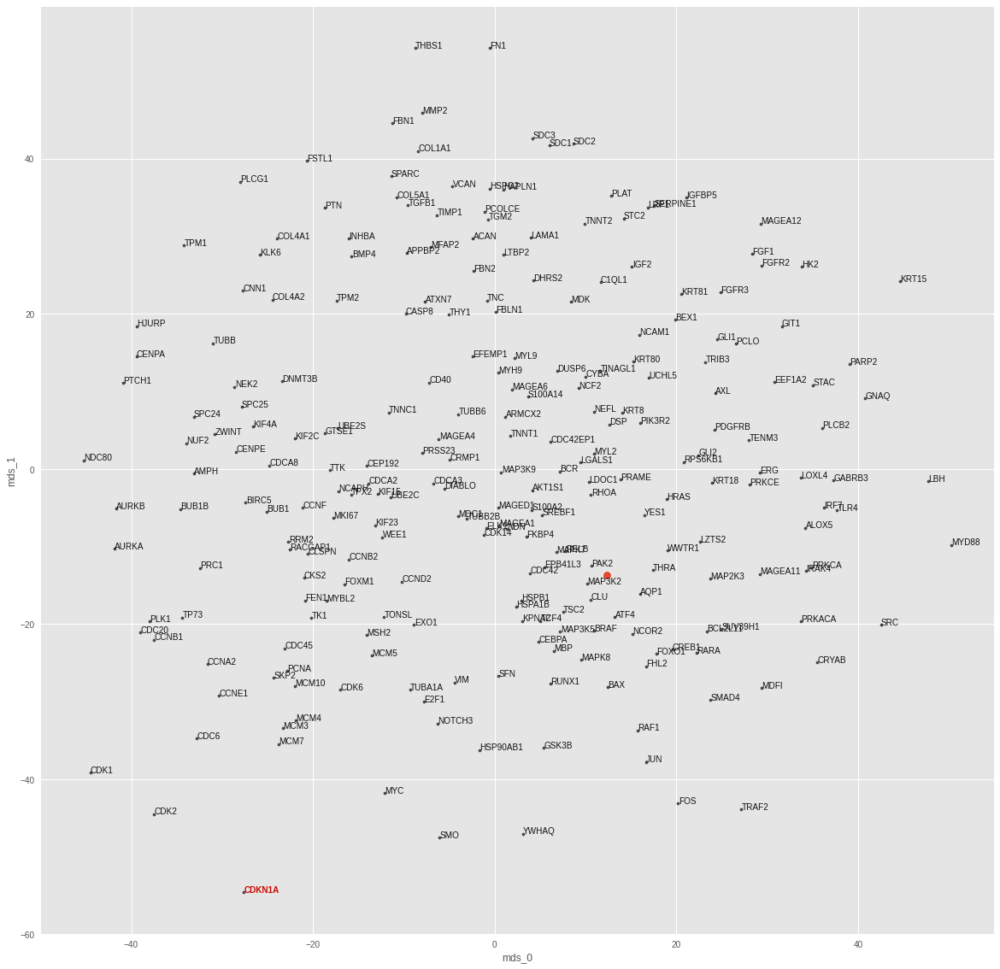

CEBPA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.1692251645420727
train top-k accuracies: {1: 0.736842, 3: 0.868421, 5: 0.947368, 10: 0.947368, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.736842, 3: 0.868421, 5: 0.947368, 10: 0.947368, 20: 0.947368, 50: 1.0}
test loss: 1.1740894317626953
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


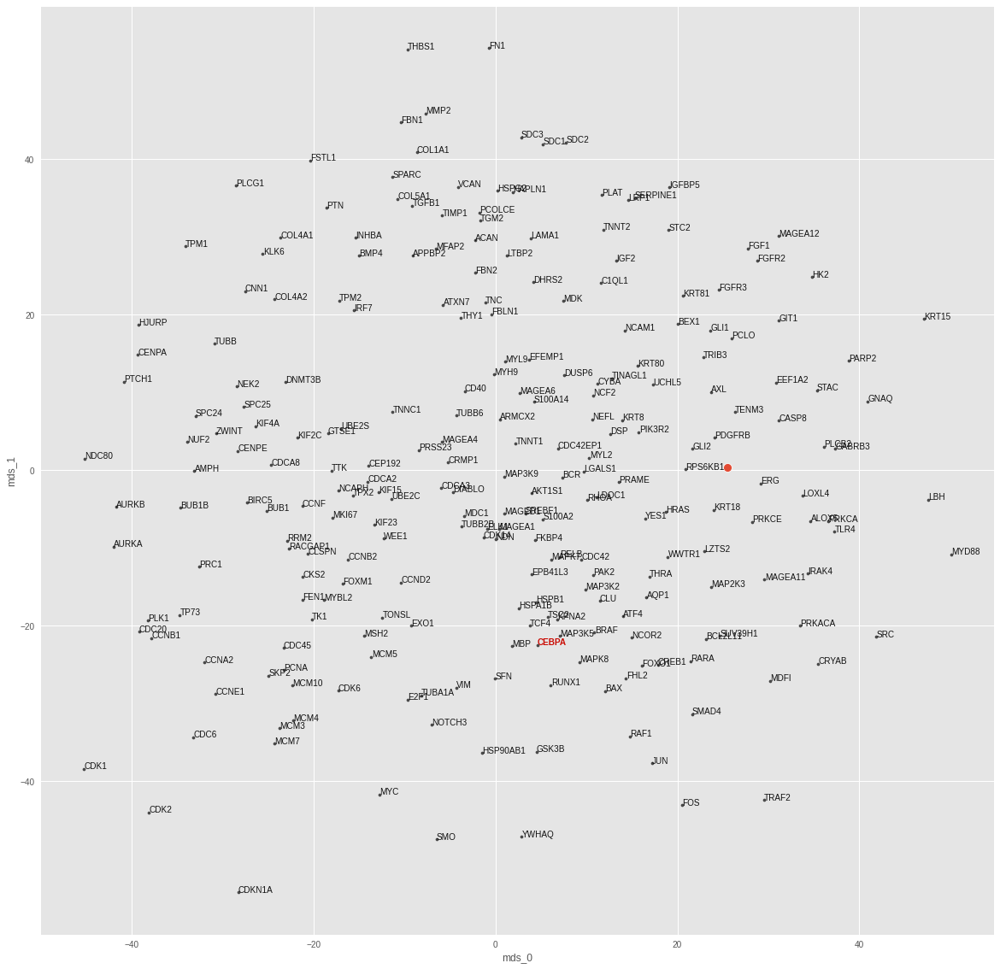

CREB1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.15961847964086032
train top-k accuracies: {1: 0.763158, 3: 0.868421, 5: 0.921053, 10: 0.947368, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.868421, 5: 0.921053, 10: 0.947368, 20: 0.947368, 50: 1.0}
test loss: 1.1387804746627808
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


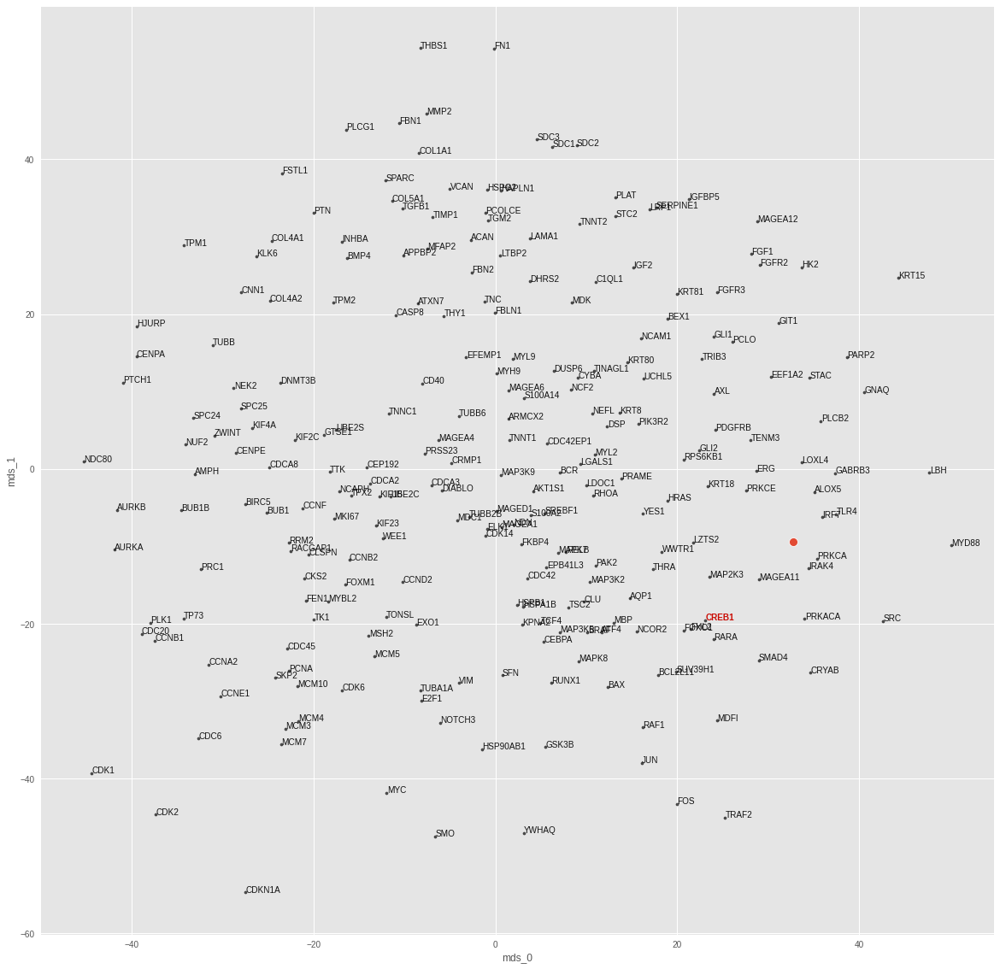

DIABLO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.16405605720846275
train top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.894737, 10: 0.921053, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.894737, 10: 0.921053, 20: 0.947368, 50: 1.0}
test loss: 0.8323730230331421
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


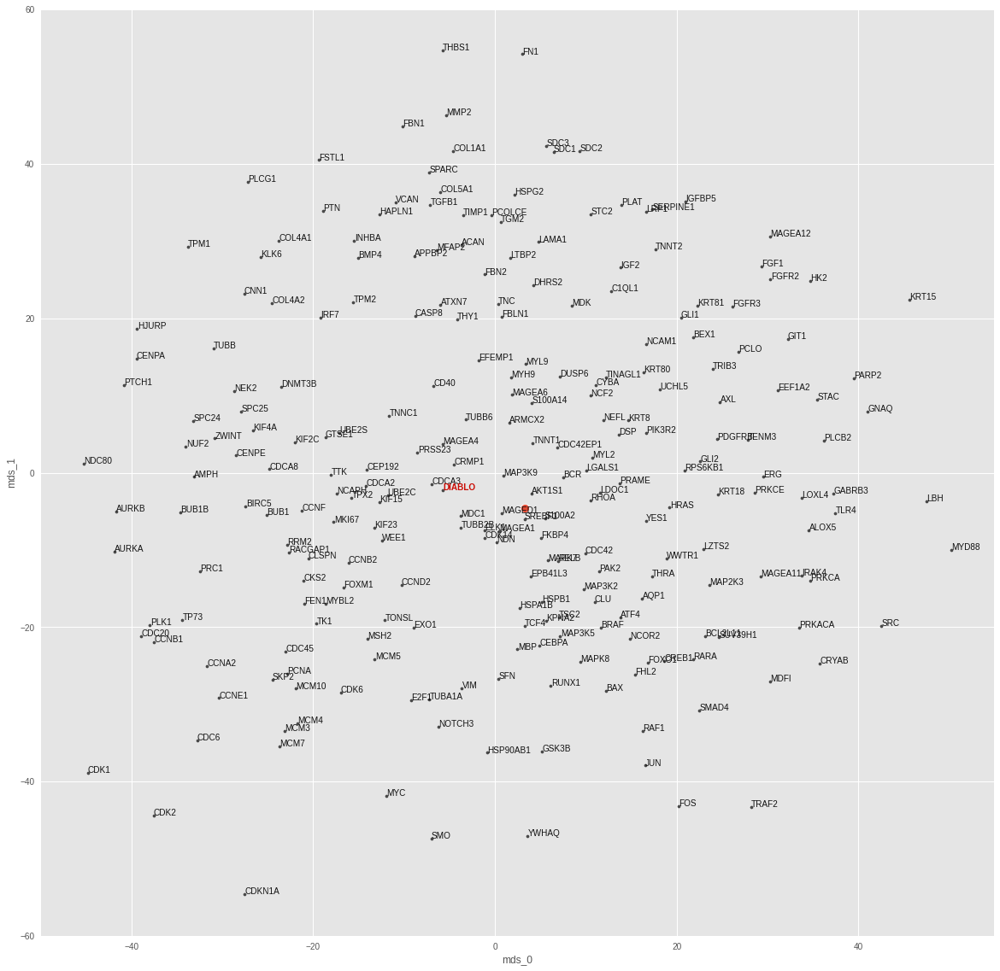

E2F1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.16544509326156817
train top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.894737, 10: 0.921053, 20: 0.973684, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.894737, 10: 0.921053, 20: 0.973684, 50: 1.0}
test loss: 2.782525062561035
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


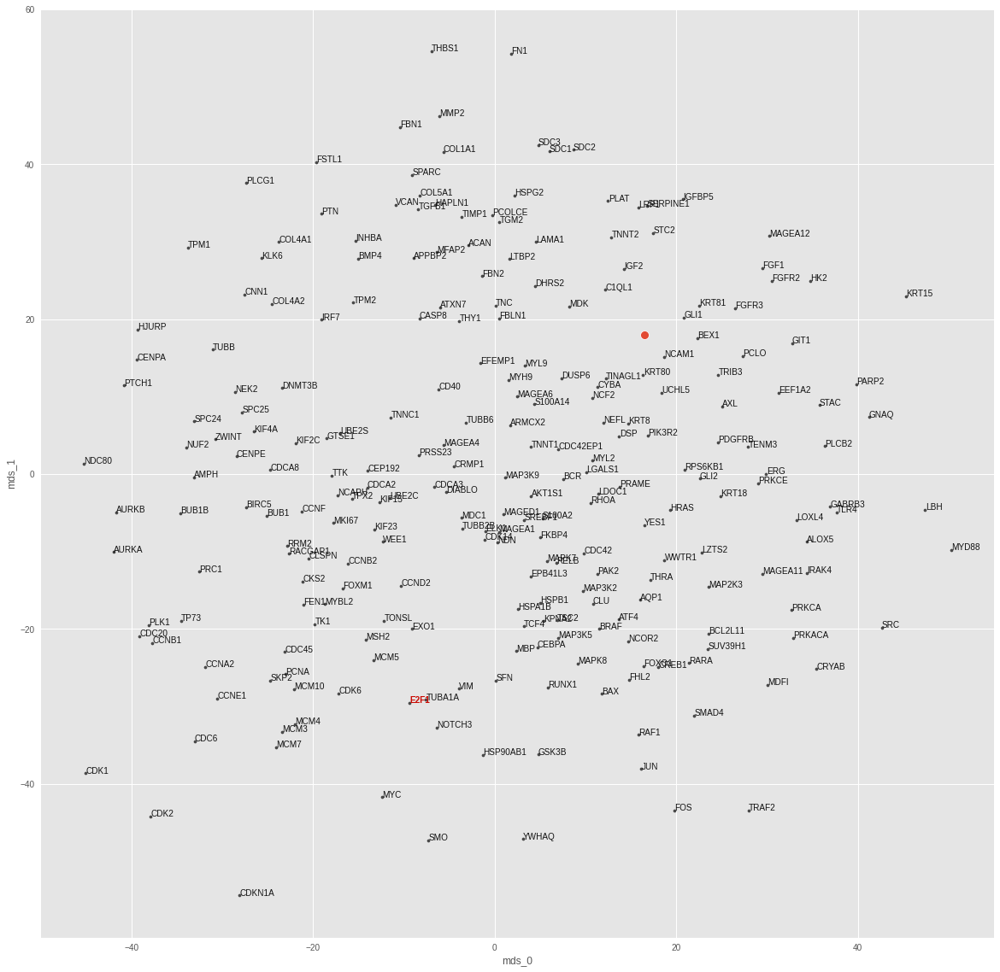

ELK1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.18070889695694572
train top-k accuracies: {1: 0.736842, 3: 0.868421, 5: 0.894737, 10: 0.921053, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.736842, 3: 0.868421, 5: 0.894737, 10: 0.921053, 20: 0.947368, 50: 1.0}
test loss: 0.4897632598876953
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


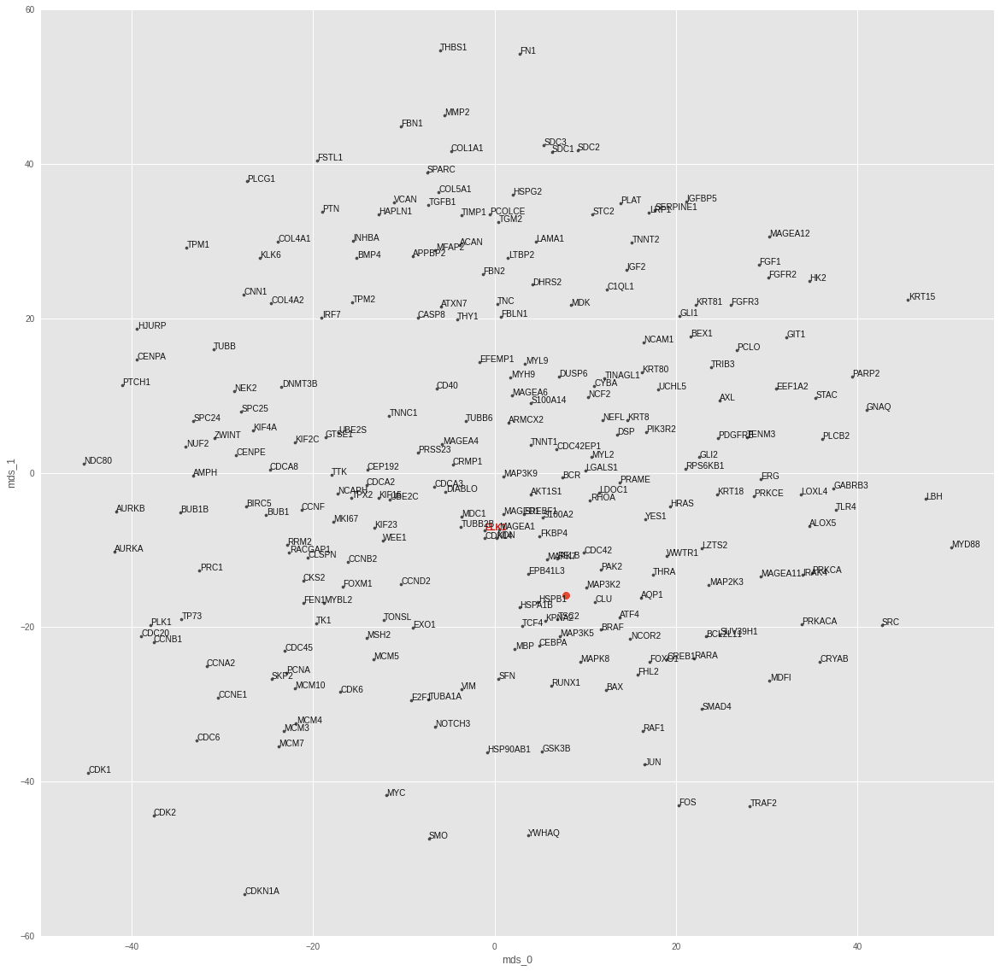

ERG
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.16971299209092794
train top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.894737, 10: 0.947368, 20: 0.947368, 50: 0.973684}
train mean top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.894737, 10: 0.947368, 20: 0.947368, 50: 0.973684}
test loss: 2.351560115814209
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


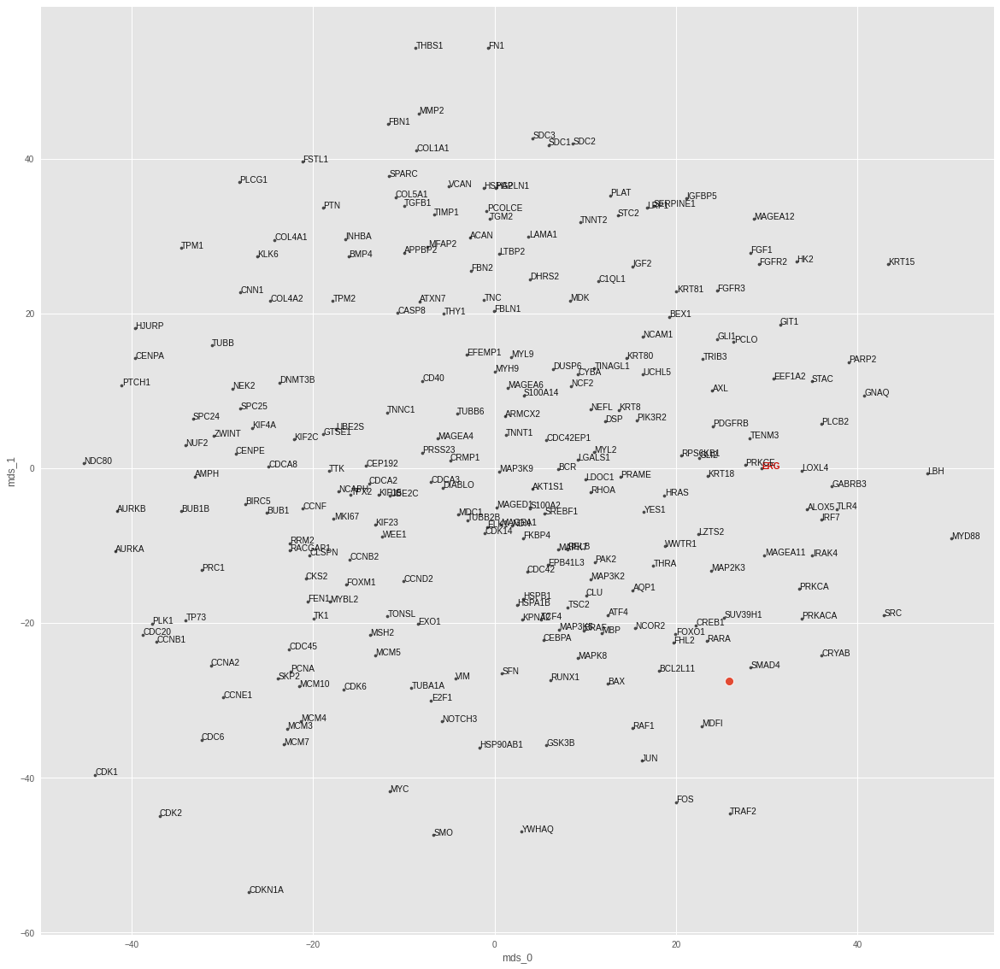

FGFR3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.15992598000325656
train top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.947368, 50: 1.0}
test loss: 1.341127634048462
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


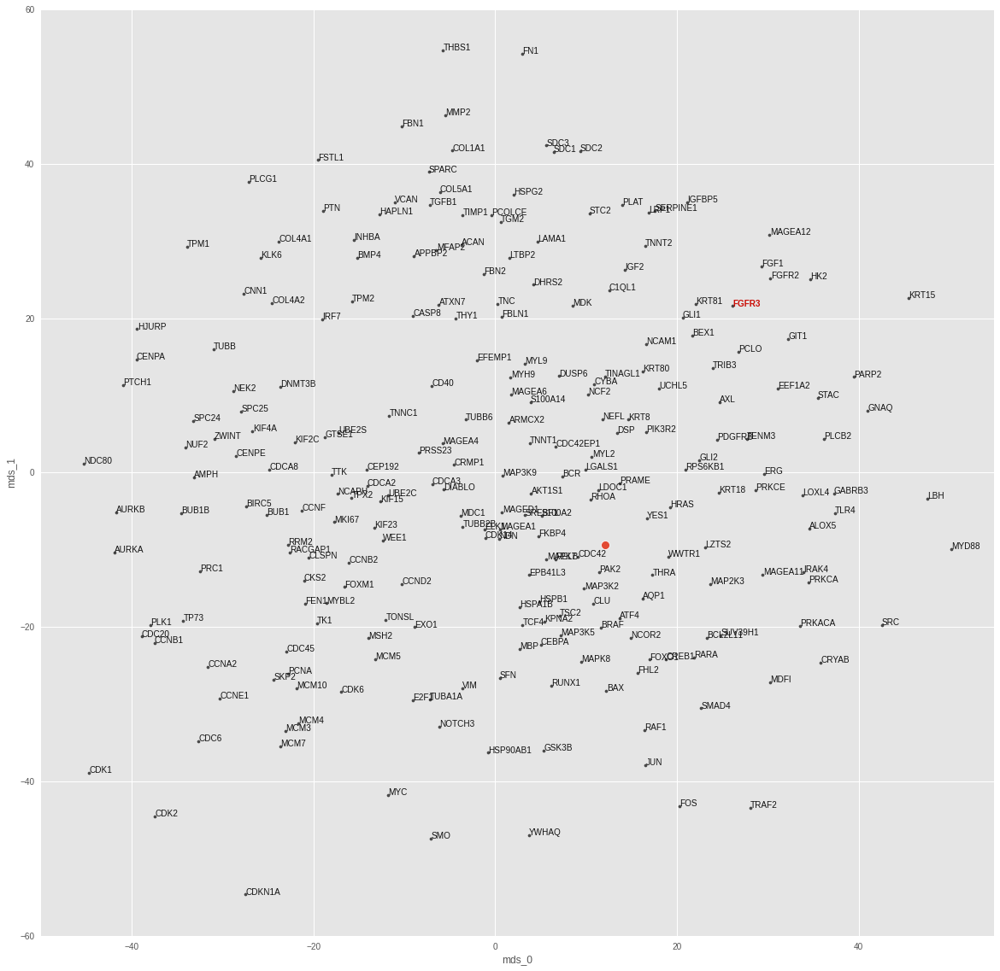

FOXO1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.16197417362740166
train top-k accuracies: {1: 0.763158, 3: 0.842105, 5: 0.921053, 10: 0.921053, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.842105, 5: 0.921053, 10: 0.921053, 20: 0.947368, 50: 1.0}
test loss: 1.0673892498016357
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


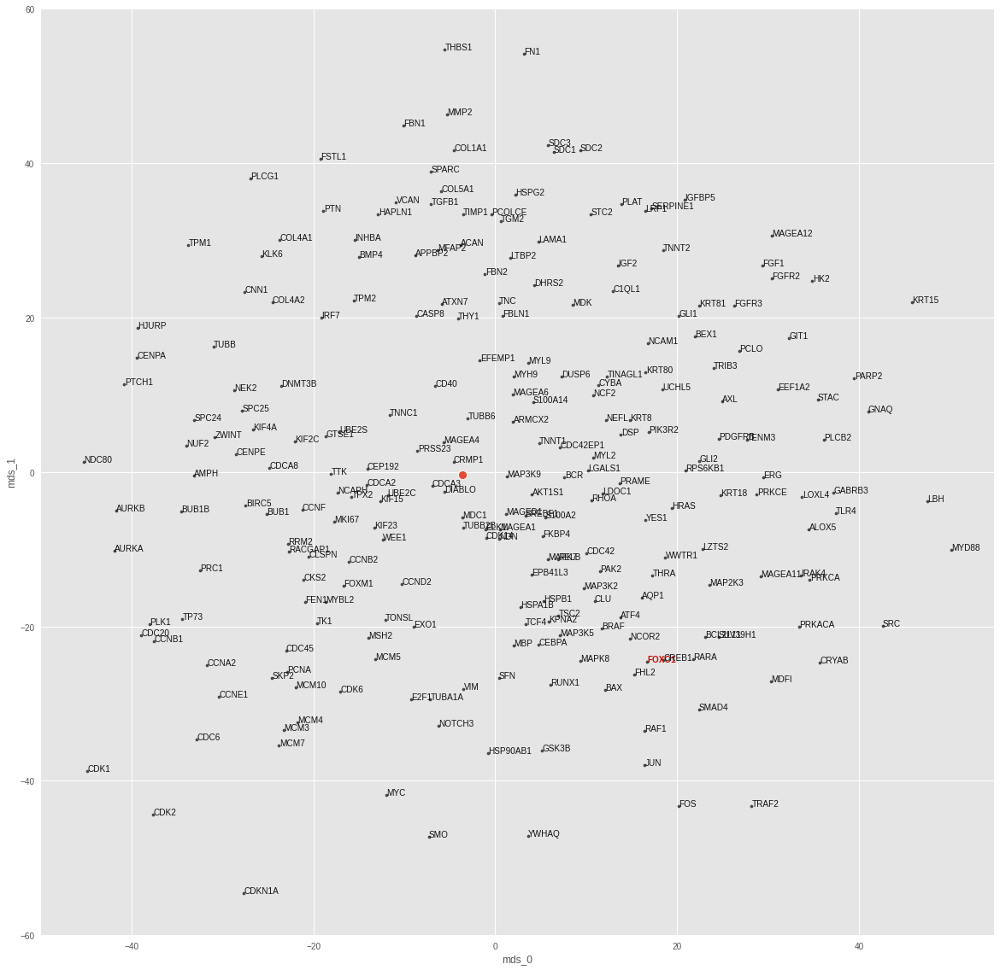

GLI1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.15530710236022346
train top-k accuracies: {1: 0.763158, 3: 0.842105, 5: 0.894737, 10: 0.921053, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.842105, 5: 0.894737, 10: 0.921053, 20: 0.947368, 50: 1.0}
test loss: 1.2228554487228394
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


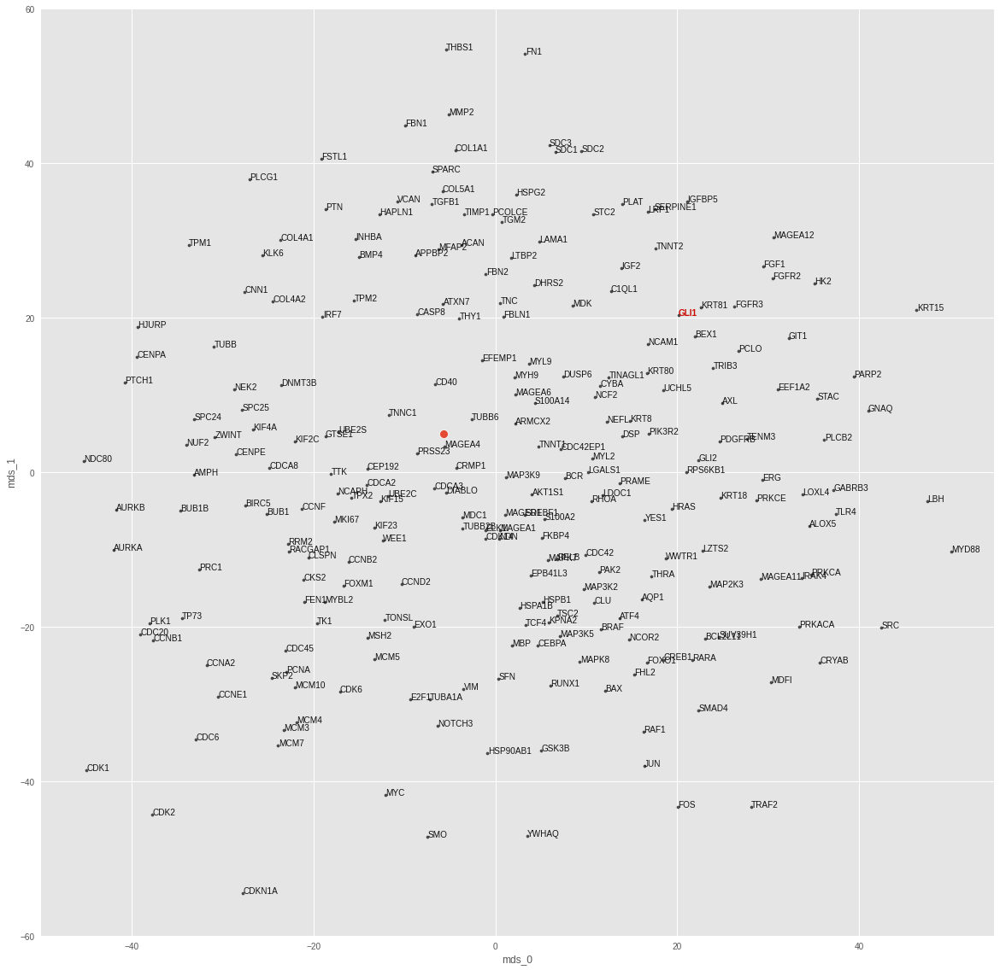

HRAS
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.16464465542843468
train top-k accuracies: {1: 0.763158, 3: 0.868421, 5: 0.894737, 10: 0.947368, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.868421, 5: 0.894737, 10: 0.947368, 20: 0.947368, 50: 1.0}
test loss: 1.6340196132659912
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


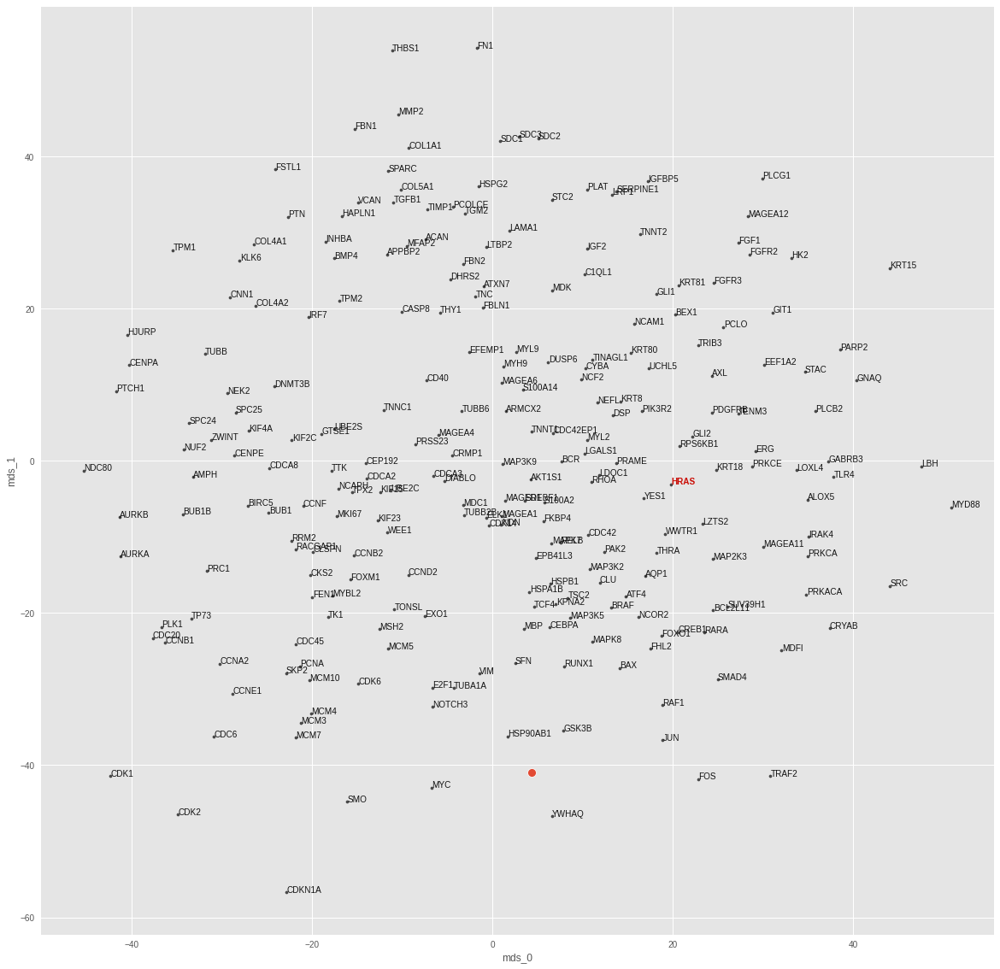

IRAK4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.157665668349517
train top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.921053, 20: 0.921053, 50: 1.0}
train mean top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.921053, 20: 0.921053, 50: 1.0}
test loss: 1.2865110635757446
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


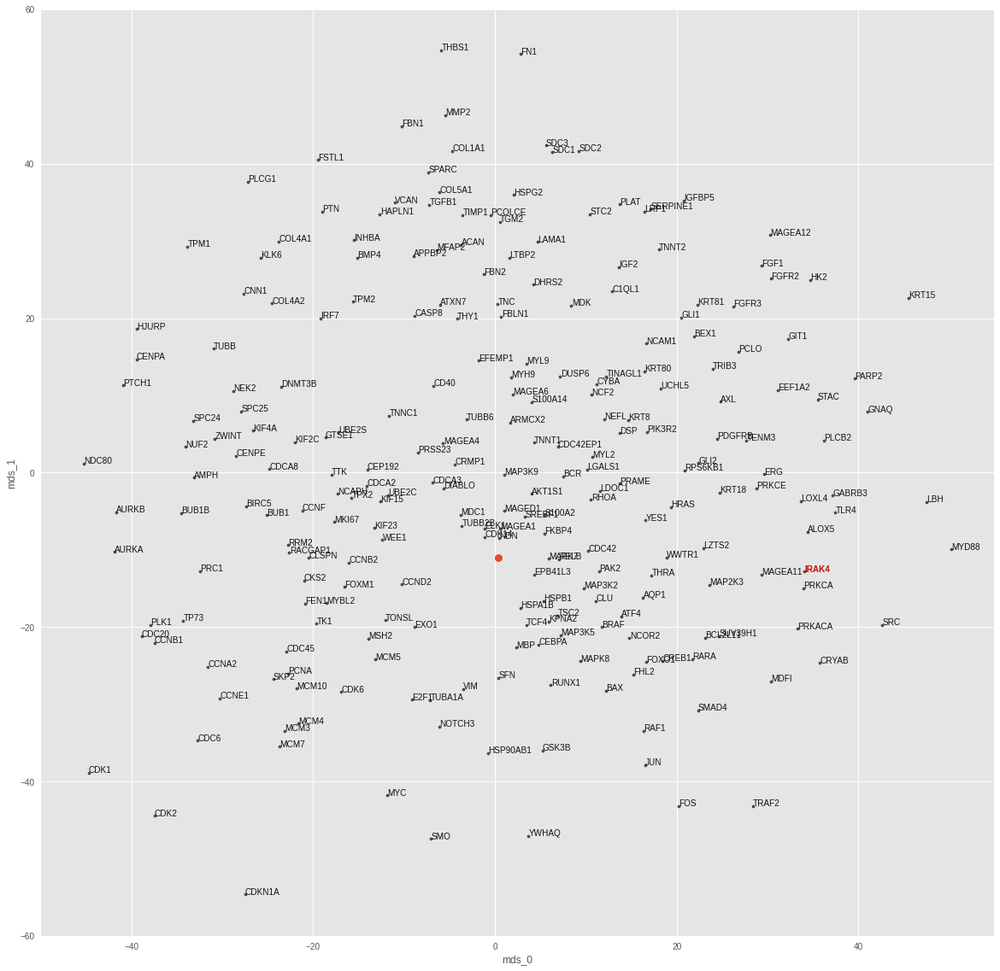

JUN
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.16310027339740804
train top-k accuracies: {1: 0.736842, 3: 0.842105, 5: 0.947368, 10: 0.947368, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.736842, 3: 0.842105, 5: 0.947368, 10: 0.947368, 20: 0.947368, 50: 1.0}
test loss: 1.524200201034546
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


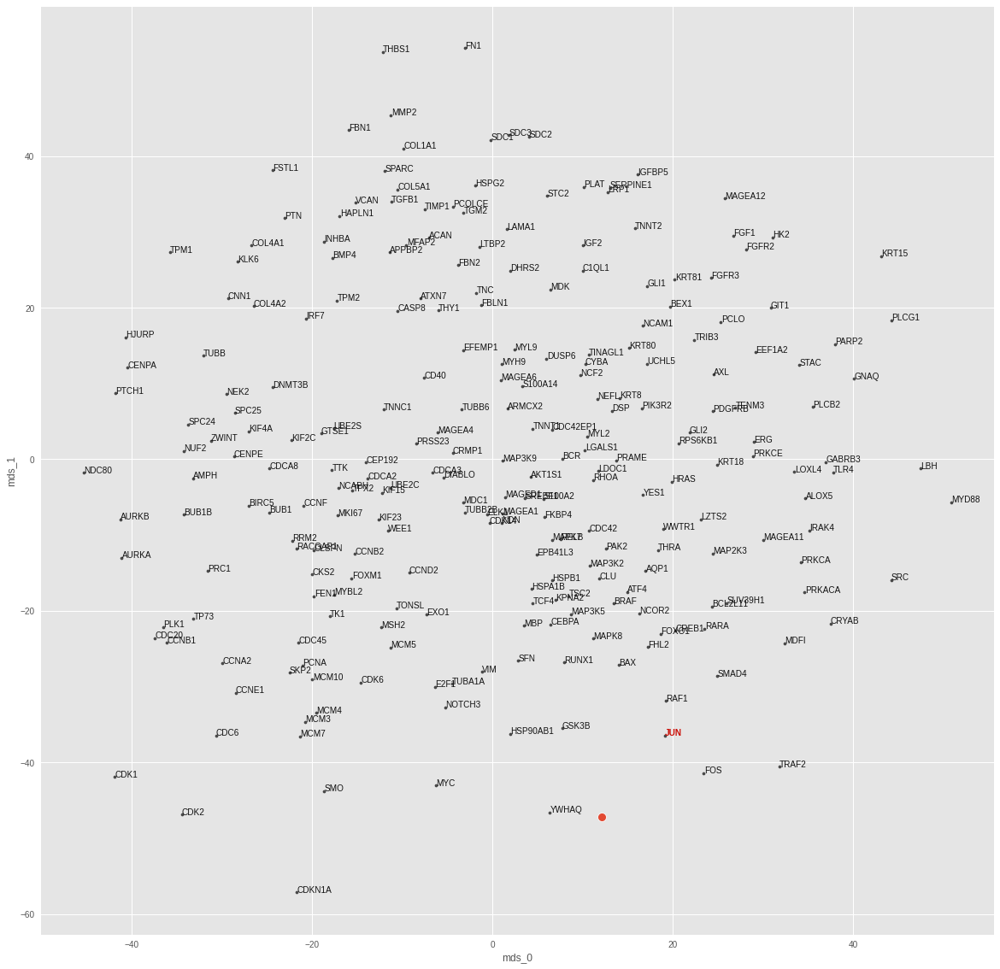

MAP2K3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.15931880670158485
train top-k accuracies: {1: 0.763158, 3: 0.868421, 5: 0.947368, 10: 0.947368, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.868421, 5: 0.947368, 10: 0.947368, 20: 0.947368, 50: 1.0}
test loss: 1.53898024559021
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


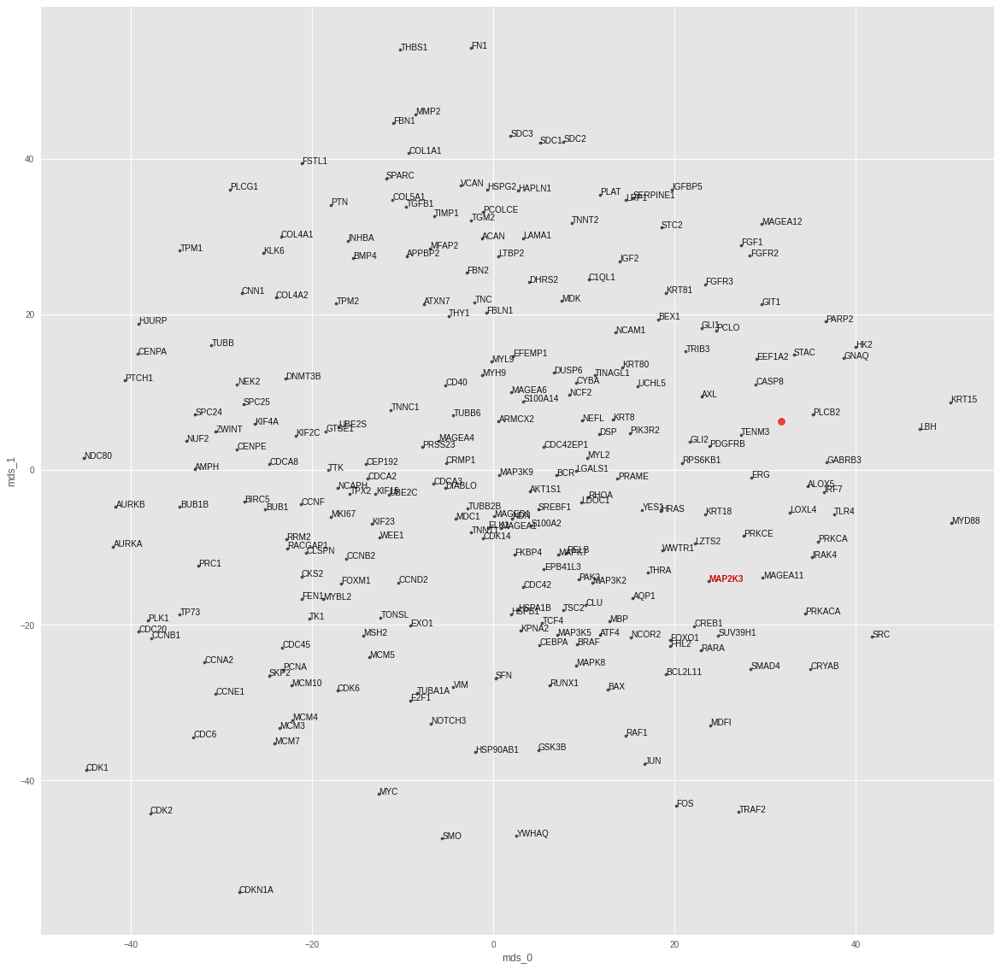

MAP3K2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.16041889943574605
train top-k accuracies: {1: 0.736842, 3: 0.868421, 5: 0.947368, 10: 0.947368, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.736842, 3: 0.868421, 5: 0.947368, 10: 0.947368, 20: 0.947368, 50: 1.0}
test loss: 0.43016719818115234
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


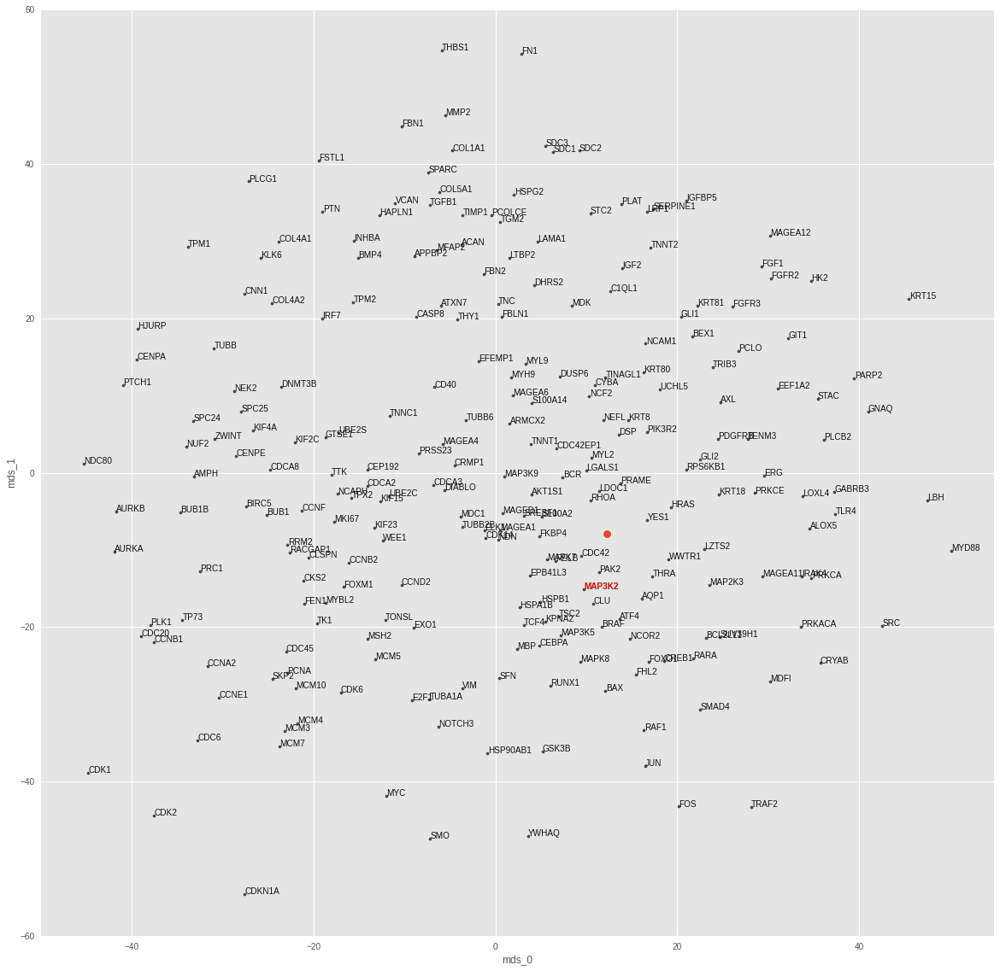

MAP3K5
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.1724299945329365
train top-k accuracies: {1: 0.763158, 3: 0.842105, 5: 0.894737, 10: 0.921053, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.842105, 5: 0.894737, 10: 0.921053, 20: 0.947368, 50: 1.0}
test loss: 0.5650607347488403
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


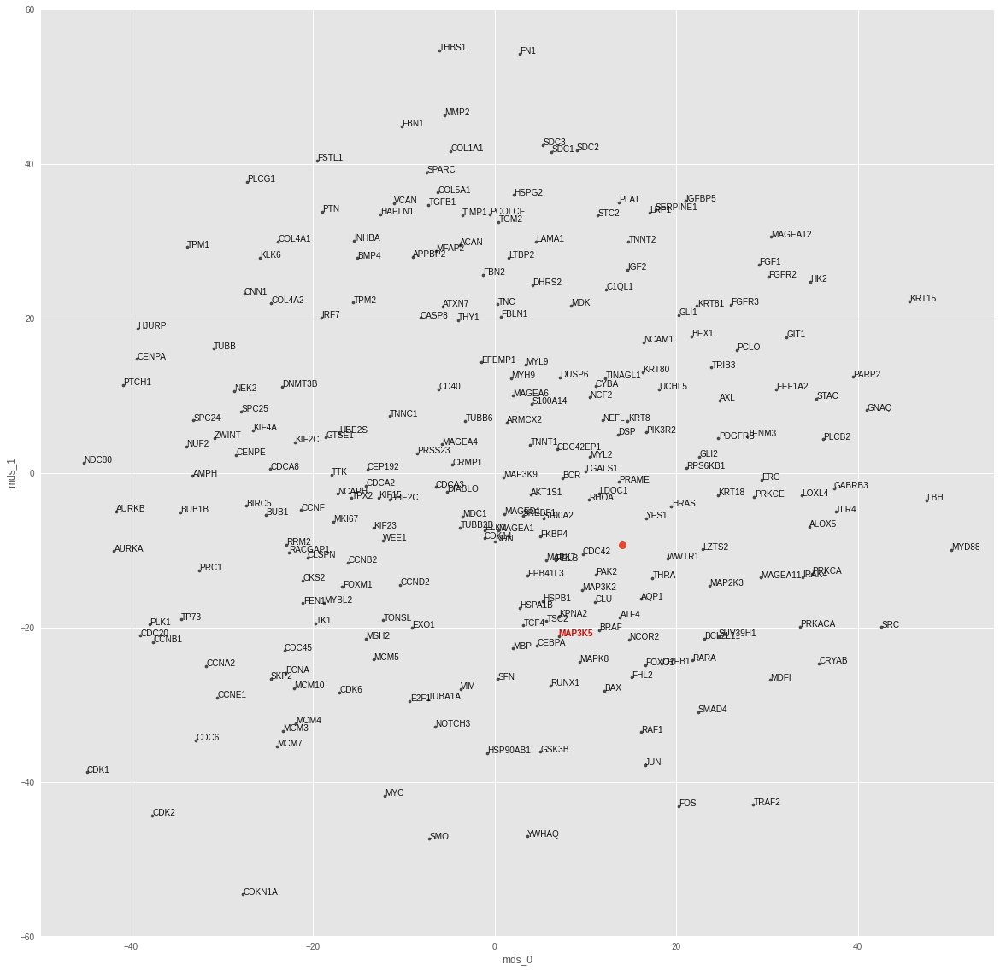

MAP3K9
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.16832450345942848
train top-k accuracies: {1: 0.736842, 3: 0.842105, 5: 0.947368, 10: 0.947368, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.736842, 3: 0.842105, 5: 0.947368, 10: 0.947368, 20: 0.947368, 50: 1.0}
test loss: 0.8729562759399414
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


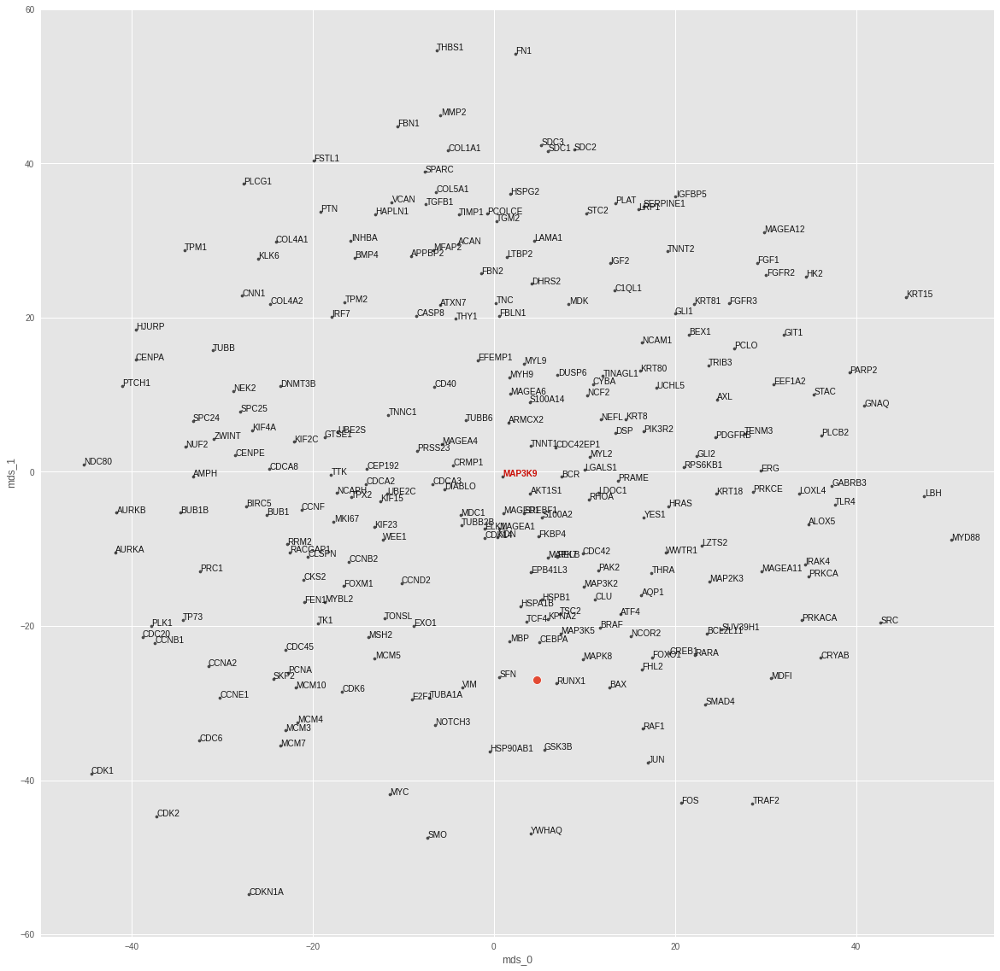

MAPK7
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.17089925667172984
train top-k accuracies: {1: 0.763158, 3: 0.868421, 5: 0.894737, 10: 0.947368, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.868421, 5: 0.894737, 10: 0.947368, 20: 0.947368, 50: 1.0}
test loss: 0.5239864587783813
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


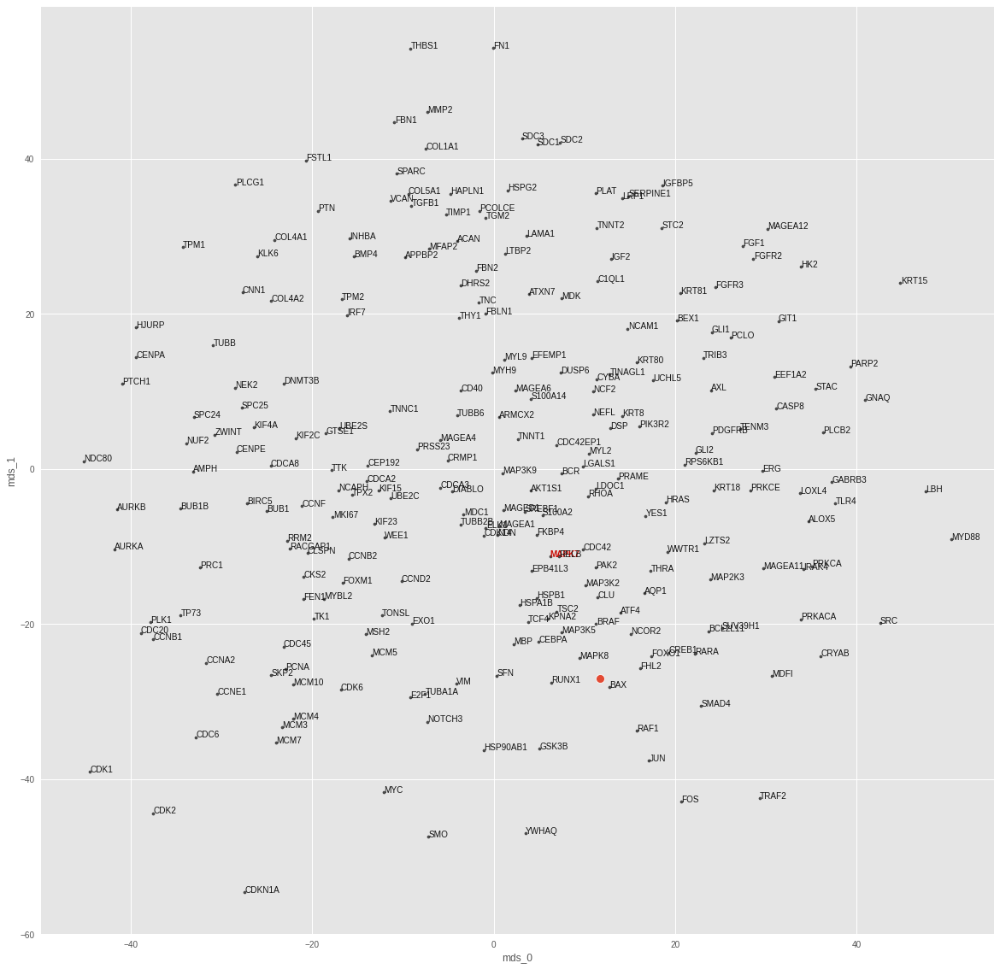

MYD88
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.14836420314876655
train top-k accuracies: {1: 0.763158, 3: 0.921053, 5: 0.947368, 10: 0.947368, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.921053, 5: 0.947368, 10: 0.947368, 20: 0.947368, 50: 1.0}
test loss: 2.398864507675171
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


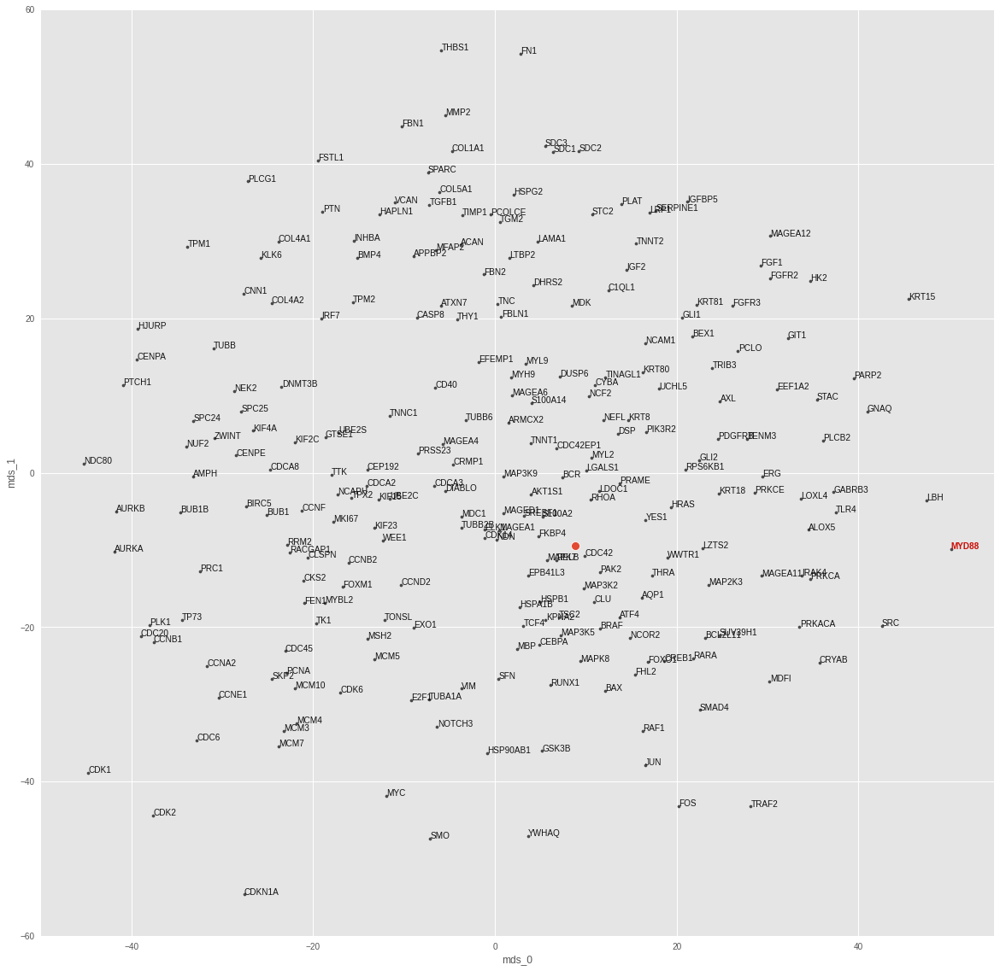

PIK3R2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.16382396378015218
train top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.947368, 10: 0.947368, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.947368, 10: 0.947368, 20: 0.947368, 50: 1.0}
test loss: 0.531100869178772
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


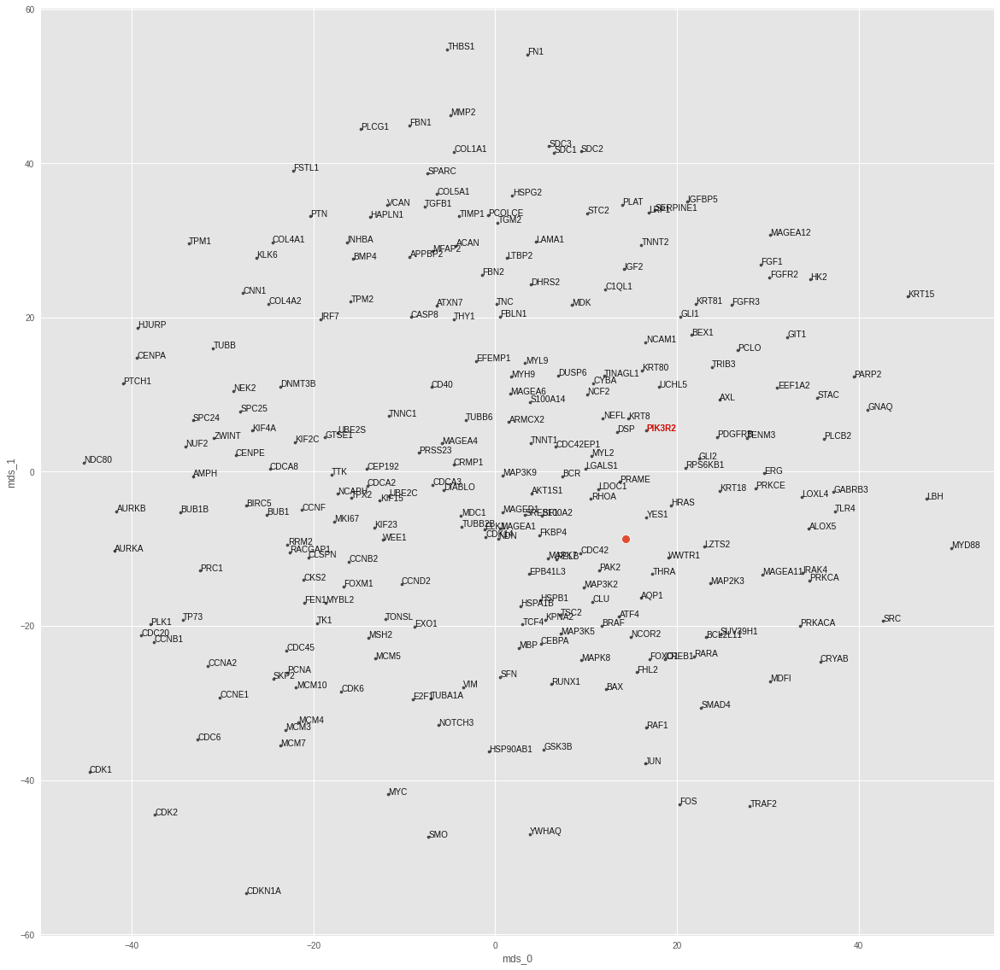

PRKACA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.16279881251485726
train top-k accuracies: {1: 0.763158, 3: 0.868421, 5: 0.921053, 10: 0.947368, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.868421, 5: 0.921053, 10: 0.947368, 20: 0.947368, 50: 1.0}
test loss: 2.7637319564819336
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


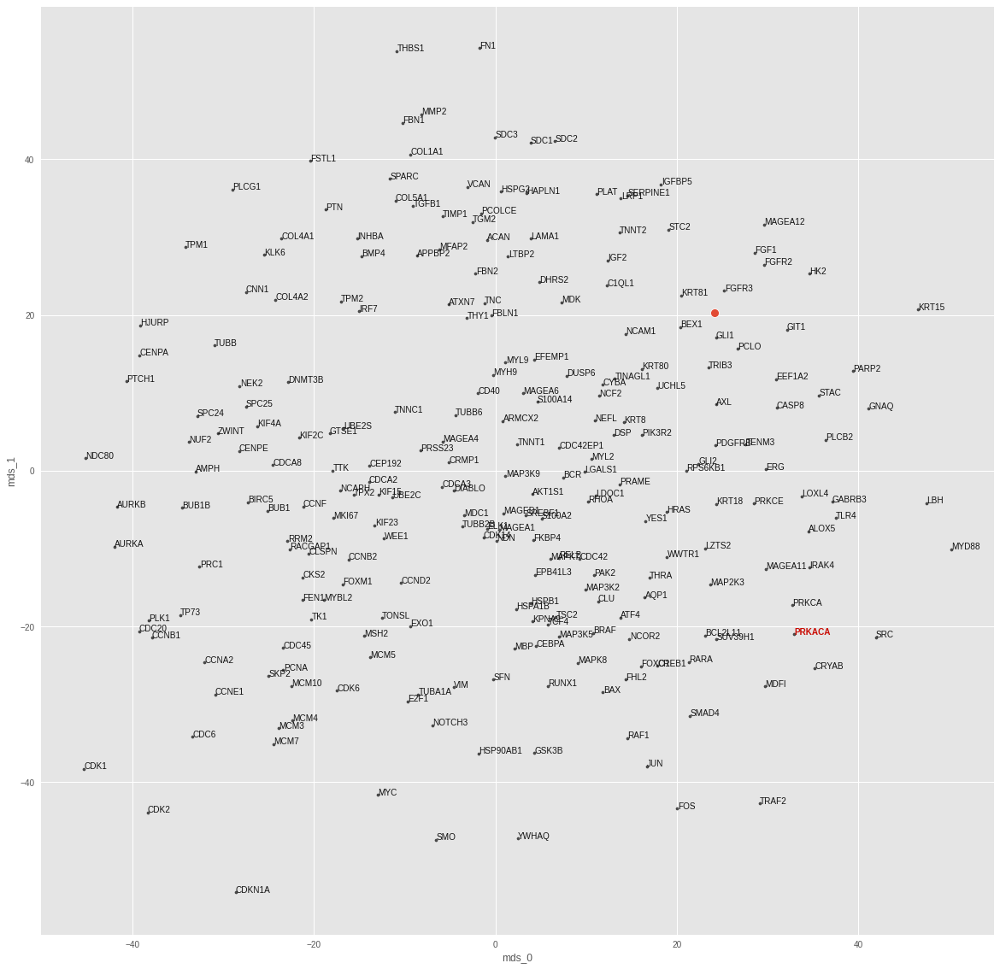

PRKCE
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.15300971034326052
train top-k accuracies: {1: 0.842105, 3: 0.921053, 5: 0.947368, 10: 0.973684, 20: 0.973684, 50: 1.0}
train mean top-k accuracies: {1: 0.842105, 3: 0.921053, 5: 0.947368, 10: 0.973684, 20: 0.973684, 50: 1.0}
test loss: 0.9578996896743774
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


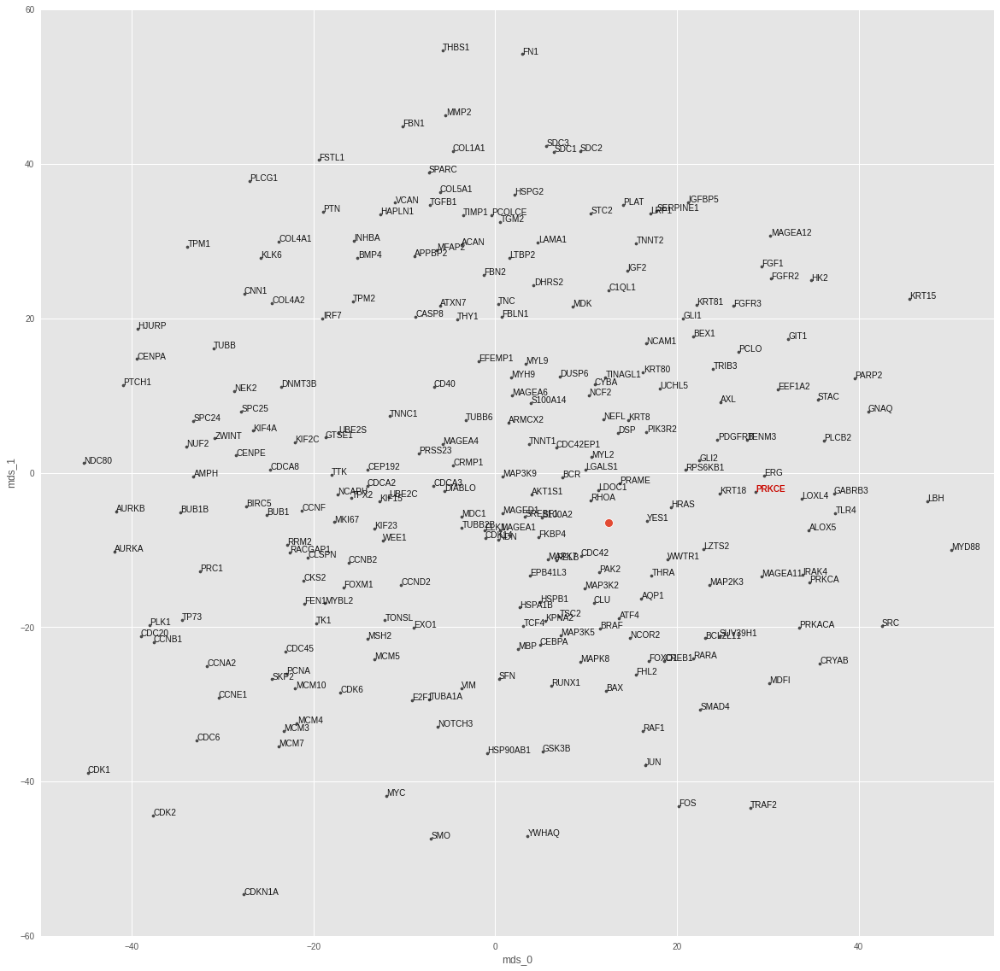

RAF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.1676299822957892
train top-k accuracies: {1: 0.736842, 3: 0.921053, 5: 0.921053, 10: 0.921053, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.736842, 3: 0.921053, 5: 0.921053, 10: 0.921053, 20: 0.947368, 50: 1.0}
test loss: 0.5870931148529053
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


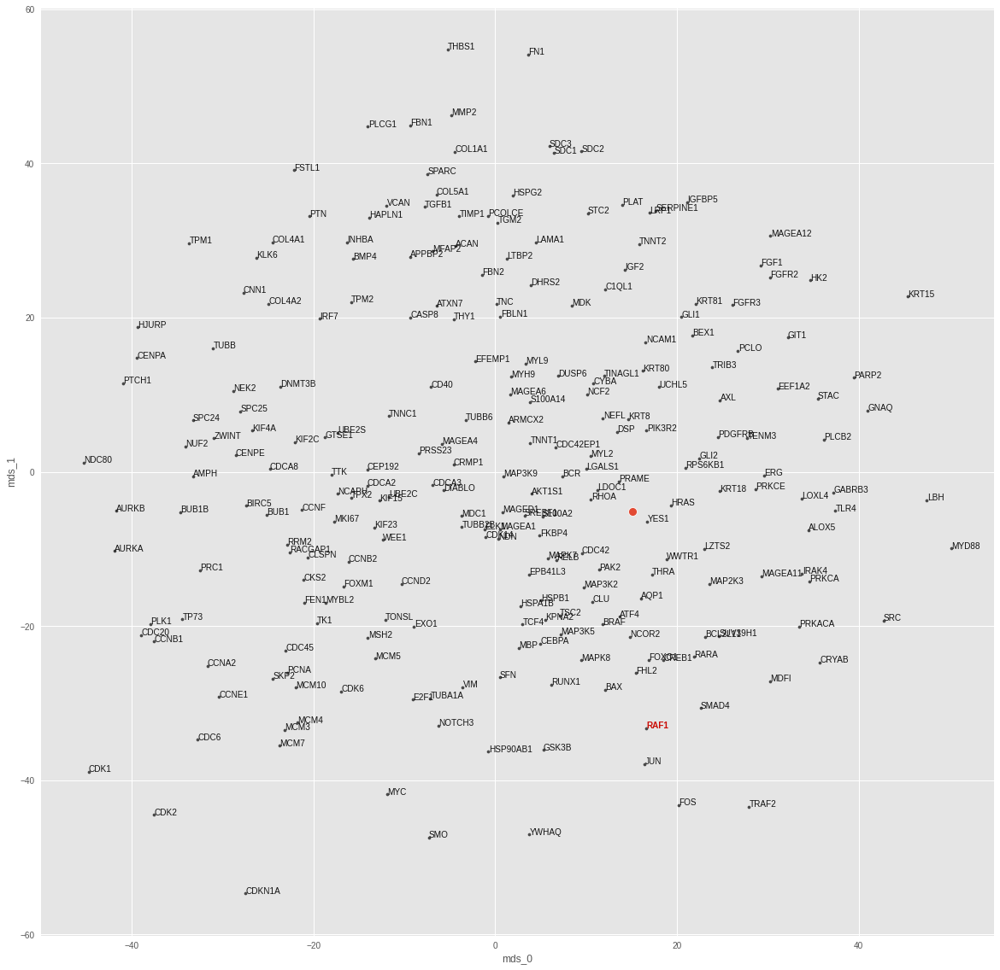

RELB
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.16587454237435995
train top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.973684, 50: 1.0}
train mean top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.973684, 50: 1.0}
test loss: 0.6997866630554199
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


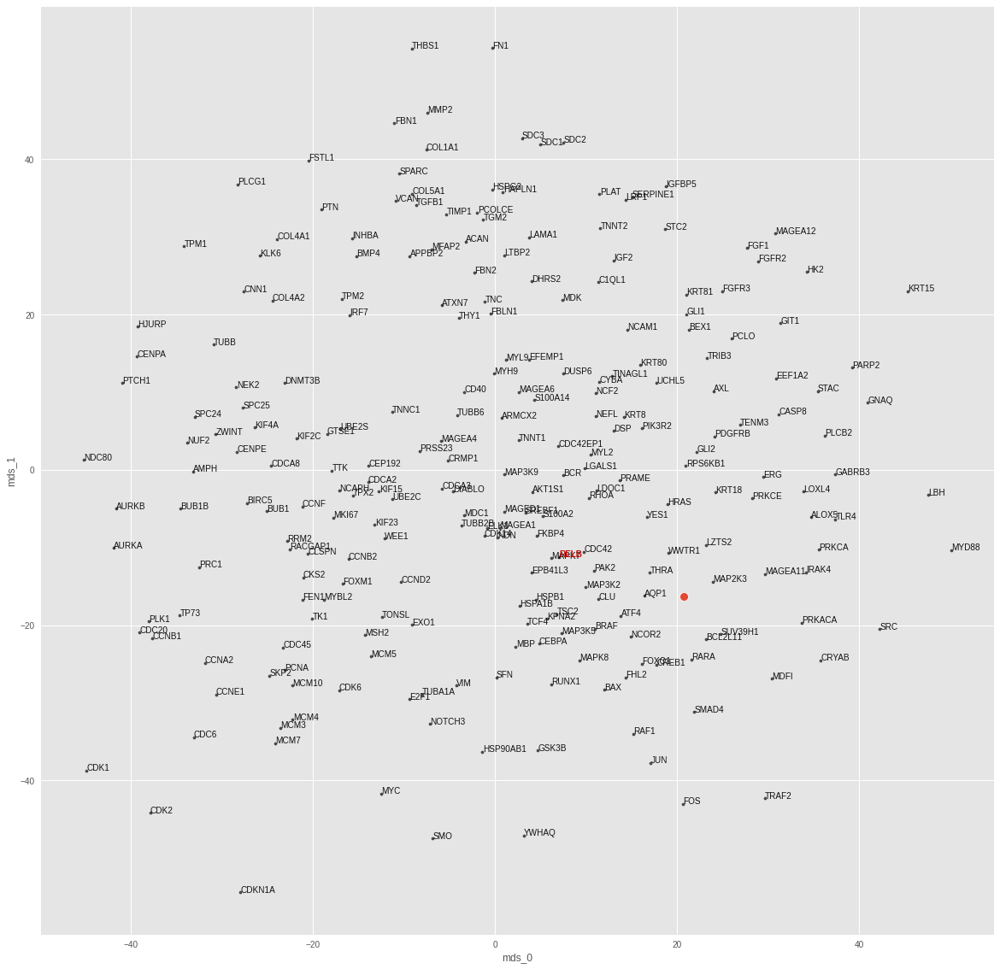

RHOA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.16685588814710317
train top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.894737, 10: 0.947368, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.894737, 10: 0.947368, 20: 0.947368, 50: 1.0}
test loss: 0.6624472141265869
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


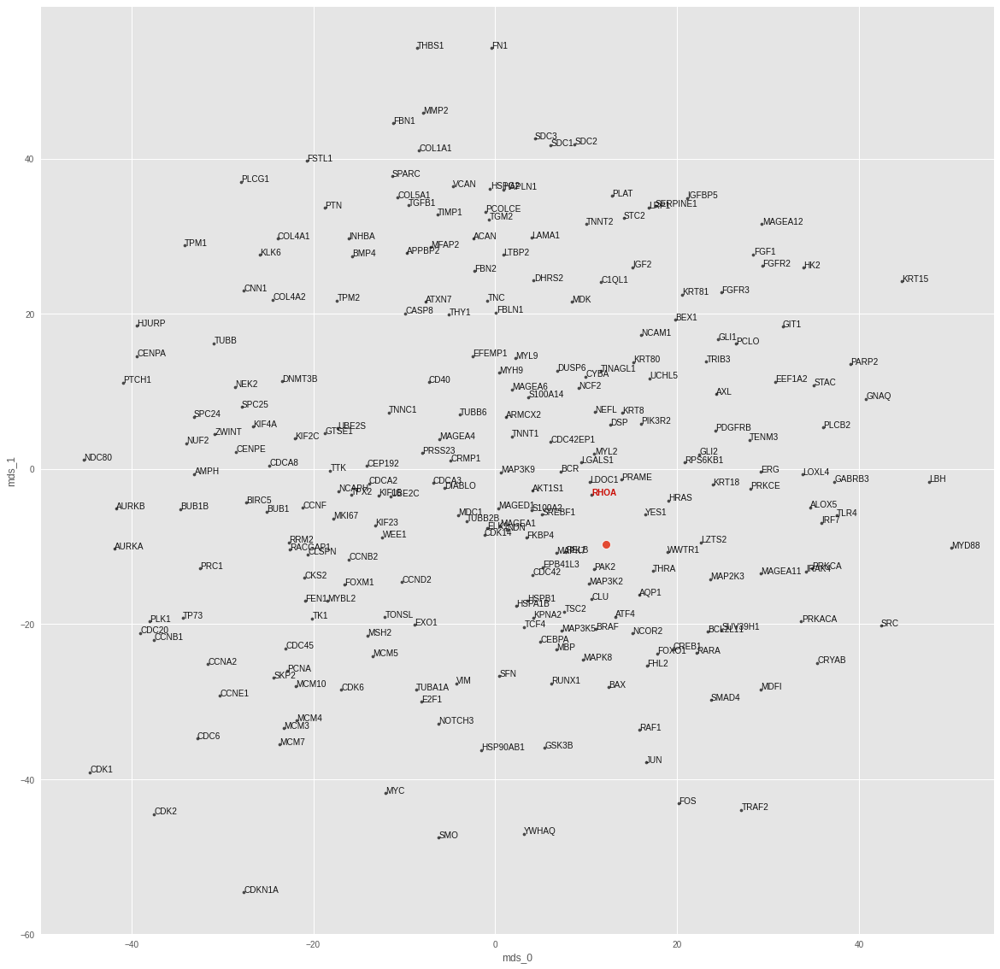

SMAD4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.16240504227186503
train top-k accuracies: {1: 0.789474, 3: 0.894737, 5: 0.894737, 10: 0.921053, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.789474, 3: 0.894737, 5: 0.894737, 10: 0.921053, 20: 1.0, 50: 1.0}
test loss: 0.7634811401367188
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


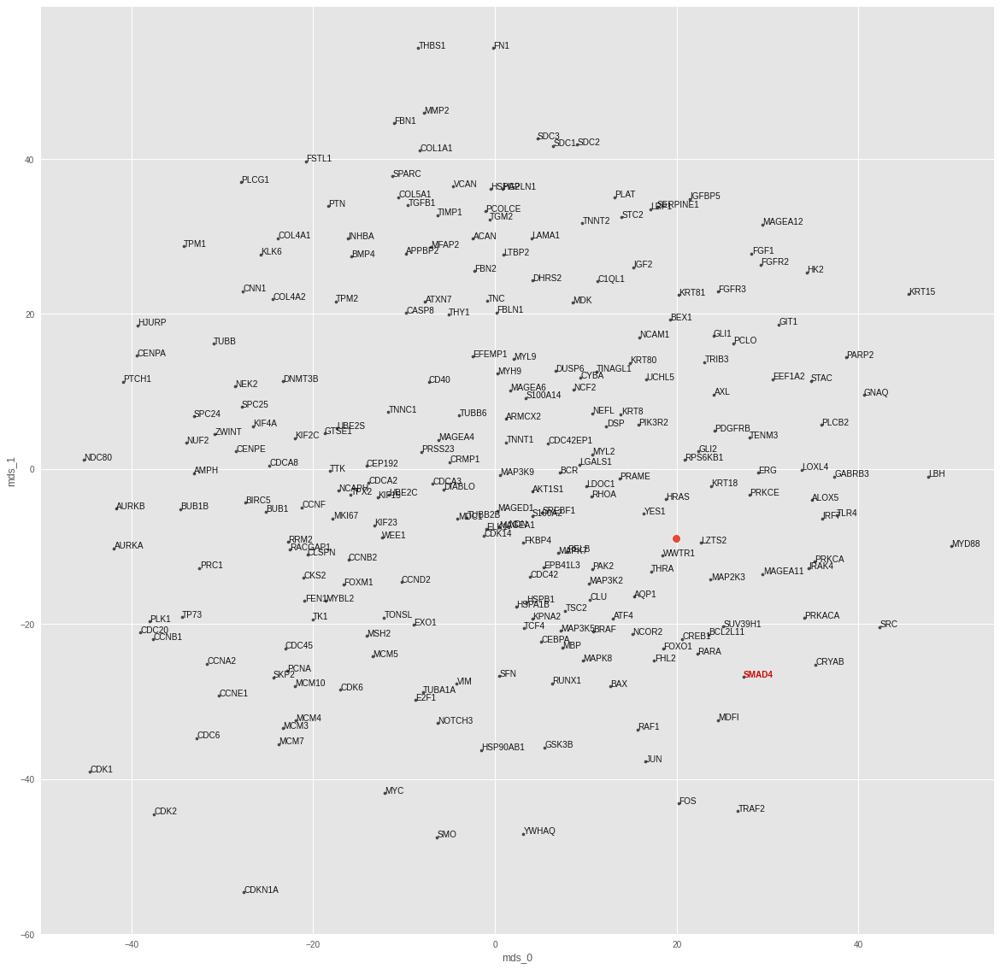

SMO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.152913661771699
train top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.894737, 10: 0.921053, 20: 0.973684, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.894737, 10: 0.921053, 20: 0.973684, 50: 1.0}
test loss: 2.2772960662841797
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


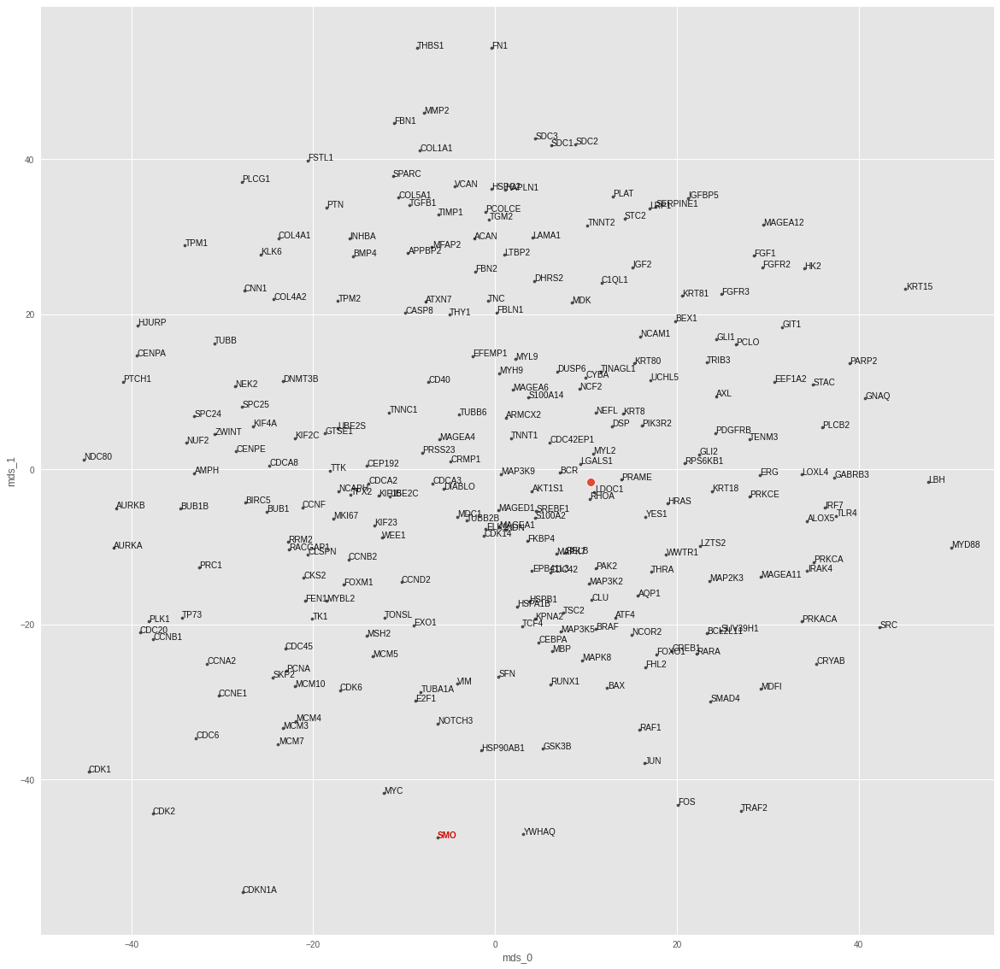

SRC
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.14254193164800344
train top-k accuracies: {1: 0.815789, 3: 0.921053, 5: 0.947368, 10: 0.947368, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.815789, 3: 0.921053, 5: 0.947368, 10: 0.947368, 20: 1.0, 50: 1.0}
test loss: 2.0350518226623535
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


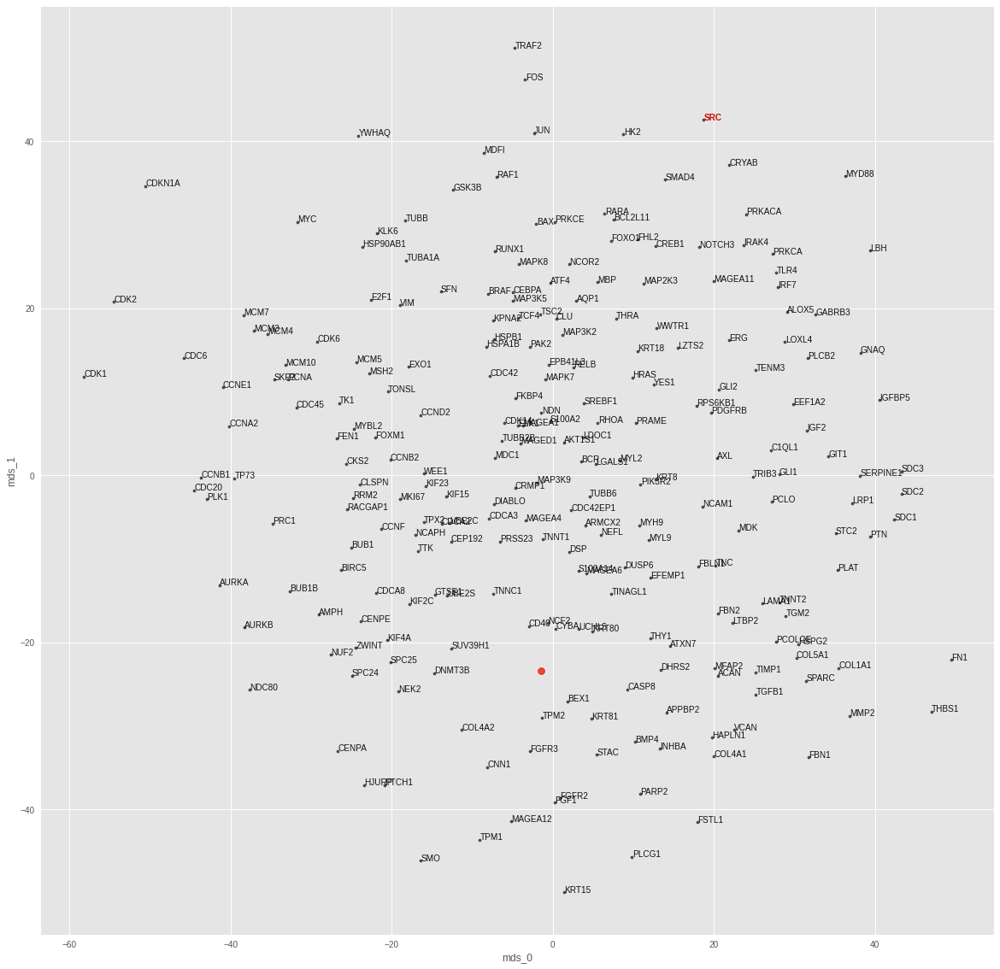

SREBF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.1675991400292045
train top-k accuracies: {1: 0.789474, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.789474, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.947368, 50: 1.0}
test loss: 0.4529317617416382
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


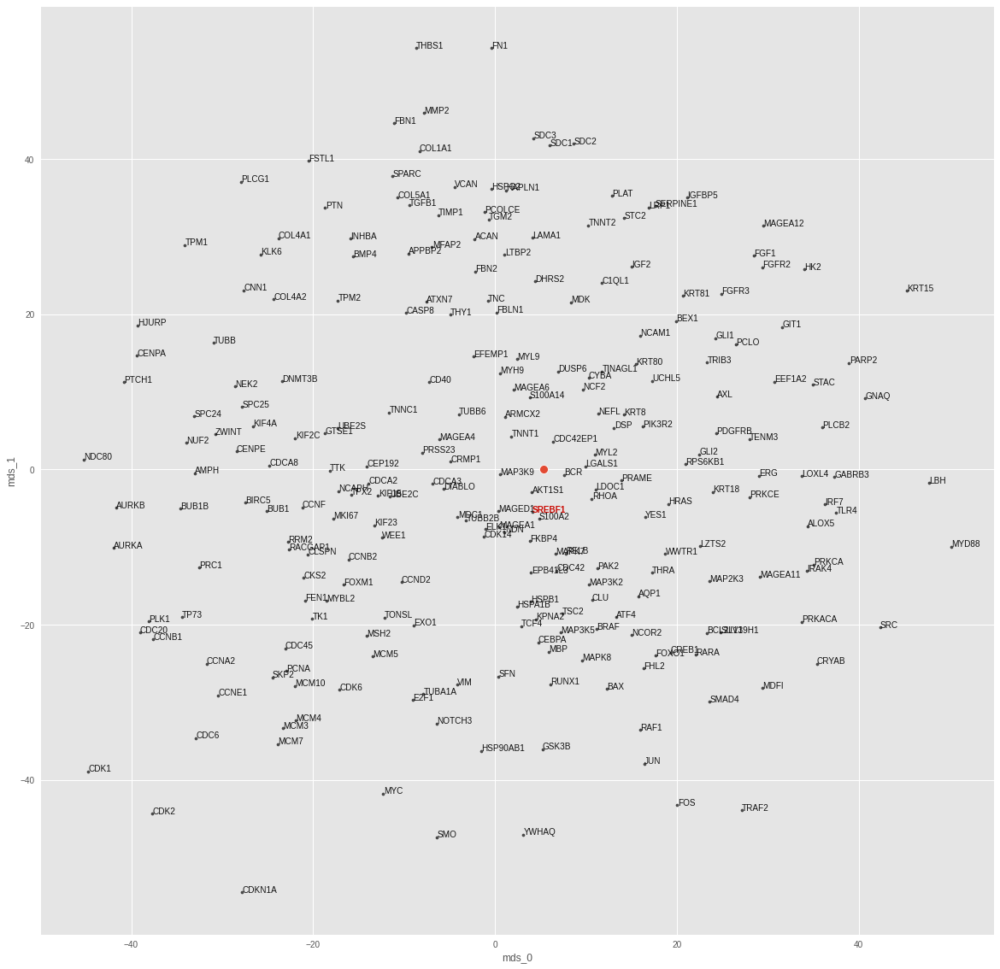

TRAF2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.13905834837963707
train top-k accuracies: {1: 0.789474, 3: 0.921053, 5: 0.973684, 10: 0.973684, 20: 0.973684, 50: 1.0}
train mean top-k accuracies: {1: 0.789474, 3: 0.921053, 5: 0.973684, 10: 0.973684, 20: 0.973684, 50: 1.0}
test loss: 2.611410140991211
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


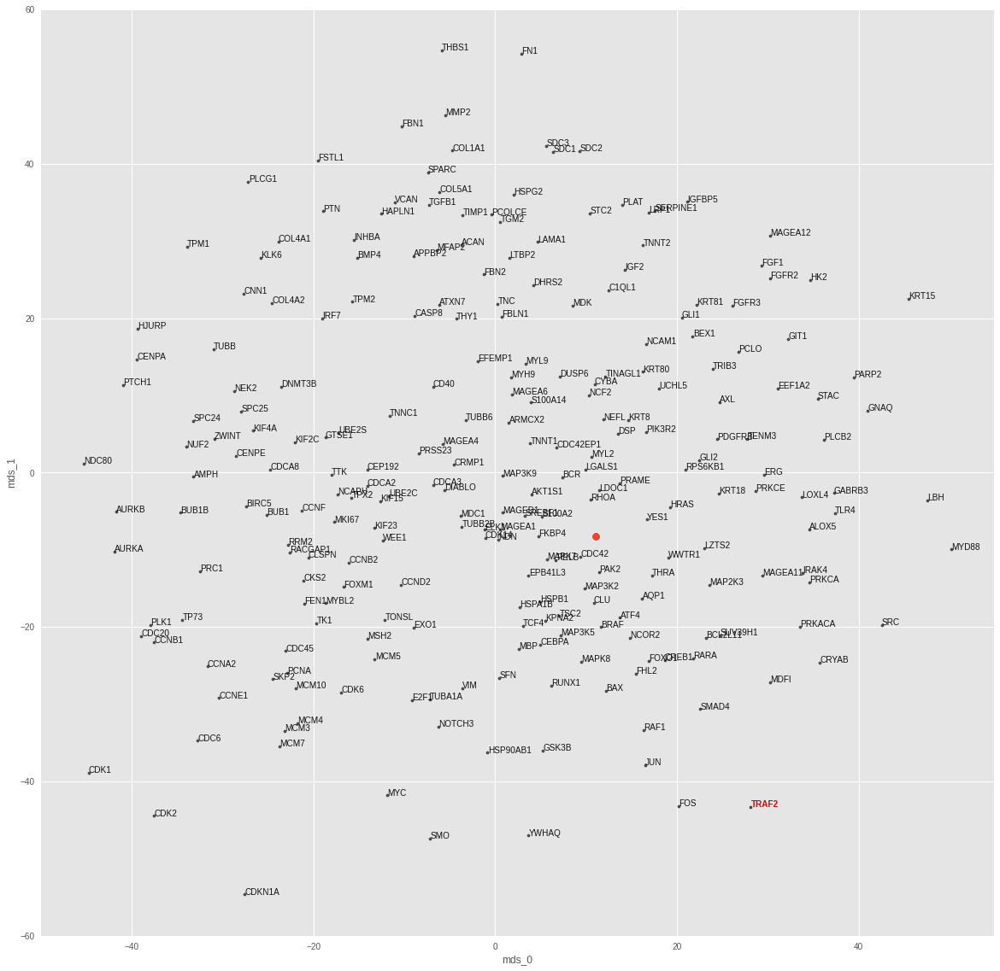

TSC2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.16366192071061386
train top-k accuracies: {1: 0.789474, 3: 0.894737, 5: 0.921053, 10: 0.921053, 20: 0.973684, 50: 1.0}
train mean top-k accuracies: {1: 0.789474, 3: 0.894737, 5: 0.921053, 10: 0.921053, 20: 0.973684, 50: 1.0}
test loss: 1.2645217180252075
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


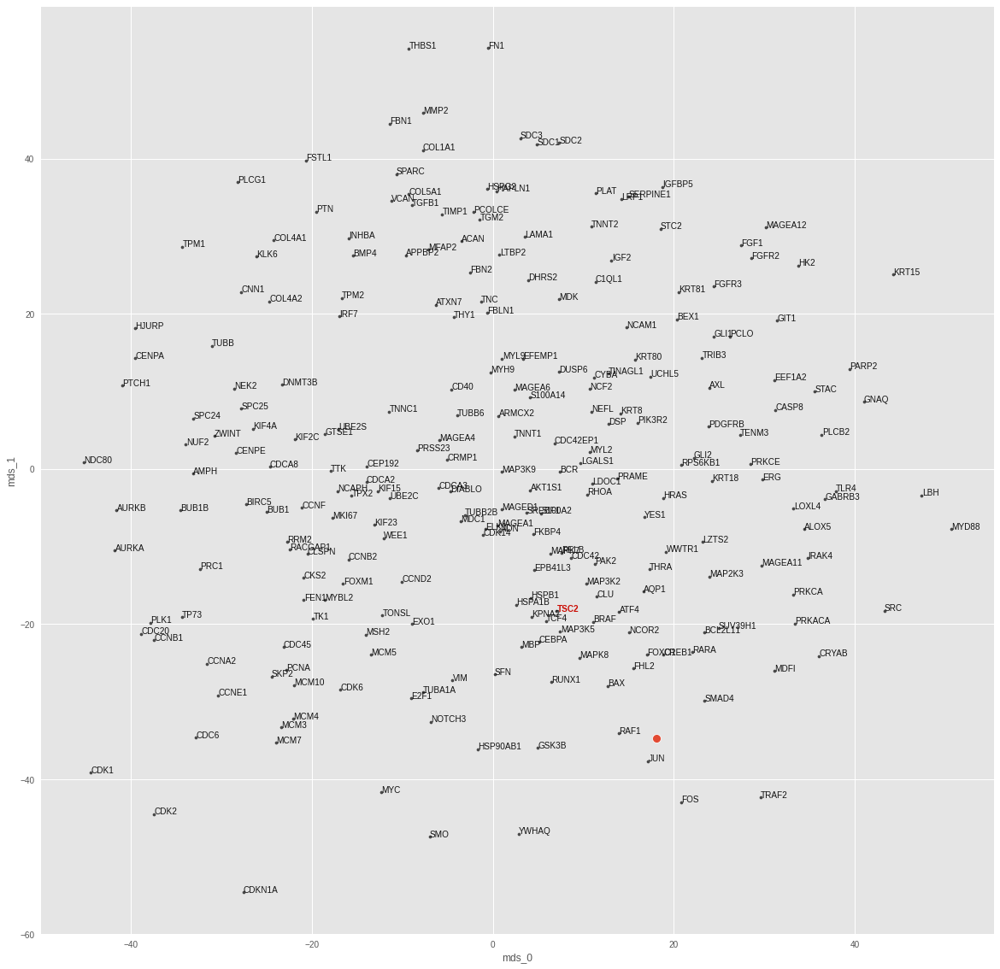

WWTR1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.17357515033922696
train top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.894737, 10: 0.921053, 20: 0.921053, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.894737, 10: 0.921053, 20: 0.921053, 50: 1.0}
test loss: 2.449906349182129
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


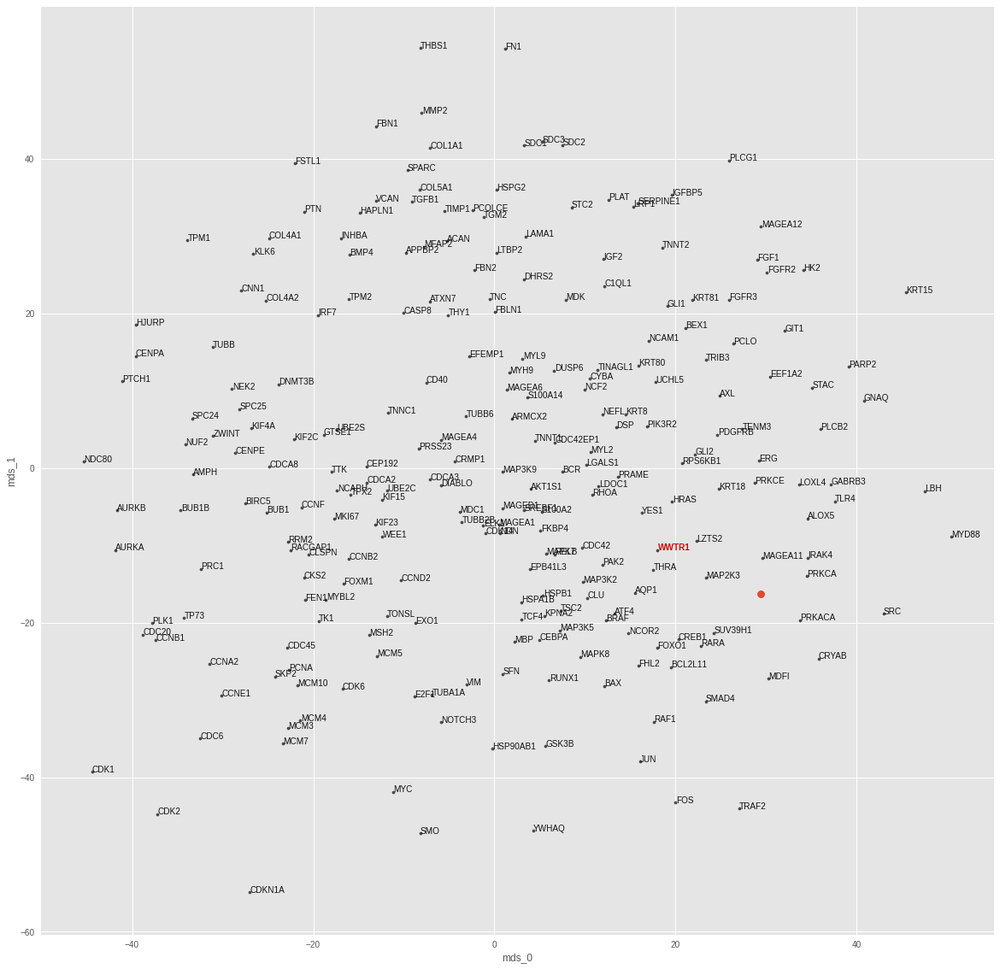

<IPython.core.display.Javascript object>

In [29]:
target_topk_accs = {}
mean_nonlin_nns = {}
for i in tqdm(range(len(data_dicts))):
    data_dict = data_dicts[i]
    model = torch.nn.Sequential(
        torch.nn.Linear(1024, 1024),
        torch.nn.PReLU(),
        torch.nn.Linear(1024, 1024),
    )
    optimizer = Adam(model.parameters(), lr=1e-4)
    criterion = torch.nn.MSELoss()
    target = sorted(list(shared_targets))[i]
    print(target)
    fitted_model, topk_acc, _, mean_knns = train_model_topk_acc(
        model=model,
        data_dict=data_dict,
        optimizer=optimizer,
        criterion=criterion,
        n_epochs=1000,
        early_stopping=1000,
        nn_clf=nn_clf,
        log_epochs=False,
    )
    target_topk_accs[target] = topk_acc
    mean_nonlin_nns[target] = mean_knns[0]
    fig, ax, _ = plot_translation(
        fitted_model.to("cpu"),
        data_dict["test"].dataset,
        node_embs,
        figsize=[20, 20],
        crop=False,
        highlight_target=target,
        pred_size=100,
        reg_size=10,
    )
    ax.get_legend().remove()
    plt.show()
    plt.close()

In [30]:
mean_nonlin_topk_df = pd.DataFrame(target_topk_accs).transpose()
mean_nonlin_topk_df.loc[mean_nonlin_topk_df.loc[:, 50] > 0].sort_values(
    [1, 3, 5, 10, 20, 50], ascending=False
)

,1,3,5,10,20,50
SREBF1,0.0,1.0,1.0,1.0,1.0,1.0
AKT1S1,0.0,0.0,1.0,1.0,1.0,1.0
BRAF,0.0,0.0,1.0,1.0,1.0,1.0
MAP3K2,0.0,0.0,0.0,1.0,1.0,1.0
CDC42,0.0,0.0,0.0,0.0,1.0,1.0
MAP3K5,0.0,0.0,0.0,0.0,1.0,1.0
MAPK7,0.0,0.0,0.0,0.0,1.0,1.0
RELB,0.0,0.0,0.0,0.0,1.0,1.0
BAX,0.0,0.0,0.0,0.0,0.0,1.0
BCL2L11,0.0,0.0,0.0,0.0,0.0,1.0


<IPython.core.display.Javascript object>

In [31]:
mean_nonlin_topk_df.describe()

,1,3,5,10,20,50
count,39.0,39.000000,39.000000,39.000000,39.000000,39.000000
mean,0.0,0.025641,0.076923,0.102564,0.205128,0.512821
std,0.0,0.160128,0.269953,0.307355,0.409074,0.506370
min,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.0,0.000000,0.000000,0.000000,0.000000,1.000000
75%,0.0,0.000000,0.000000,0.000000,0.000000,1.000000
max,0.0,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

---

### 2.4. Structural NN centroid translation

Next, we will move away from representing the structural phenotype induced by a single gene overexpression by the population mean of the cellular embeddings. Instead we have identified four different structural phenotype clusters per condition using 4-means clustering. Using those we aim to establish the translation between the structural and regulatory space.

To this end, we will first identify the one nearest neighbor of each cluster centroid for each target that does not correspond to the same gene overexpression condition. Next, we compute the mean embedding in the regulatory space of the corresponding one-nearest neighbors for each of the four cluster centroids. Finally, we assess the local neighborhood of this latent space location in a similar setting as before.

In [32]:
cl_img_embs_fold0, cl_node_embs_fold0, labels = cl_img_node_embs_dict["fold0"]

<IPython.core.display.Javascript object>

In [33]:
struct_nn_centroid_pred_dict = get_struct_nn_centroid_translation_dict(
    cl_img_embs_fold0, node_embs
)
struct_nn_centroid_topk = get_topk_acc_from_nn_dict(struct_nn_centroid_pred_dict)
struct_nn_centroid_topk.describe()

,top-1,top-3,top-5,top-10,top-20,top-50
count,39.0,39.000000,39.000000,39.000000,39.000000,39.000000
mean,0.0,0.025641,0.025641,0.102564,0.230769,0.512821
std,0.0,0.160128,0.160128,0.307355,0.426833,0.506370
min,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.0,0.000000,0.000000,0.000000,0.000000,1.000000
75%,0.0,0.000000,0.000000,0.000000,0.000000,1.000000
max,0.0,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

---

### 3.5. Linear 3-centroids mapping

In [34]:
cl_img_embs_fold0, cl_node_embs_fold0, labels = cl_img_node_embs_dict["fold0"]
cl_data_dicts = get_logo_data_dicts(
    data=cl_img_embs_fold0,
    labels=cl_node_embs_fold0,
    val_size=0,
    group_labels=np.array(labels),
    batch_size=32 * 4,
    balanced=False,
    scale_x=False,
    scale_y=False,
)

<IPython.core.display.Javascript object>

  0%|          | 0/39 [00:00<?, ?it/s]

AKT1S1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20992553234100342
train top-k accuracies: {1: 0.649123, 3: 0.763158, 5: 0.824561, 10: 0.842105, 20: 0.859649, 50: 0.964912}
train mean top-k accuracies: {1: 0.710526, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.973684, 50: 1.0}
test loss: 0.383882611989975
test top-k accuracies: {1: 0.666667, 3: 0.666667, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


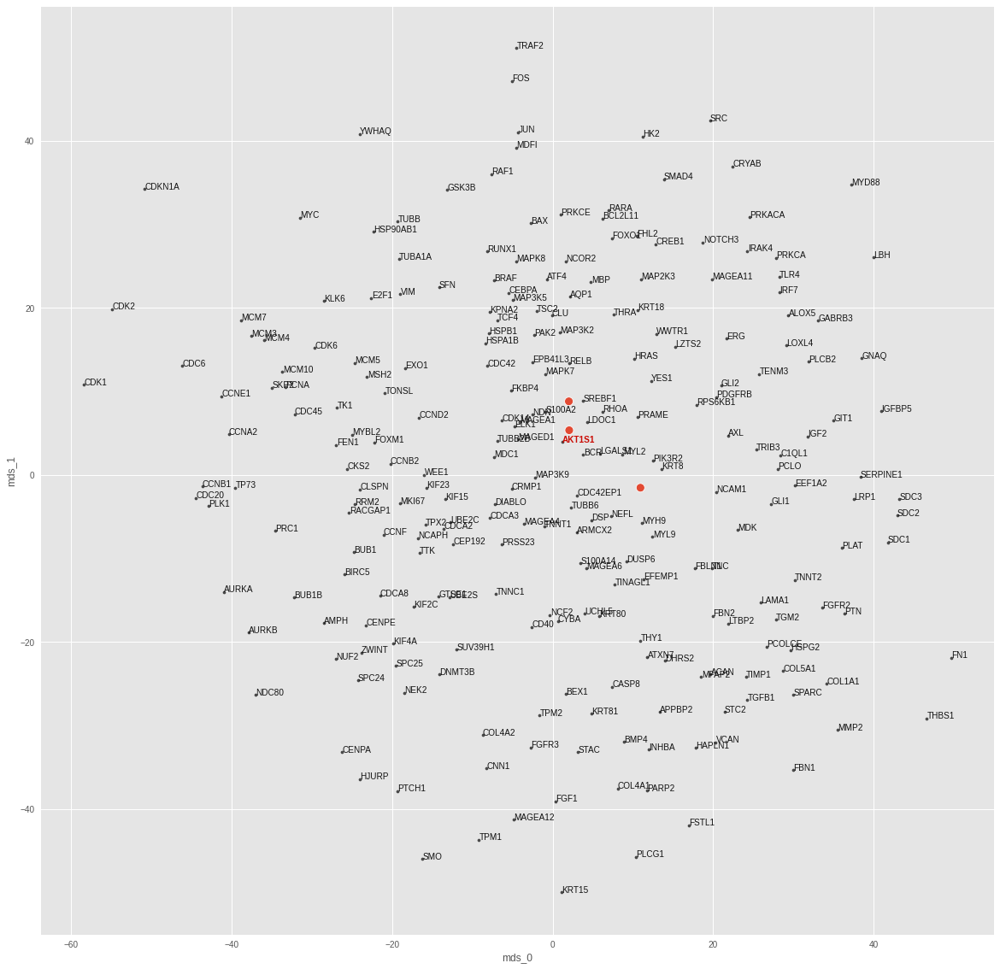

ATF4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20702609419822693
train top-k accuracies: {1: 0.640351, 3: 0.77193, 5: 0.824561, 10: 0.842105, 20: 0.868421, 50: 0.95614}
train mean top-k accuracies: {1: 0.710526, 3: 0.894737, 5: 0.921053, 10: 0.921053, 20: 0.973684, 50: 1.0}
test loss: 0.8766752481460571
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


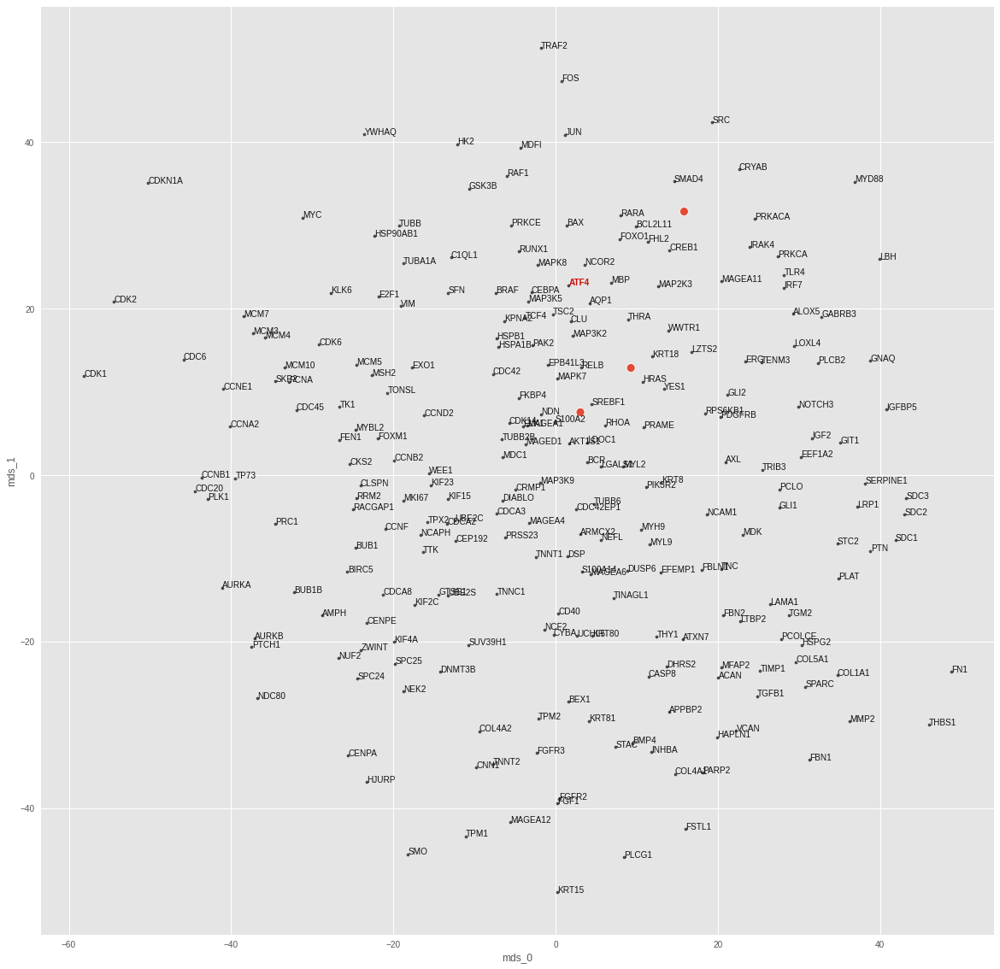

BAX
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20300538837909698
train top-k accuracies: {1: 0.675439, 3: 0.780702, 5: 0.833333, 10: 0.850877, 20: 0.885965, 50: 0.95614}
train mean top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.973684, 20: 0.973684, 50: 1.0}
test loss: 1.0293948650360107
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


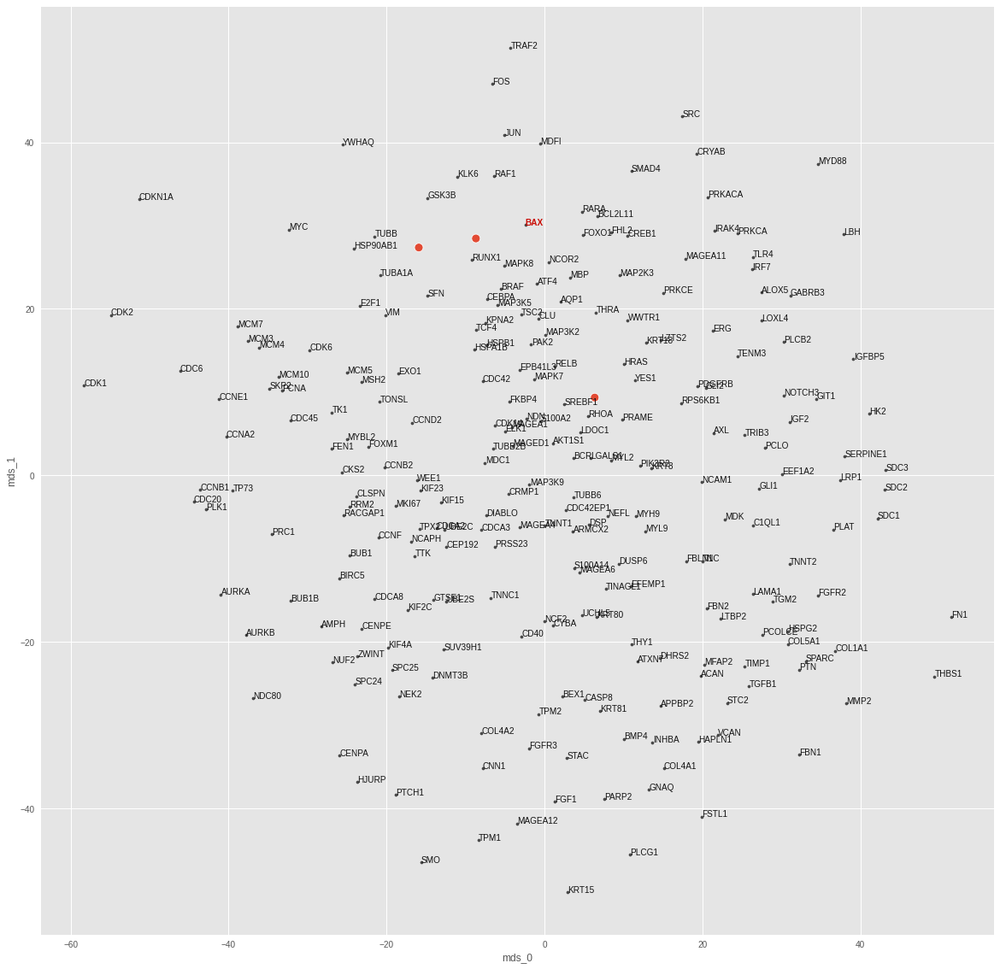

BCL2L11
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20611867308616638
train top-k accuracies: {1: 0.666667, 3: 0.763158, 5: 0.815789, 10: 0.850877, 20: 0.877193, 50: 0.964912}
train mean top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.973684, 20: 0.973684, 50: 1.0}
test loss: 1.478569507598877
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


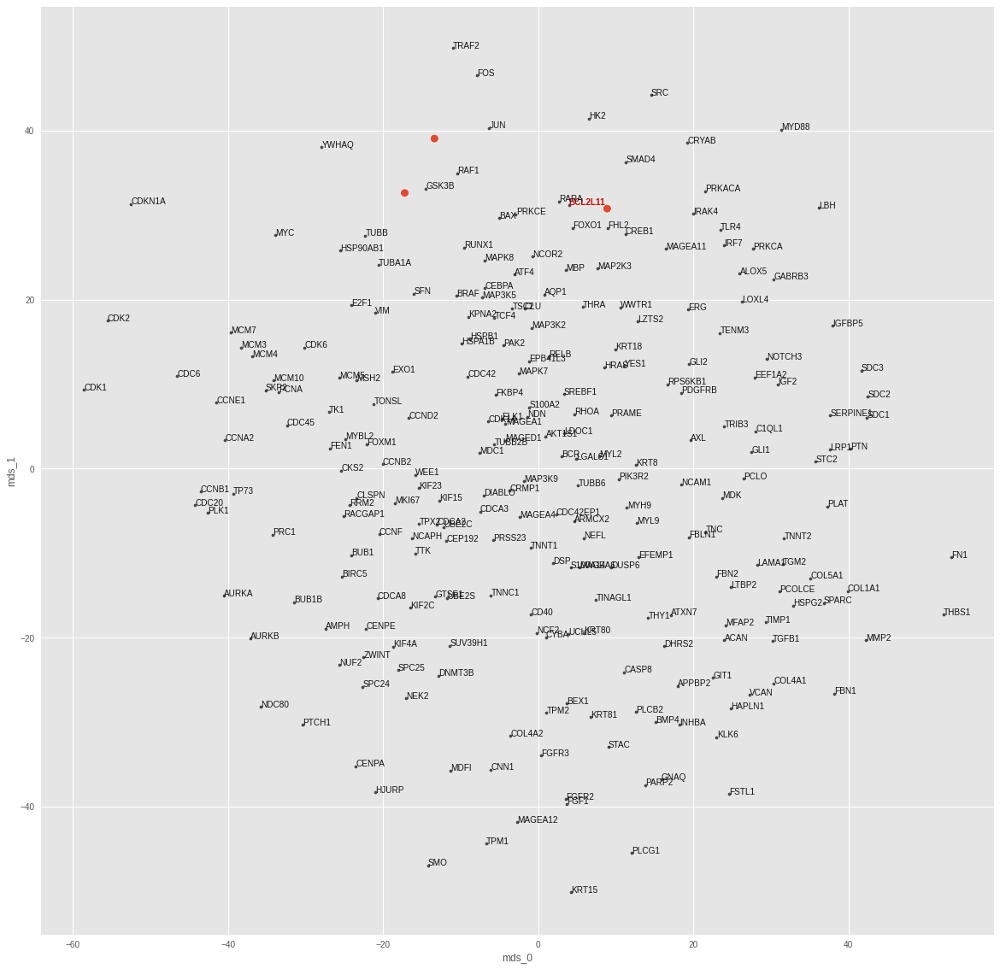

BRAF
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20781567692756653
train top-k accuracies: {1: 0.657895, 3: 0.780702, 5: 0.824561, 10: 0.850877, 20: 0.877193, 50: 0.95614}
train mean top-k accuracies: {1: 0.710526, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.973684, 50: 1.0}
test loss: 0.42057761549949646
test top-k accuracies: {1: 0.333333, 3: 0.333333, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


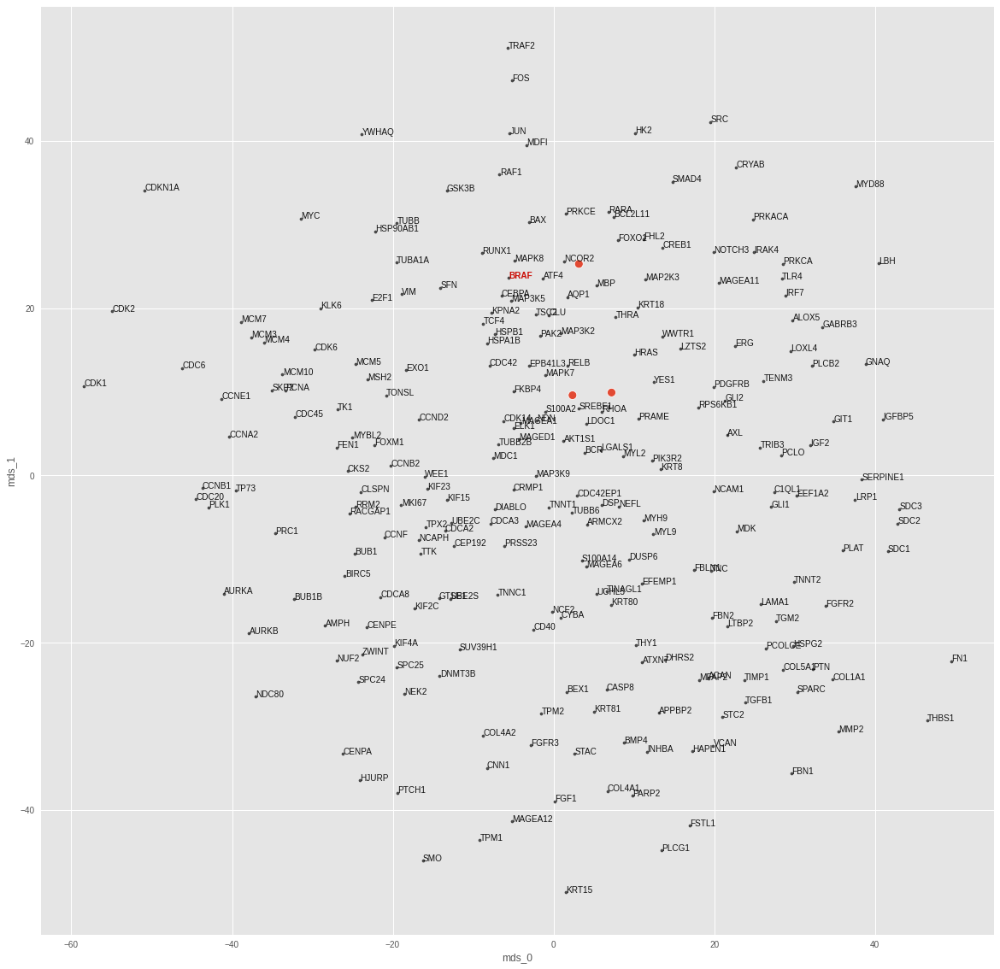

CASP8
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20505152642726898
train top-k accuracies: {1: 0.657895, 3: 0.77193, 5: 0.824561, 10: 0.850877, 20: 0.877193, 50: 0.964912}
train mean top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.973684, 50: 1.0}
test loss: 3.0983901023864746
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


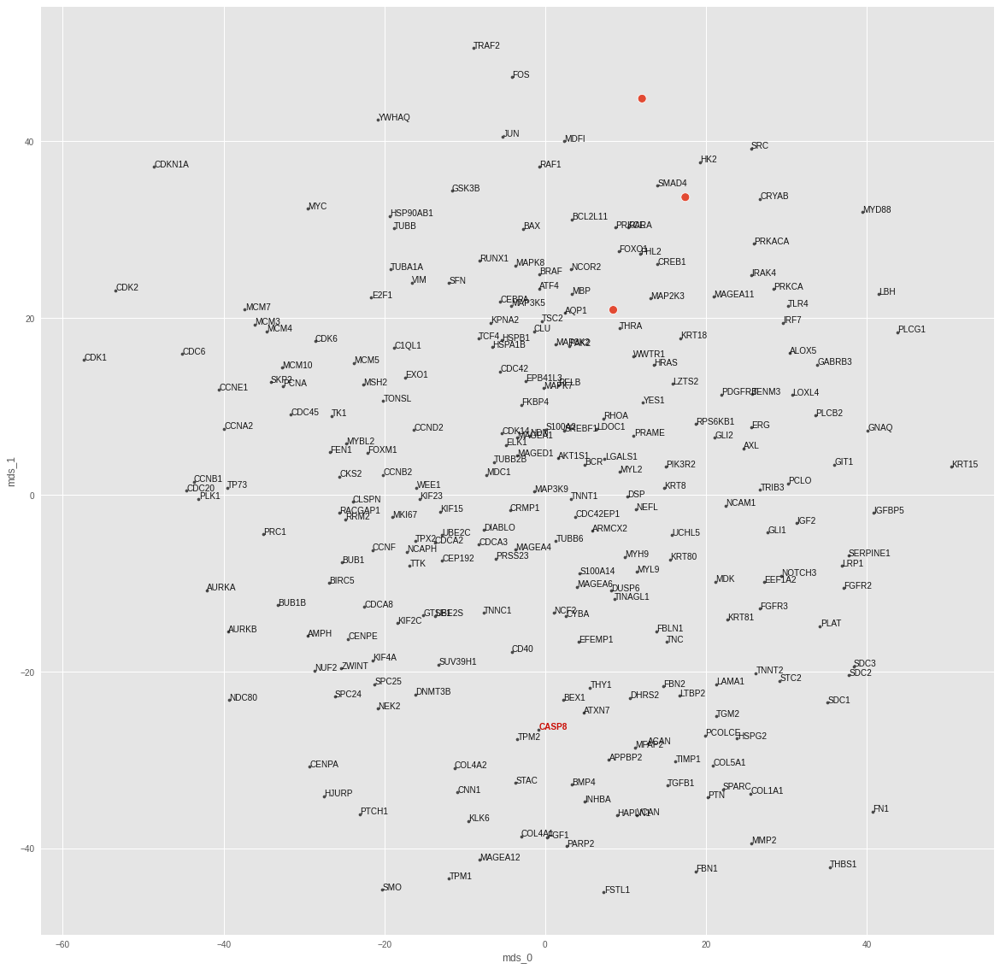

CDC42
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20474492013454437
train top-k accuracies: {1: 0.666667, 3: 0.780702, 5: 0.833333, 10: 0.850877, 20: 0.877193, 50: 0.964912}
train mean top-k accuracies: {1: 0.710526, 3: 0.894737, 5: 0.921053, 10: 0.921053, 20: 1.0, 50: 1.0}
test loss: 1.2381960153579712
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


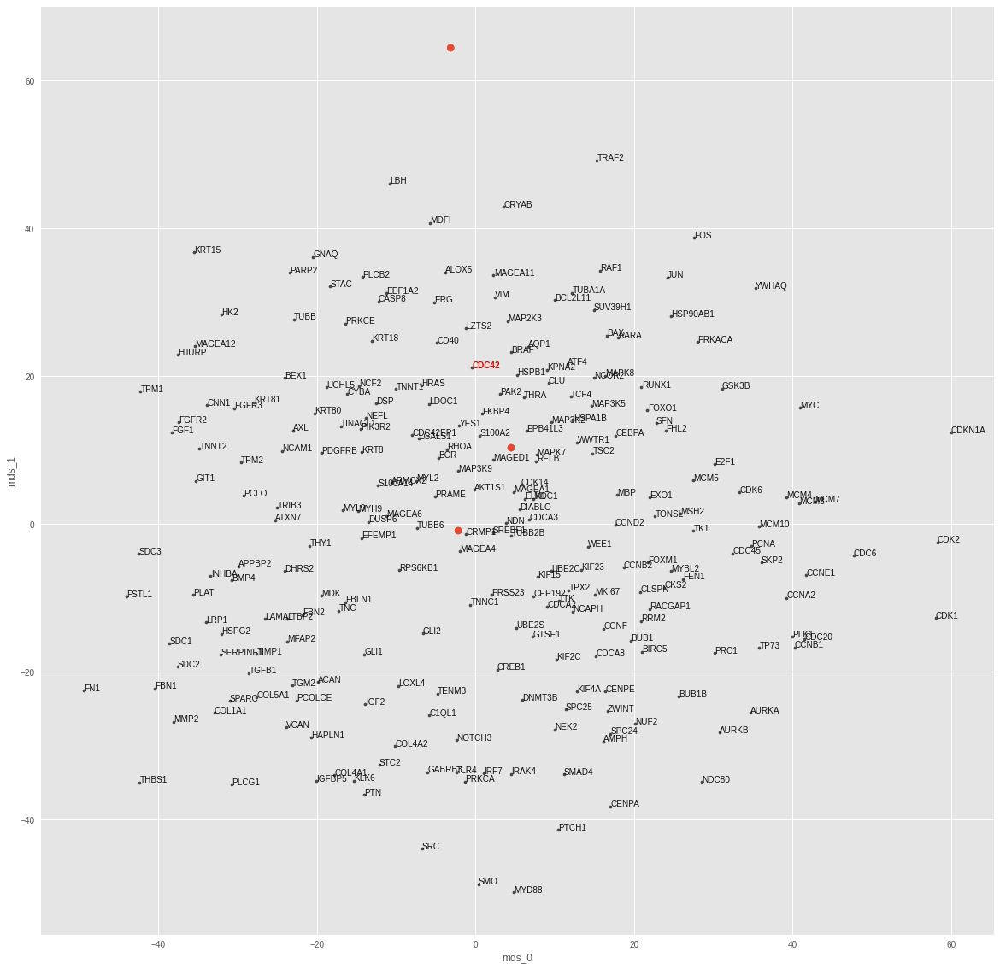

CDKN1A
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20124194025993347
train top-k accuracies: {1: 0.657895, 3: 0.754386, 5: 0.815789, 10: 0.842105, 20: 0.885965, 50: 0.964912}
train mean top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.921053, 10: 0.973684, 20: 0.973684, 50: 1.0}
test loss: 3.1567440032958984
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


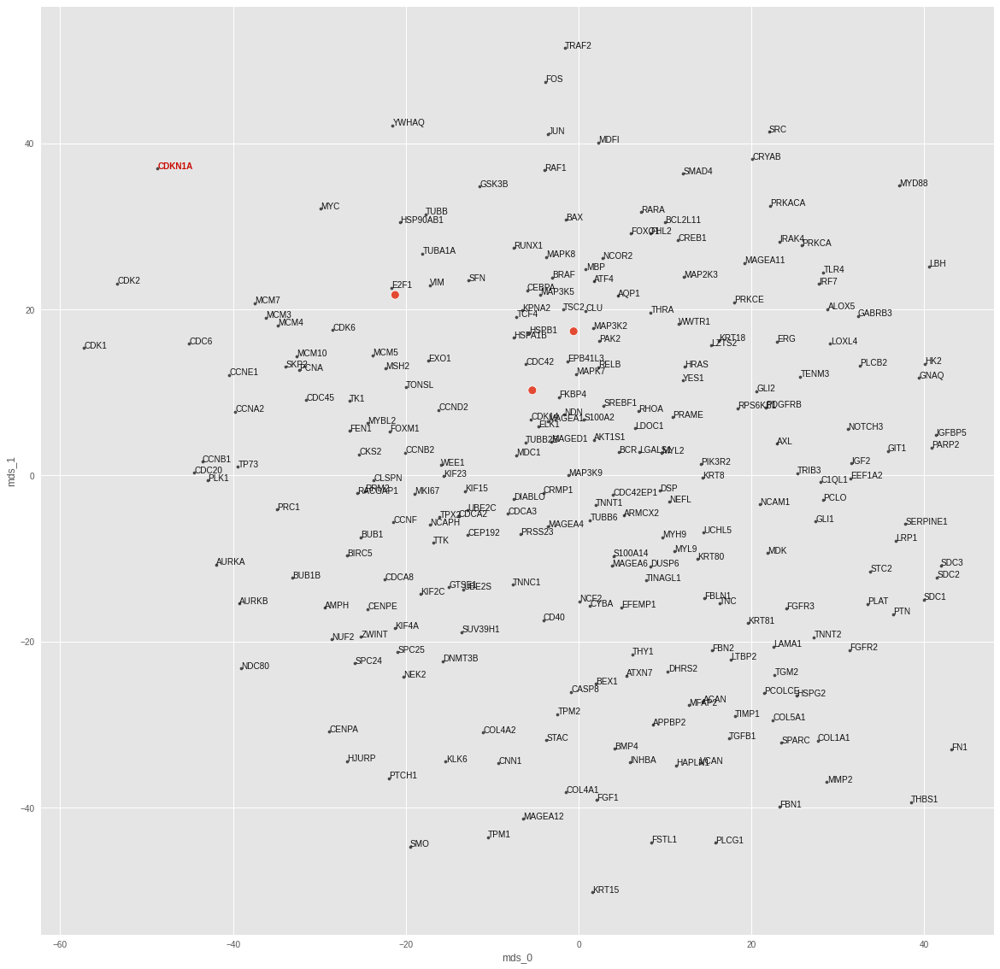

CEBPA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20966501533985138
train top-k accuracies: {1: 0.649123, 3: 0.754386, 5: 0.824561, 10: 0.842105, 20: 0.868421, 50: 0.95614}
train mean top-k accuracies: {1: 0.710526, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.973684, 50: 1.0}
test loss: 0.7180442810058594
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.666667, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


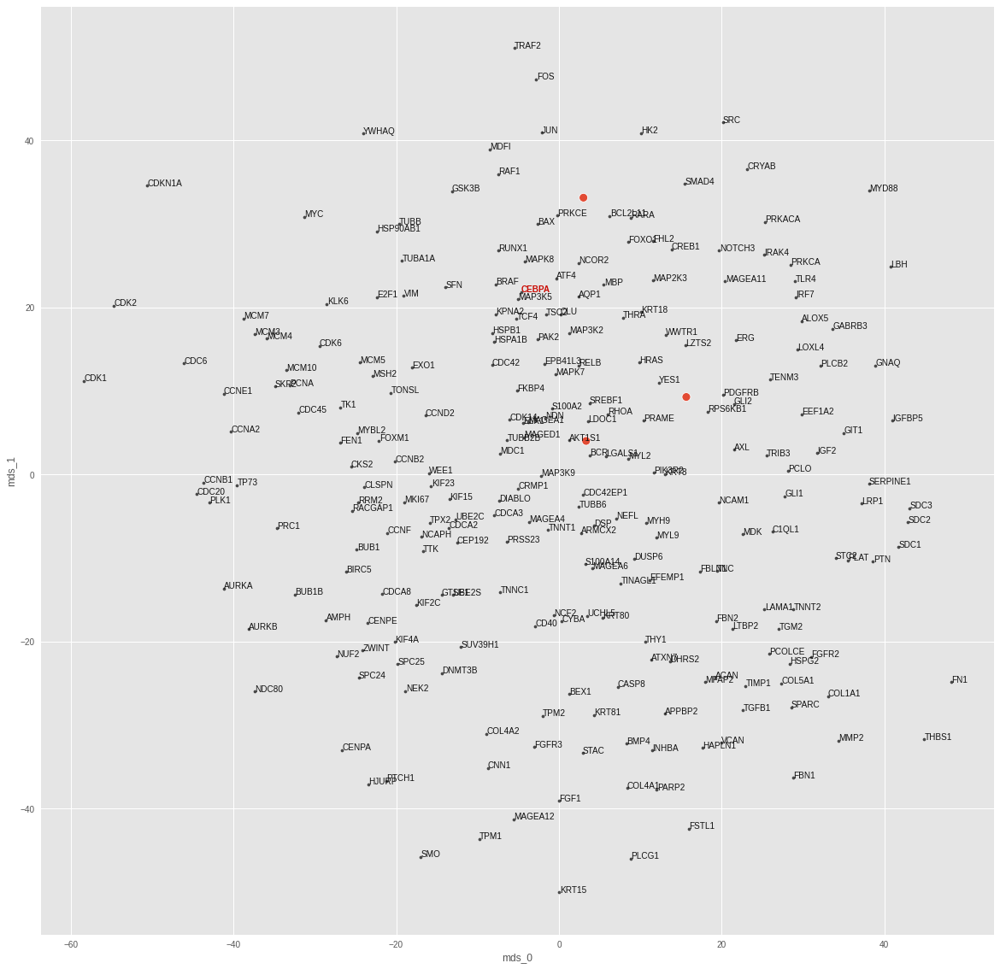

CREB1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20492447912693024
train top-k accuracies: {1: 0.649123, 3: 0.780702, 5: 0.833333, 10: 0.842105, 20: 0.868421, 50: 0.95614}
train mean top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.973684, 50: 1.0}
test loss: 1.2055261135101318
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


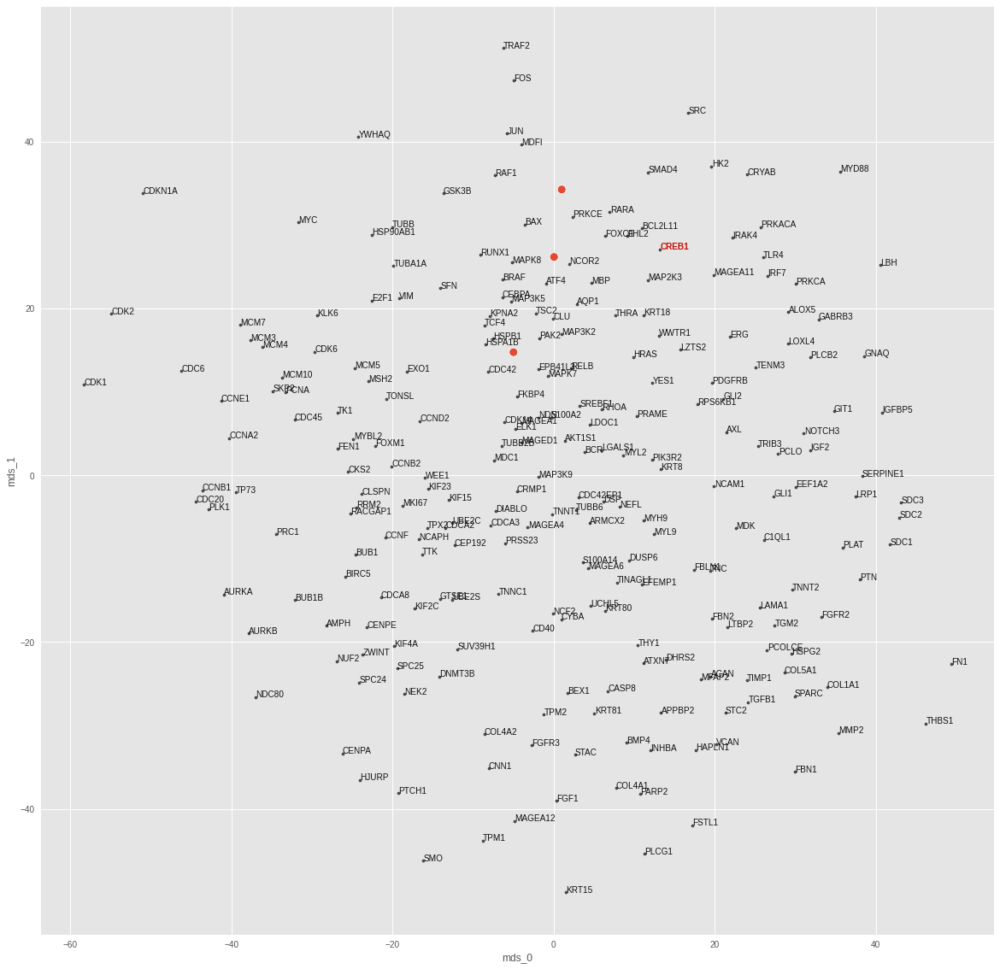

DIABLO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20778010785579681
train top-k accuracies: {1: 0.657895, 3: 0.763158, 5: 0.815789, 10: 0.850877, 20: 0.868421, 50: 0.964912}
train mean top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.973684, 50: 1.0}
test loss: 1.0171867609024048
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


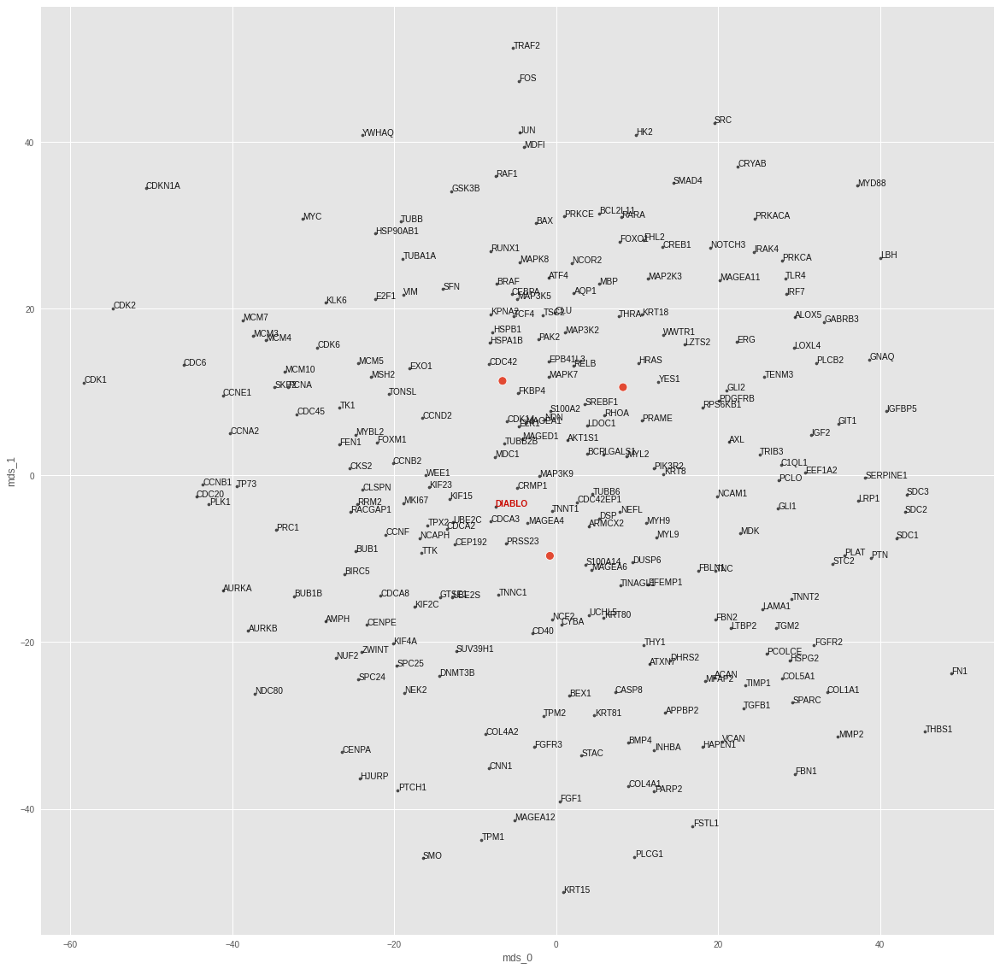

E2F1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.2060094177722931
train top-k accuracies: {1: 0.649123, 3: 0.780702, 5: 0.833333, 10: 0.842105, 20: 0.877193, 50: 0.95614}
train mean top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.973684, 20: 0.973684, 50: 1.0}
test loss: 2.139458417892456
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


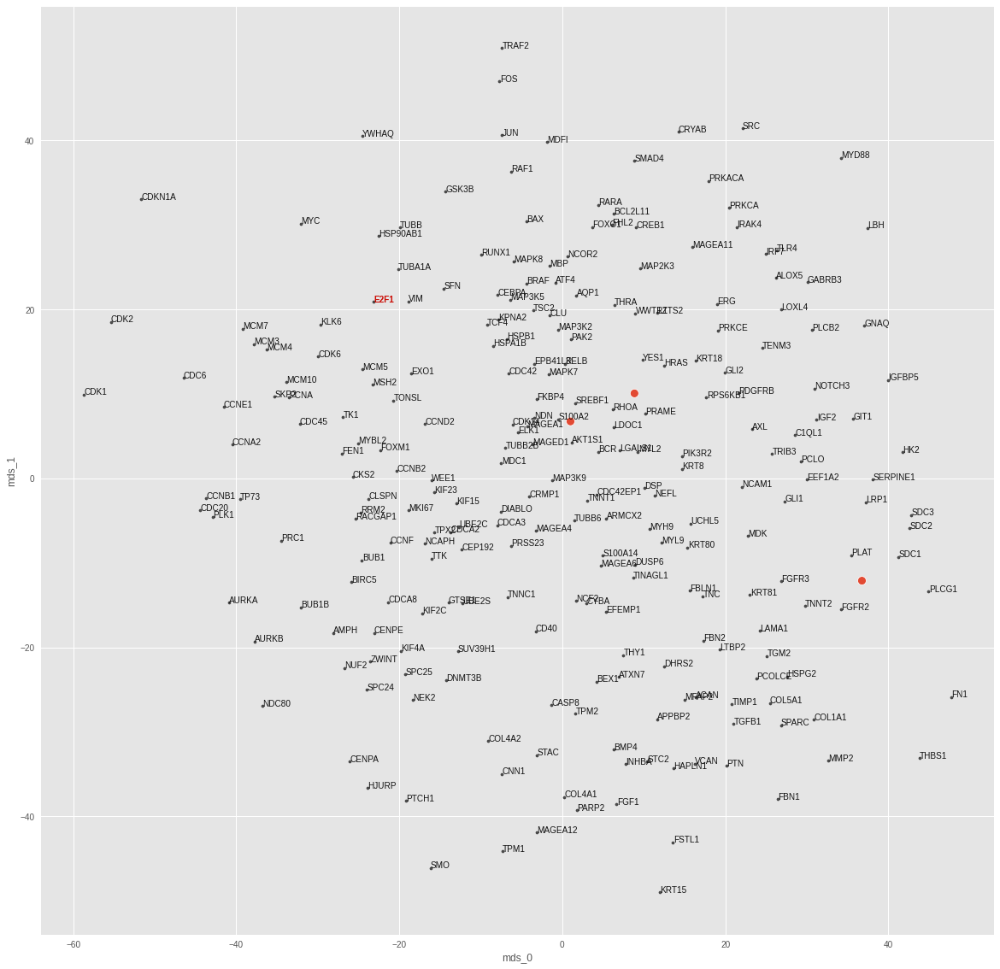

ELK1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20946690440177917
train top-k accuracies: {1: 0.640351, 3: 0.77193, 5: 0.824561, 10: 0.842105, 20: 0.877193, 50: 0.95614}
train mean top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.973684, 50: 1.0}
test loss: 0.8143951296806335
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.333333, 20: 0.333333, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


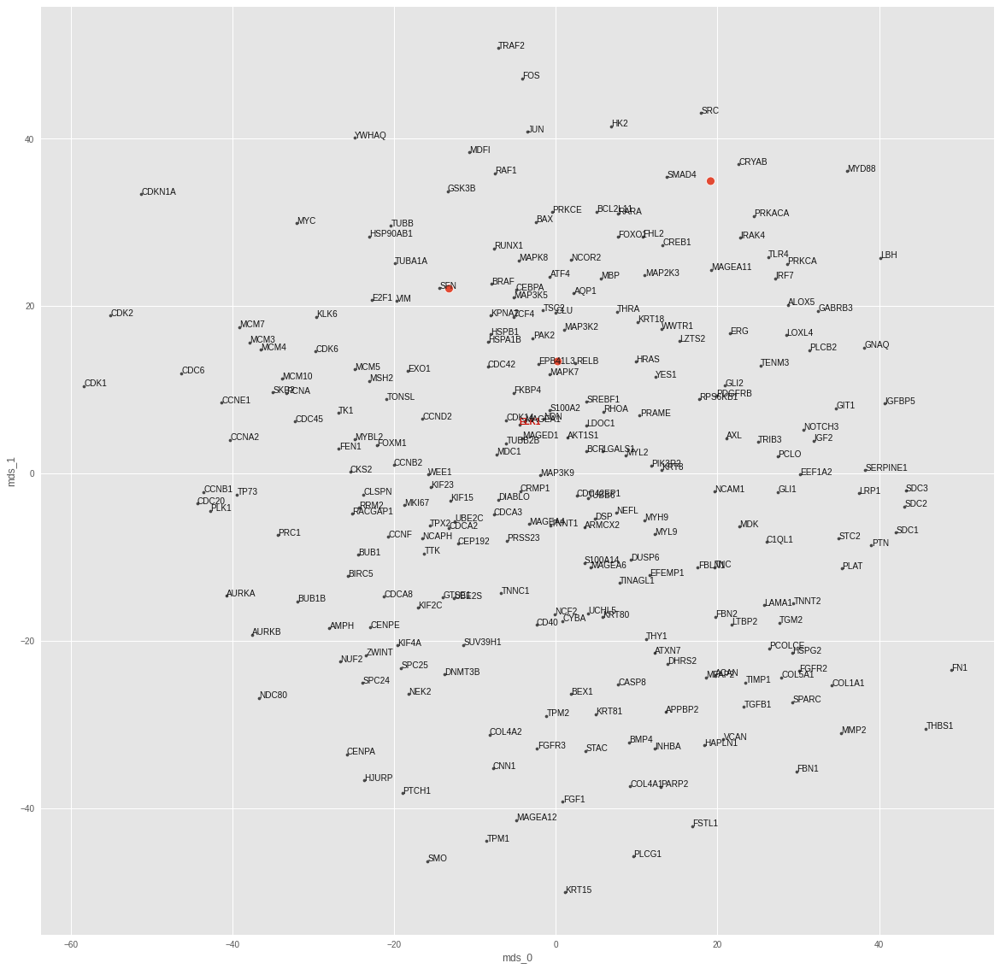

ERG
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20666010677814484
train top-k accuracies: {1: 0.657895, 3: 0.77193, 5: 0.815789, 10: 0.842105, 20: 0.868421, 50: 0.95614}
train mean top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.921053, 20: 0.973684, 50: 1.0}
test loss: 1.2802250385284424
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


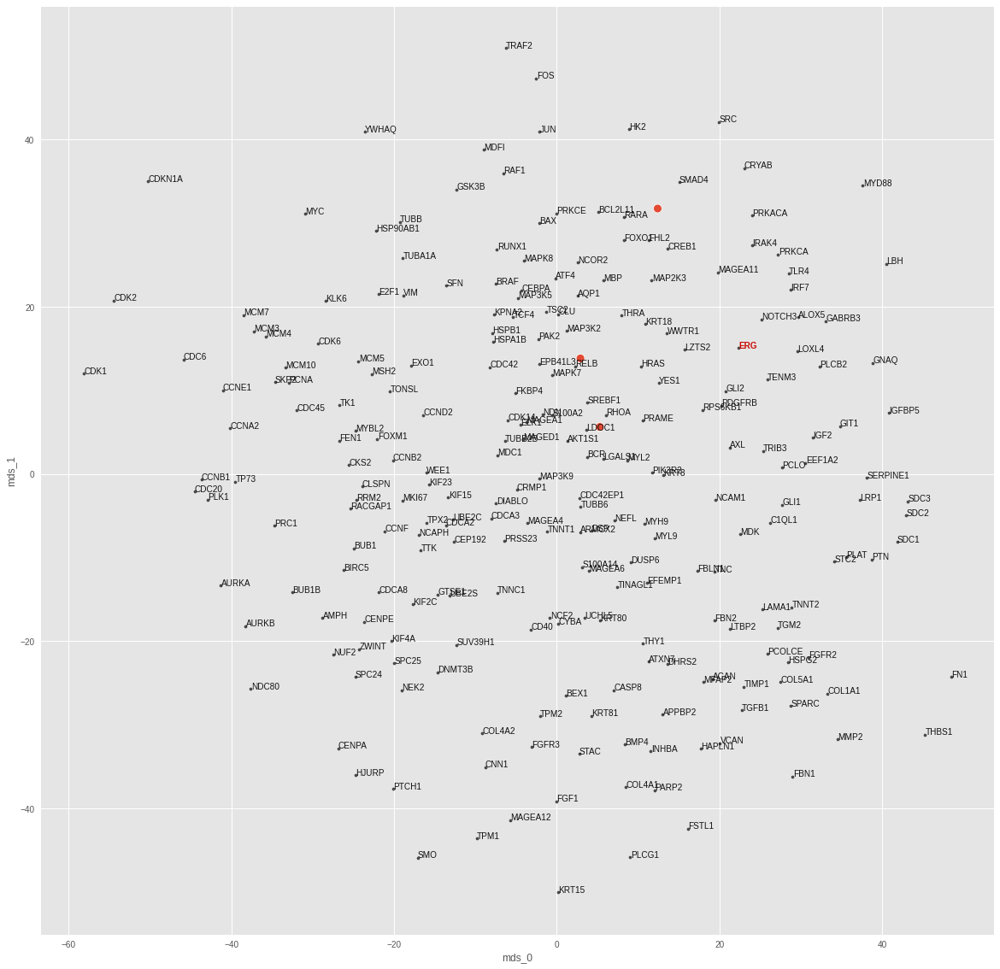

FGFR3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.1985919028520584
train top-k accuracies: {1: 0.675439, 3: 0.780702, 5: 0.824561, 10: 0.859649, 20: 0.885965, 50: 0.95614}
train mean top-k accuracies: {1: 0.763158, 3: 0.921053, 5: 0.947368, 10: 0.947368, 20: 0.973684, 50: 1.0}
test loss: 1.598708152770996
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


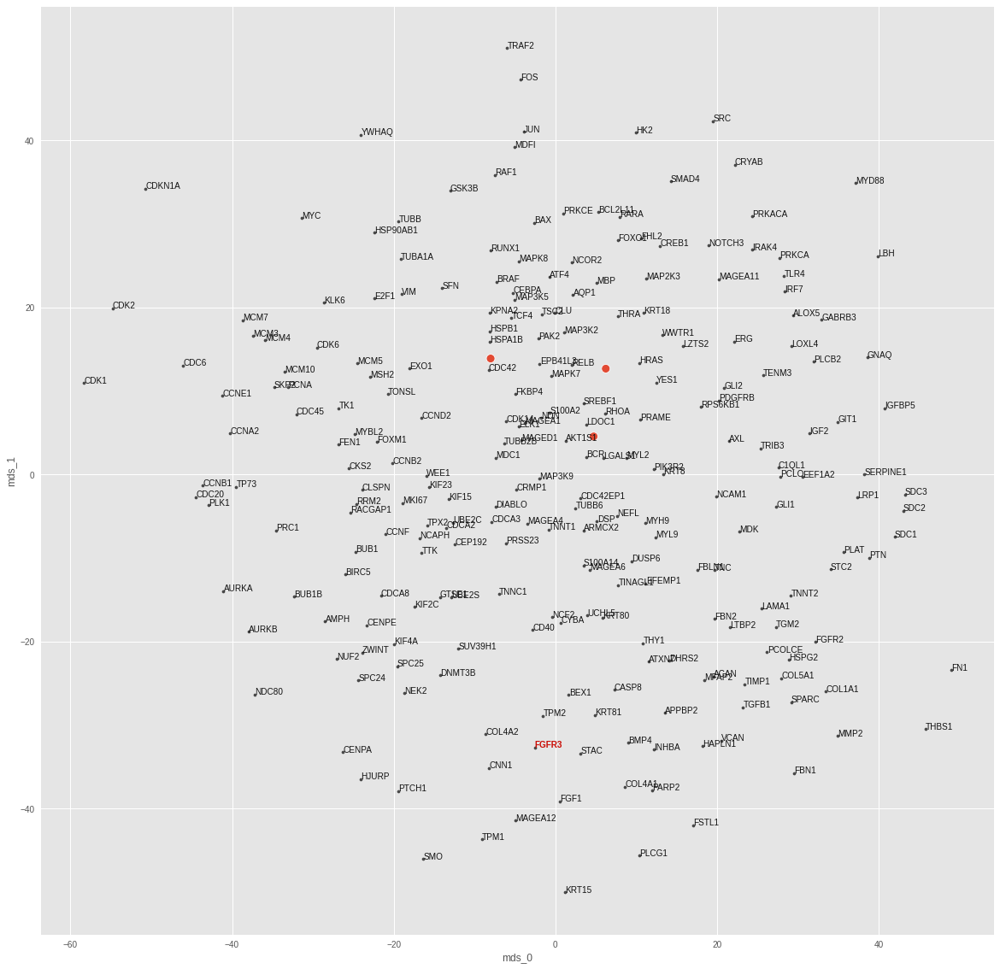

FOXO1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.2030733972787857
train top-k accuracies: {1: 0.657895, 3: 0.780702, 5: 0.833333, 10: 0.850877, 20: 0.885965, 50: 0.964912}
train mean top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.921053, 10: 0.973684, 20: 0.973684, 50: 1.0}
test loss: 0.9443744421005249
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


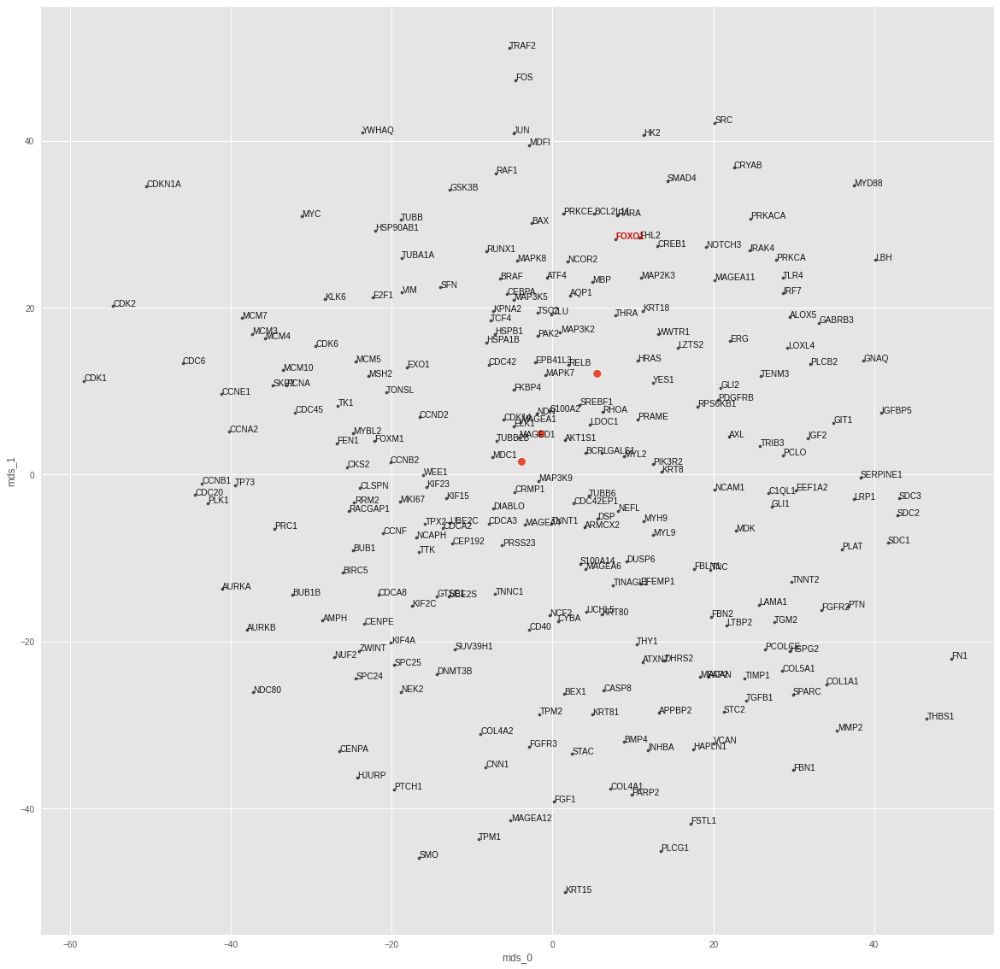

GLI1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20684771239757538
train top-k accuracies: {1: 0.692982, 3: 0.77193, 5: 0.833333, 10: 0.842105, 20: 0.885965, 50: 0.95614}
train mean top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.921053, 20: 0.973684, 50: 1.0}
test loss: 1.2267907857894897
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


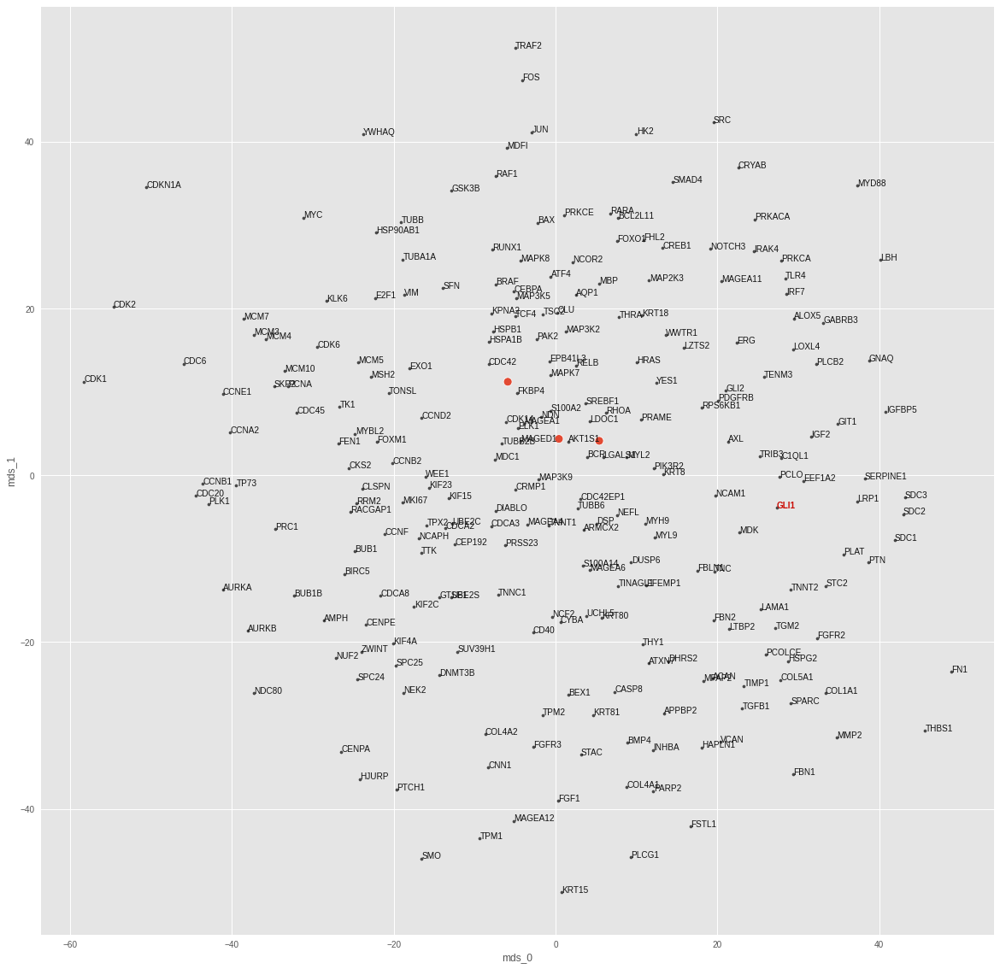

HRAS
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20947480201721191
train top-k accuracies: {1: 0.631579, 3: 0.754386, 5: 0.833333, 10: 0.842105, 20: 0.877193, 50: 0.95614}
train mean top-k accuracies: {1: 0.710526, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.973684, 50: 1.0}
test loss: 1.059263825416565
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


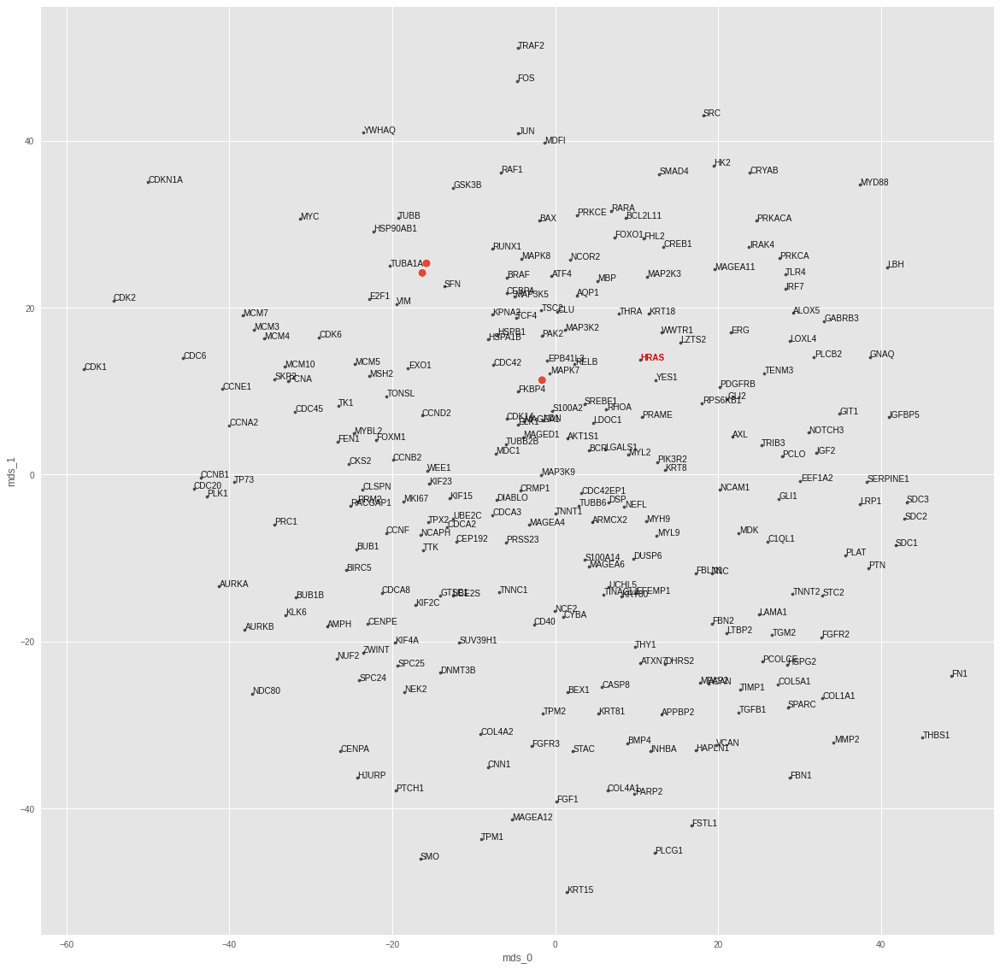

IRAK4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20383723080158234
train top-k accuracies: {1: 0.640351, 3: 0.77193, 5: 0.833333, 10: 0.850877, 20: 0.885965, 50: 0.964912}
train mean top-k accuracies: {1: 0.710526, 3: 0.894737, 5: 0.921053, 10: 0.973684, 20: 0.973684, 50: 1.0}
test loss: 1.2434805631637573
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


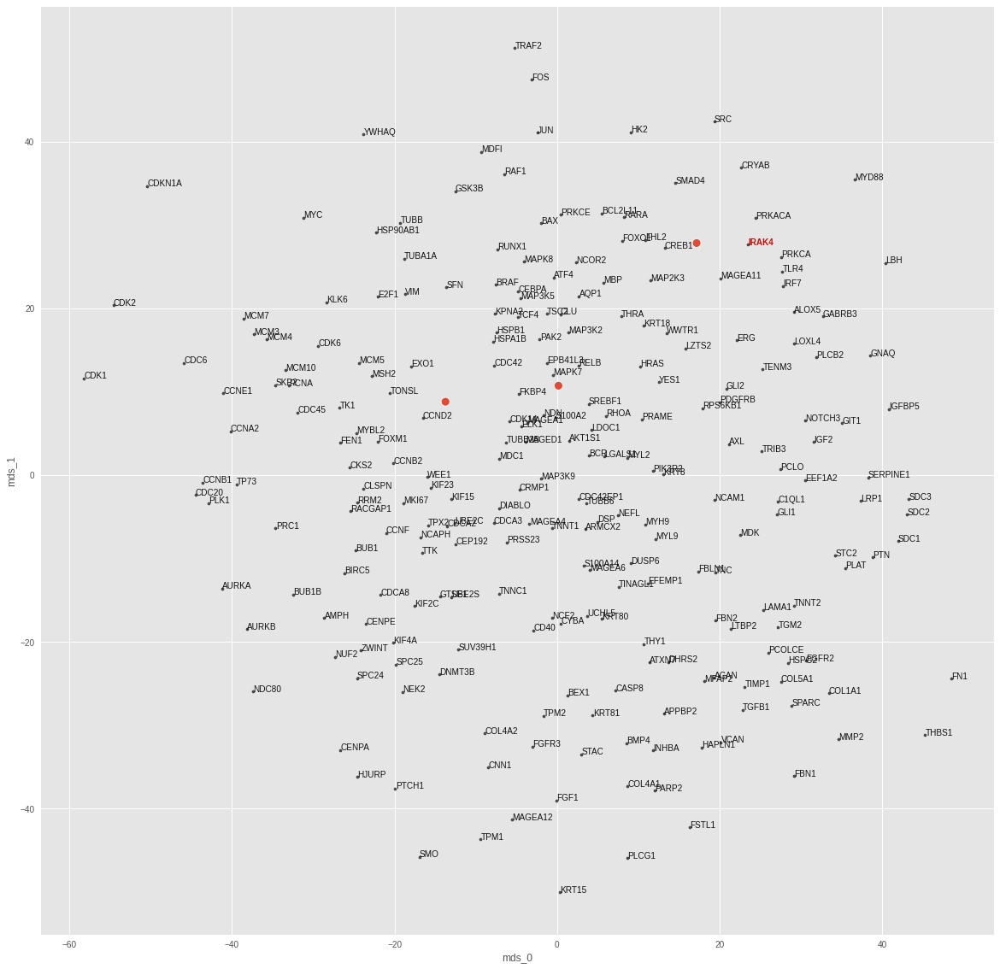

JUN
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20468269288539886
train top-k accuracies: {1: 0.666667, 3: 0.780702, 5: 0.815789, 10: 0.842105, 20: 0.877193, 50: 0.95614}
train mean top-k accuracies: {1: 0.710526, 3: 0.894737, 5: 0.921053, 10: 0.973684, 20: 0.973684, 50: 1.0}
test loss: 1.3193892240524292
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


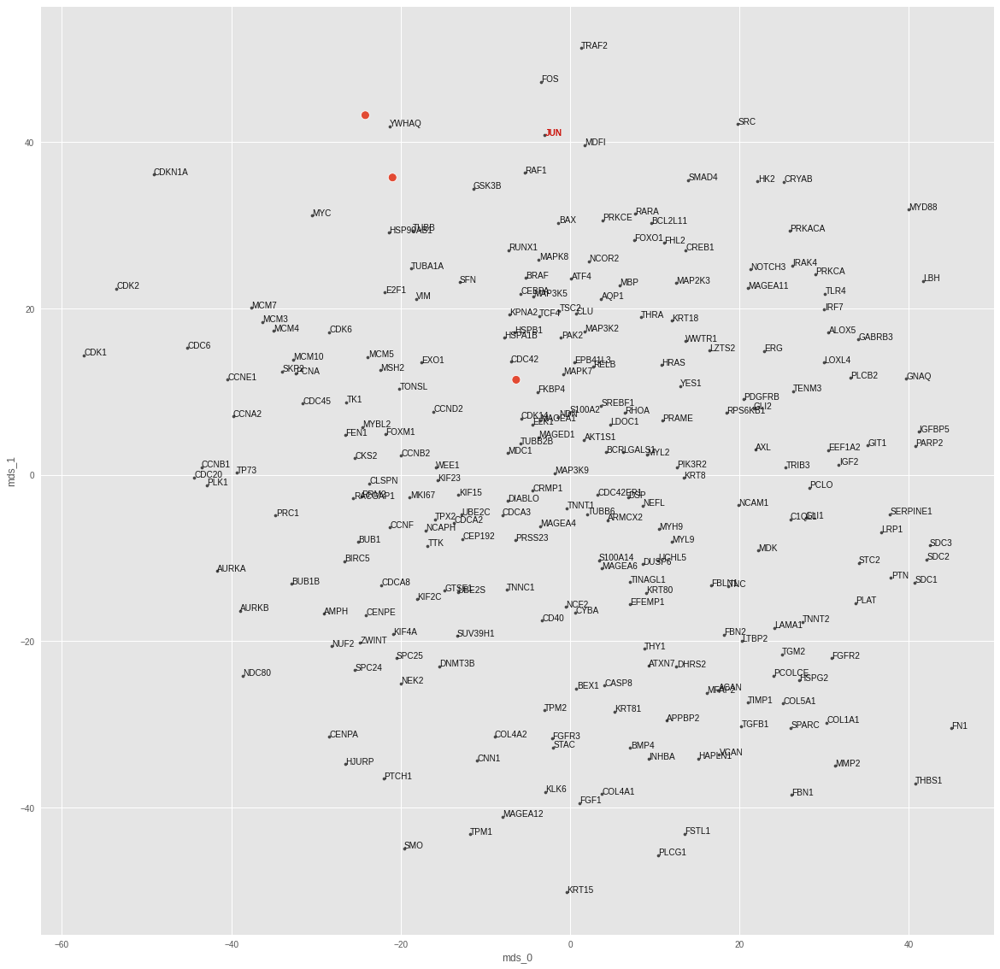

MAP2K3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.2078133374452591
train top-k accuracies: {1: 0.657895, 3: 0.77193, 5: 0.815789, 10: 0.842105, 20: 0.877193, 50: 0.95614}
train mean top-k accuracies: {1: 0.710526, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.973684, 50: 1.0}
test loss: 0.9209995269775391
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


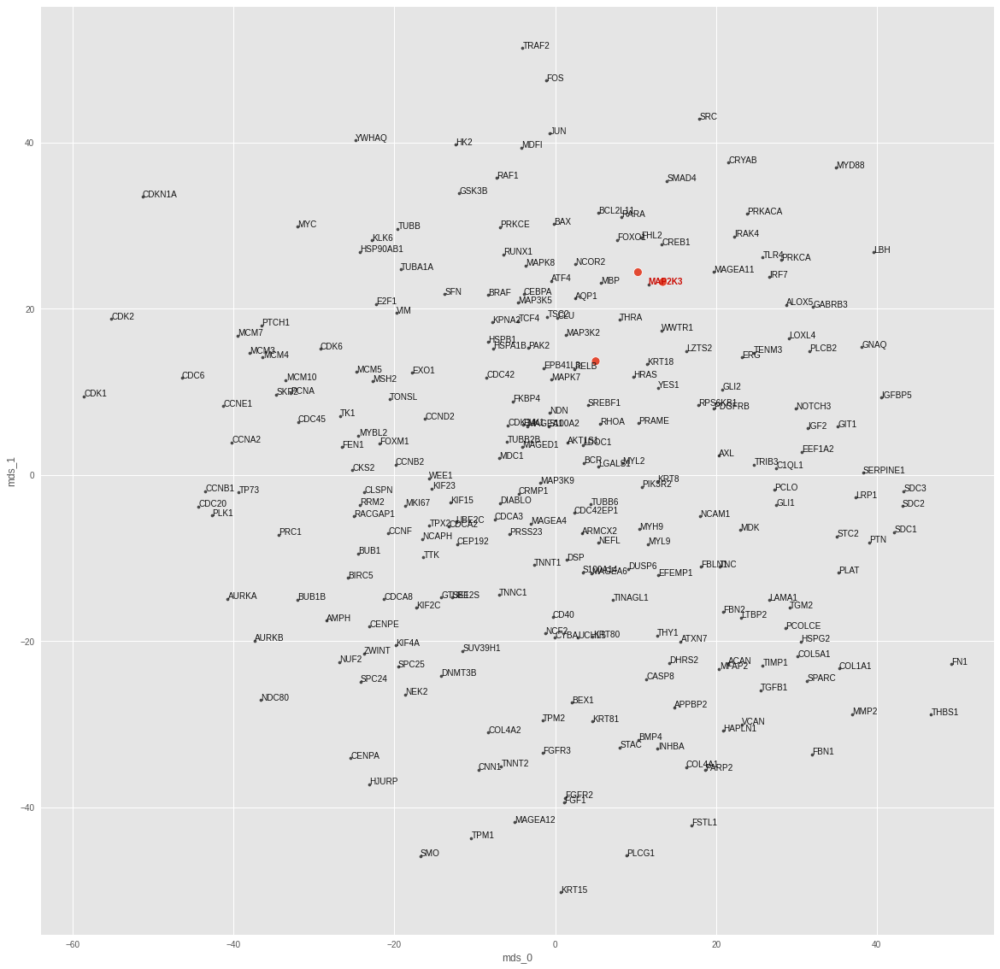

MAP3K2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.2100675404071808
train top-k accuracies: {1: 0.631579, 3: 0.77193, 5: 0.833333, 10: 0.842105, 20: 0.868421, 50: 0.95614}
train mean top-k accuracies: {1: 0.710526, 3: 0.894737, 5: 0.921053, 10: 0.921053, 20: 1.0, 50: 1.0}
test loss: 0.8339512348175049
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.666667, 20: 0.666667, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


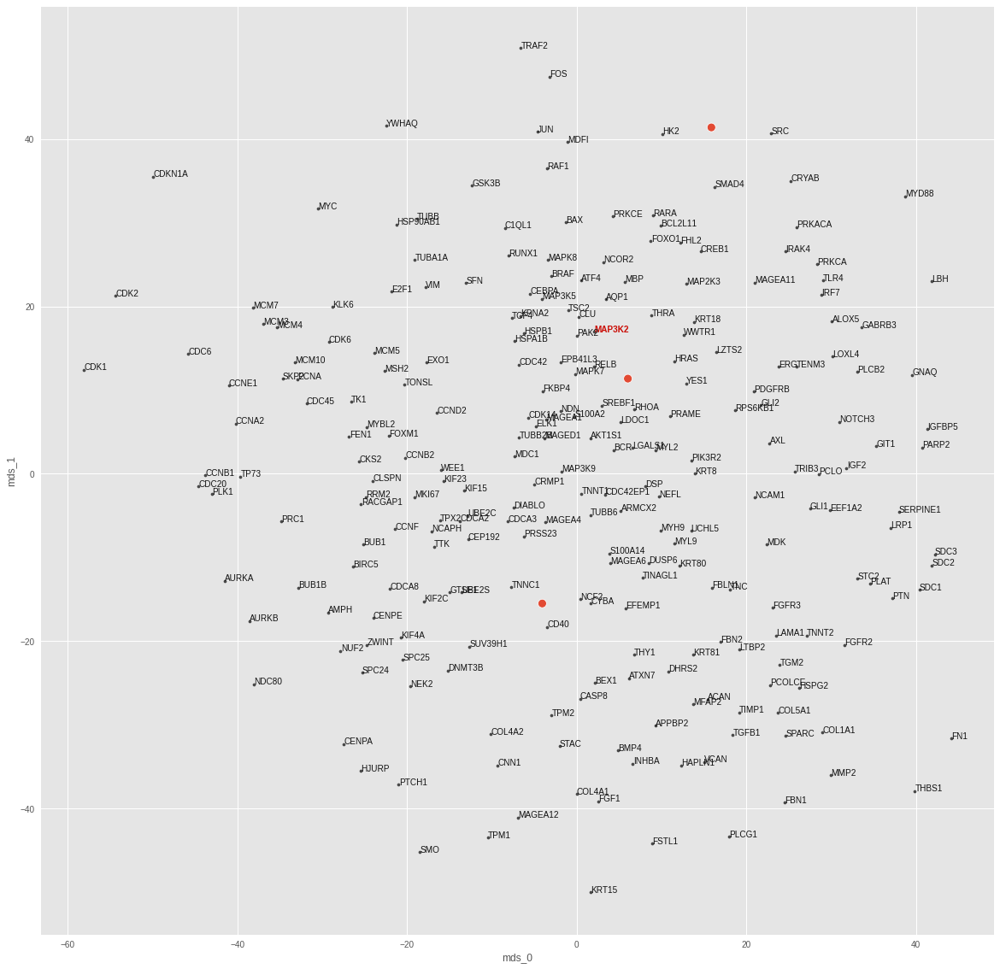

MAP3K5
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.21070647239685059
train top-k accuracies: {1: 0.640351, 3: 0.763158, 5: 0.807018, 10: 0.842105, 20: 0.868421, 50: 0.95614}
train mean top-k accuracies: {1: 0.710526, 3: 0.894737, 5: 0.921053, 10: 0.921053, 20: 0.973684, 50: 1.0}
test loss: 0.2946411967277527
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 0.333333, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


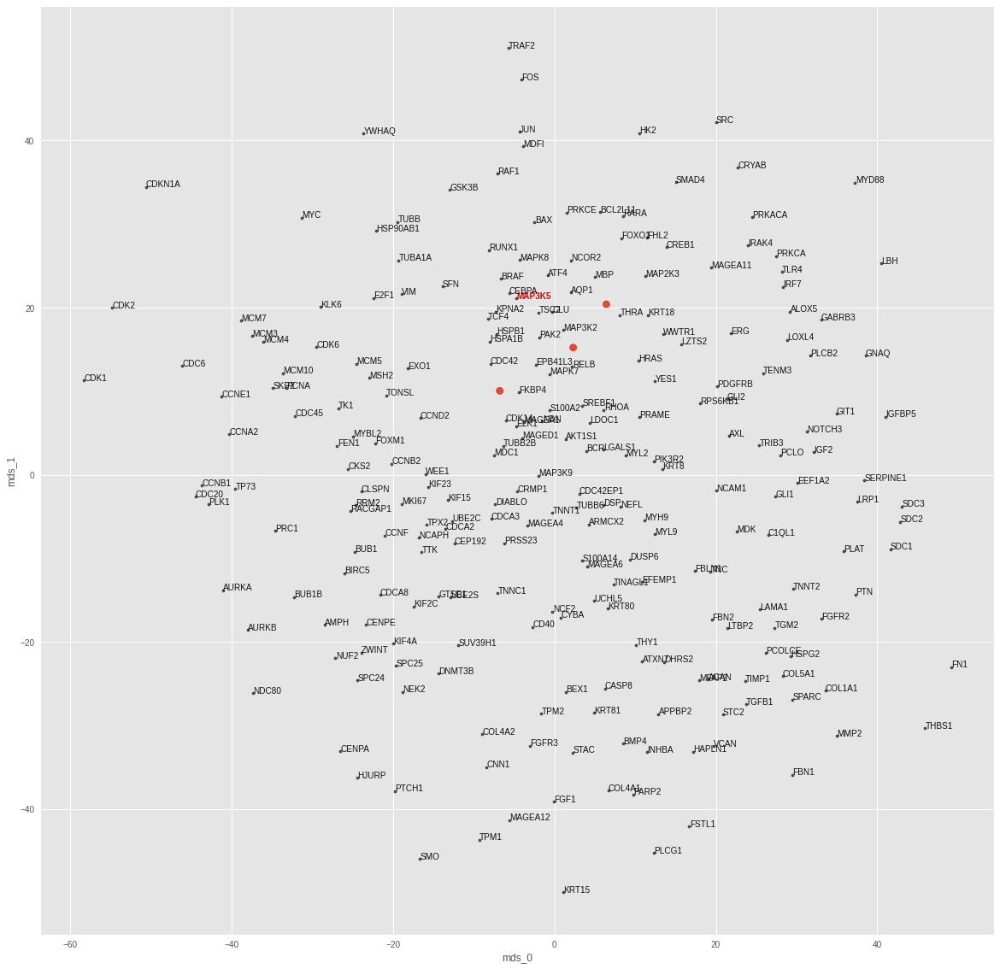

MAP3K9
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.21207739412784576
train top-k accuracies: {1: 0.631579, 3: 0.77193, 5: 0.833333, 10: 0.842105, 20: 0.868421, 50: 0.95614}
train mean top-k accuracies: {1: 0.710526, 3: 0.894737, 5: 0.921053, 10: 0.921053, 20: 0.973684, 50: 1.0}
test loss: 1.043898105621338
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


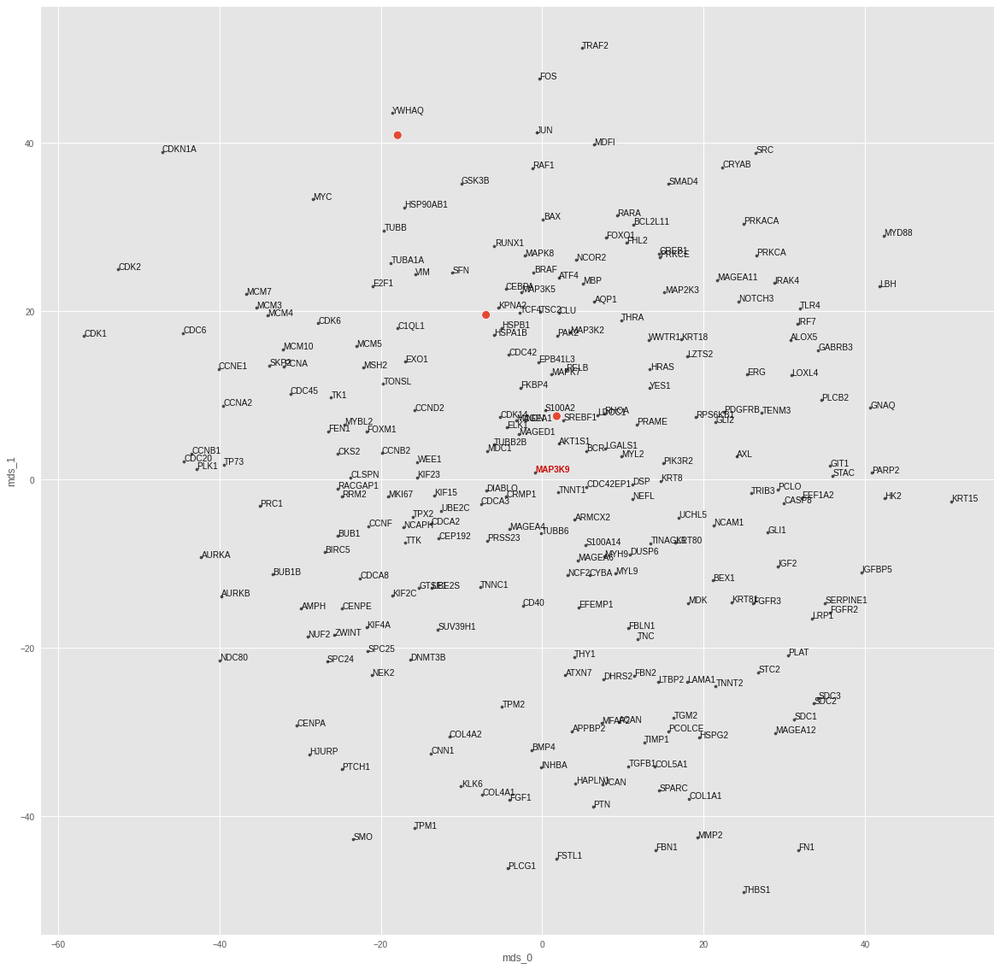

MAPK7
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.2123889923095703
train top-k accuracies: {1: 0.640351, 3: 0.754386, 5: 0.815789, 10: 0.842105, 20: 0.868421, 50: 0.95614}
train mean top-k accuracies: {1: 0.710526, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.973684, 50: 1.0}
test loss: 0.5122907161712646
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.333333, 10: 0.333333, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


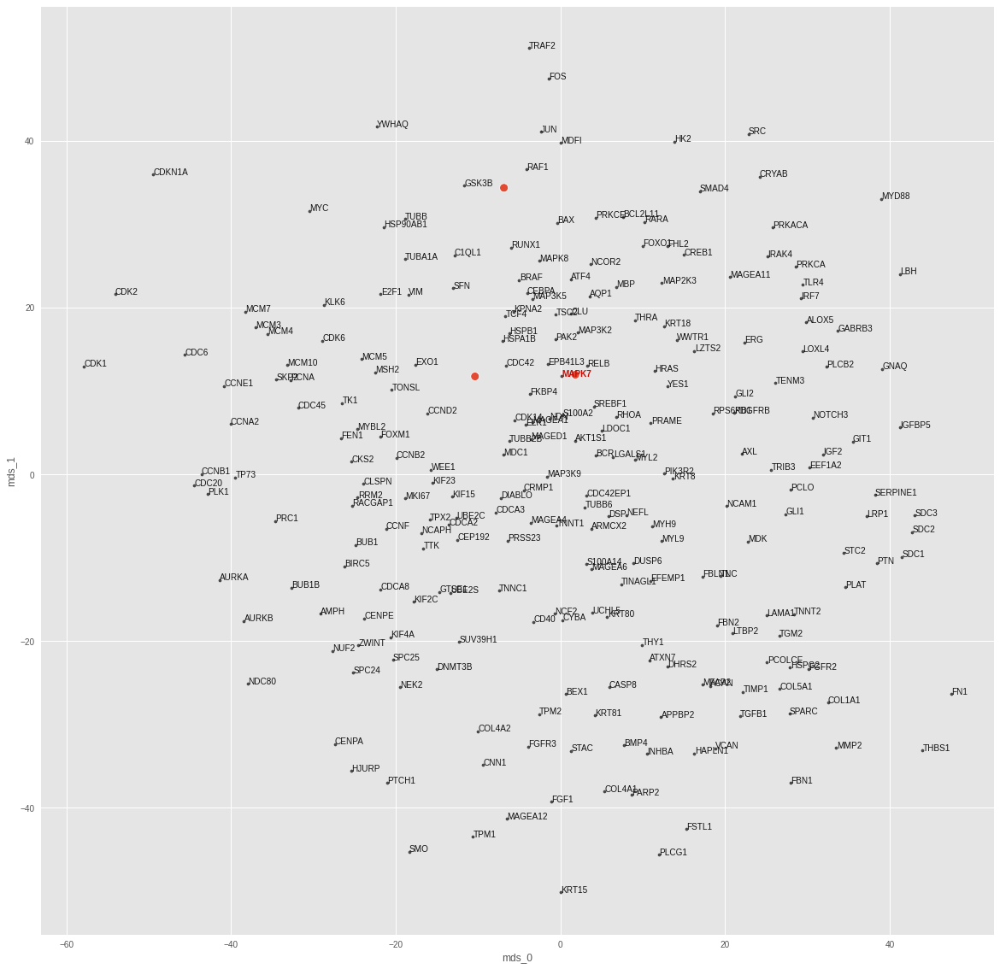

MYD88
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.18568533658981323
train top-k accuracies: {1: 0.657895, 3: 0.798246, 5: 0.850877, 10: 0.859649, 20: 0.903509, 50: 0.973684}
train mean top-k accuracies: {1: 0.789474, 3: 0.921053, 5: 0.921053, 10: 0.973684, 20: 0.973684, 50: 1.0}
test loss: 2.8492541313171387
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


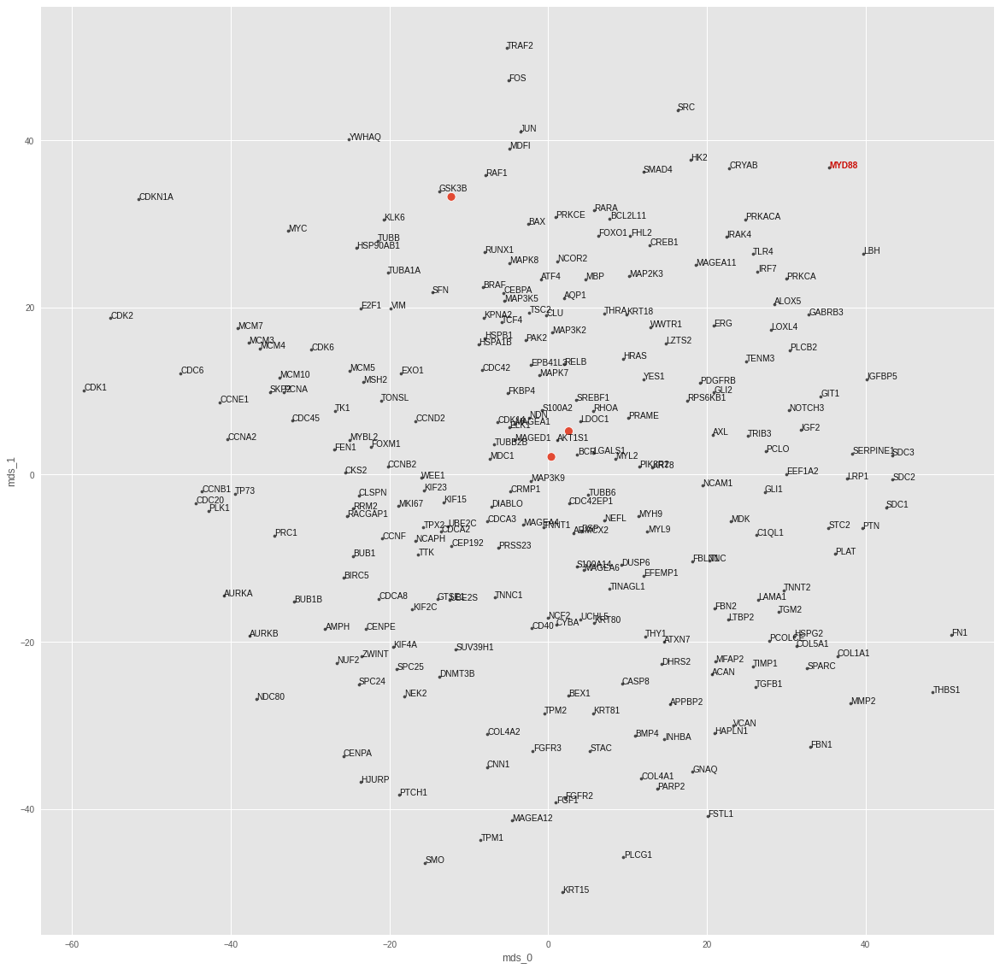

PIK3R2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20681625604629517
train top-k accuracies: {1: 0.649123, 3: 0.77193, 5: 0.833333, 10: 0.842105, 20: 0.885965, 50: 0.95614}
train mean top-k accuracies: {1: 0.710526, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.973684, 50: 1.0}
test loss: 0.7440613508224487
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.666667, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


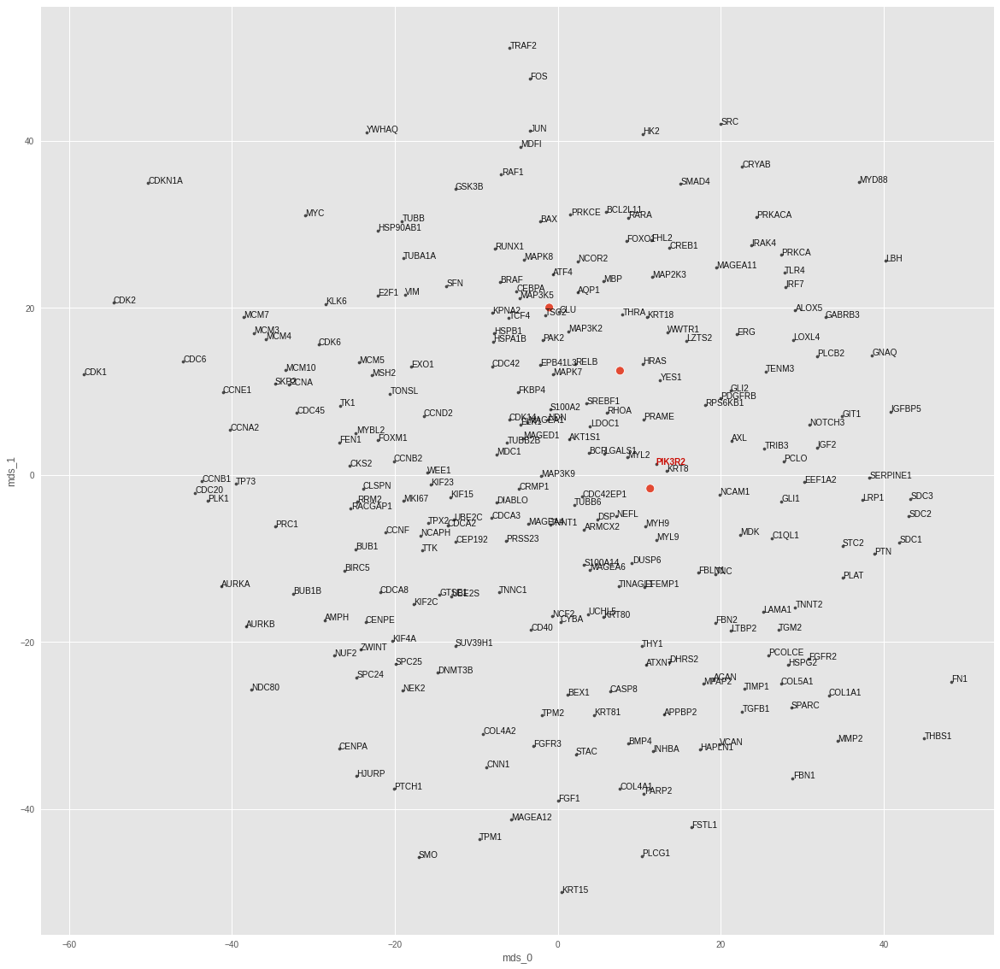

PRKACA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20079024136066437
train top-k accuracies: {1: 0.675439, 3: 0.780702, 5: 0.833333, 10: 0.850877, 20: 0.868421, 50: 0.95614}
train mean top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.921053, 10: 0.921053, 20: 1.0, 50: 1.0}
test loss: 2.0609774589538574
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


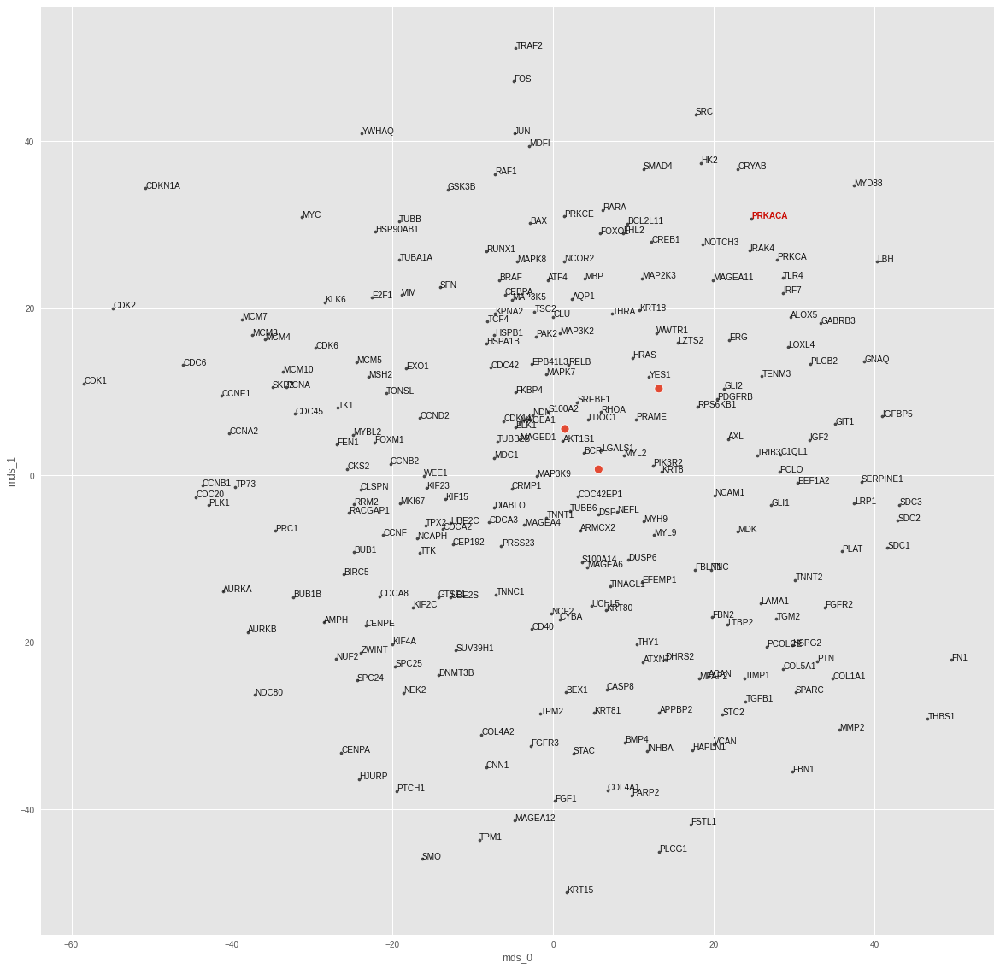

PRKCE
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.19812041521072388
train top-k accuracies: {1: 0.649123, 3: 0.77193, 5: 0.842105, 10: 0.859649, 20: 0.885965, 50: 0.973684}
train mean top-k accuracies: {1: 0.763158, 3: 0.921053, 5: 0.947368, 10: 0.947368, 20: 1.0, 50: 1.0}
test loss: 1.1703044176101685
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


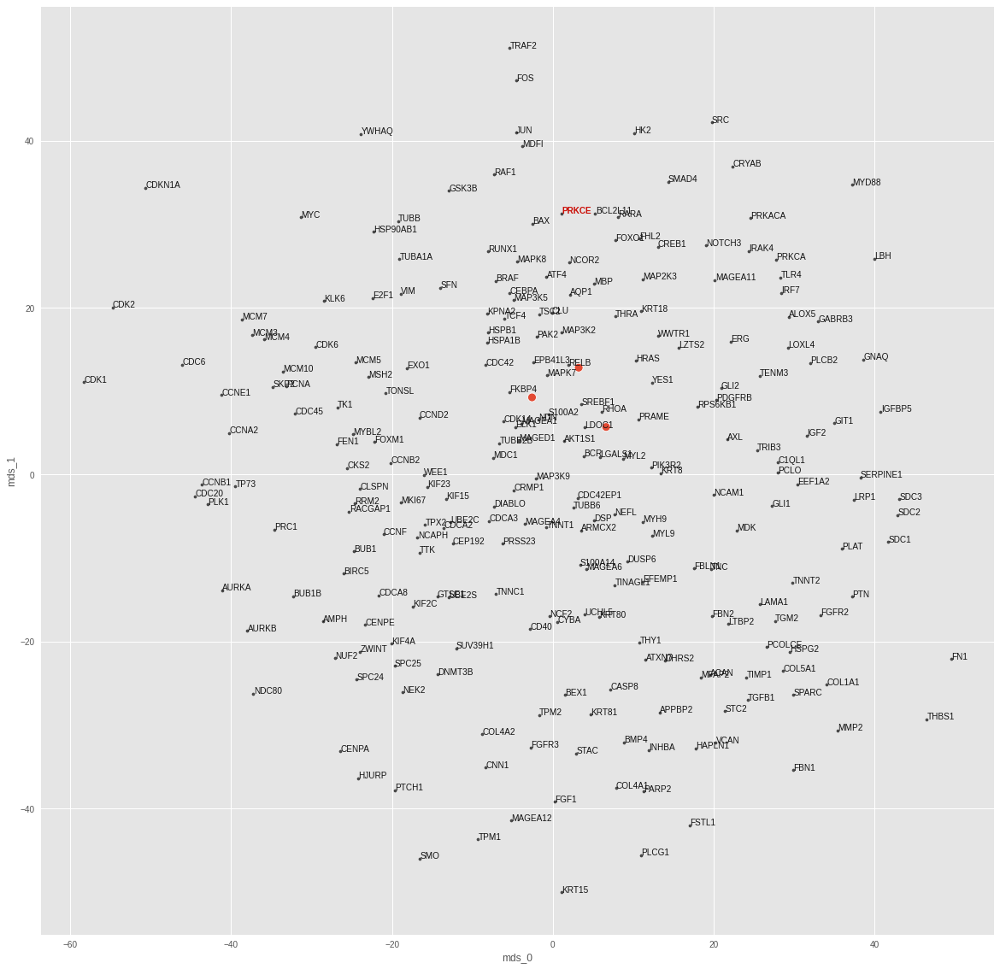

RAF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20370681583881378
train top-k accuracies: {1: 0.684211, 3: 0.780702, 5: 0.824561, 10: 0.850877, 20: 0.885965, 50: 0.964912}
train mean top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.921053, 10: 0.973684, 20: 0.973684, 50: 1.0}
test loss: 0.8116596937179565
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


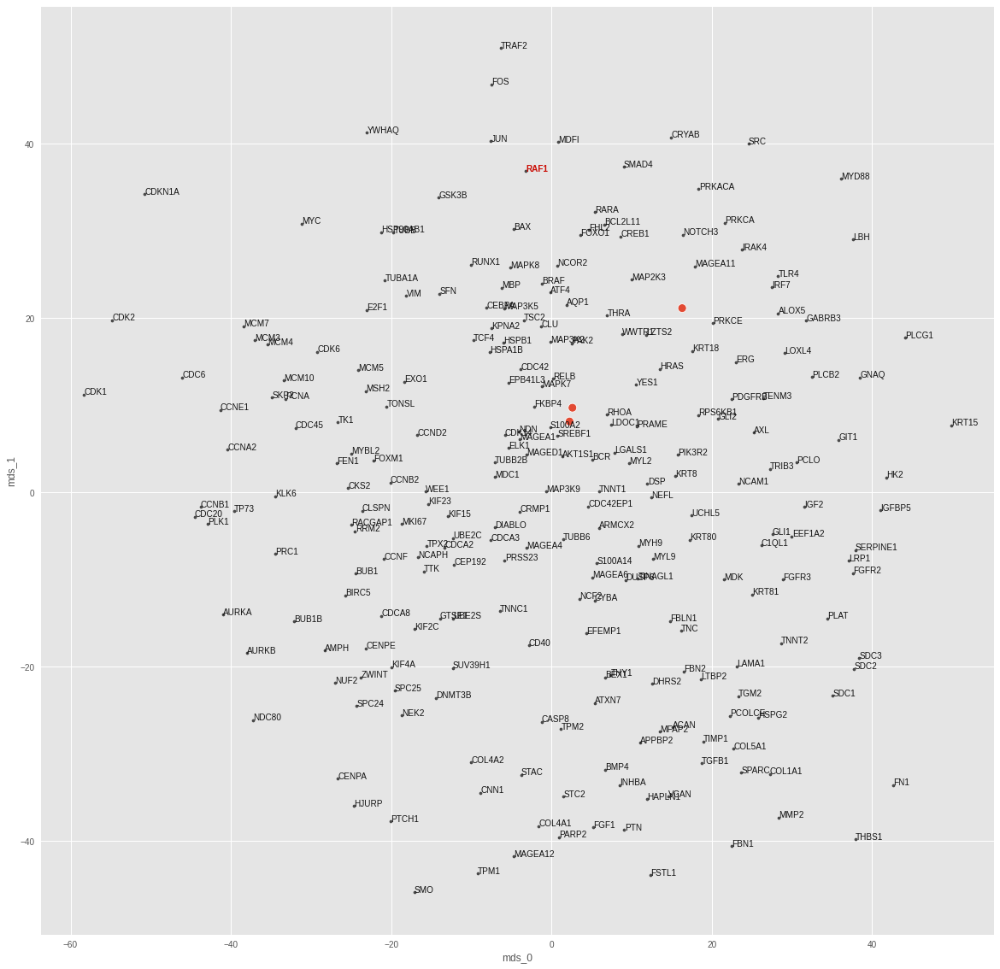

RELB
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20660899579524994
train top-k accuracies: {1: 0.657895, 3: 0.780702, 5: 0.824561, 10: 0.850877, 20: 0.868421, 50: 0.964912}
train mean top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 1.0, 50: 1.0}
test loss: 1.5590366125106812
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


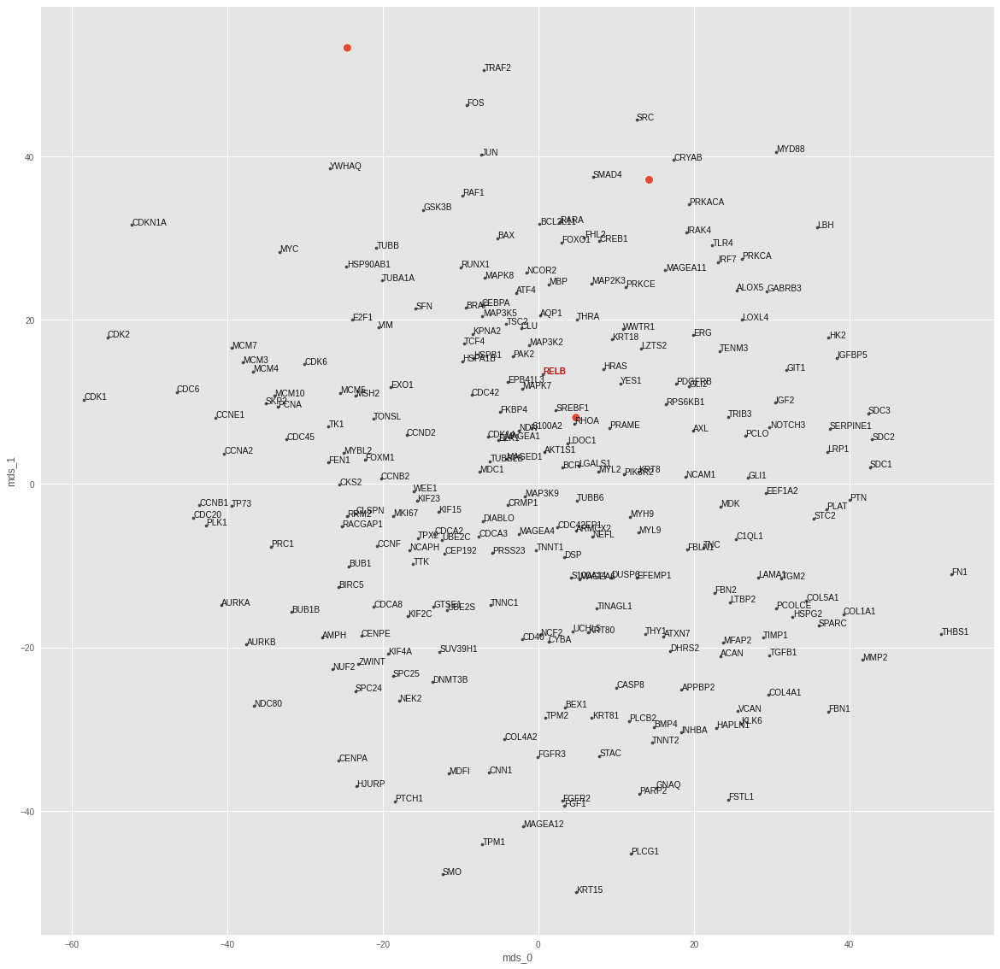

RHOA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20664045214653015
train top-k accuracies: {1: 0.666667, 3: 0.780702, 5: 0.833333, 10: 0.842105, 20: 0.868421, 50: 0.95614}
train mean top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.921053, 10: 0.921053, 20: 0.973684, 50: 1.0}
test loss: 0.5081819295883179
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.666667, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


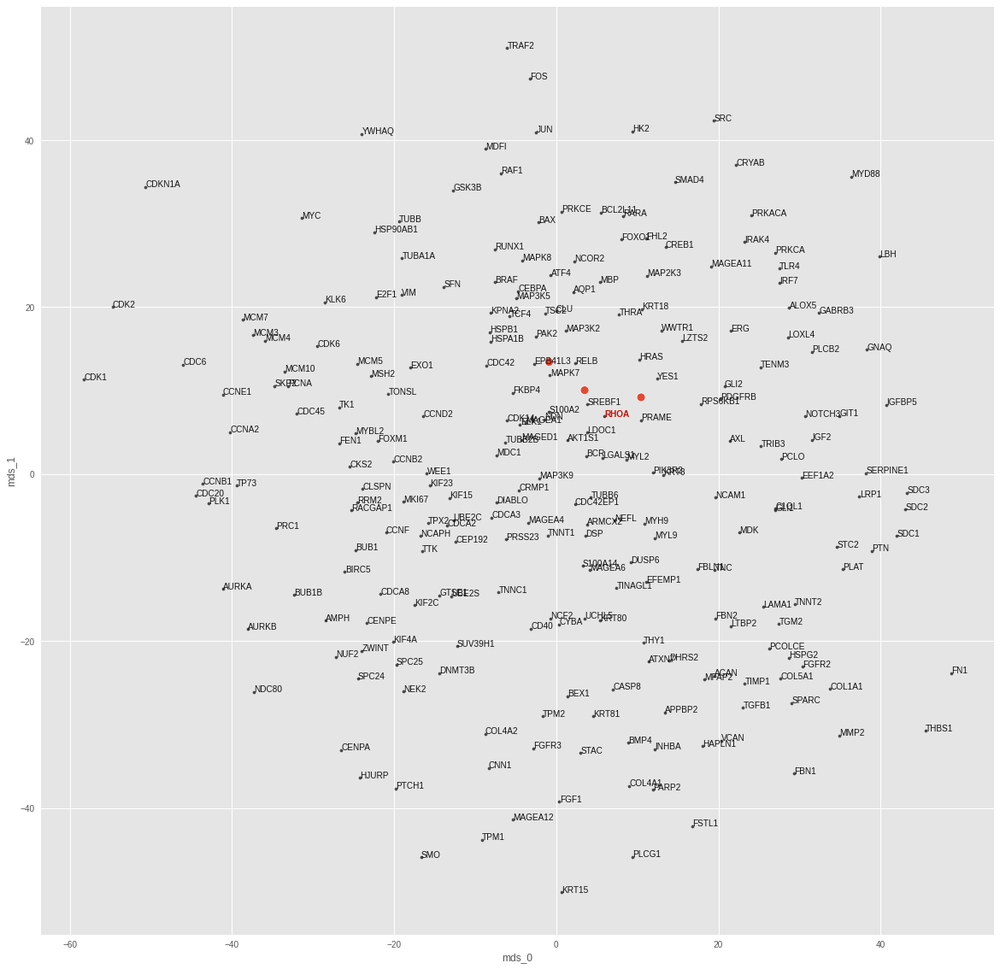

SMAD4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20141799747943878
train top-k accuracies: {1: 0.684211, 3: 0.77193, 5: 0.824561, 10: 0.833333, 20: 0.868421, 50: 0.964912}
train mean top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.973684, 50: 1.0}
test loss: 1.2378491163253784
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


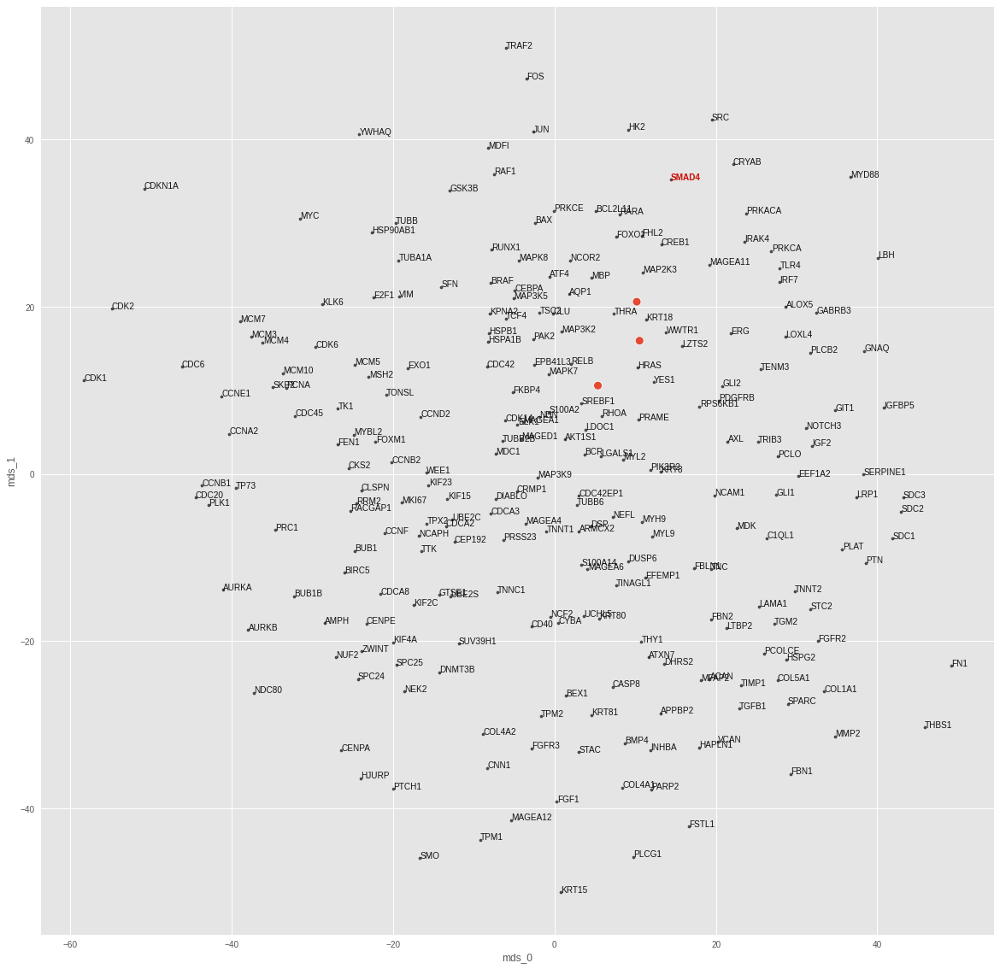

SMO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.18931064009666443
train top-k accuracies: {1: 0.675439, 3: 0.798246, 5: 0.850877, 10: 0.859649, 20: 0.885965, 50: 0.973684}
train mean top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.973684, 50: 1.0}
test loss: 2.372863292694092
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


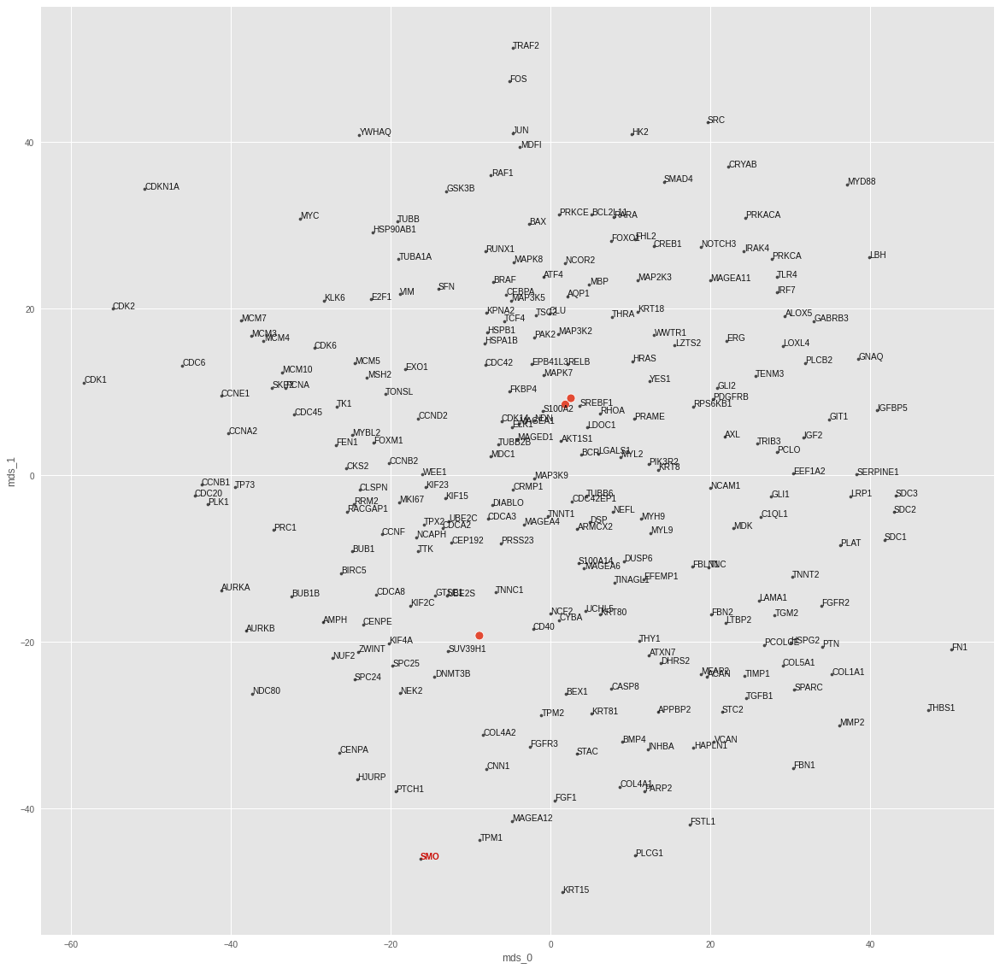

SRC
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.2002326250076294
train top-k accuracies: {1: 0.666667, 3: 0.77193, 5: 0.833333, 10: 0.850877, 20: 0.877193, 50: 0.964912}
train mean top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.973684, 50: 1.0}
test loss: 1.3209437131881714
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


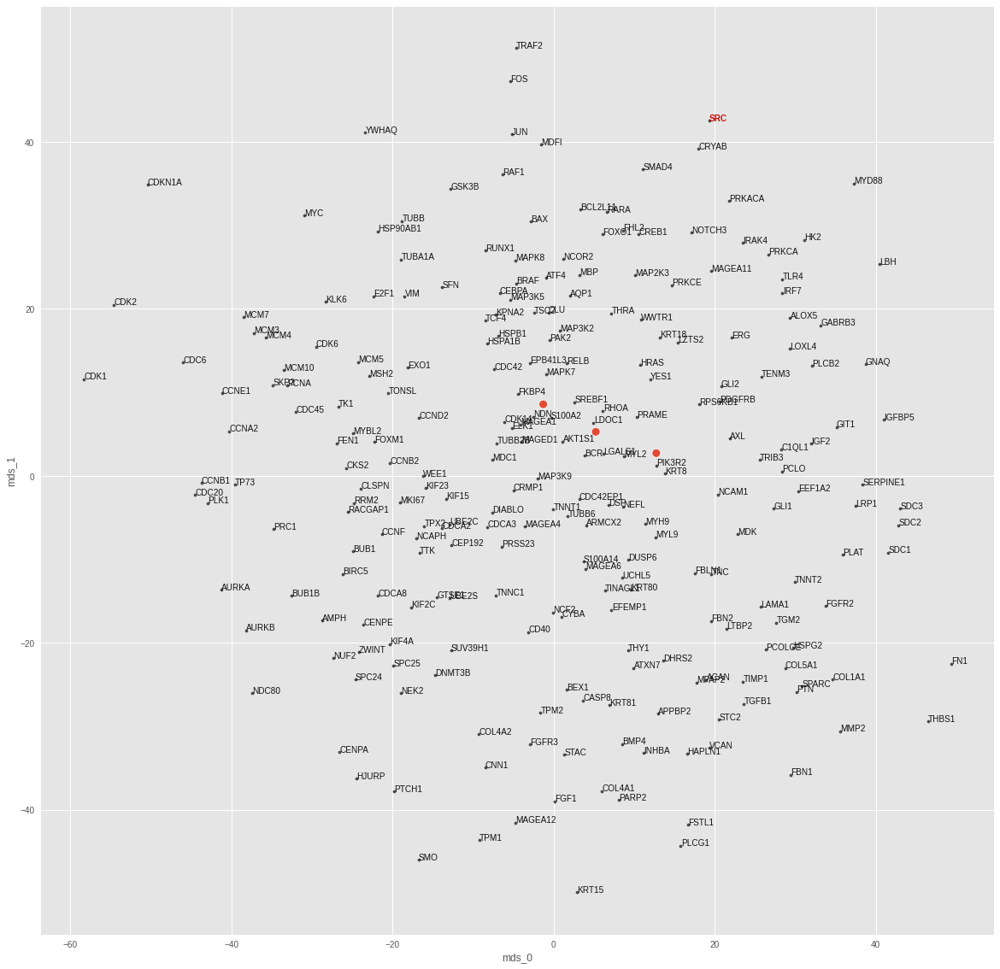

SREBF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20965535938739777
train top-k accuracies: {1: 0.631579, 3: 0.763158, 5: 0.824561, 10: 0.842105, 20: 0.859649, 50: 0.973684}
train mean top-k accuracies: {1: 0.710526, 3: 0.894737, 5: 0.921053, 10: 0.921053, 20: 0.973684, 50: 1.0}
test loss: 0.5424708127975464
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 0.333333, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


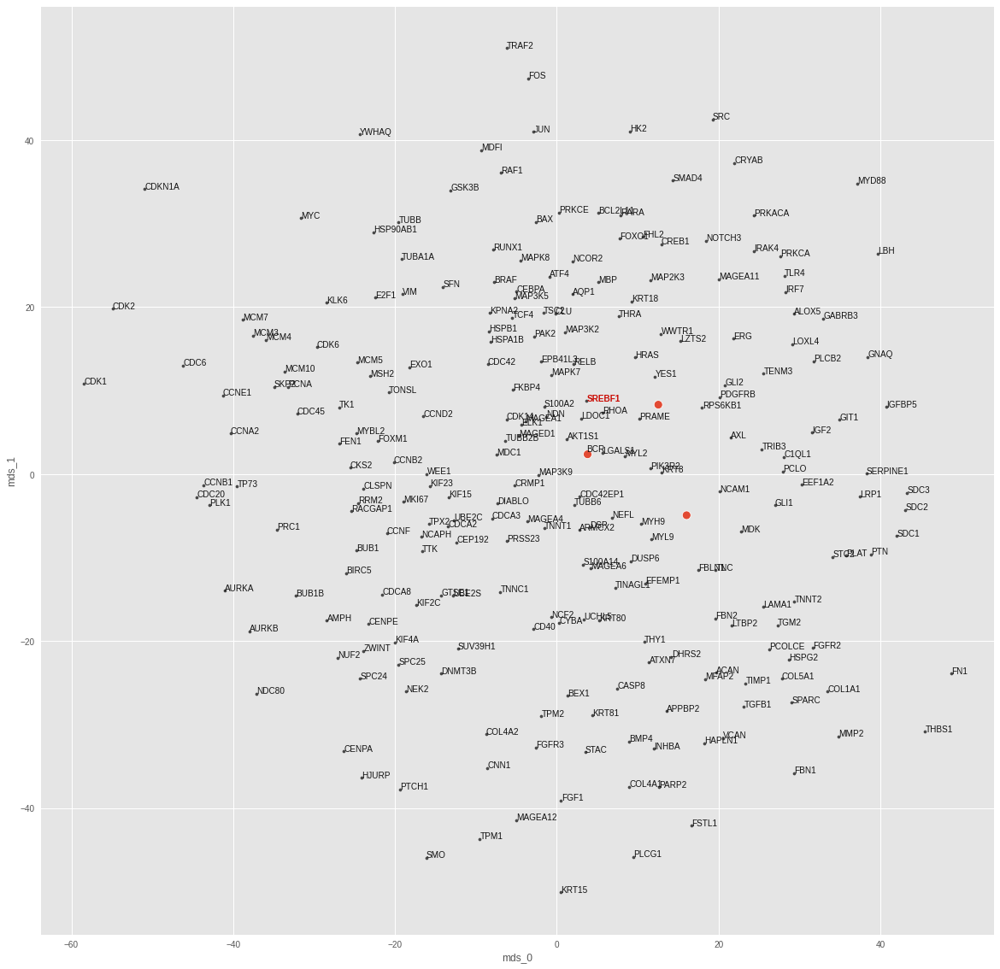

TRAF2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.1886018067598343
train top-k accuracies: {1: 0.657895, 3: 0.798246, 5: 0.850877, 10: 0.859649, 20: 0.903509, 50: 0.973684}
train mean top-k accuracies: {1: 0.736842, 3: 0.921053, 5: 0.947368, 10: 0.973684, 20: 0.973684, 50: 1.0}
test loss: 2.9652984142303467
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


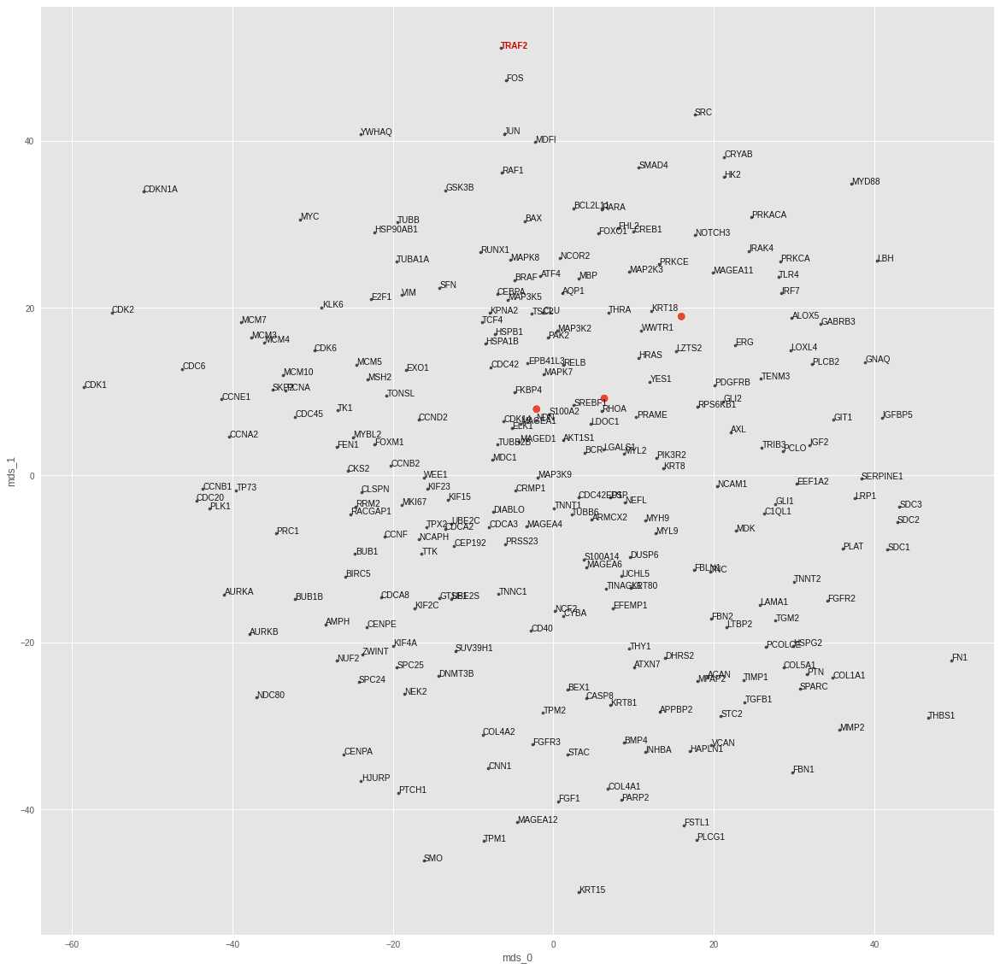

TSC2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.20708592236042023
train top-k accuracies: {1: 0.640351, 3: 0.763158, 5: 0.833333, 10: 0.842105, 20: 0.877193, 50: 0.95614}
train mean top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 0.973684, 50: 1.0}
test loss: 1.5016530752182007
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.333333, 20: 0.666667, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


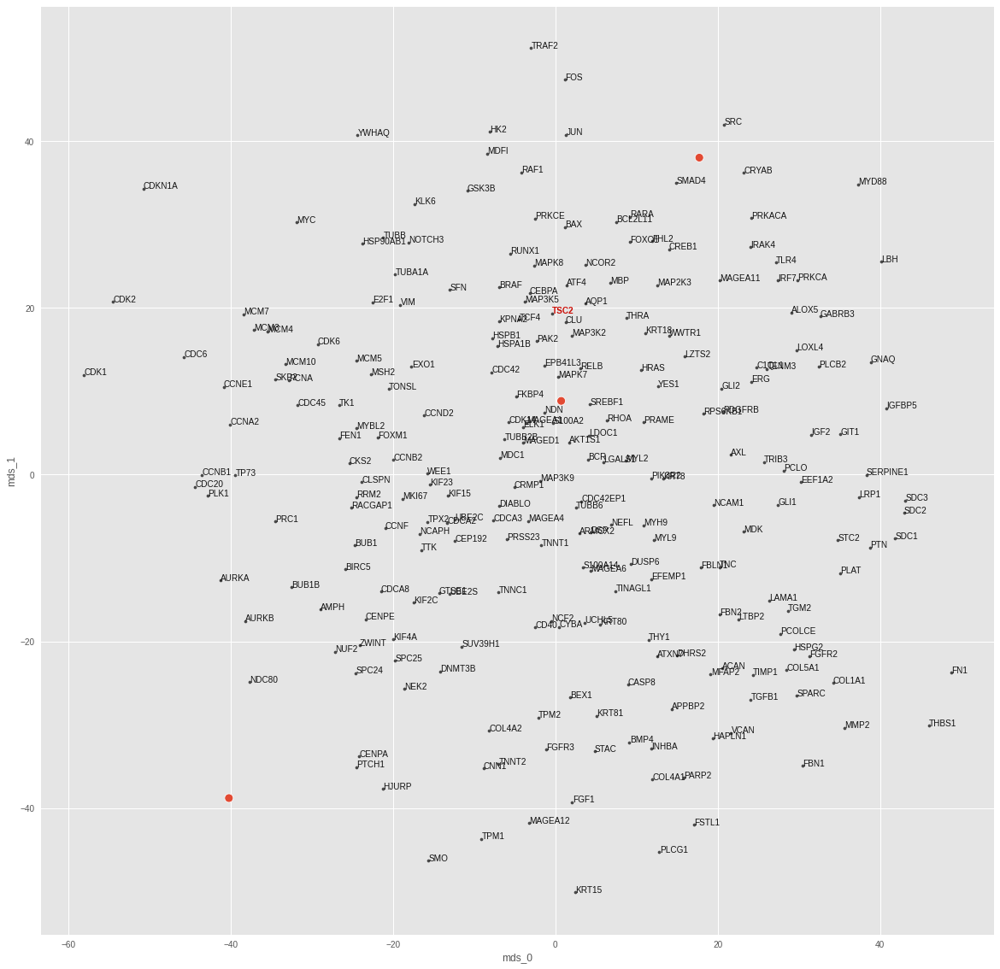

WWTR1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.2039809674024582
train top-k accuracies: {1: 0.657895, 3: 0.789474, 5: 0.815789, 10: 0.833333, 20: 0.877193, 50: 0.95614}
train mean top-k accuracies: {1: 0.736842, 3: 0.894737, 5: 0.921053, 10: 0.973684, 20: 0.973684, 50: 1.0}
test loss: 1.604265570640564
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


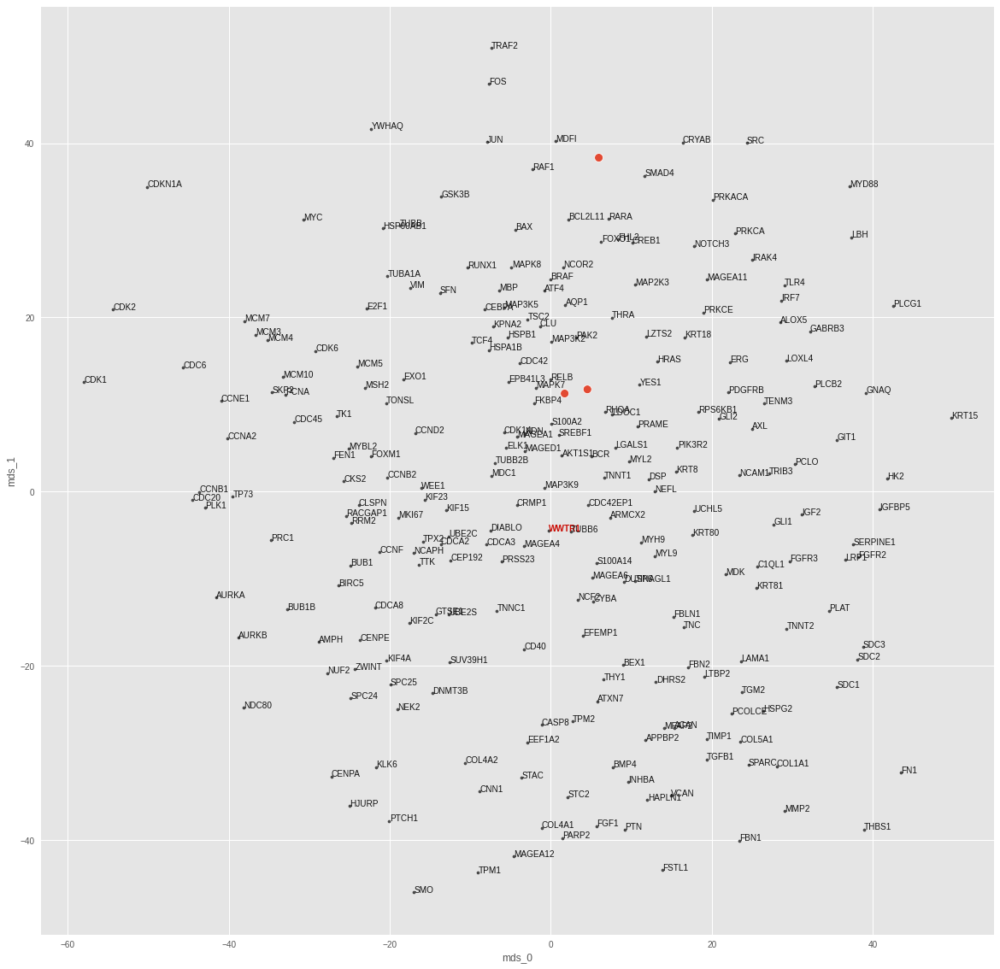

<IPython.core.display.Javascript object>

In [35]:
target_topk_accs = {}
cl_lin_nns_dict = {}
for i in tqdm(range(len(cl_data_dicts))):
    data_dict = cl_data_dicts[i]
    model = torch.nn.Sequential(torch.nn.Linear(1024, 1024))
    optimizer = Adam(model.parameters(), lr=1e-3)
    criterion = torch.nn.MSELoss()
    target = sorted(list(shared_targets))[i]
    print(target)
    fitted_model, _, mean_topk_acc, mean_knns = train_model_topk_acc(
        model=model,
        data_dict=data_dict,
        optimizer=optimizer,
        criterion=criterion,
        n_epochs=1000,
        early_stopping=1000,
        nn_clf=nn_clf,
        log_epochs=False,
    )
    target_topk_accs[target] = mean_topk_acc
    cl_lin_nns_dict[target] = mean_knns[0]
    fig, ax, _ = plot_translation(
        fitted_model.to("cpu"),
        data_dict["test"].dataset,
        node_embs,
        figsize=[20, 20],
        crop=False,
        highlight_target=target,
        pred_size=100,
        reg_size=10,
    )
    ax.get_legend().remove()
    plt.show()
    plt.close()

In [36]:
cl_lin_topk_df = pd.DataFrame(target_topk_accs).transpose()
cl_lin_topk_df.loc[cl_lin_topk_df.loc[:, 50] > 0].sort_values(
    [1, 3, 5, 10, 20, 50], ascending=False
)

,1,3,5,10,20,50
AKT1S1,1.0,1.0,1.0,1.0,1.0,1.0
MAP3K2,0.0,1.0,1.0,1.0,1.0,1.0
MAP3K5,0.0,1.0,1.0,1.0,1.0,1.0
SREBF1,0.0,0.0,1.0,1.0,1.0,1.0
BRAF,0.0,0.0,0.0,1.0,1.0,1.0
CDC42,0.0,0.0,0.0,1.0,1.0,1.0
MAPK7,0.0,0.0,0.0,1.0,1.0,1.0
CEBPA,0.0,0.0,0.0,0.0,1.0,1.0
ELK1,0.0,0.0,0.0,0.0,1.0,1.0
RHOA,0.0,0.0,0.0,0.0,1.0,1.0


<IPython.core.display.Javascript object>

In [37]:
cl_lin_topk_df.describe()

,1,3,5,10,20,50
count,39.000000,39.000000,39.000000,39.000000,39.000000,39.000000
mean,0.025641,0.076923,0.102564,0.179487,0.282051,0.487179
std,0.160128,0.269953,0.307355,0.388776,0.455881,0.506370
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

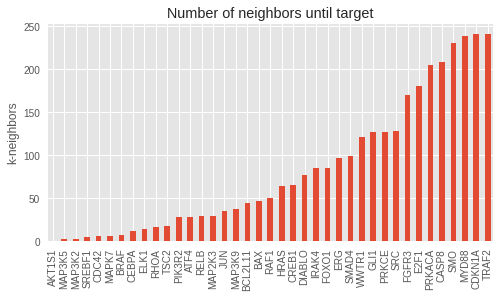

<IPython.core.display.Javascript object>

In [38]:
mpl.style.use("ggplot")
cl_lin_khits = get_knn_hit_data(cl_lin_nns_dict)
ax = cl_lin_khits.knn_hit.sort_values().plot(kind="bar", figsize=[8, 4])
ax.set_ylabel("k-neighbors")
ax.set_title("Number of neighbors until target")
plt.show()

In [39]:
cl_img_embs, _, cl_labels = cl_img_node_embs_dict["fold0"]
centroid_5nn_dict = get_centroid_knn_dict(cl_img_embs, cl_labels, k=5)
centroid_5nn_dict["ELK1"]

['MAP3K9', 'SMAD4', 'E2F1', 'PRKACA', 'ATF4']

<IPython.core.display.Javascript object>

In [40]:
cl_lin_nns_dict["ELK1"][:5]

array(['MAP3K5', 'MAP3K2', 'TSC2', 'CEBPA', 'HSPA1B'], dtype='<U8')

<IPython.core.display.Javascript object>

---

### 3.6. Non-linear 3-centroids mapping

  0%|          | 0/39 [00:00<?, ?it/s]

AKT1S1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0004298847052268684
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.8836836814880371
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.333333, 10: 0.666667, 20: 0.666667, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


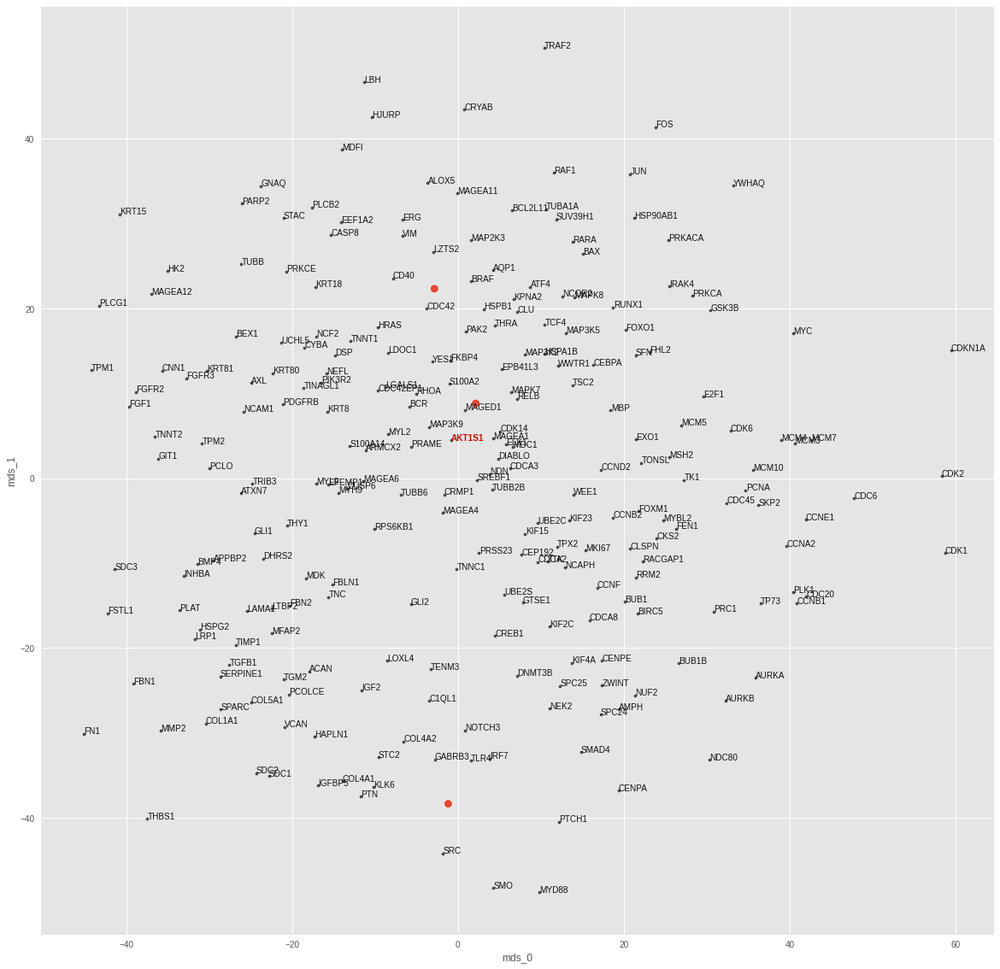

ATF4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0002335473836865276
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.920599639415741
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


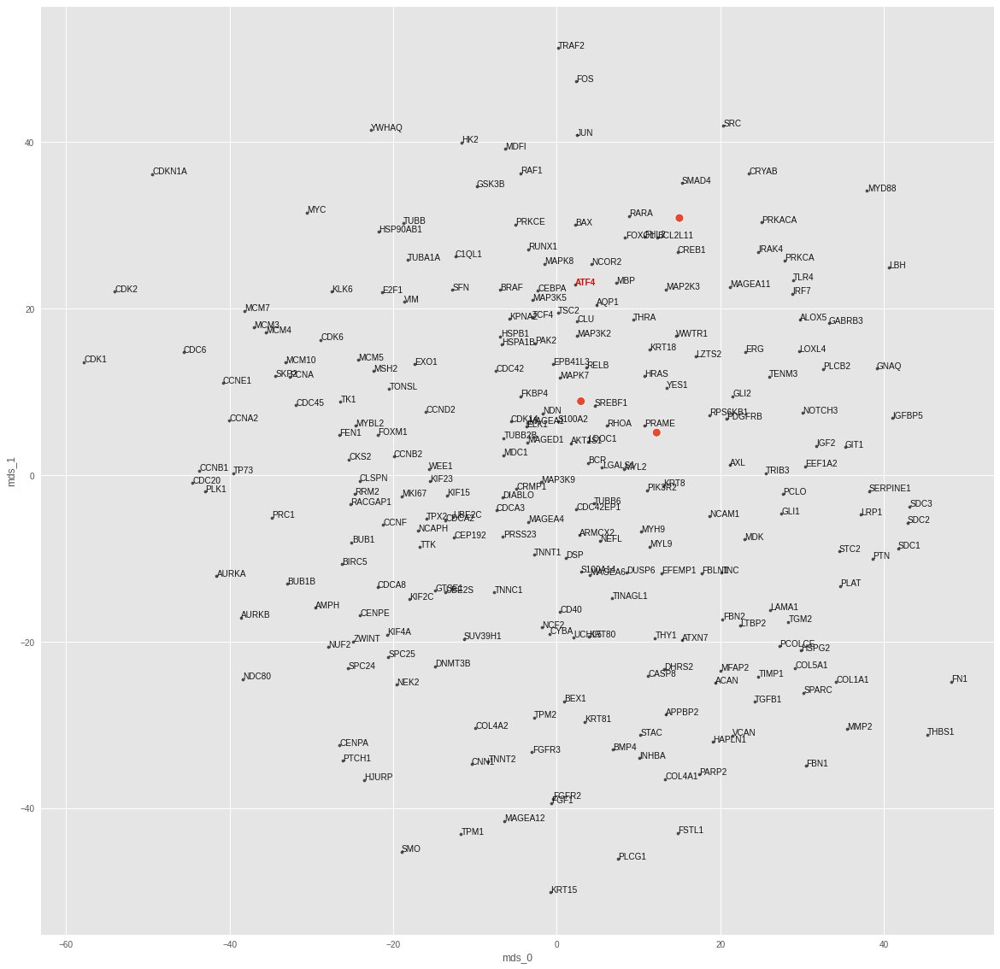

BAX
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00026814817101694643
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.3899362087249756
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


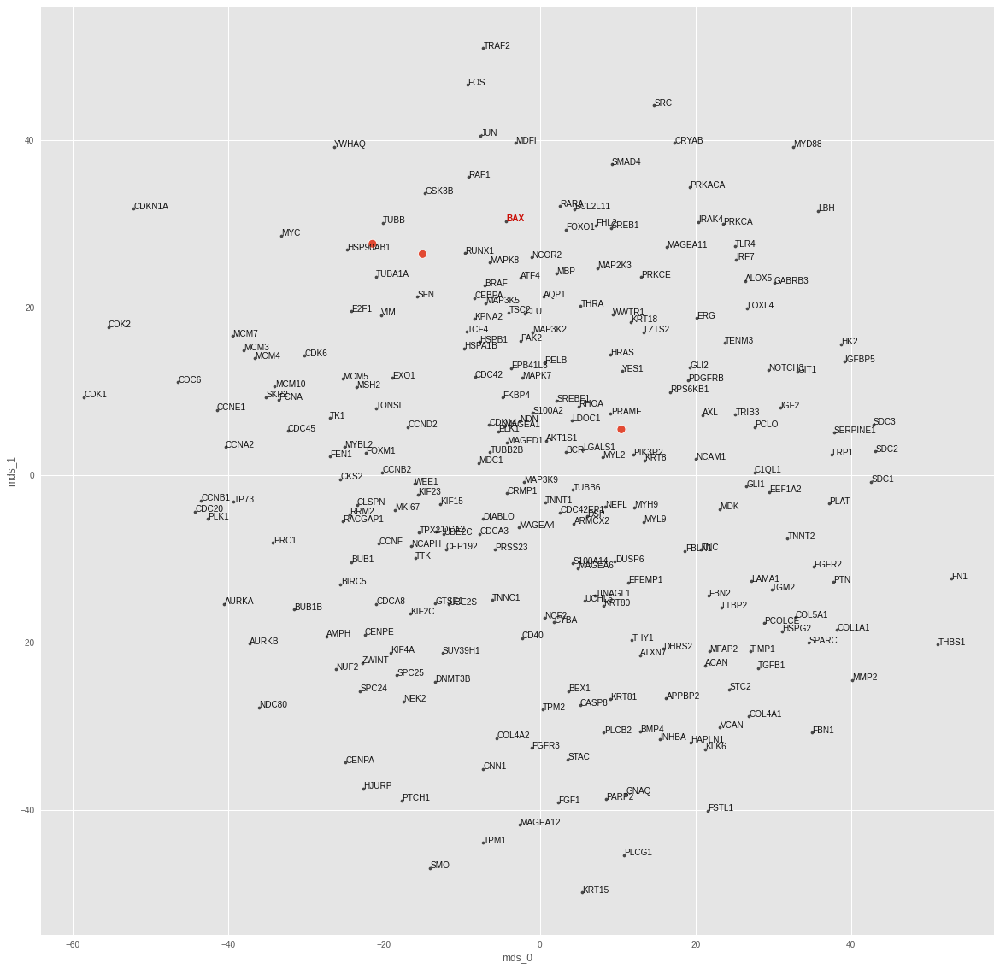

BCL2L11
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0004352876858320087
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 2.265958786010742
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


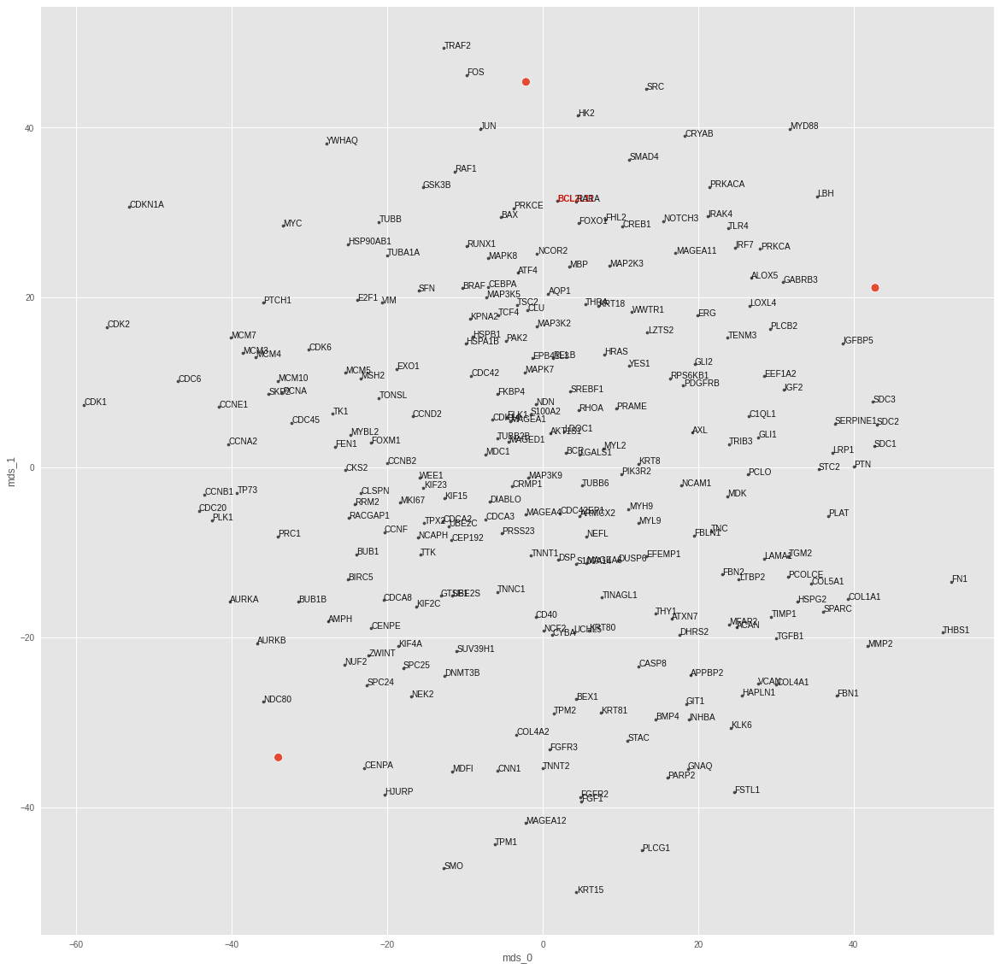

BRAF
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0005884413840249181
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.4798141419887543
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.333333, 10: 0.666667, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


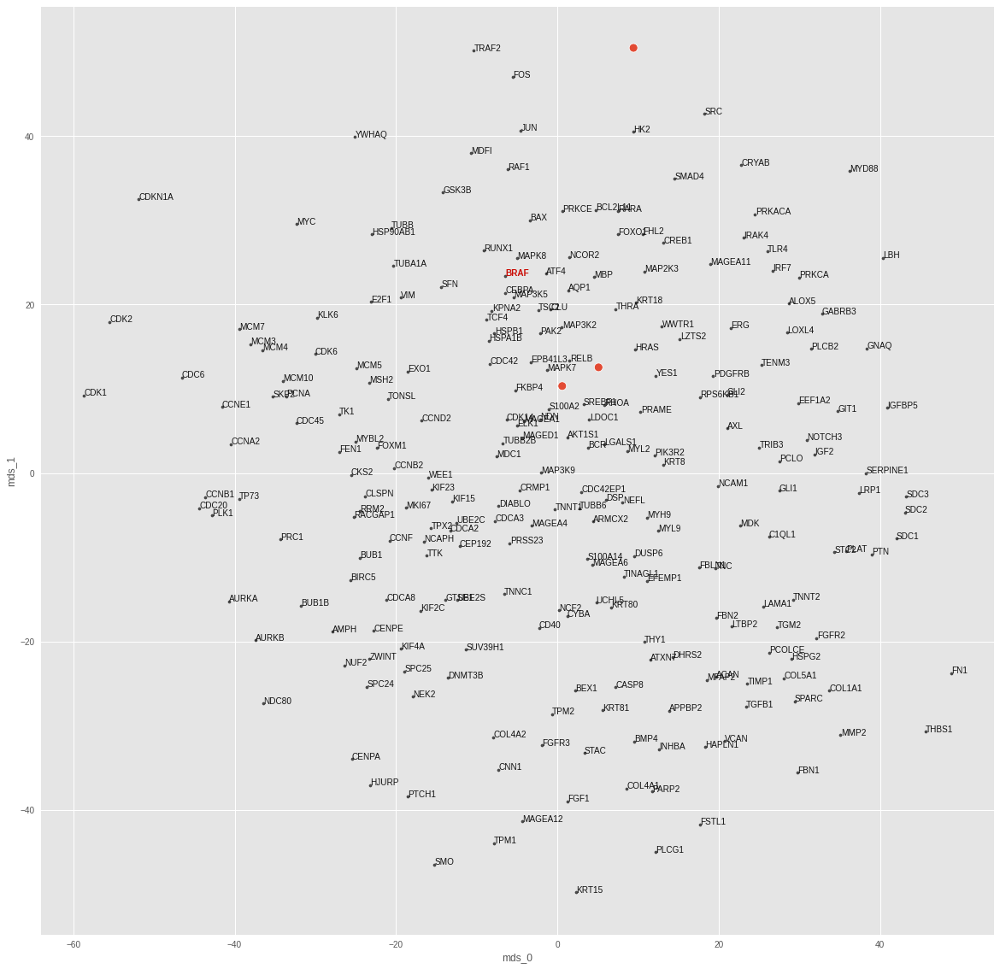

CASP8
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00033743164385668933
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 3.3812289237976074
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


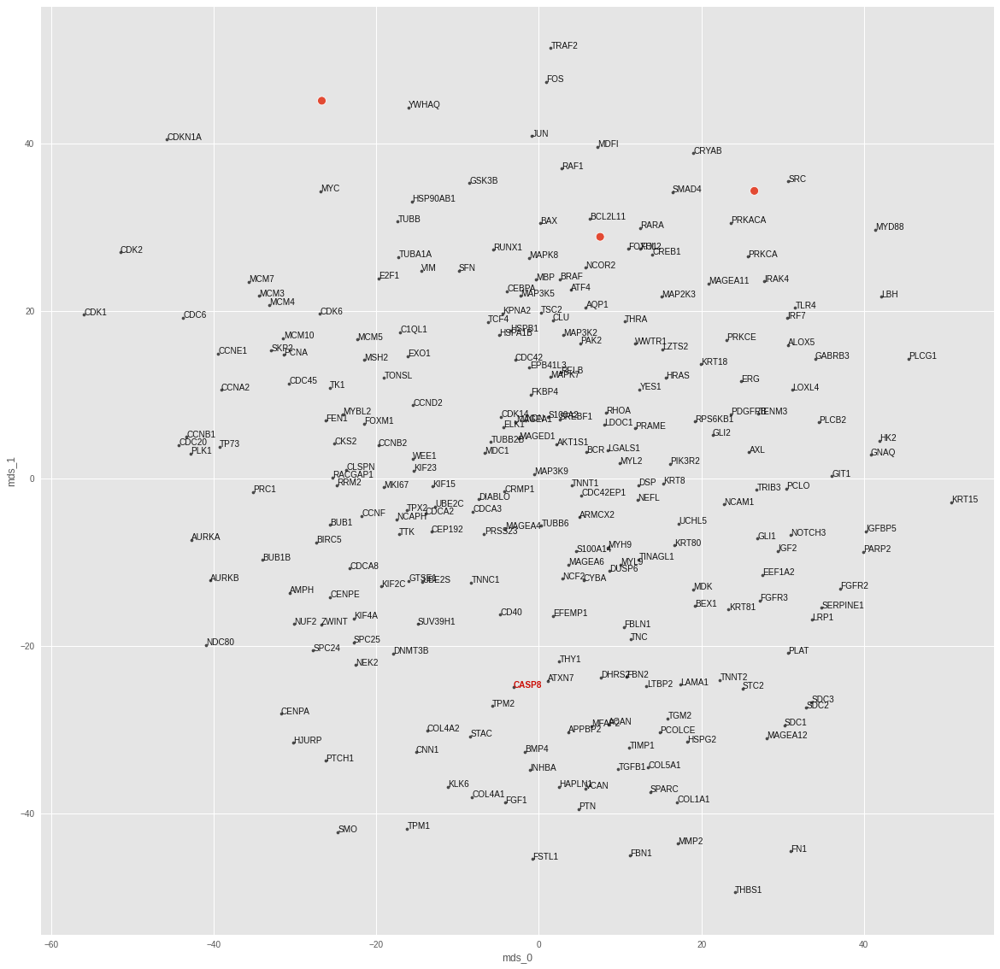

CDC42
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0002772991720121354
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.1394885778427124
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


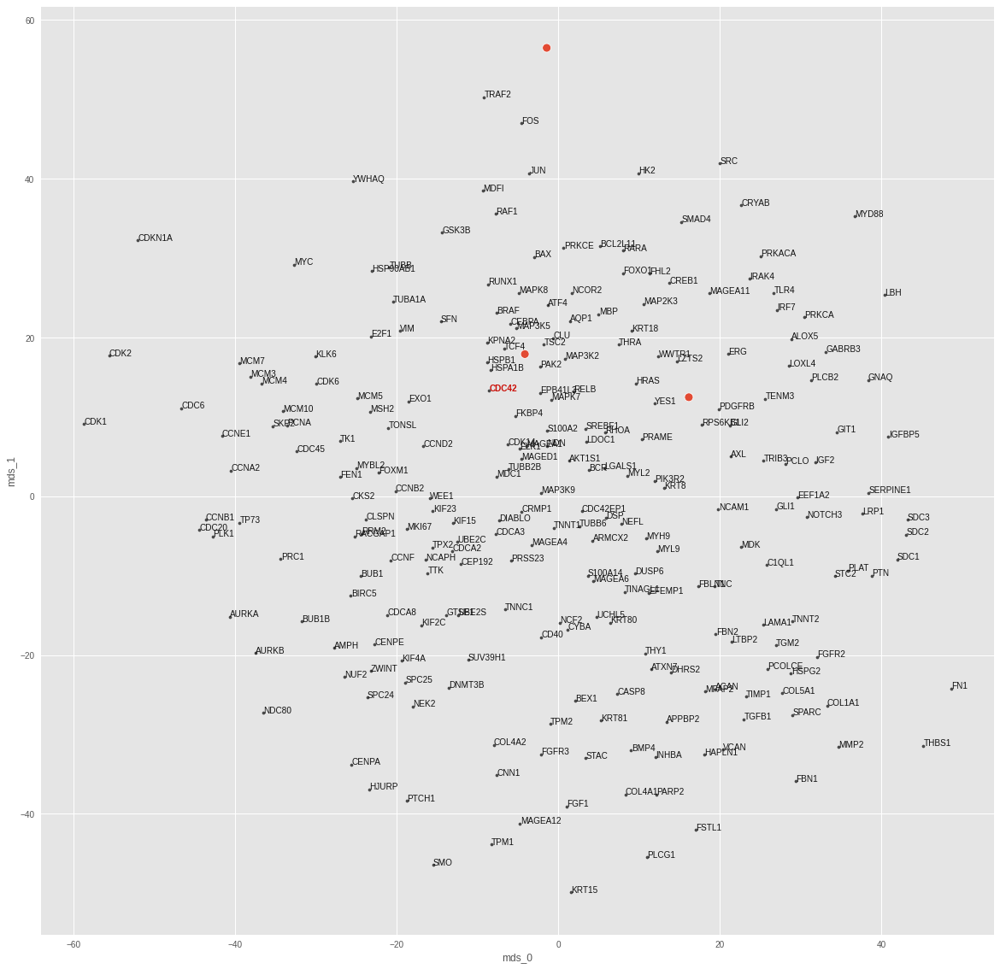

CDKN1A
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00026865184190683067
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 3.74568510055542
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


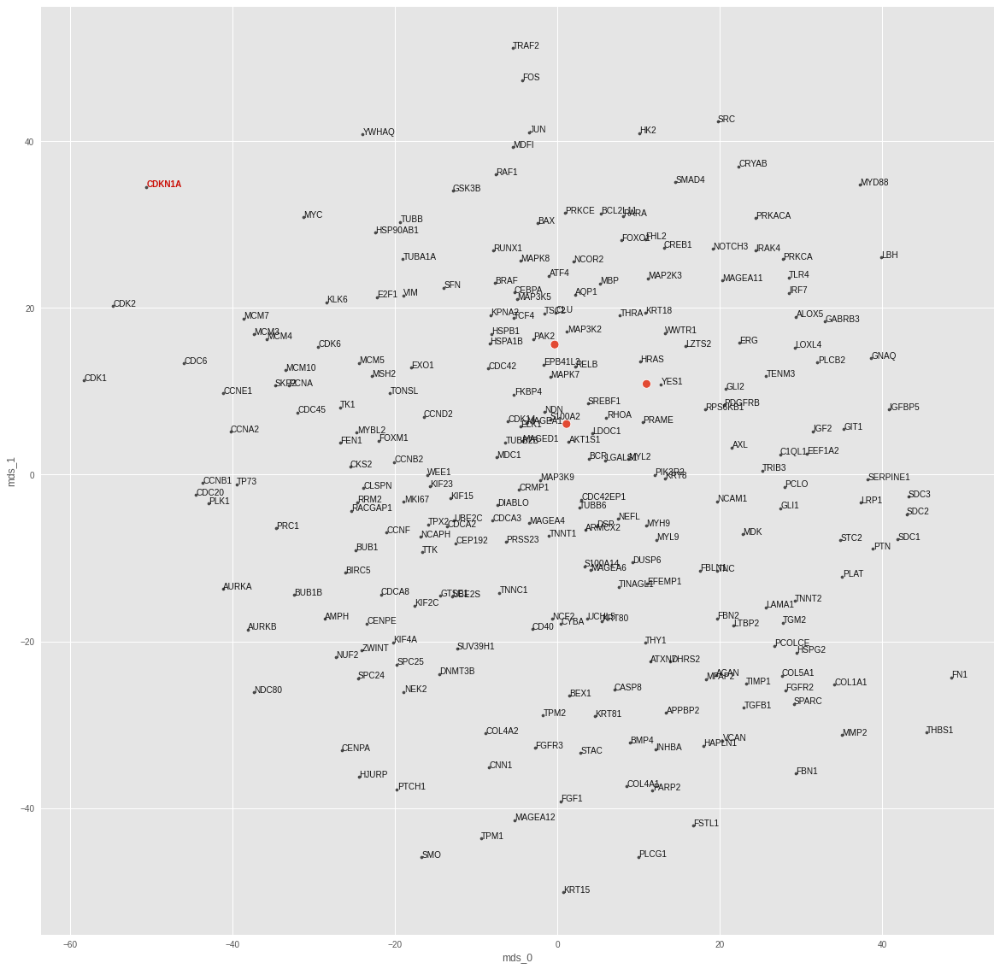

CEBPA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00028341502184048295
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.3960826396942139
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


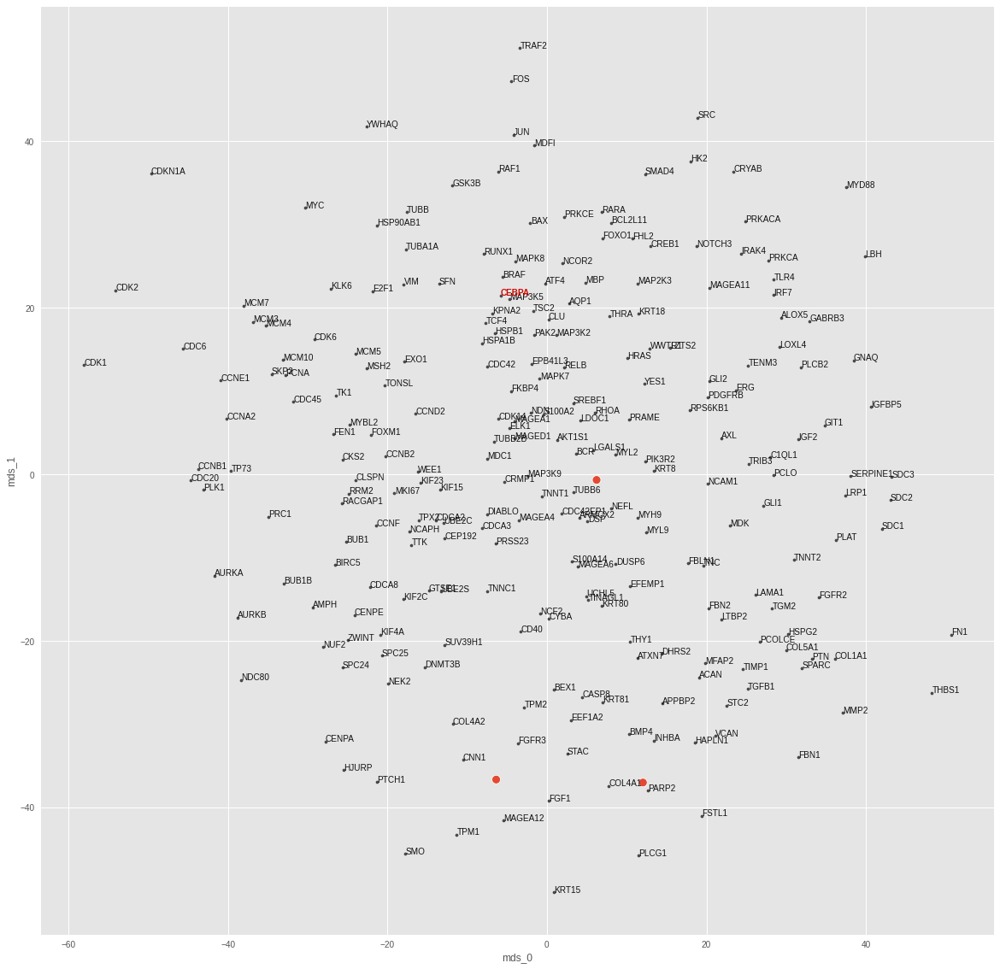

CREB1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0004058419435750693
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.165037989616394
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


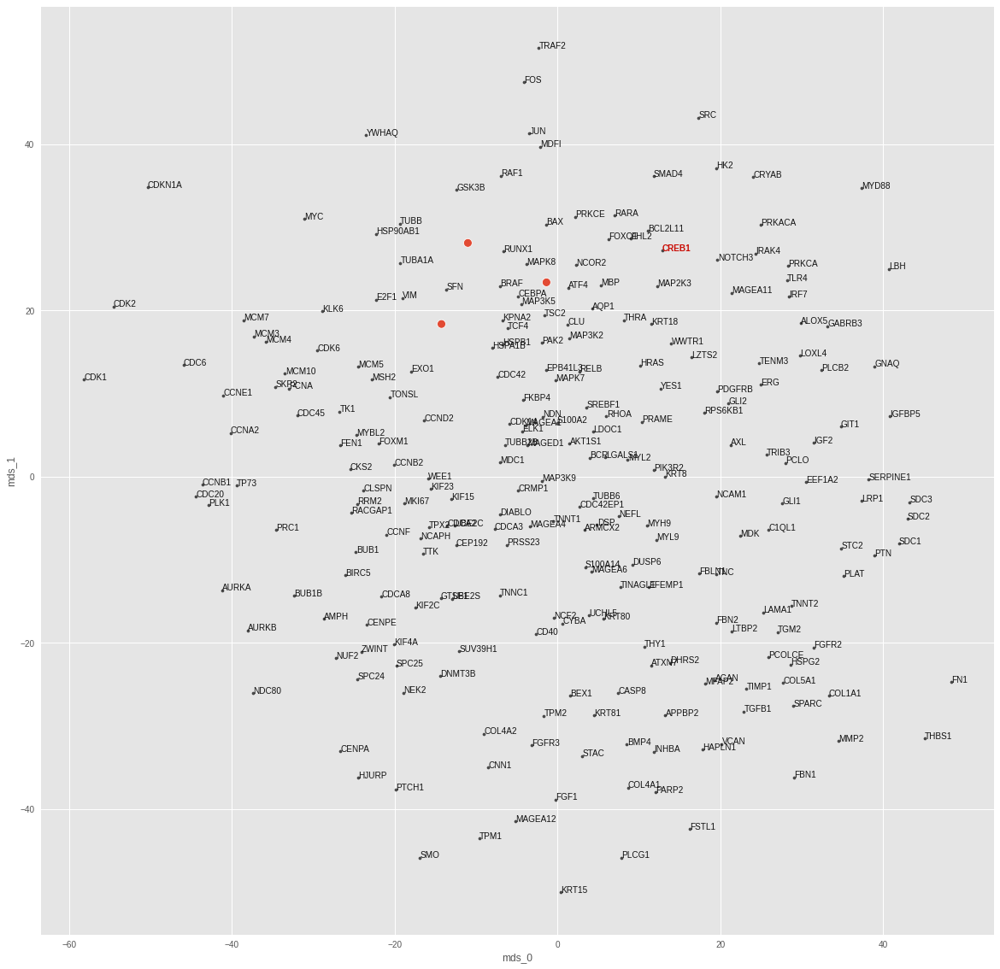

DIABLO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00044268983765505254
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.4415844678878784
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


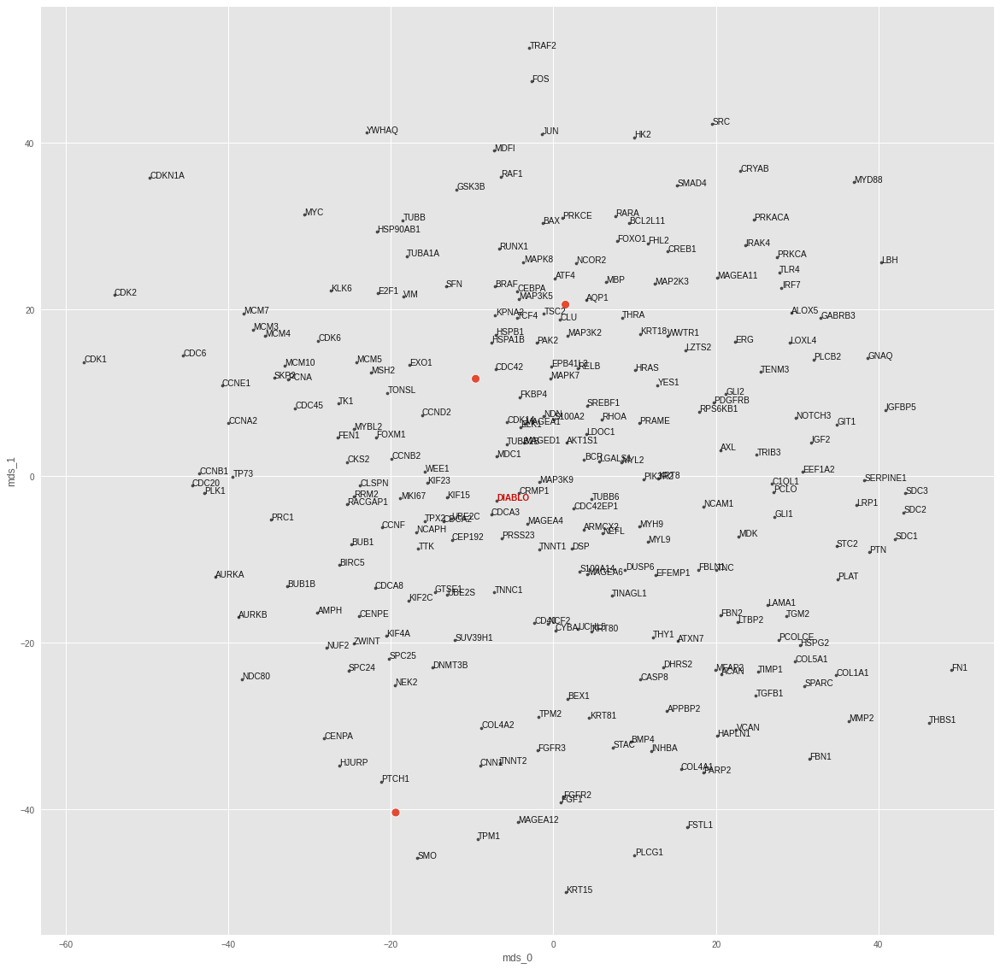

E2F1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00029191270004957914
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 3.737074613571167
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


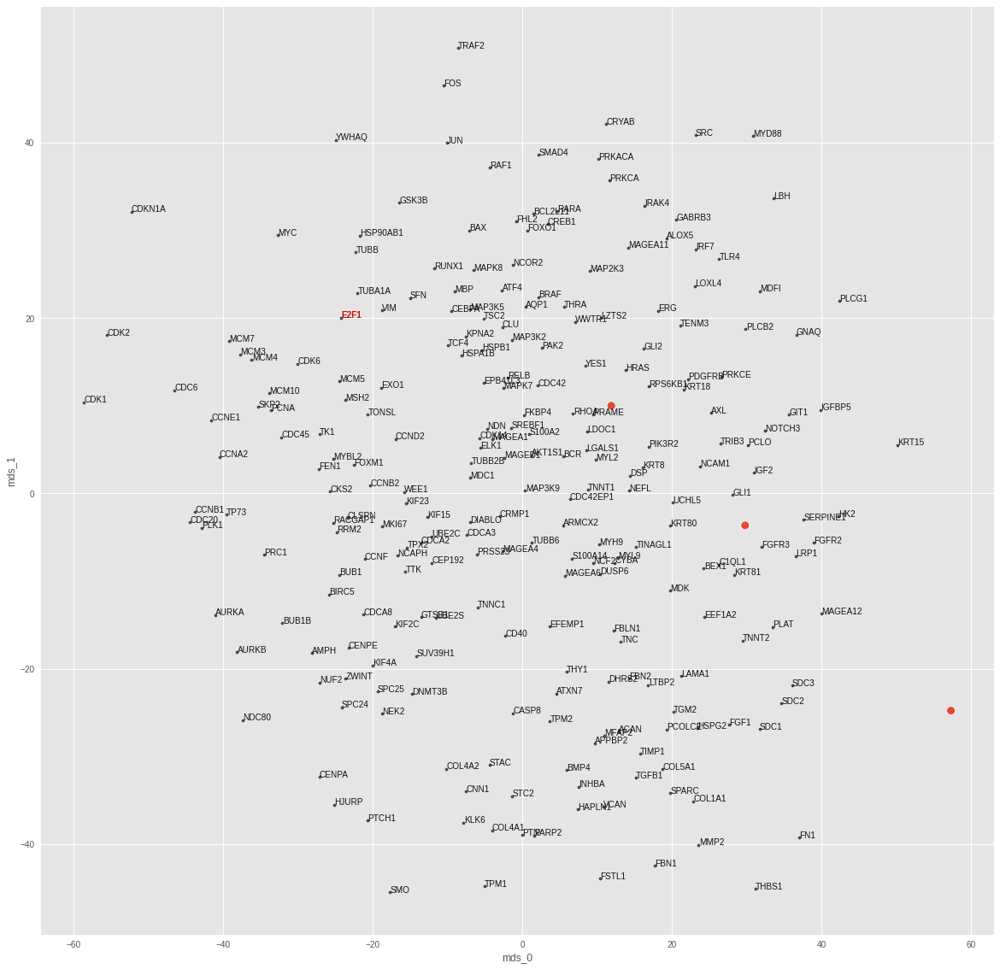

ELK1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0009064014884643257
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.7491058707237244
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 0.333333, 10: 0.333333, 20: 0.666667, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


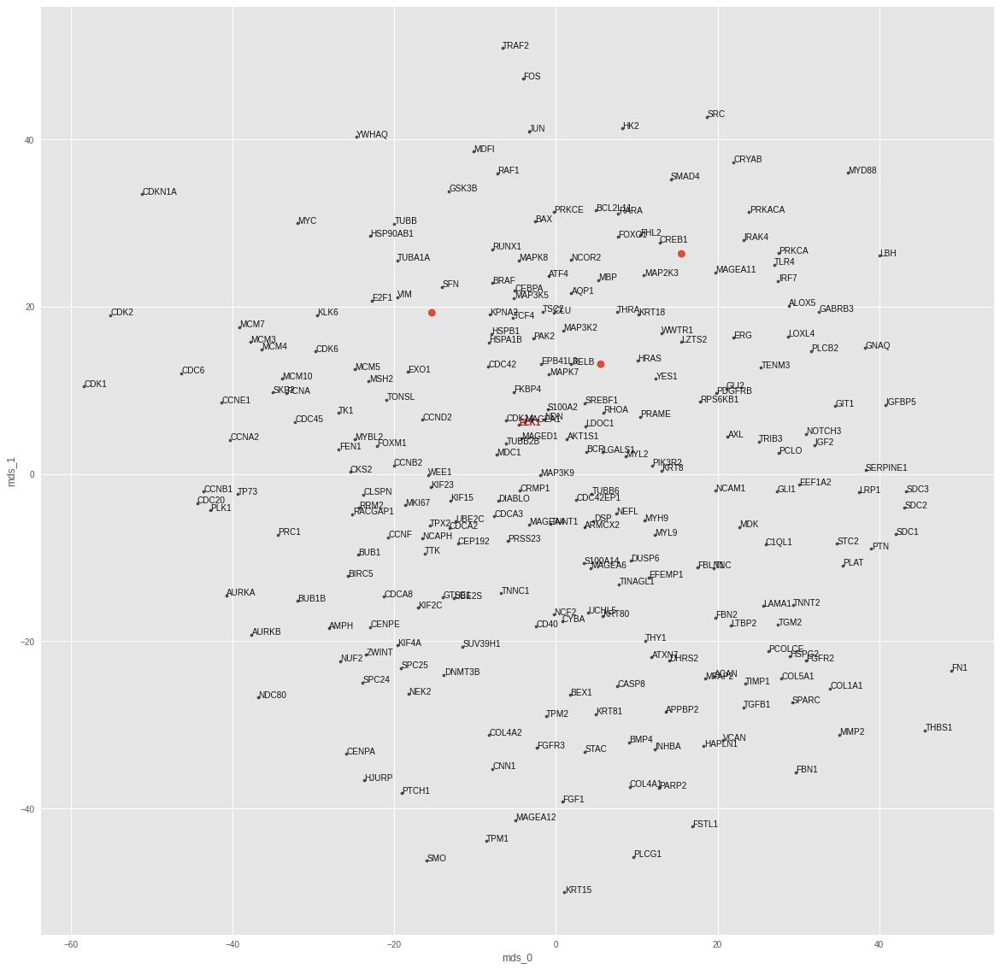

ERG
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00046461948659271
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.426213264465332
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


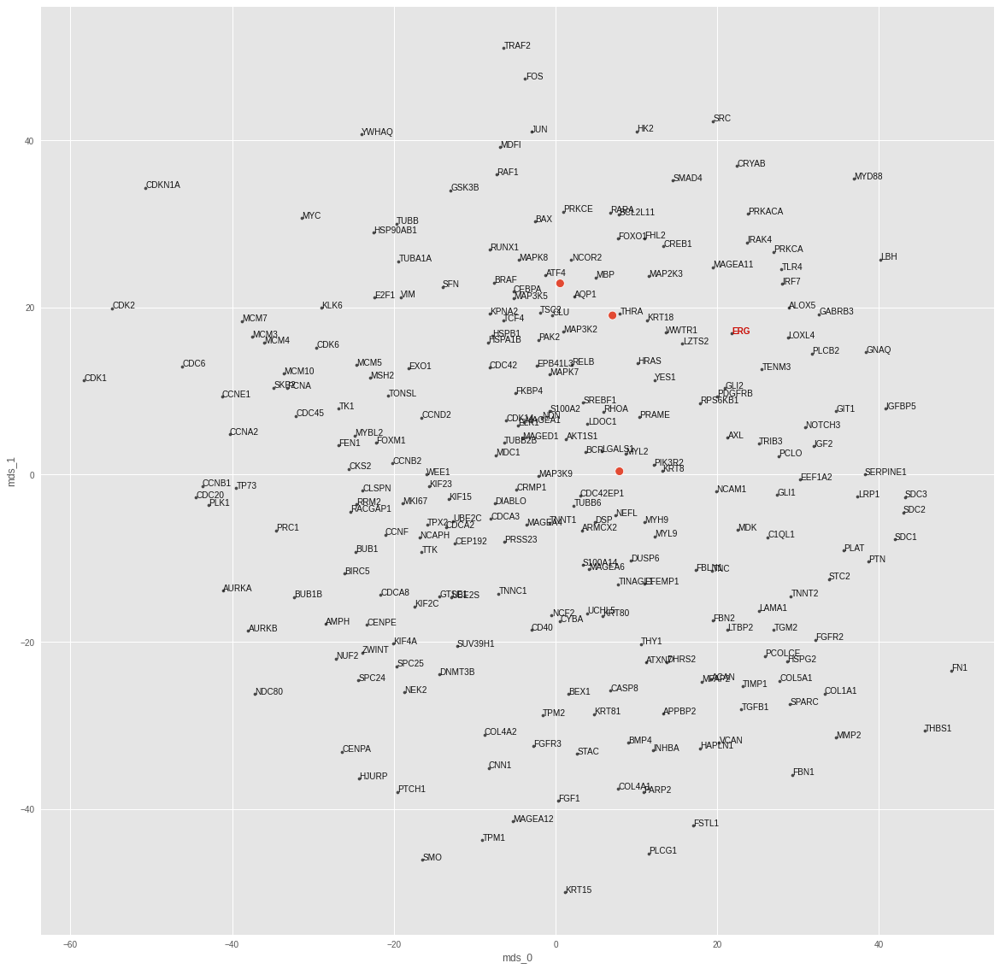

FGFR3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00028066293452866375
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.7383768558502197
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


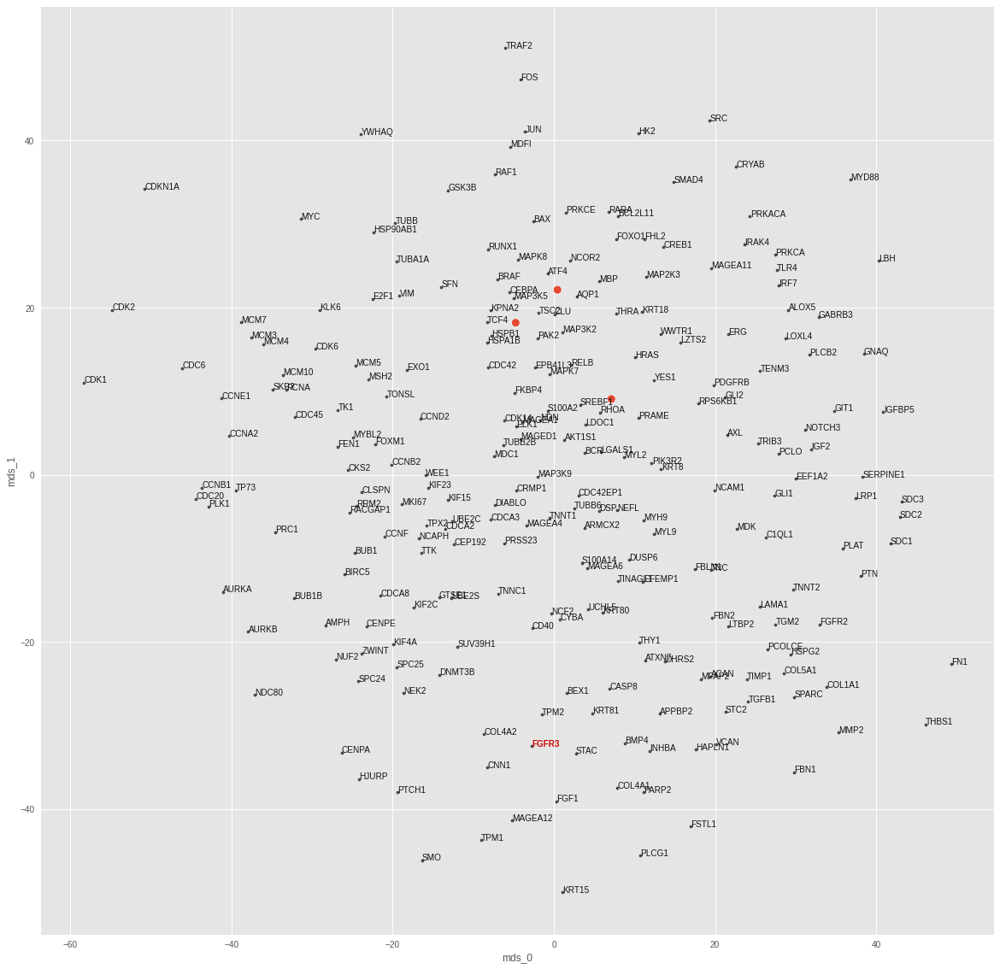

FOXO1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0003075636341236532
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.5546600818634033
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


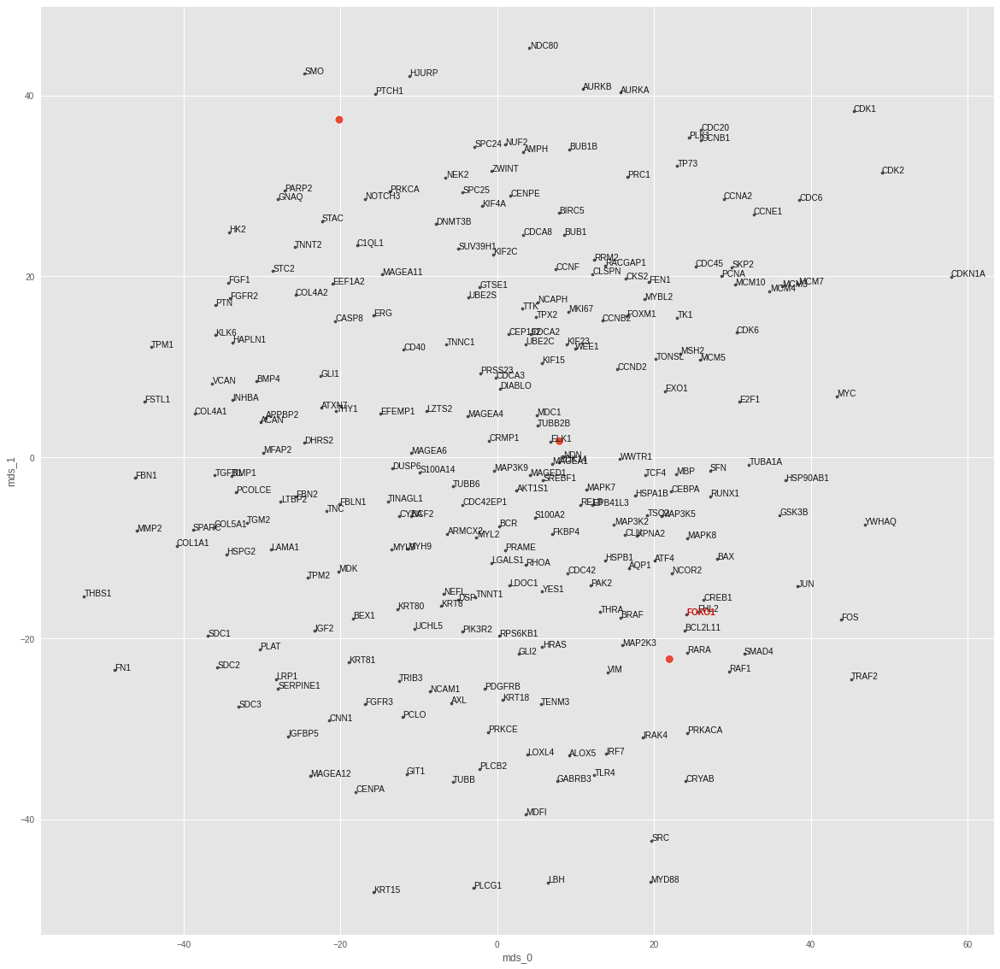

GLI1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.000329649425111711
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.4103963375091553
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


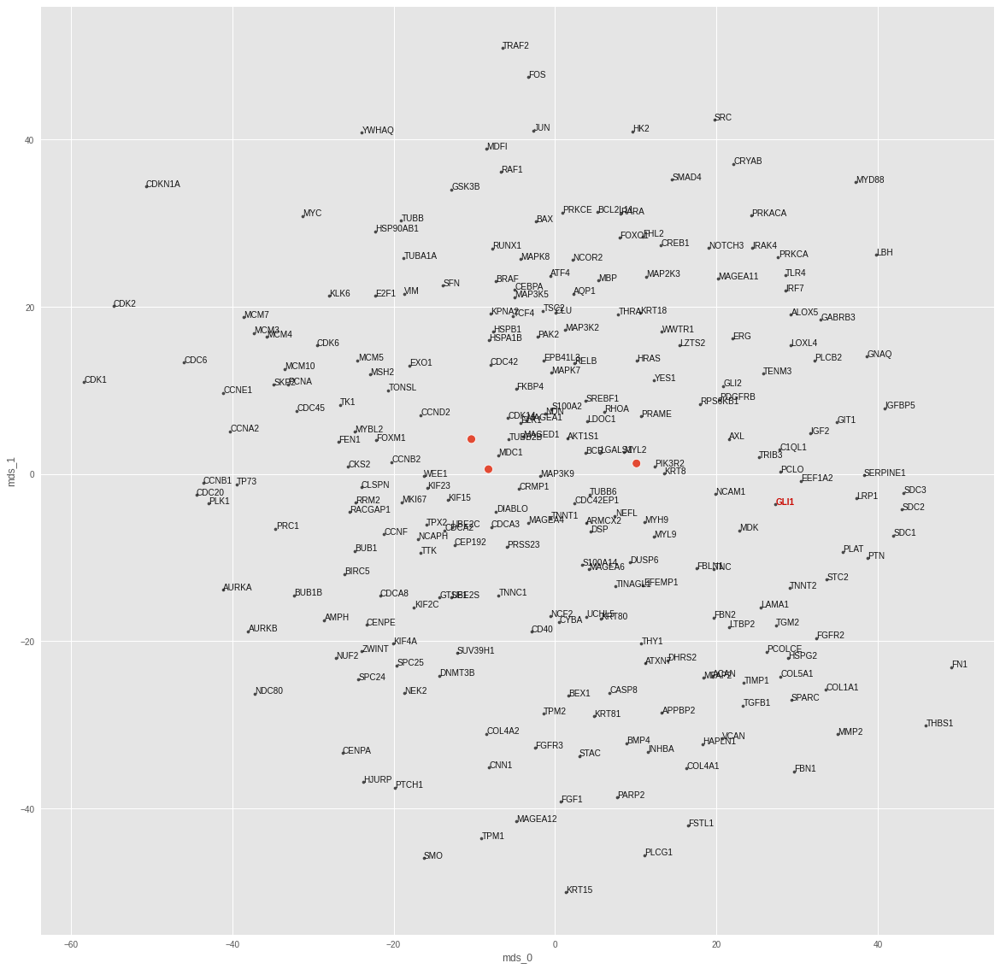

HRAS
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0004178179369773716
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.6736396551132202
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


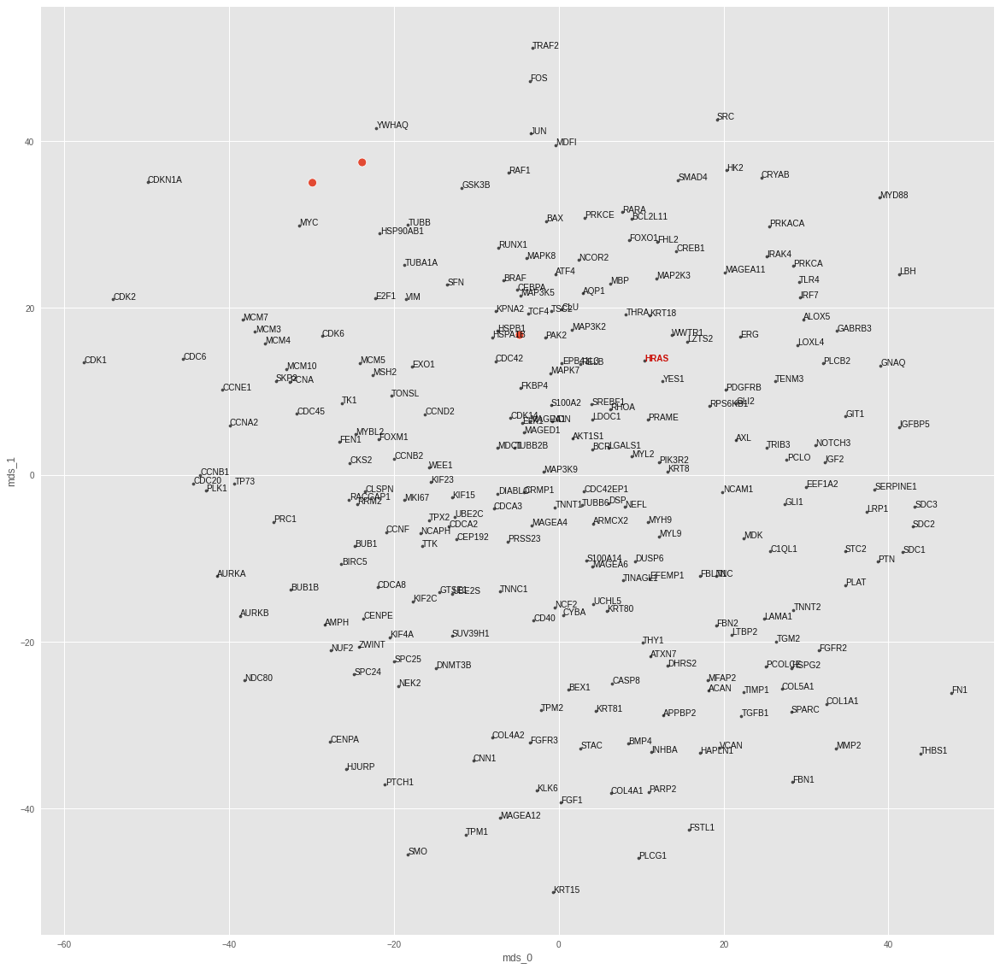

IRAK4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00026432235608808696
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.9492366313934326
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


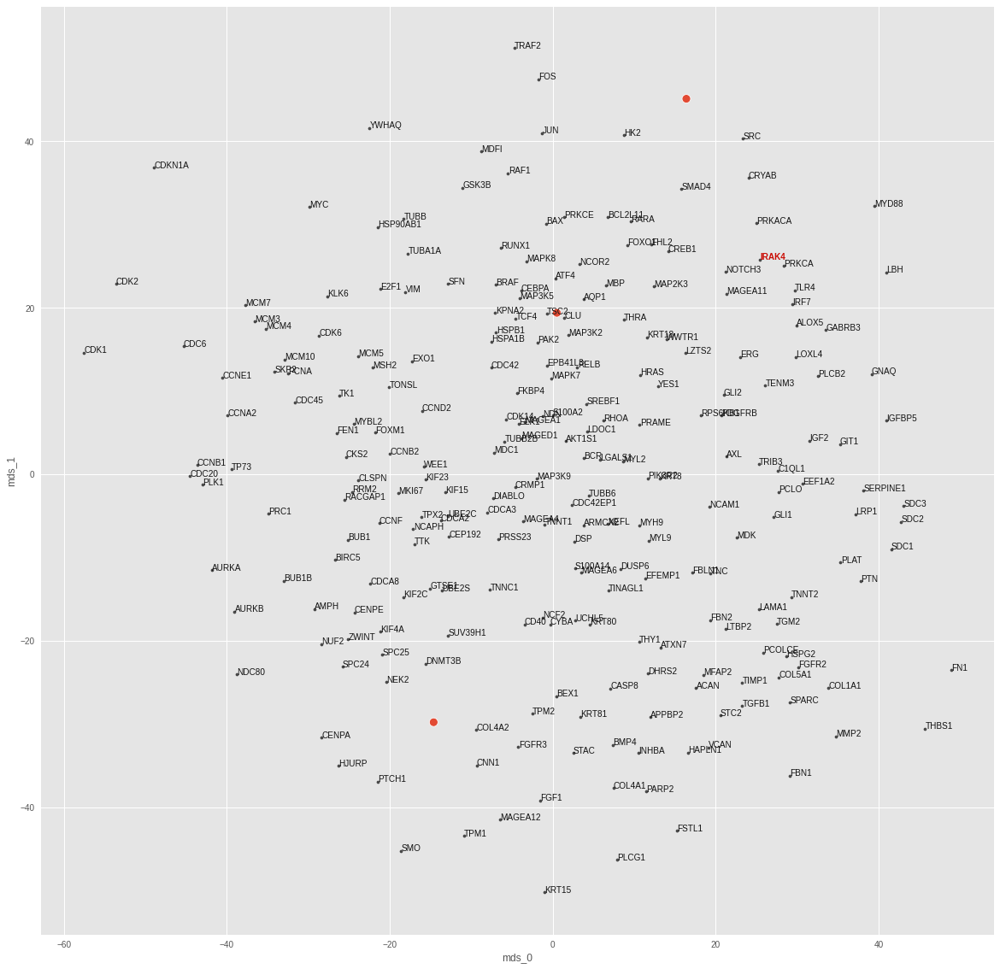

JUN
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00029621340218000114
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.6747773885726929
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


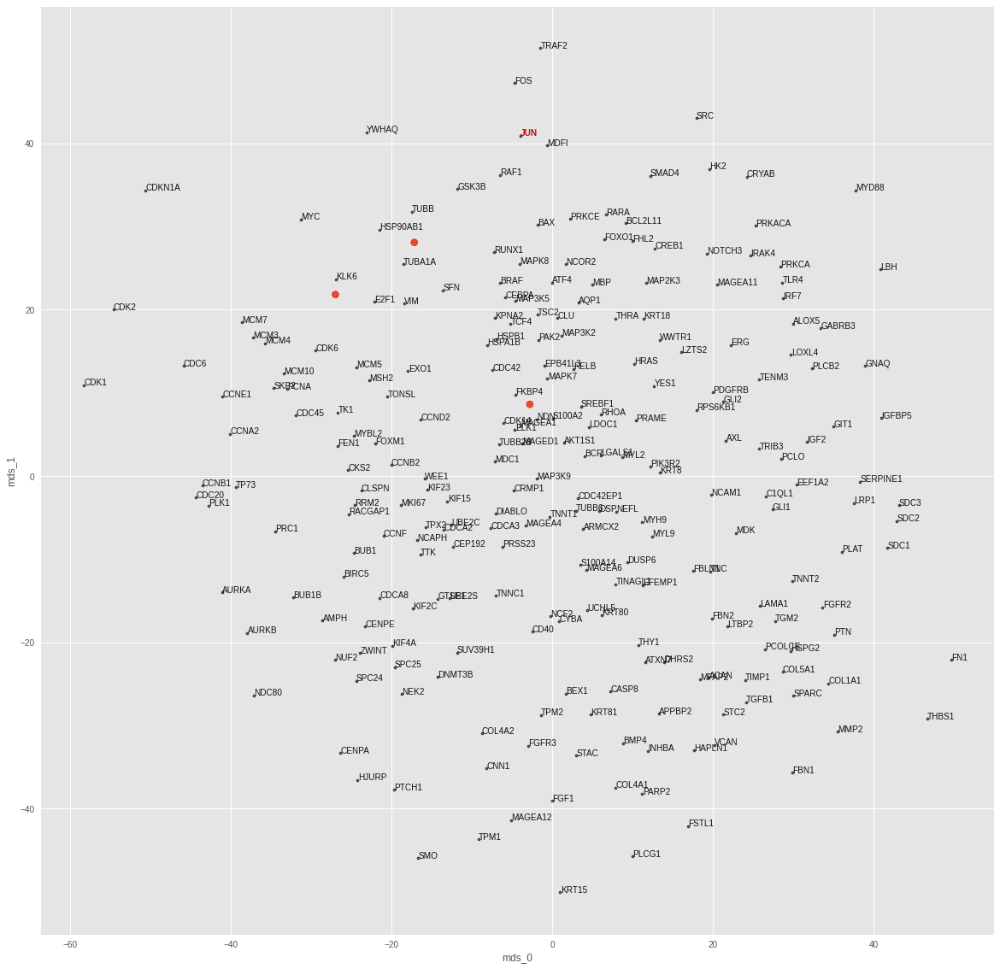

MAP2K3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.000279435160337016
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.177346110343933
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


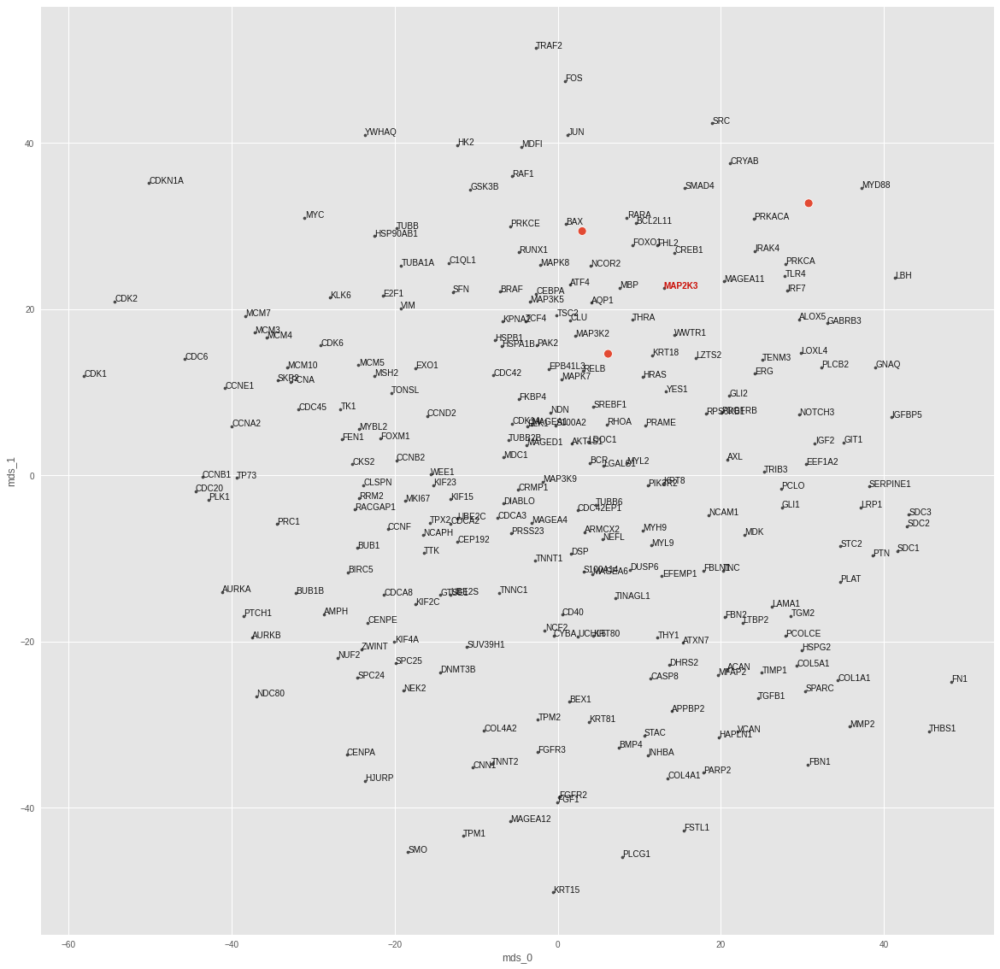

MAP3K2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0003091182734351605
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.5753296613693237
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 0.666667, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


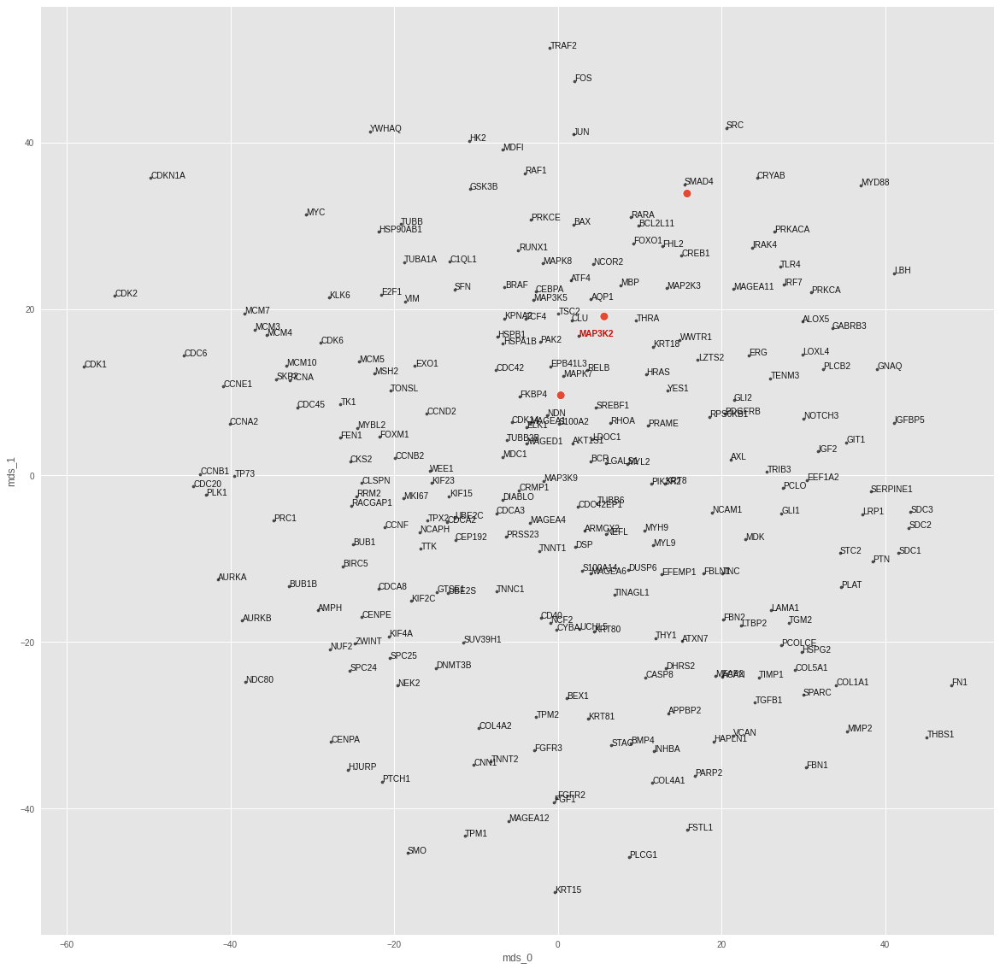

MAP3K5
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0004579177184496075
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.378828763961792
test top-k accuracies: {1: 0.333333, 3: 0.333333, 5: 0.333333, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


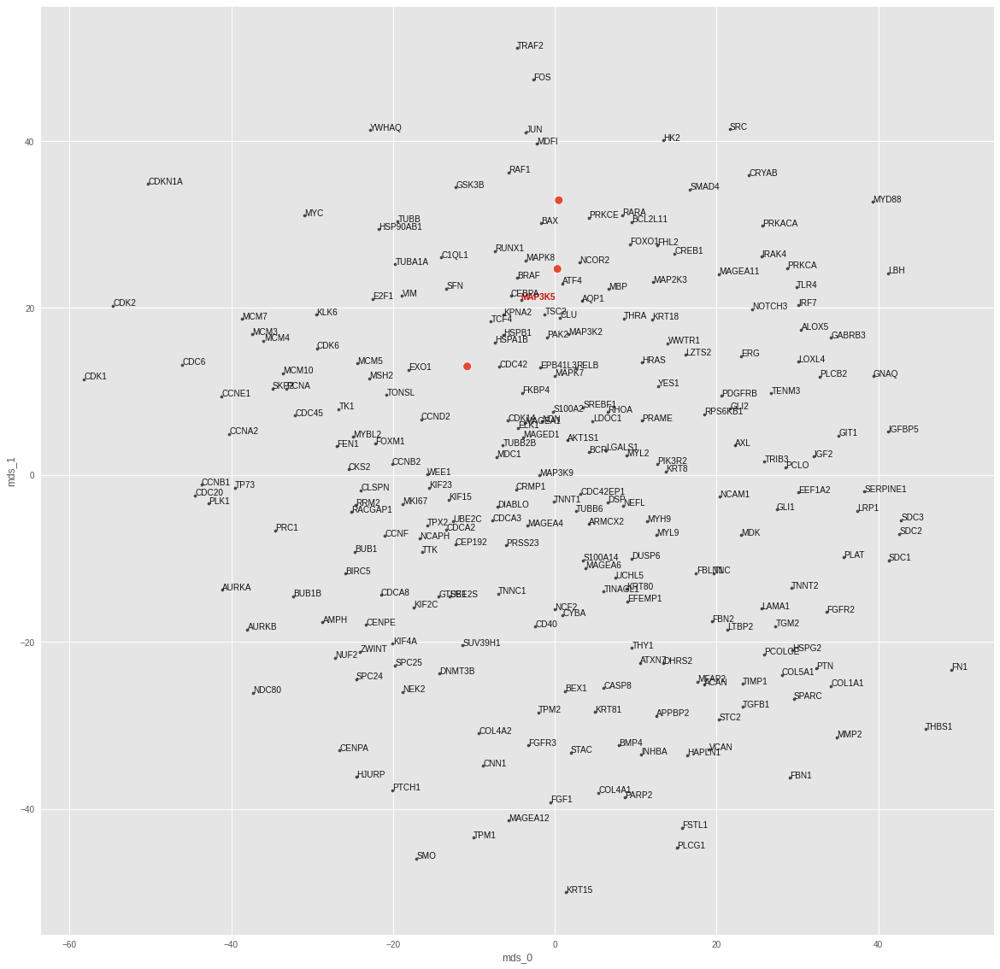

MAP3K9
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00036796642234548926
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.8875028491020203
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.333333, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


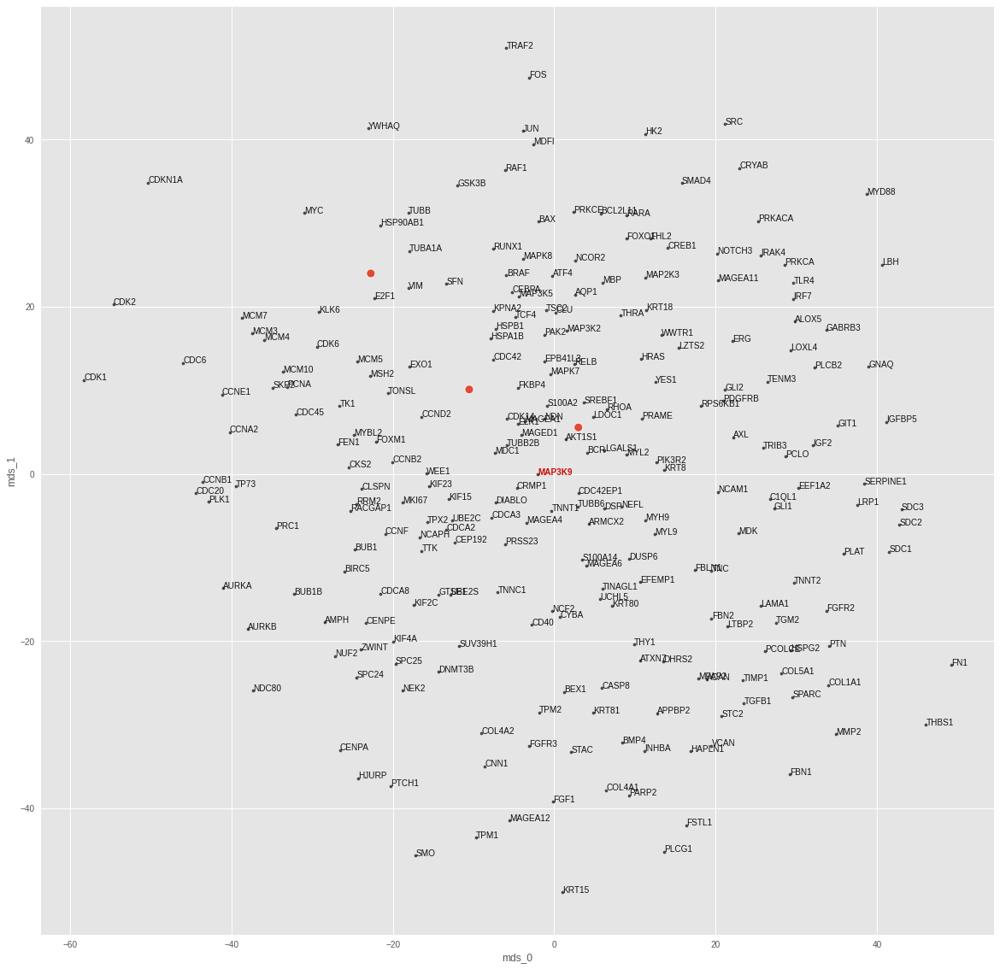

MAPK7
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00029086091672070324
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.46964892745018005
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 0.333333, 10: 0.333333, 20: 0.666667, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


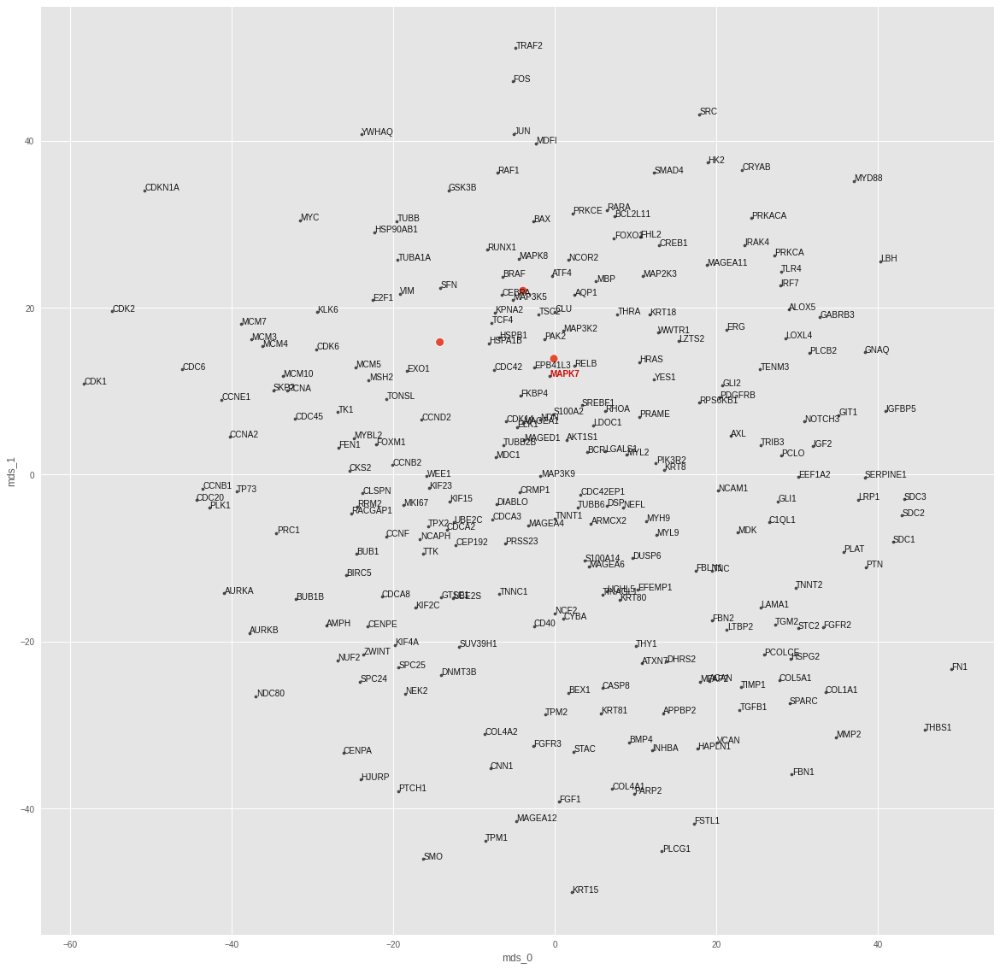

MYD88
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00043691517203114927
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 3.6098499298095703
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


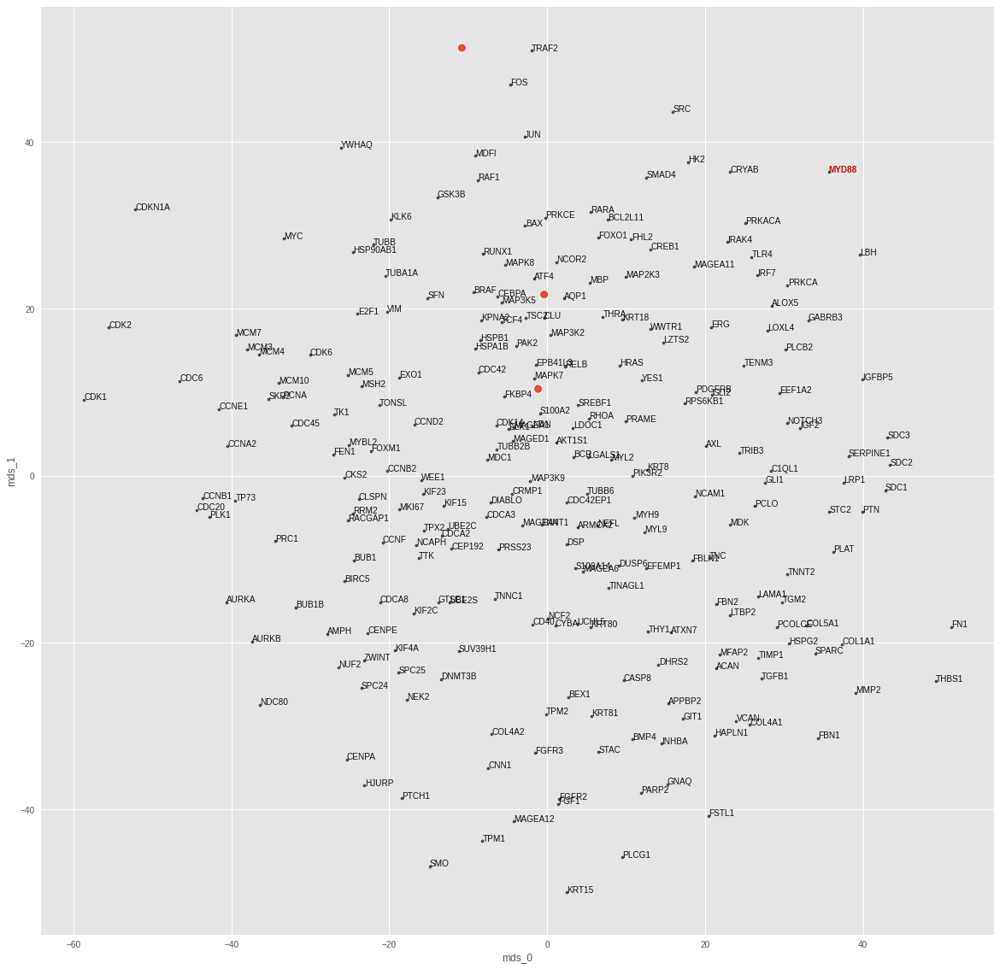

PIK3R2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0002674441784620285
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.0746617317199707
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.666667, 20: 0.666667, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


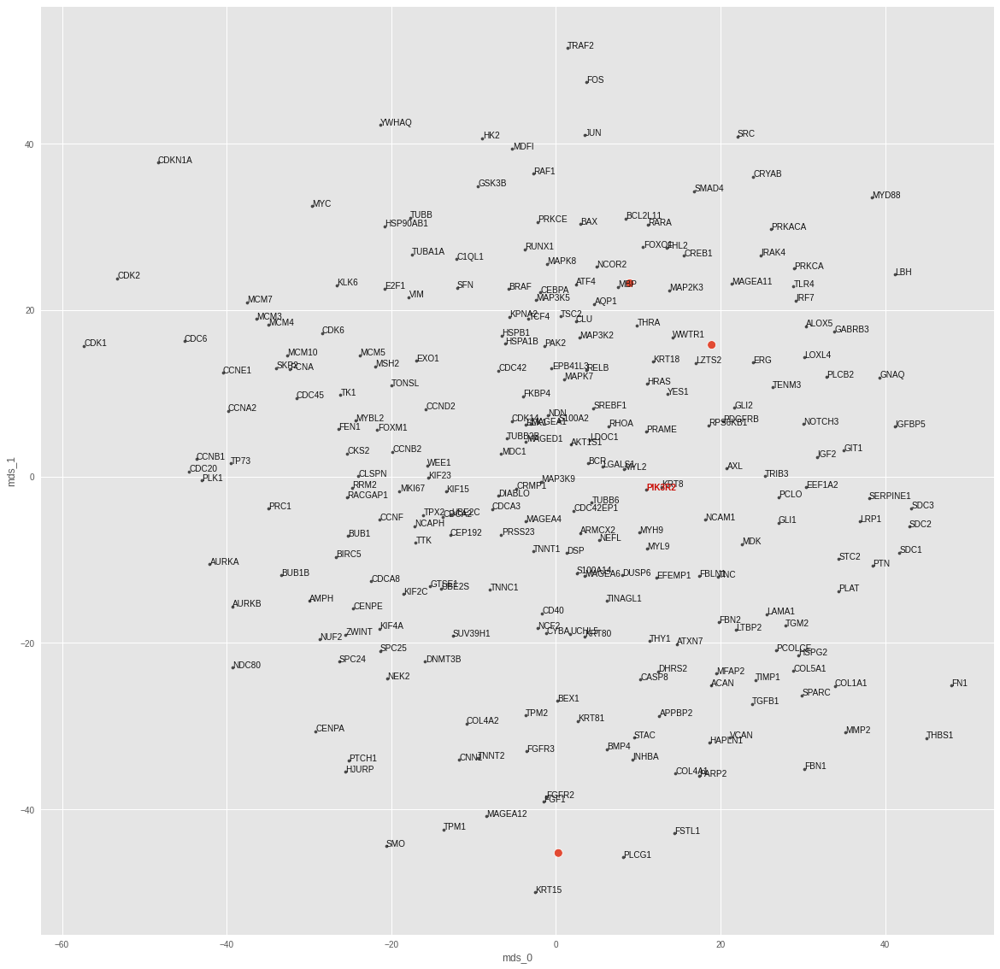

PRKACA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00028666670550592244
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 2.1073899269104004
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


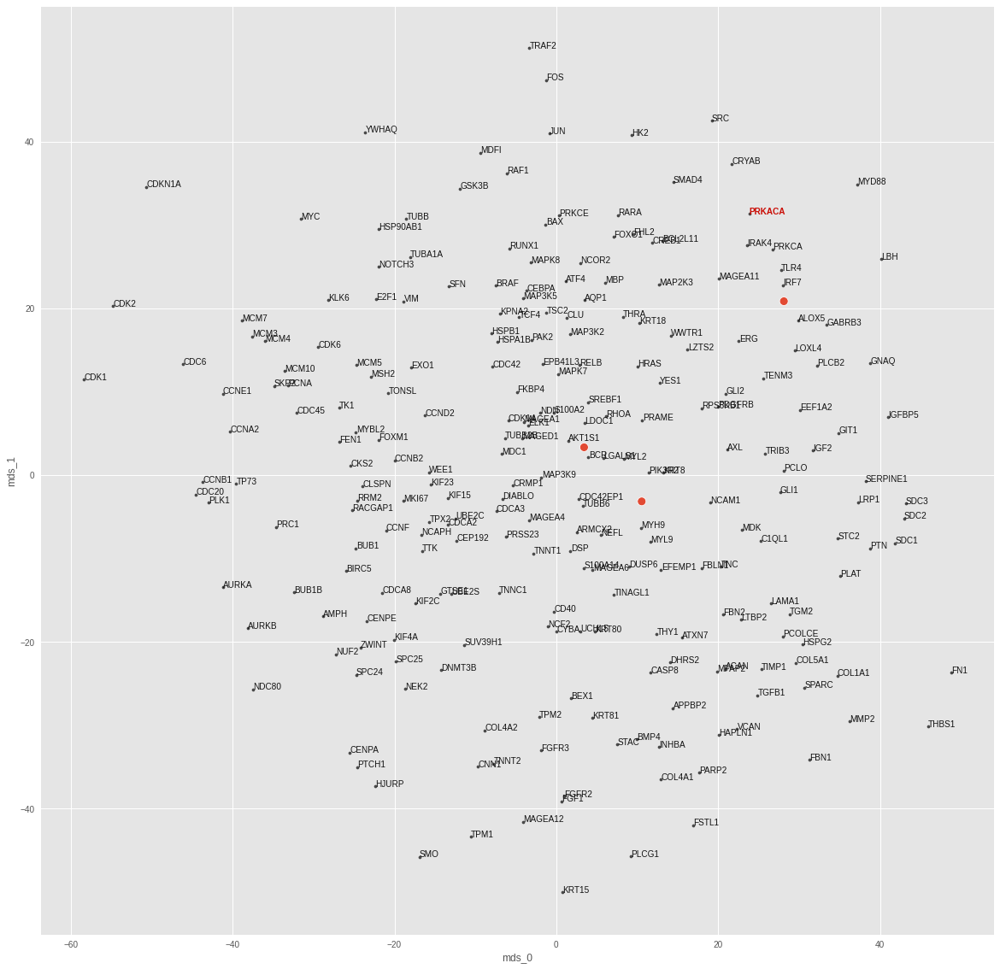

PRKCE
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00024794897763058543
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.08341646194458
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


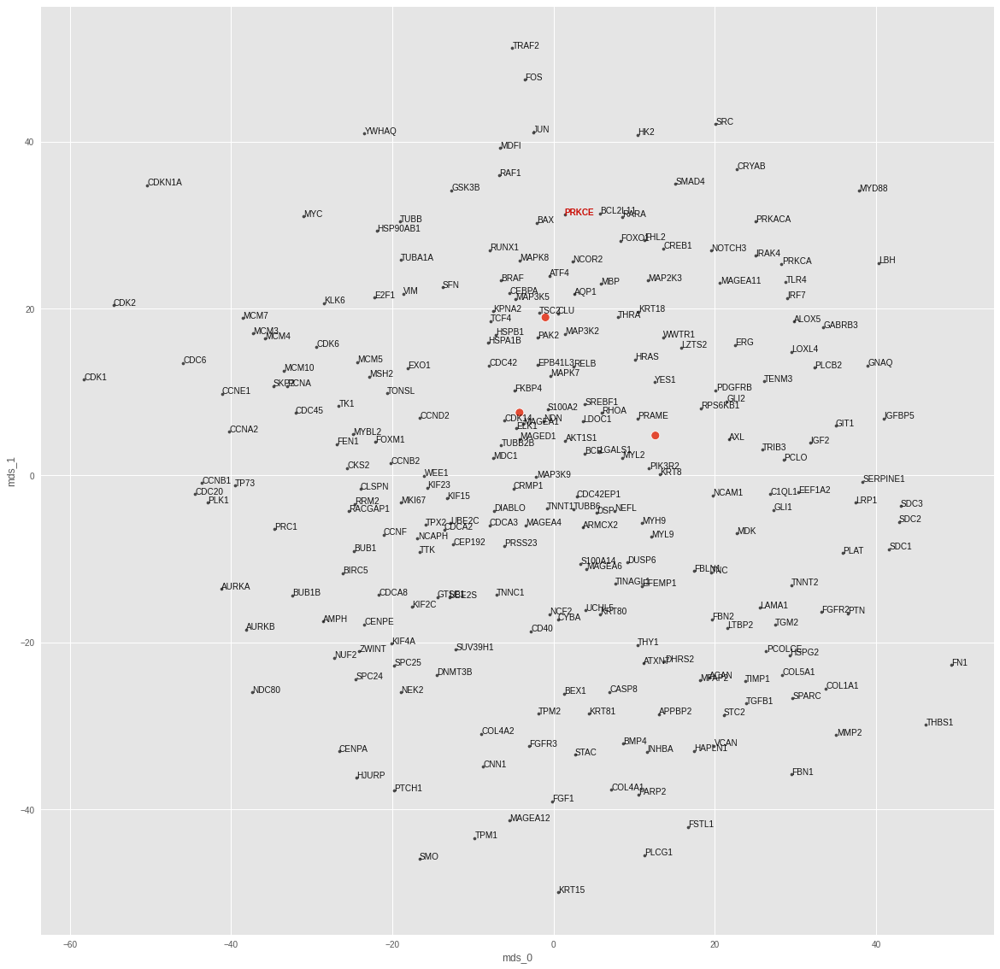

RAF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00029131706105545163
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.6541893482208252
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


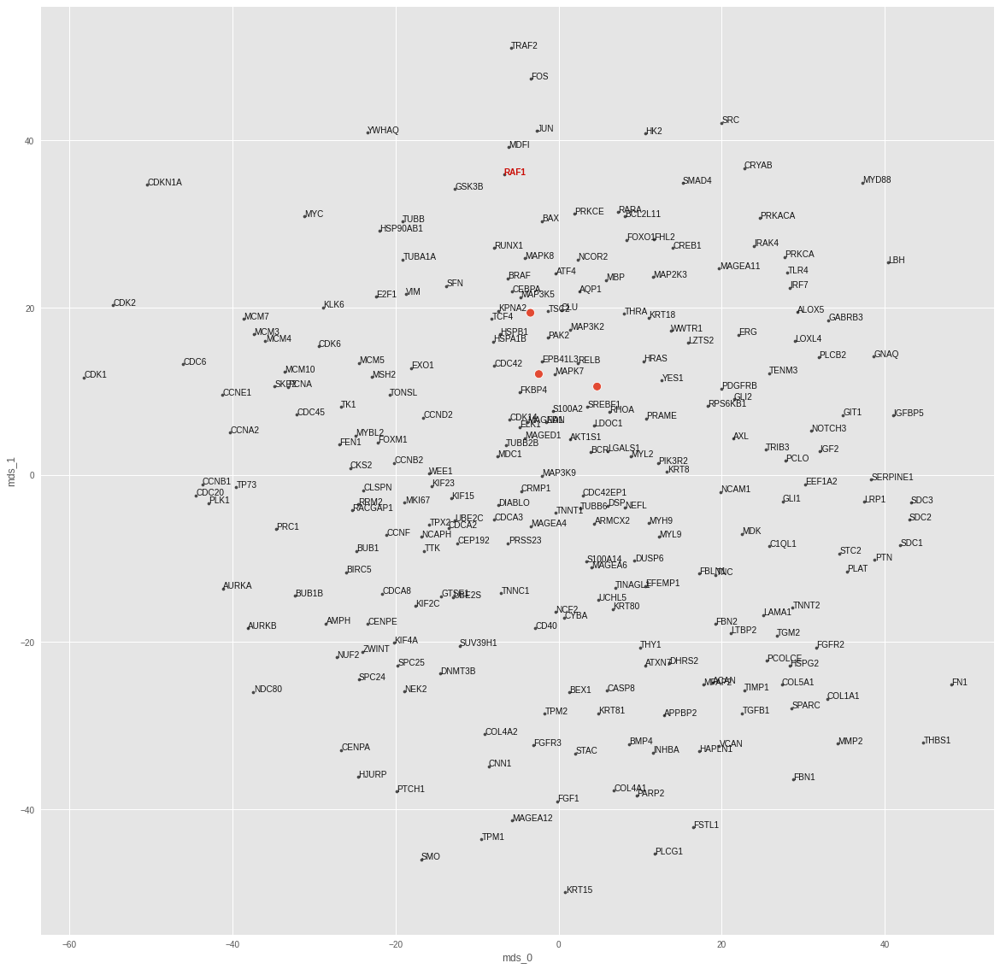

RELB
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0003701410605572164
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 2.0156564712524414
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


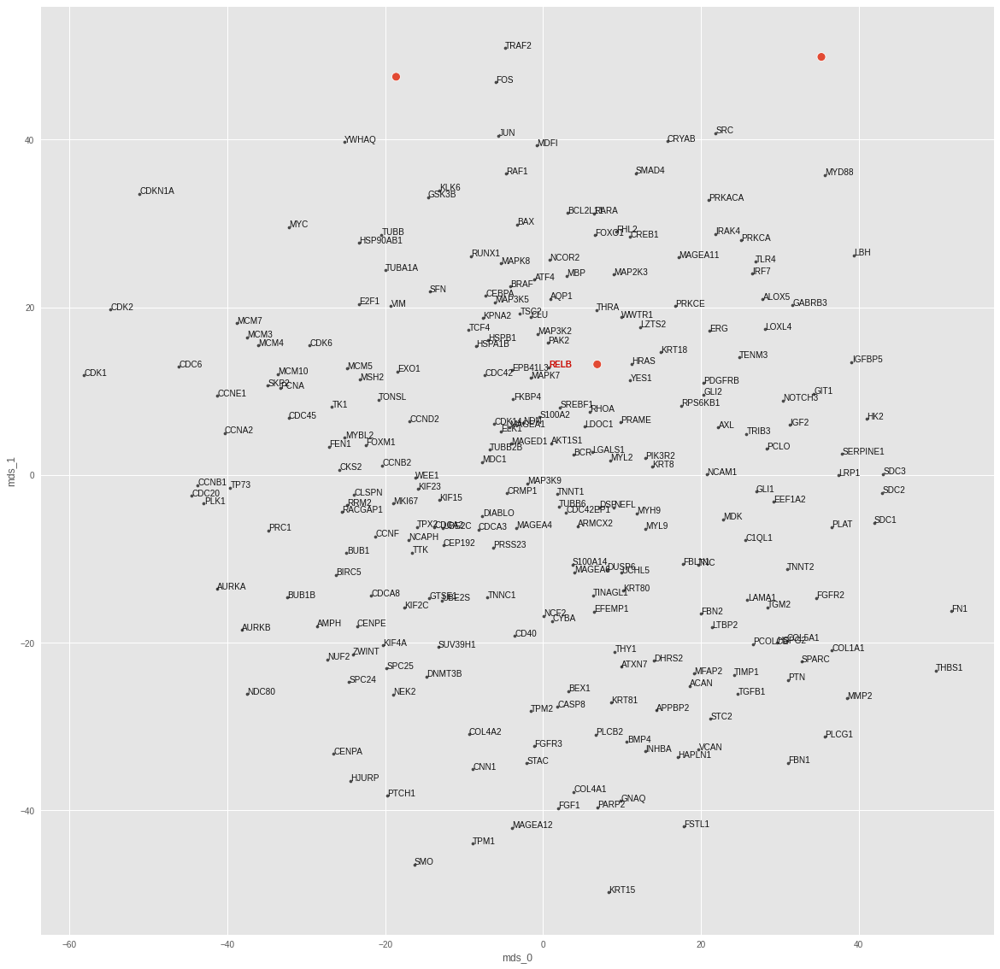

RHOA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00031010404927656054
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.7296818494796753
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.333333, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


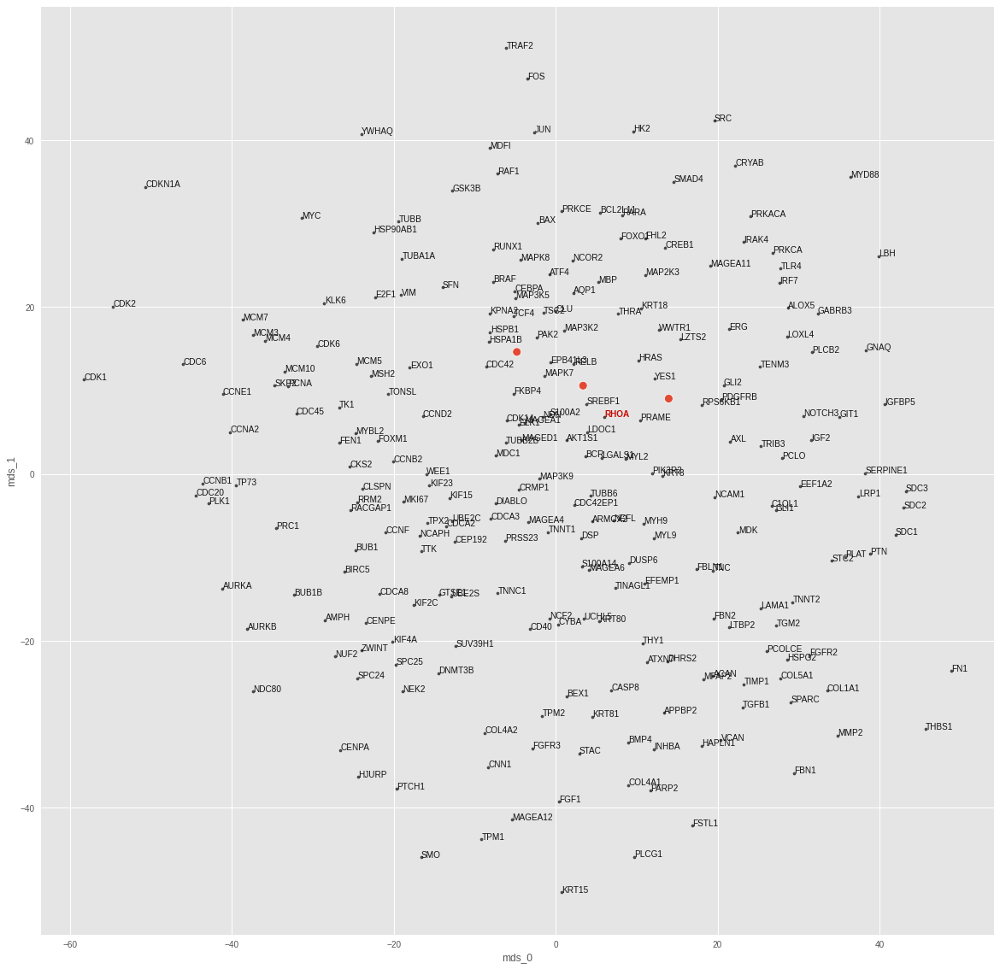

SMAD4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0003549478715285659
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.0983226299285889
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


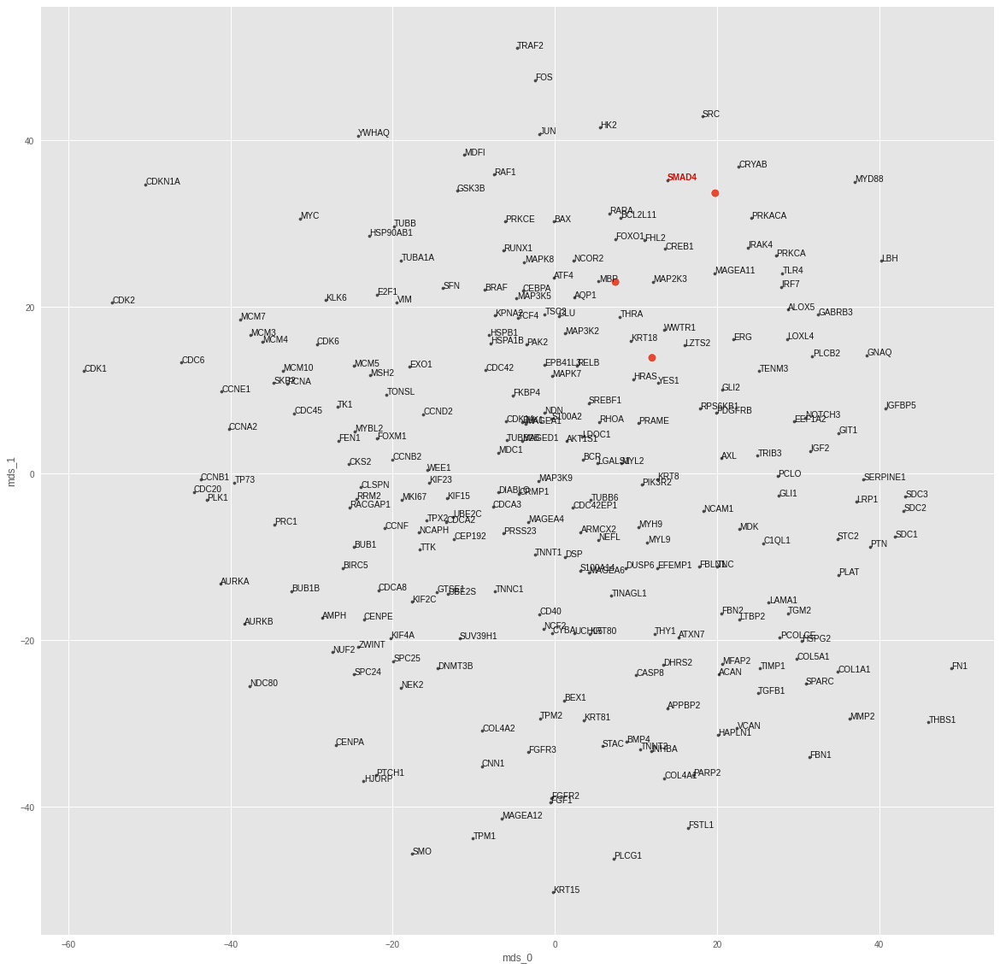

SMO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0003880513249896467
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 2.449009656906128
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


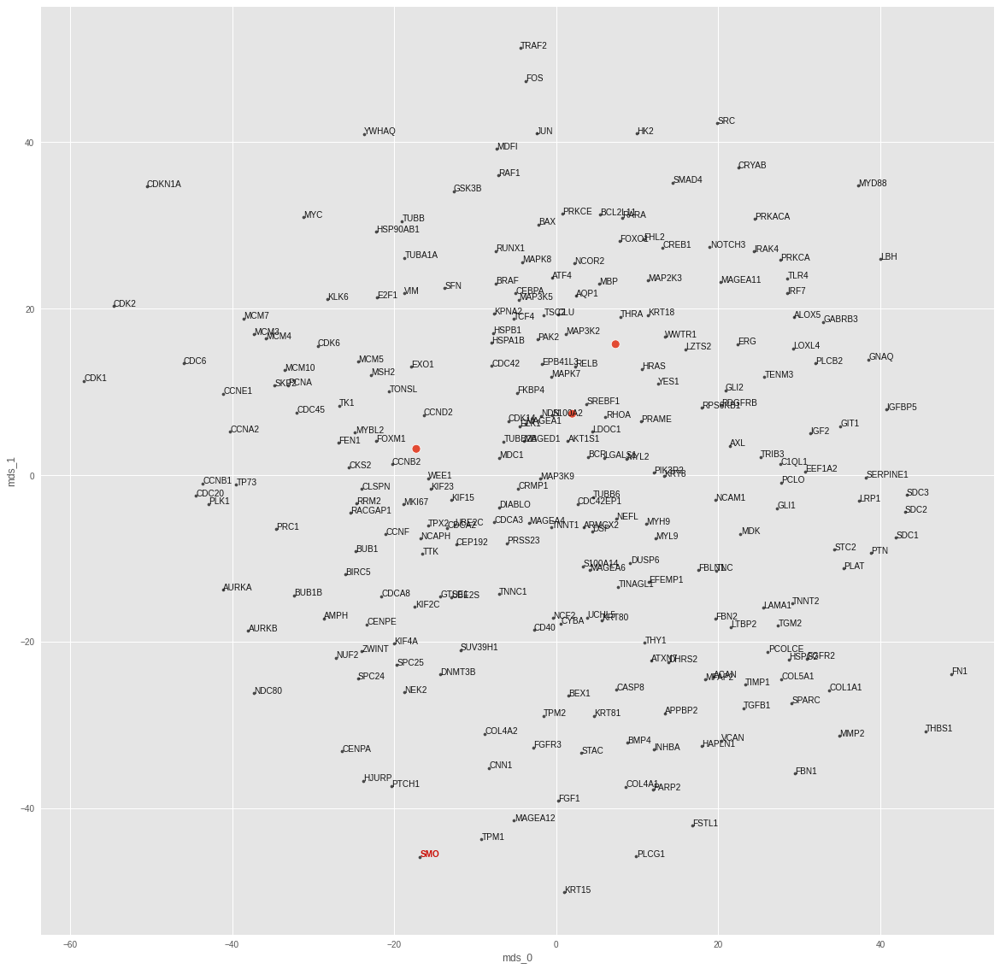

SRC
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.000390890782000497
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.4467743635177612
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


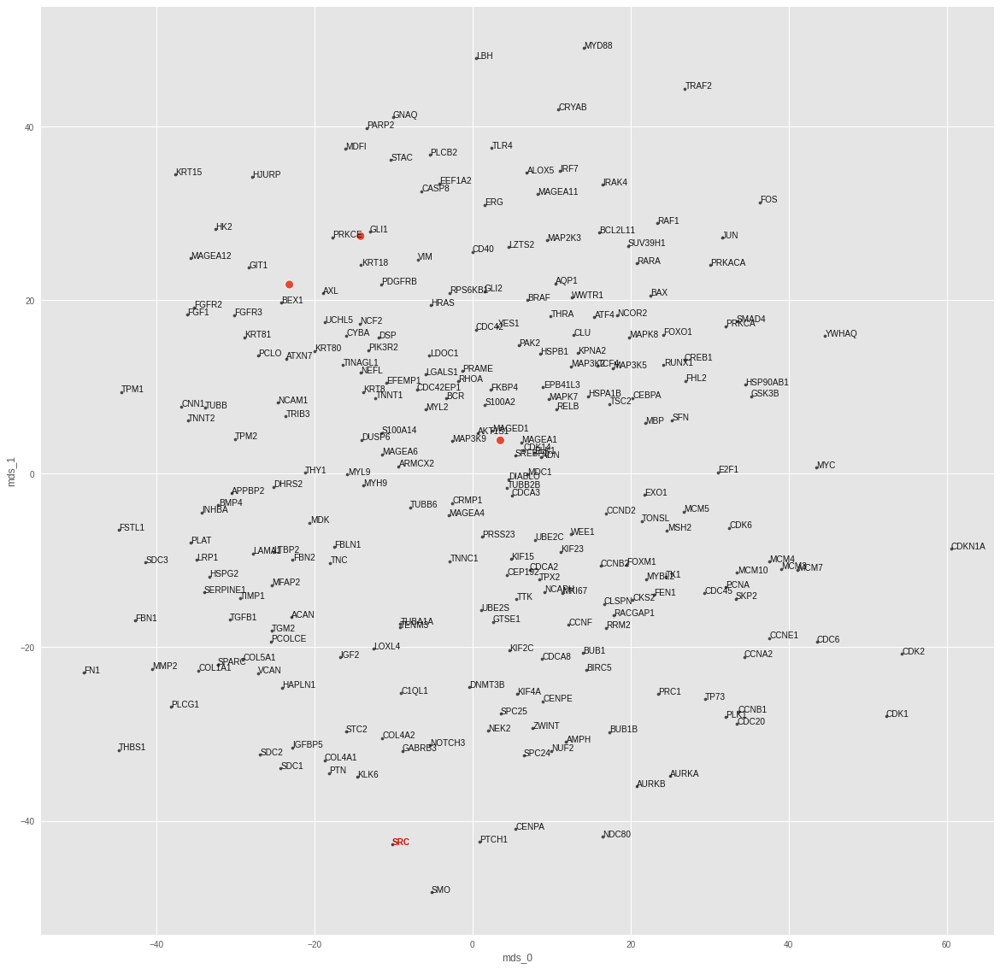

SREBF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0005367647972889245
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.8091513514518738
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.333333, 20: 0.666667, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


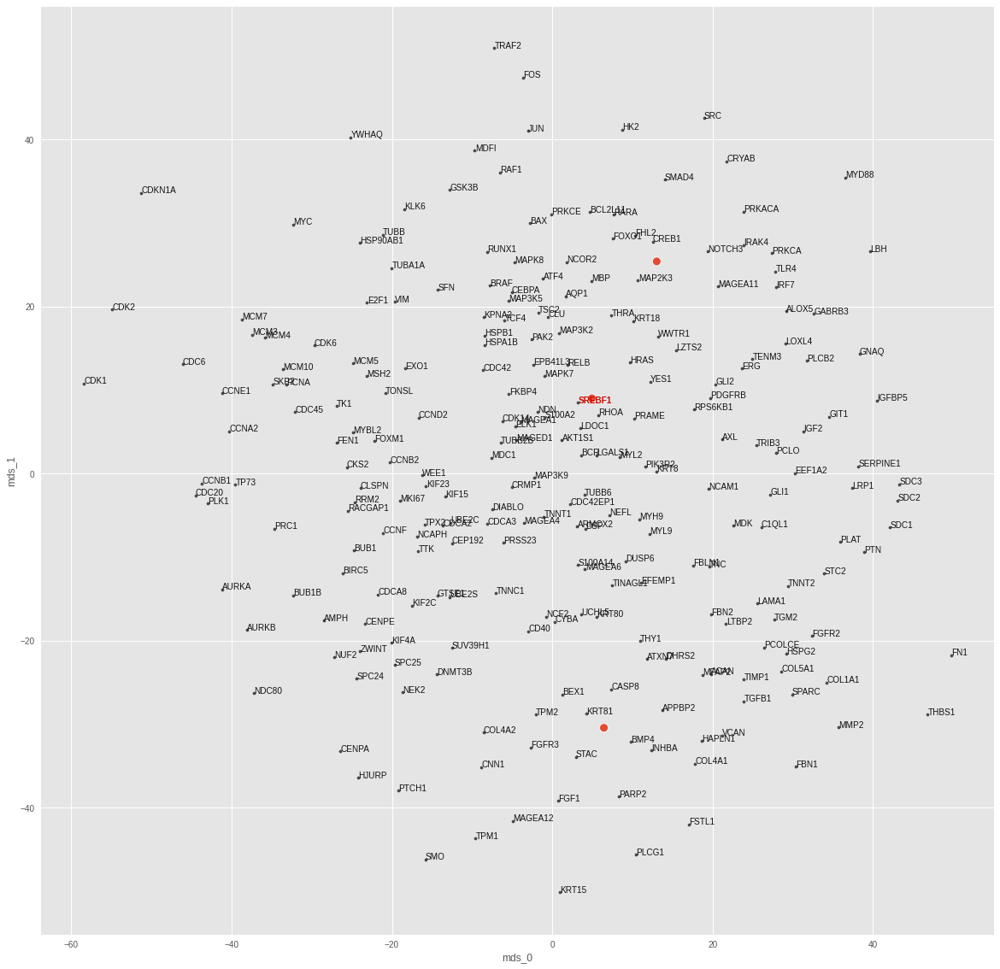

TRAF2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00021691272559110075
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 3.664407730102539
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


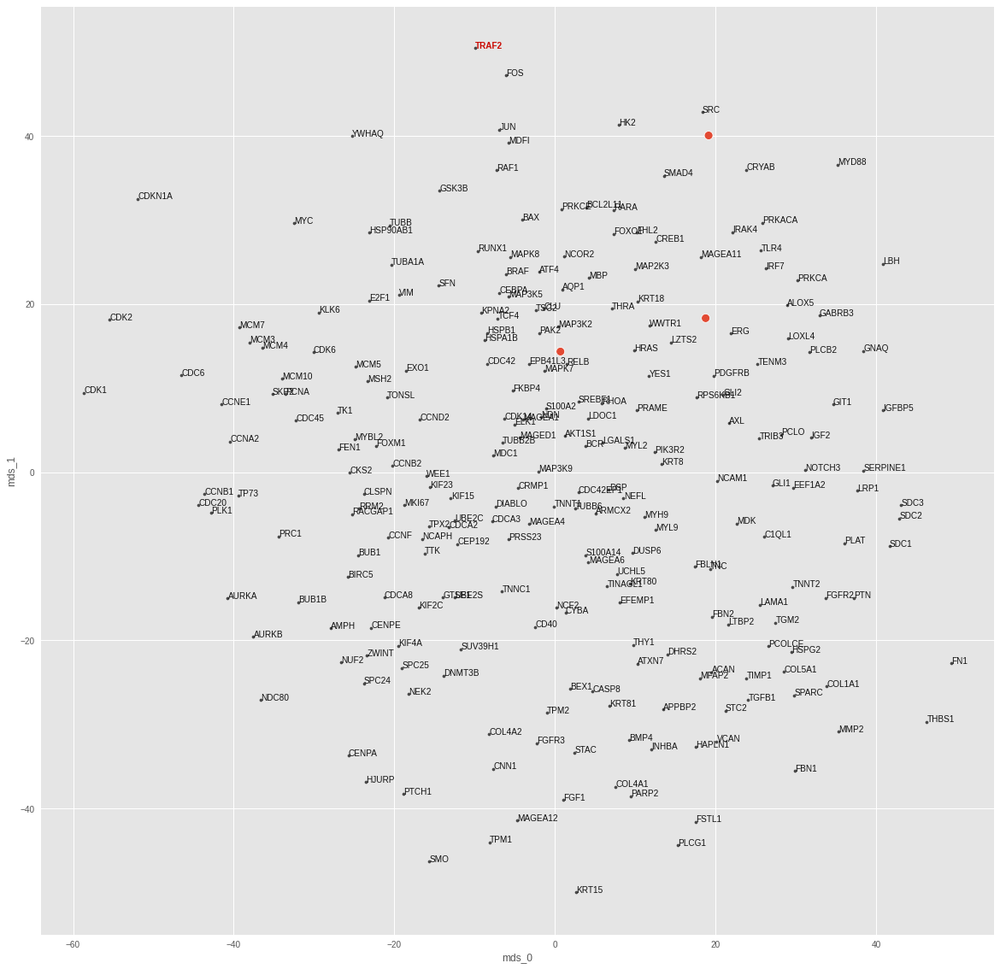

TSC2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00035056949127465487
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.3368382453918457
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.666667, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


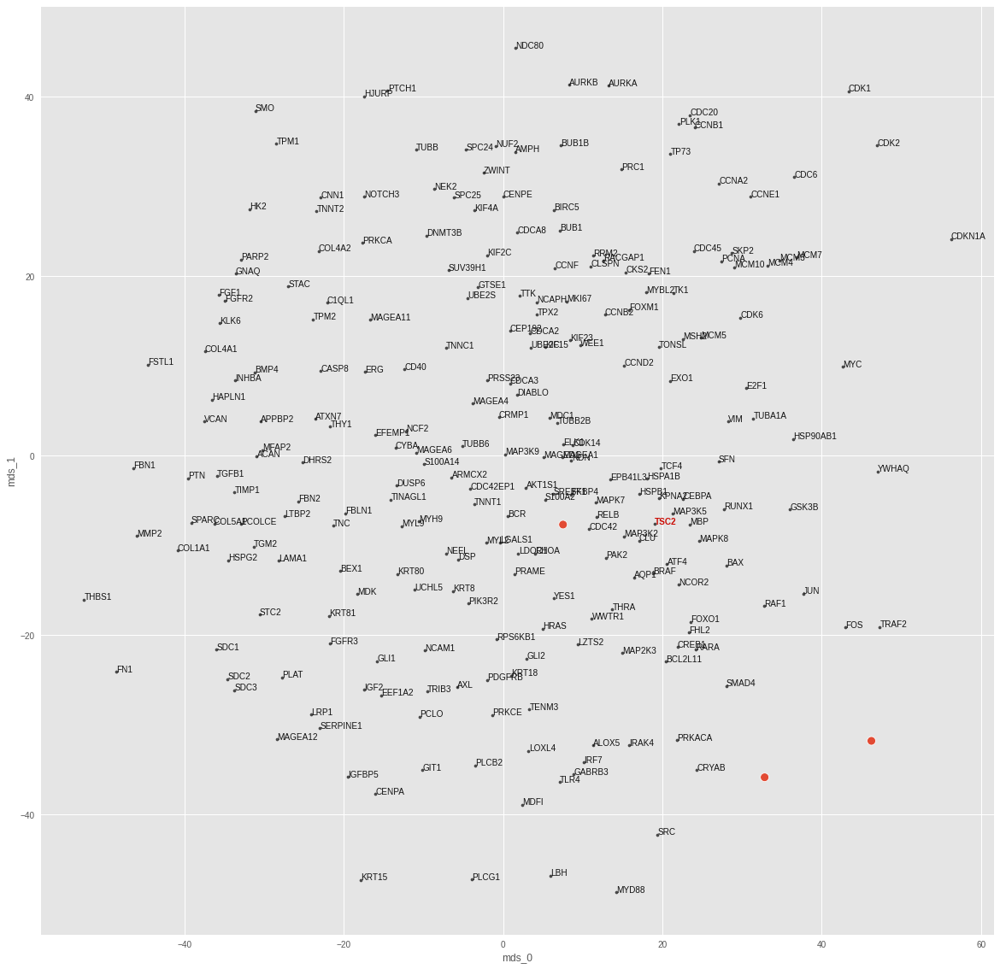

WWTR1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0003164079680573195
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.3869400024414062
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


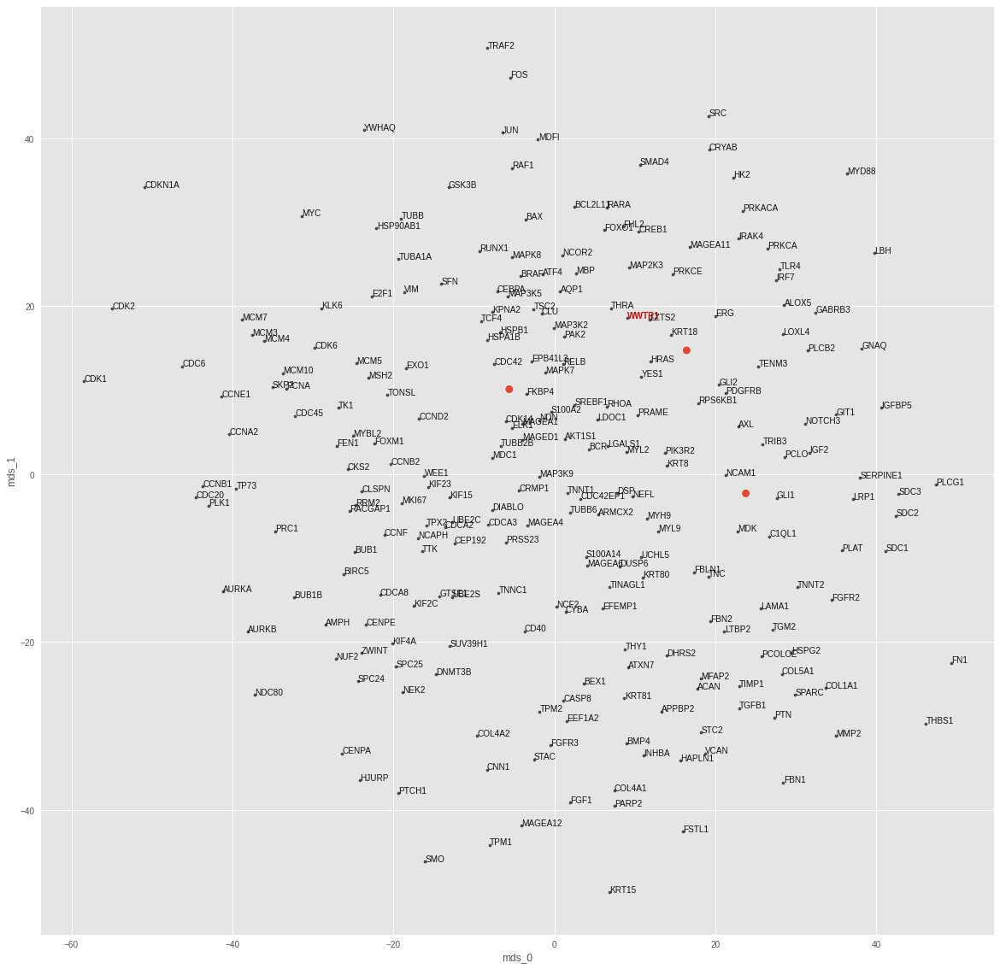

<IPython.core.display.Javascript object>

In [61]:
target_topk_accs = {}
cl_nonlin_nns_dict = {}
for i in tqdm(range(len(cl_data_dicts))):
    data_dict = cl_data_dicts[i]
    model = torch.nn.Sequential(
        torch.nn.Linear(1024, 1024),
        torch.nn.PReLU(),
        torch.nn.Linear(1024, 1024),
    )
    optimizer = Adam(model.parameters(), lr=1e-3)
    criterion = torch.nn.MSELoss()
    target = sorted(list(shared_targets))[i]
    print(target)
    fitted_model, _, mean_topk_acc, mean_knns = train_model_topk_acc(
        model=model,
        data_dict=data_dict,
        optimizer=optimizer,
        criterion=criterion,
        n_epochs=1000,
        early_stopping=1000,
        nn_clf=nn_clf,
        log_epochs=False,
    )
    cl_nonlin_nns_dict[target] = mean_knns[0]
    target_topk_accs[target] = mean_topk_acc
    fig, ax, _ = plot_translation(
        fitted_model.to("cpu"),
        data_dict["test"].dataset,
        node_embs,
        figsize=[20, 20],
        crop=False,
        highlight_target=target,
        pred_size=100,
        reg_size=10,
    )
    ax.get_legend().remove()
    plt.show()
    plt.close()

In [62]:
cl_nonlin_topk_df = pd.DataFrame(target_topk_accs).transpose()
cl_nonlin_topk_df.loc[cl_nonlin_topk_df.loc[:, 50] > 0].sort_values(
    [1, 3, 5, 10, 20, 50], ascending=False
)

,1,3,5,10,20,50
MAP3K2,1.0,1.0,1.0,1.0,1.0,1.0
AKT1S1,0.0,1.0,1.0,1.0,1.0,1.0
BRAF,0.0,1.0,1.0,1.0,1.0,1.0
MAP3K5,0.0,1.0,1.0,1.0,1.0,1.0
SREBF1,0.0,0.0,1.0,1.0,1.0,1.0
CDC42,0.0,0.0,0.0,1.0,1.0,1.0
ELK1,0.0,0.0,0.0,1.0,1.0,1.0
MAPK7,0.0,0.0,0.0,1.0,1.0,1.0
PIK3R2,0.0,0.0,0.0,1.0,1.0,1.0
TSC2,0.0,0.0,0.0,0.0,1.0,1.0


<IPython.core.display.Javascript object>

In [63]:
cl_nonlin_topk_df.describe()

,1,3,5,10,20,50
count,39.000000,39.000000,39.000000,39.000000,39.000000,39.000000
mean,0.025641,0.102564,0.128205,0.230769,0.256410,0.512821
std,0.160128,0.307355,0.338688,0.426833,0.442359,0.506370
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,0.000000,0.000000,0.000000,0.000000,0.500000,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

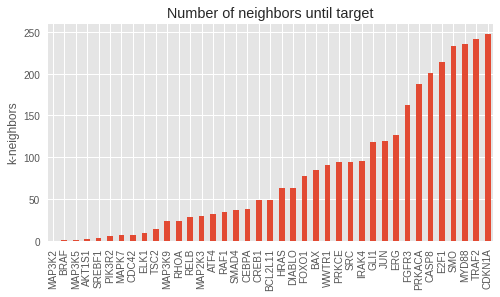

<IPython.core.display.Javascript object>

In [64]:
mpl.style.use("ggplot")
cl_nonlin_khits = get_knn_hit_data(cl_nonlin_nns_dict)
ax = cl_nonlin_khits.knn_hit.sort_values().plot(kind="bar", figsize=[8, 4])
ax.set_ylabel("k-neighbors")
ax.set_title("Number of neighbors until target")
plt.show()